In [1]:
# Importing libraries

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import shutil

# Exploring labels in the PanopTILs dataset

folder_path = "/Users/ashishsingh/Desktop/csv"

# Initialize sets to store unique values across all files
all_raw_group = set()
all_group = set()

# Loop through all files in the folder
for file_name in os.listdir(folder_path):
    # Check if the file is a CSV
    if file_name.endswith('.csv'):
        file_path = os.path.join(folder_path, file_name)
        
        # Load the CSV file
        data = pd.read_csv(file_path)
        
        # Add unique values from current file to the sets
        all_raw_group.update(data['raw_group'].unique())
        all_group.update(data['group'].unique())

# Print the concatenated unique values
print("Concatenated unique values in 'raw_group' column across all files:")
print(all_raw_group)

print("\nConcatenated unique values in 'group' column across all files:")
print(all_group)

Concatenated unique values in 'raw_group' column across all files:
{'ductal_epithelium', 'myoepithelium', 'lymphocyte', 'neutrophil', 'eosinophil', 'vascular_endothelium', 'unlabeled', 'mitotic_figure', 'tumor', 'macrophage', 'apoptotic_body', 'fibroblast', 'plasma_cell'}

Concatenated unique values in 'group' column across all files:
{'NormalEpithelium', 'ActiveTILsCell', 'CancerEpithelium', 'ActiveStromalCellNOS', 'StromalCellNOS', 'TILsCell', 'OtherCell', 'UnknownOrAmbiguousCell'}


In [2]:
# Checking the number of files in each of the four PanopTILs folder

rgb_dir = "/Users/ashishsingh/Desktop/rgbs"  # path to RGB WSI folder
mask_dir = "/Users/ashishsingh/Desktop/masks"  # path to masks folder
csv_dir = "/Users/ashishsingh/Desktop/csv"  # path to CSV folder
vis_dir = "/Users/ashishsingh/Desktop/vis"  # path to visualisation images folder

# Display dataset information
print(f"Number of RGB images: {len(os.listdir(rgb_dir))}")
print(f"Number of masks: {len(os.listdir(mask_dir))}")
print(f"Number of CSV files: {len(os.listdir(csv_dir))}")
print(f"Number of visualizations: {len(os.listdir(vis_dir))}")

Number of RGB images: 1317
Number of masks: 1317
Number of CSV files: 1327
Number of visualizations: 1317


In [3]:
# Exploring the CSV folder and files in more detail

csv_file_path = "/Users/ashishsingh/Desktop/ALL_FOV_LOCATIONS.csv"
data = pd.read_csv(csv_file_path)

# Find unique values in 'raw_group' and 'group' columns
number_of_unique_roiname = data['roiname'].nunique()
unique_roiname = data['roiname'].unique()

# Print the unique values
print("Number of unqiue values in 'roiname' column:")
print(number_of_unique_roiname)

print("Unique values in 'roiname' column:")
print(unique_roiname)

Number of unqiue values in 'roiname' column:
1316
Unique values in 'roiname' column:
['TCGA-AR-A0TU-DX1_left-89903_top-23884_bottom-25129_right-91148.png'
 'TCGA-AR-A0TU-DX1_left-89643_top-23896_bottom-25141_right-90888.png'
 'TCGA-AR-A0TU-DX1_left-88624_top-23113_bottom-24358_right-89869.png' ...
 'TCGA-AN-A0G0-DX1_left-35074_top-15869_bottom-17108_right-36313.png'
 'TCGA-AN-A0G0-DX1_left-35576_top-14804_bottom-16043_right-36815.png'
 'TCGA-EW-A1P7-DX1_left-10579_top-48464_bottom-49700_right-11815.png']


In [4]:
# Creating and verifying four 'filtered' folders, each containing 1316 files

# Paths to new filtered folders on Desktop
desktop_path = os.path.expanduser("~/Desktop")
filtered_rgb_dir = os.path.join(desktop_path, "filtered_rgbs")
filtered_mask_dir = os.path.join(desktop_path, "filtered_masks")
filtered_csv_dir = os.path.join(desktop_path, "filtered_csvs")
filtered_vis_dir = os.path.join(desktop_path, "filtered_visualizations")

# Create new filtered folders
os.makedirs(filtered_rgb_dir, exist_ok=True)
os.makedirs(filtered_mask_dir, exist_ok=True)
os.makedirs(filtered_csv_dir, exist_ok=True)
os.makedirs(filtered_vis_dir, exist_ok=True)

# Get base names (without extensions) from each folder
rgb_files = {os.path.splitext(file)[0] for file in os.listdir(rgb_dir) if file.endswith(".png")}
mask_files = {os.path.splitext(file)[0].replace("-mask", "") for file in os.listdir(mask_dir) if file.endswith(".png")}
csv_files = {os.path.splitext(file)[0] for file in os.listdir(csv_dir) if file.endswith(".csv")}
vis_files = {os.path.splitext(file)[0].replace("-viz", "") for file in os.listdir(vis_dir) if file.endswith(".png")}

# Find common base names across all folders
common_files = rgb_files & mask_files & csv_files & vis_files

print(f"Number of common files across all folders: {len(common_files)}")

# Helper function to filter files based on common names
def filter_and_copy_files(source_dir, dest_dir, file_extension, suffix=""):
    for file_name in os.listdir(source_dir):
        base_name = os.path.splitext(file_name)[0].replace(suffix, "")
        if base_name in common_files:
            src_path = os.path.join(source_dir, file_name)
            dest_path = os.path.join(dest_dir, file_name)
            shutil.copy(src_path, dest_path)

# Filter and copy files to new folders
filter_and_copy_files(rgb_dir, filtered_rgb_dir, ".png")
filter_and_copy_files(mask_dir, filtered_mask_dir, ".png", suffix="-mask")
filter_and_copy_files(csv_dir, filtered_csv_dir, ".csv")
filter_and_copy_files(vis_dir, filtered_vis_dir, ".png", suffix="-viz")

print(f"\nFiltered files have been saved to the following directories on your Desktop:")
print(f"Filtered RGBs: {filtered_rgb_dir}")
print(f"Filtered Masks: {filtered_mask_dir}")
print(f"Filtered CSVs: {filtered_csv_dir}")
print(f"Filtered Visualizations: {filtered_vis_dir}")

Number of common files across all folders: 1316

Filtered files have been saved to the following directories on your Desktop:
Filtered RGBs: /Users/ashishsingh/Desktop/filtered_rgbs
Filtered Masks: /Users/ashishsingh/Desktop/filtered_masks
Filtered CSVs: /Users/ashishsingh/Desktop/filtered_csvs
Filtered Visualizations: /Users/ashishsingh/Desktop/filtered_visualizations


In [5]:
# Further verifying all roinames in csv file correspond to RGB WSI files

csv_file_path = "/Users/ashishsingh/Desktop/ALL_FOV_LOCATIONS.csv"
rgb_folder_path = "/Users/ashishsingh/Desktop/filtered_rgbs"

try:
    # Load the main CSV file and check for the "roiname" column
    csv_data = pd.read_csv(csv_file_path)
    if "roiname" not in csv_data.columns:
        raise ValueError("The 'roiname' column is not found in the CSV file.")
    
    # Extract unique "roiname" values from the main CSV file and append ".png"
    csv_roinames = {f"{roiname}" for roiname in csv_data['roiname'].unique()}

    # Get the list of file names (with extensions) in the RGB folder
    rgb_files = {file for file in os.listdir(rgb_folder_path) if file.endswith(".png")}

    # Find the "roiname" values that do not match the RGB file names
    non_matching_roinames = csv_roinames - rgb_files

    # Display the results
    if non_matching_roinames:
        print(f"Number of non-matching 'roiname' entries: {len(non_matching_roinames)}")
        print("Non-matching 'roiname' entries:")
        for roiname in non_matching_roinames:
            print(roiname)
    else:
        print("All 'roiname' entries match the file names in the RGB folder.")
except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")


All 'roiname' entries match the file names in the RGB folder.


In [6]:
# Final check of all files across the four PanopTILs folder

rgb_dir = "/Users/ashishsingh/Desktop/filtered_rgbs"  # Replace with the path to your RGB images folder
mask_dir = "/Users/ashishsingh/Desktop/filtered_masks"  # Replace with the path to your masks folder
csv_dir = "/Users/ashishsingh/Desktop/filtered_csvs"  # Replace with the path to your CSV folder
vis_dir = "/Users/ashishsingh/Desktop/filtered_visualizations"  # Replace with the path to your visualisation images folder

# Display dataset information
print(f"Number of RGB images: {len(os.listdir(rgb_dir))}")
print(f"Number of masks: {len(os.listdir(mask_dir))}")
print(f"Number of CSV files: {len(os.listdir(csv_dir))}")
print(f"Number of visualizations: {len(os.listdir(vis_dir))}")

Number of RGB images: 1316
Number of masks: 1316
Number of CSV files: 1316
Number of visualizations: 1316


Processing file: TCGA-A1-A0SP-DX1_left-8623_top-55315_bottom-56533_right-9842.png


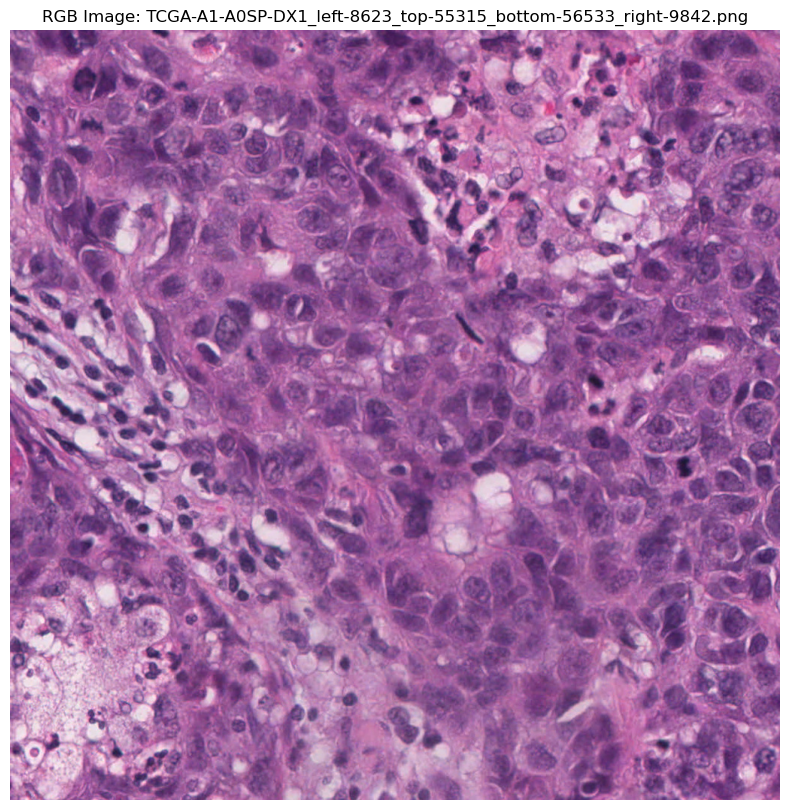

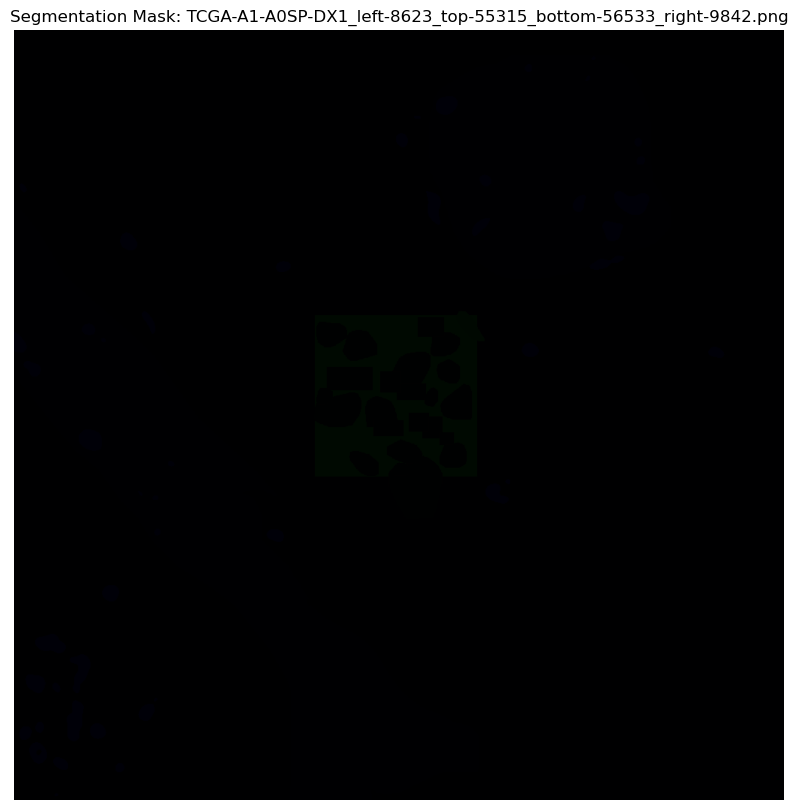

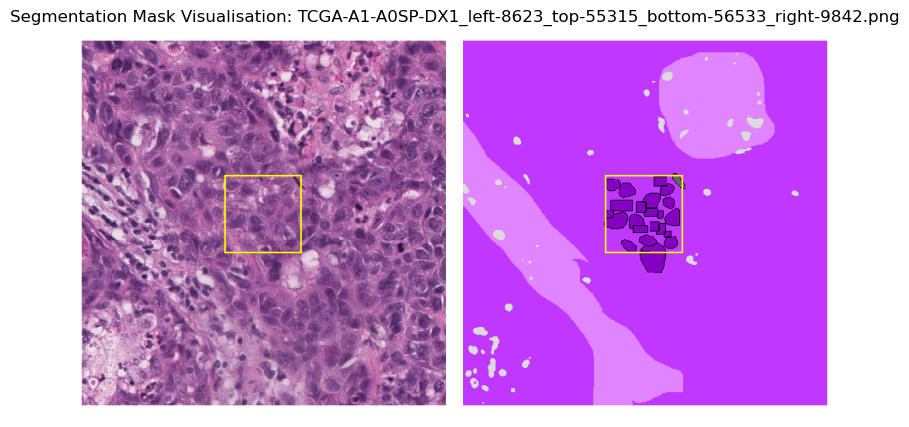

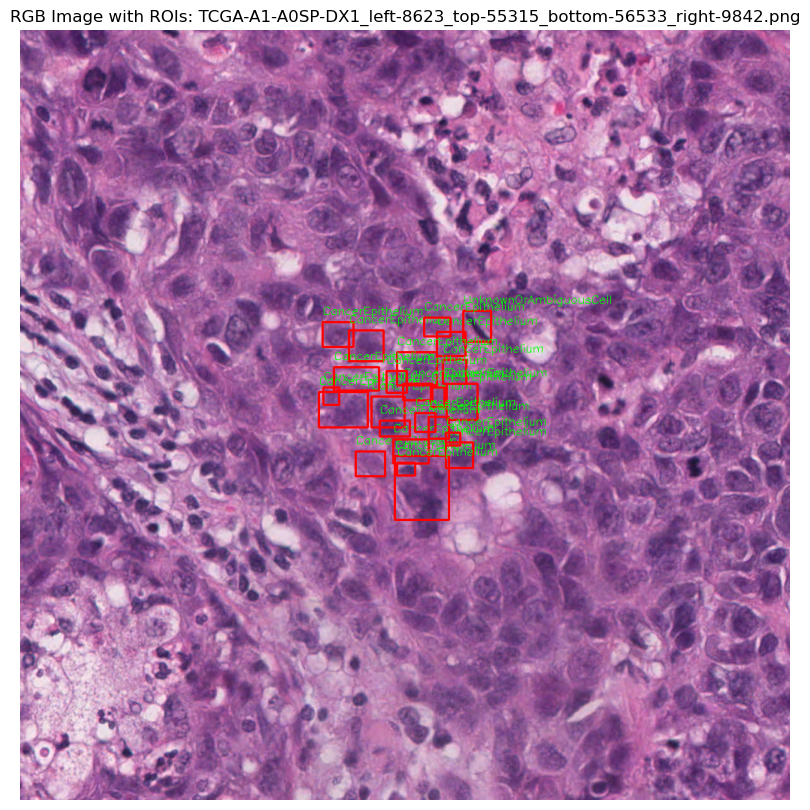

Processing file: TCGA-AR-A0TS-DX1_left-122947_top-22849_bottom-24094_right-124191.png


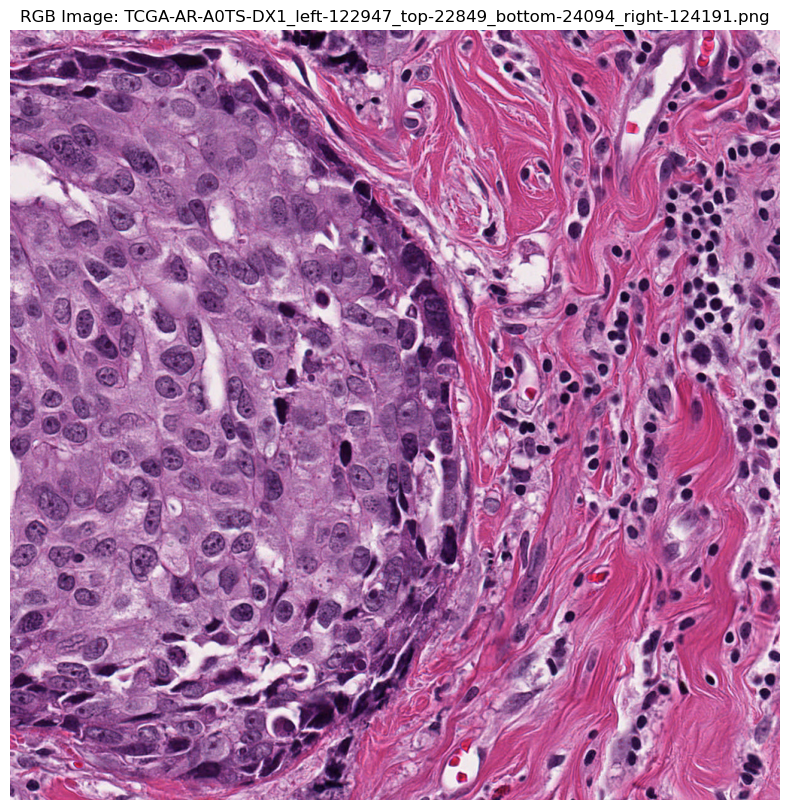

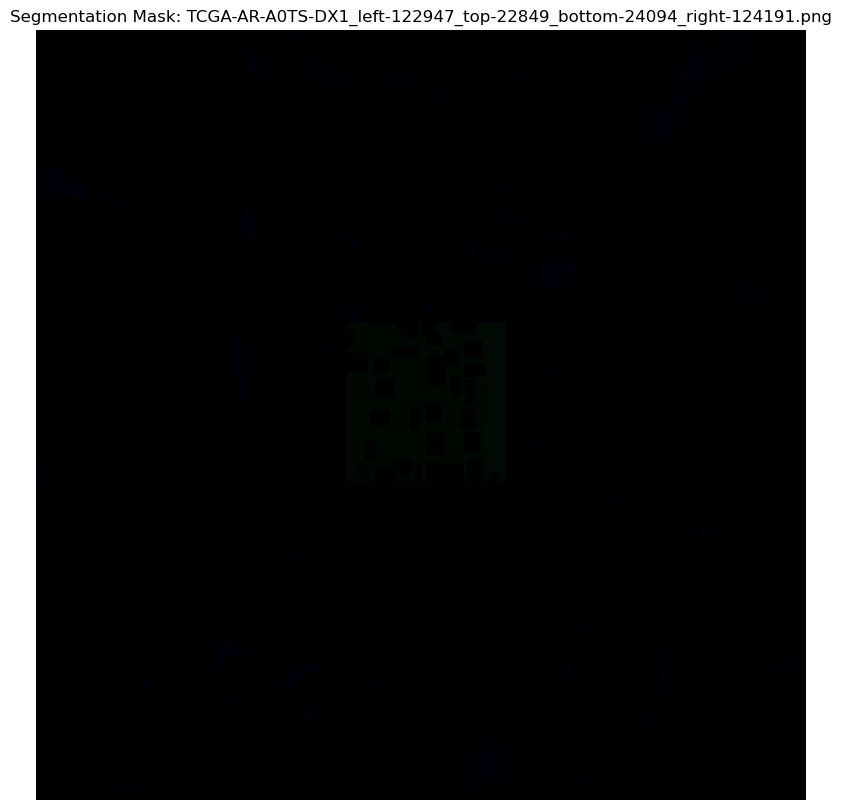

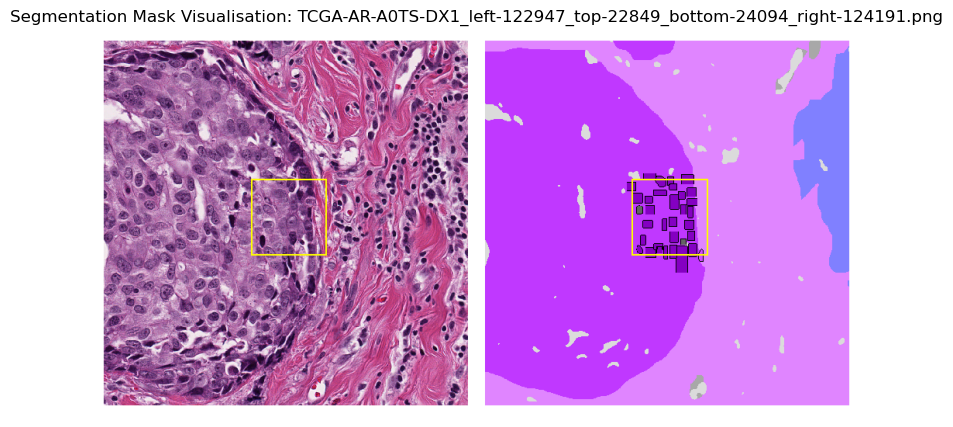

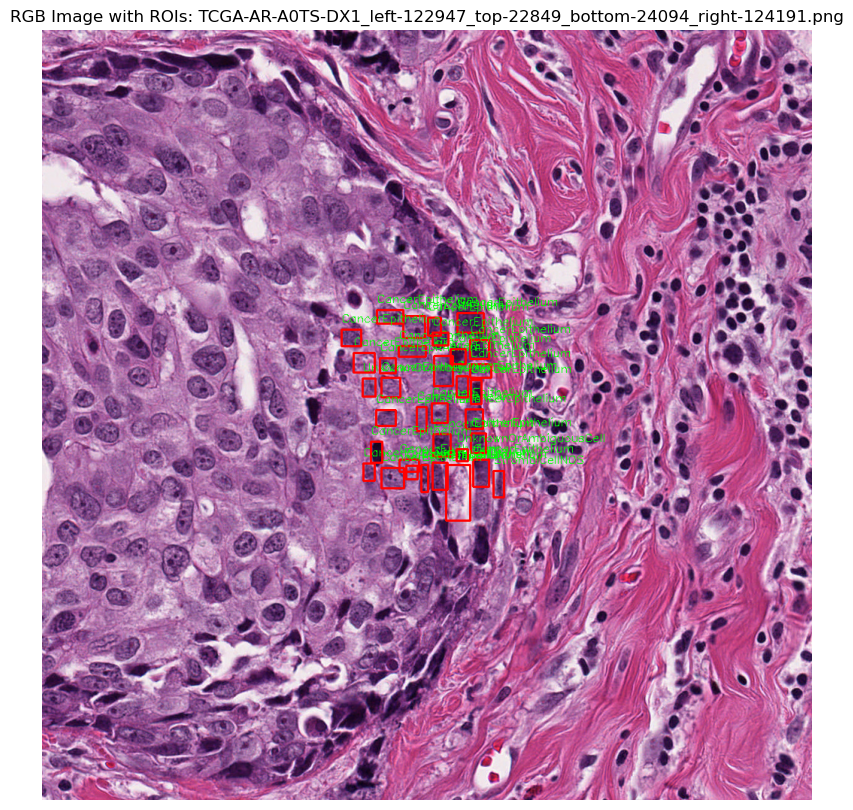

Processing file: TCGA-AR-A0TS-DX1_left-118858_top-23089_bottom-24334_right-120103.png


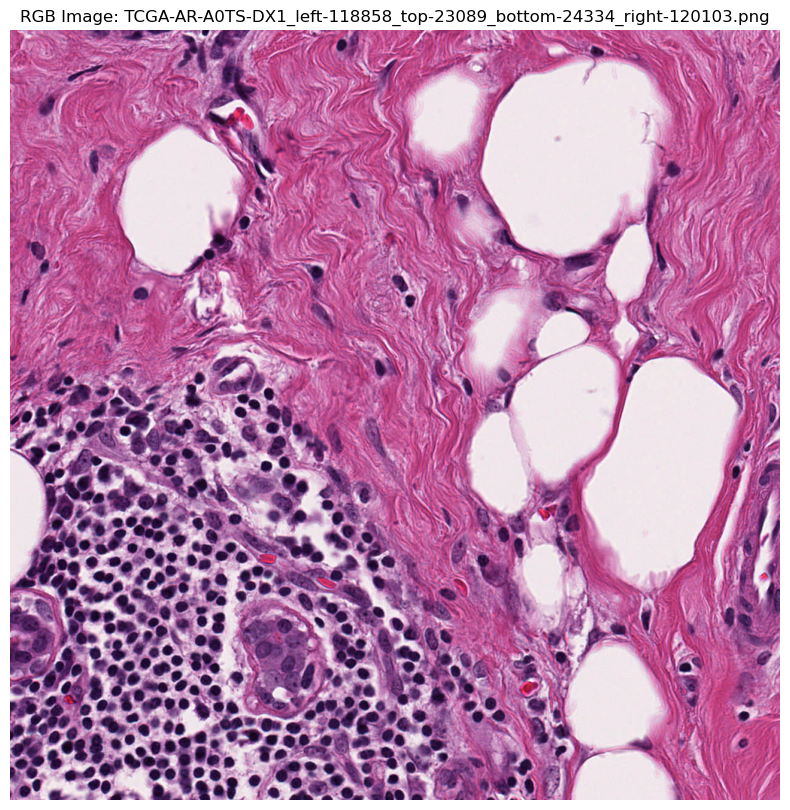

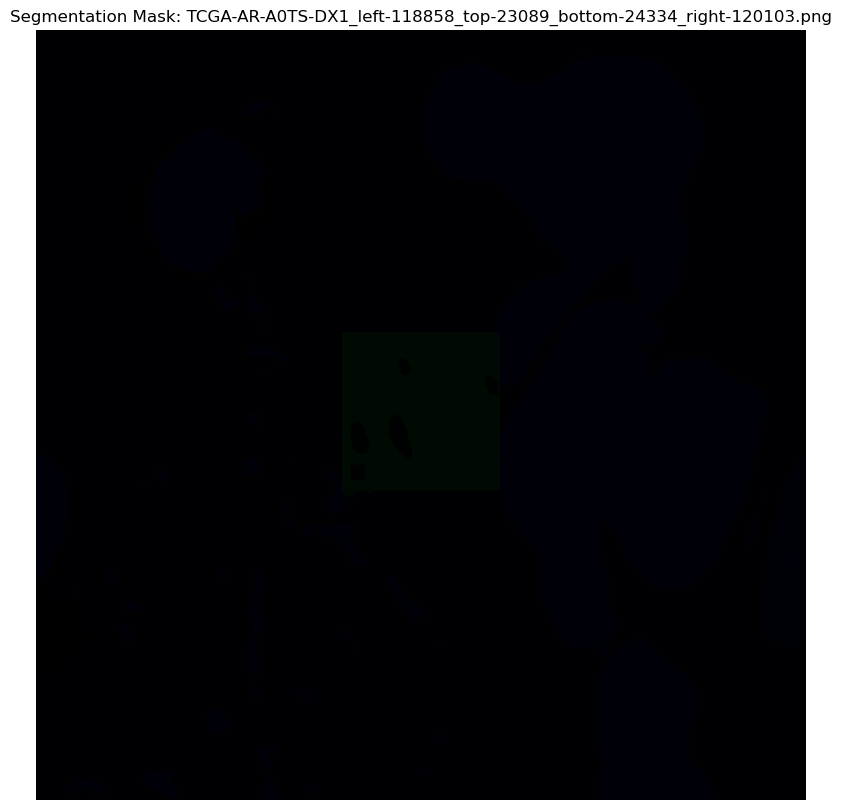

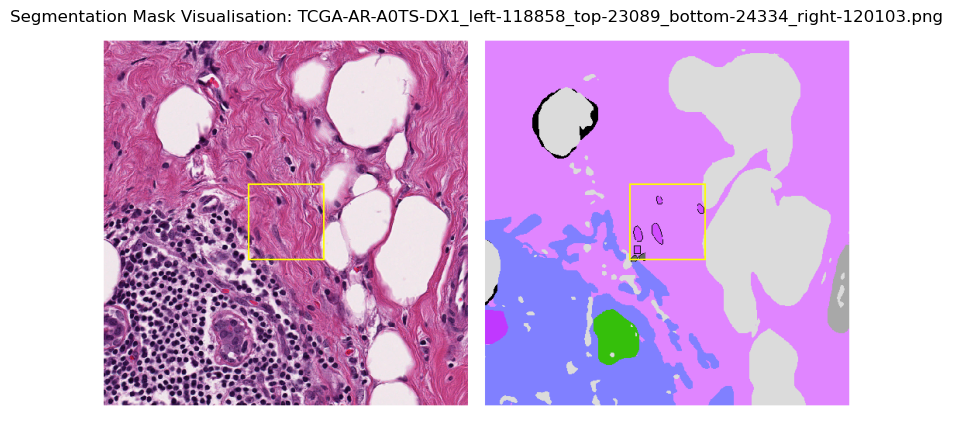

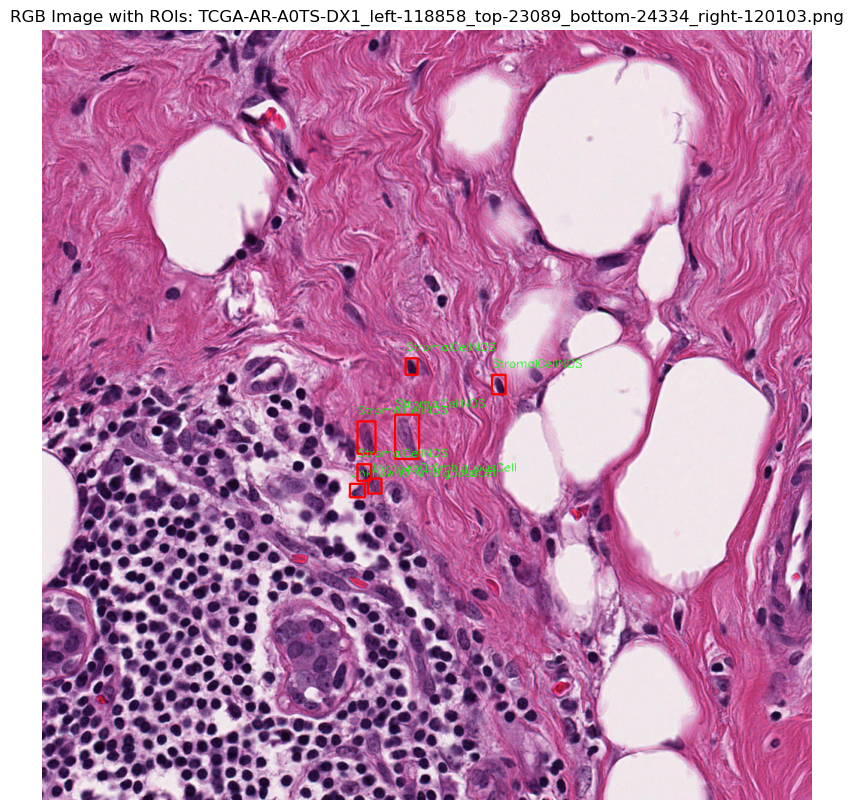

Processing file: TCGA-A2-A3XY-DX1_left-76823_top-36811_bottom-38062_right-78074.png


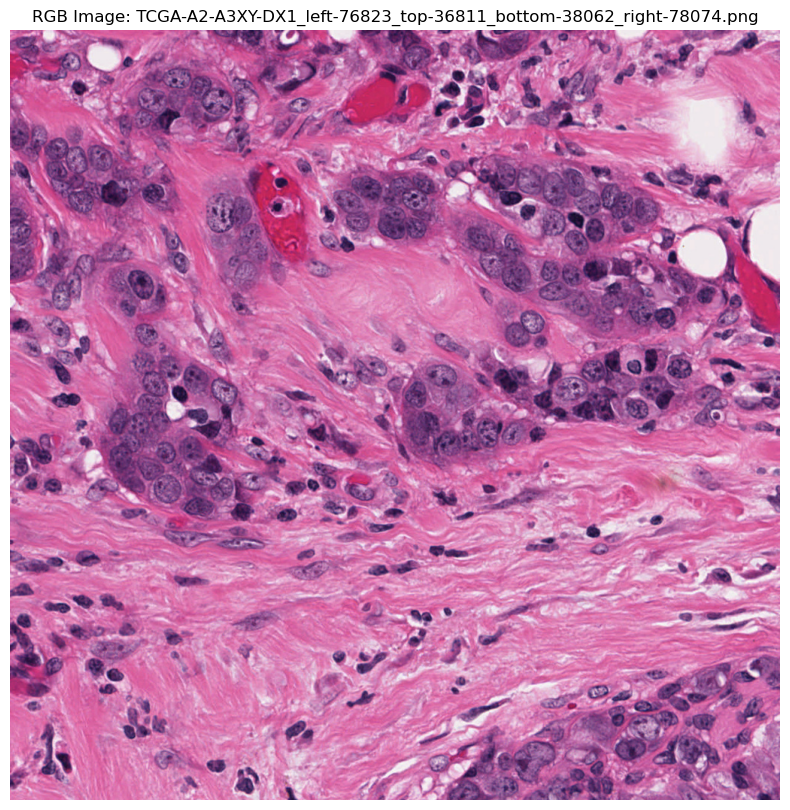

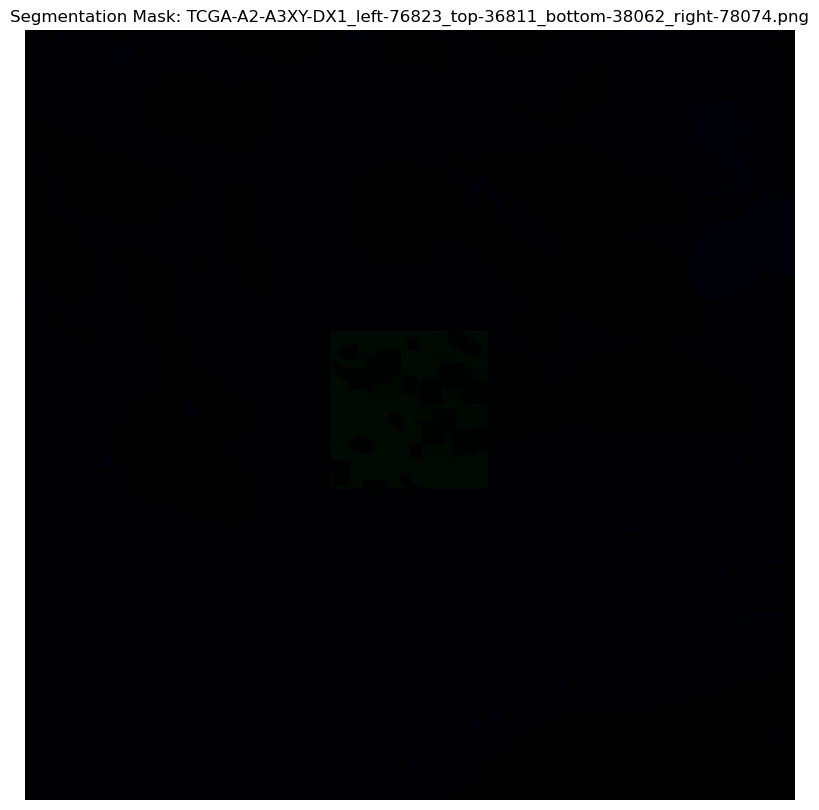

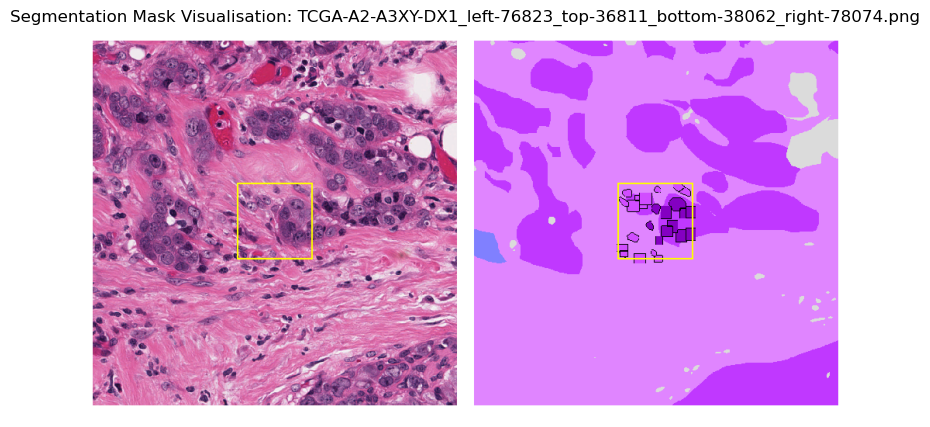

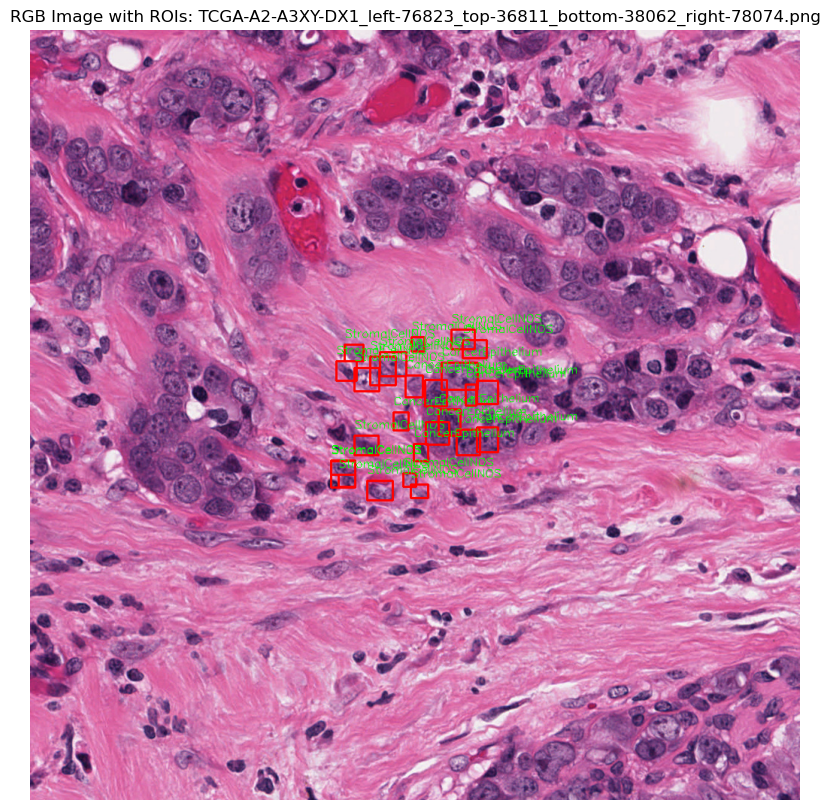

Processing file: TCGA-AN-A0AT-DX1_left-31964_top-36019_bottom-37258_right-33203.png


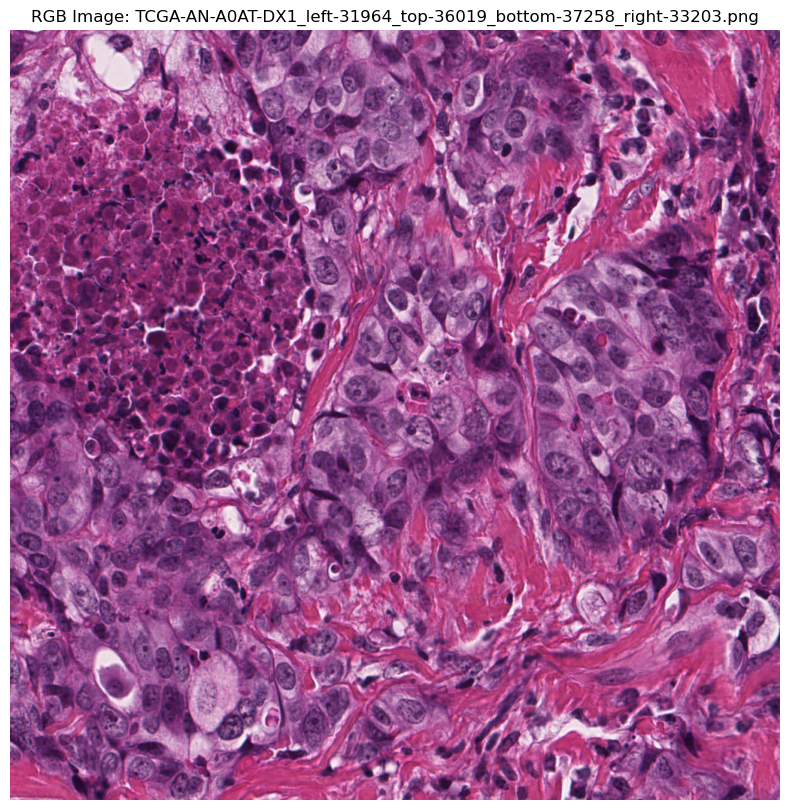

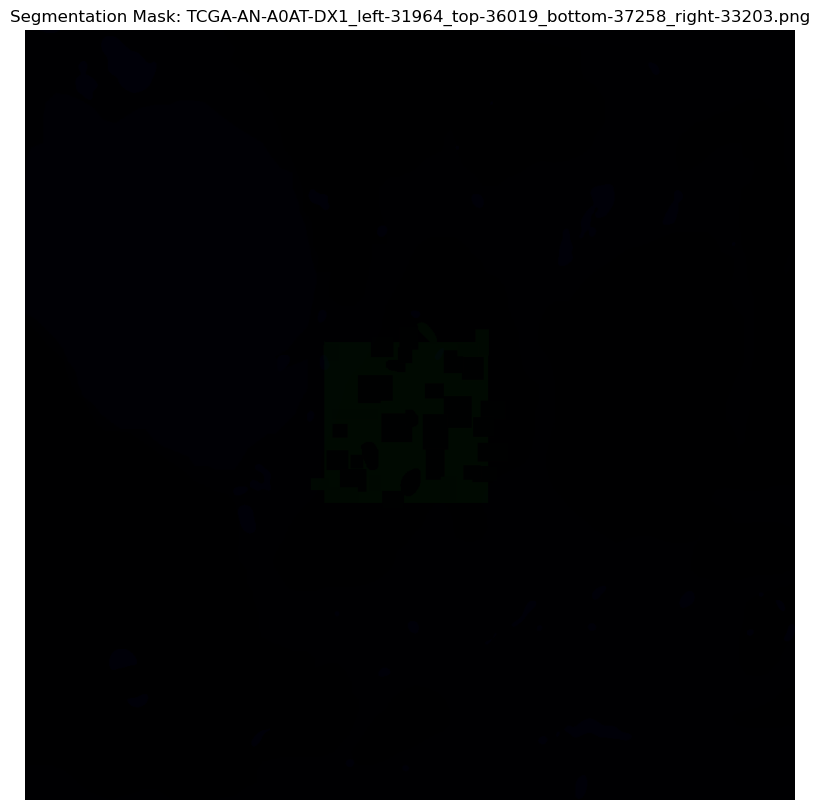

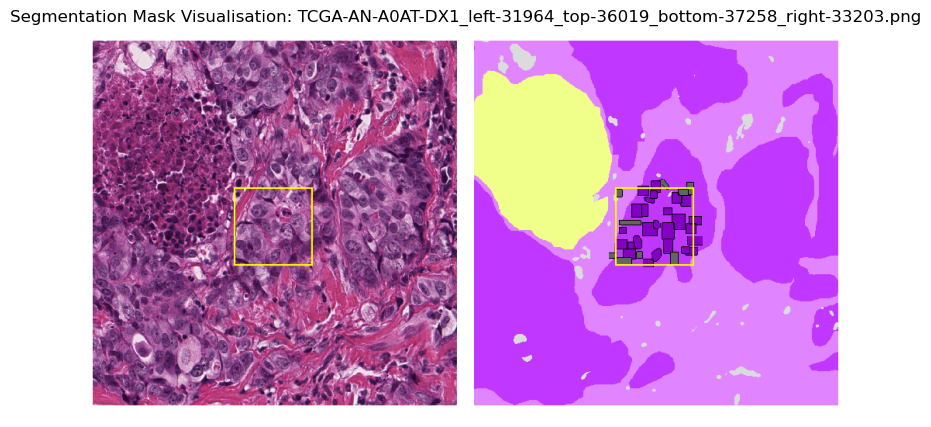

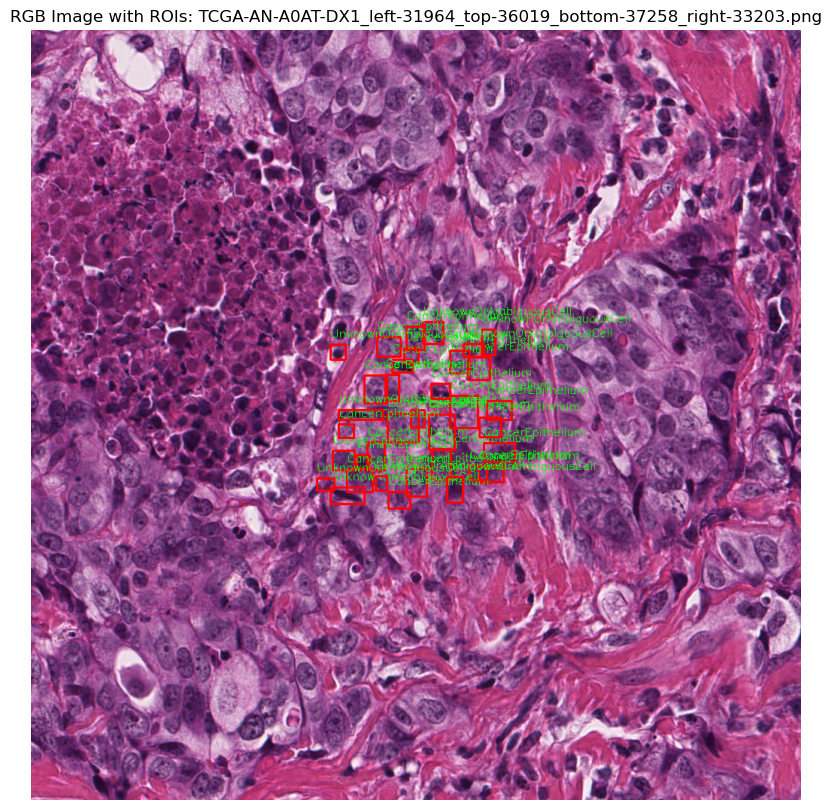

Processing file: TCGA-BH-A0E6-DX1_left-58380_top-20277_bottom-21513_right-59616.png


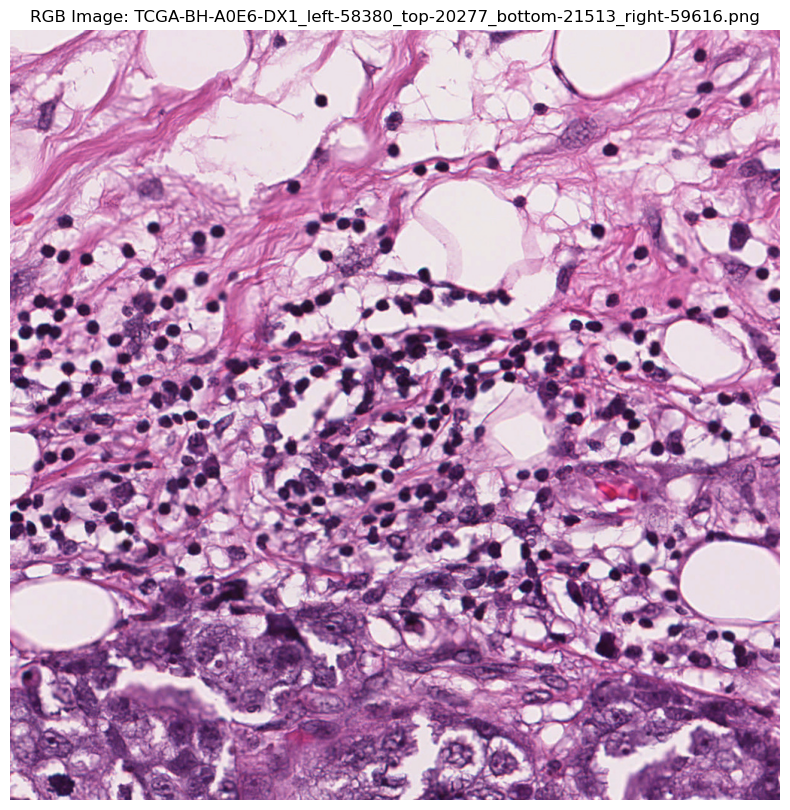

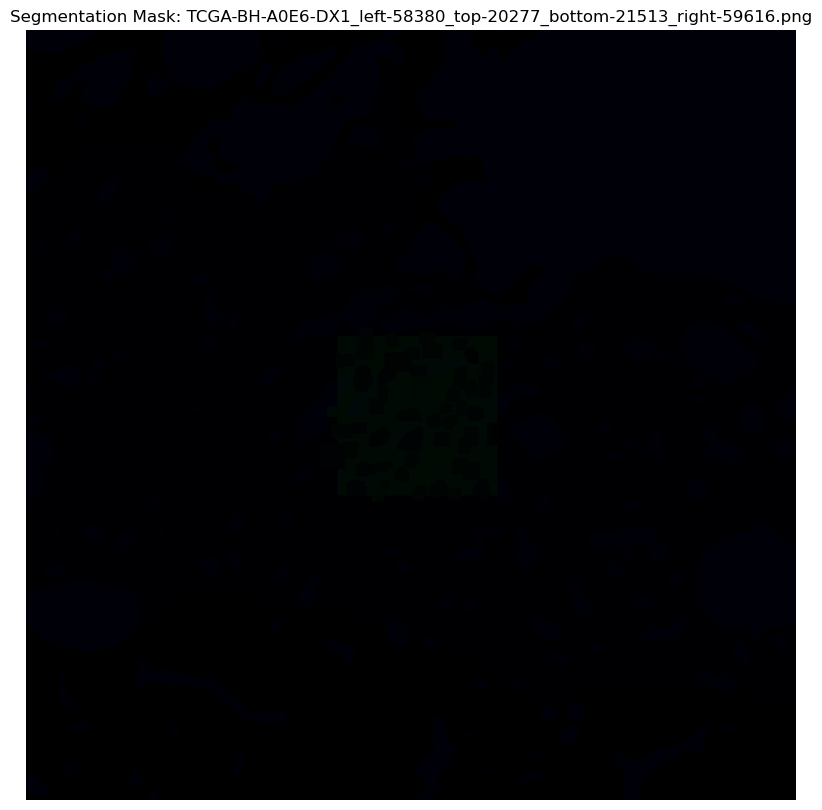

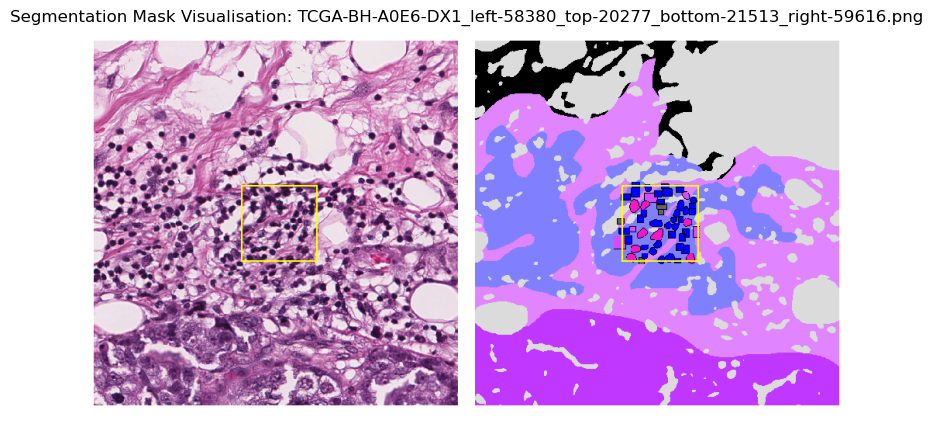

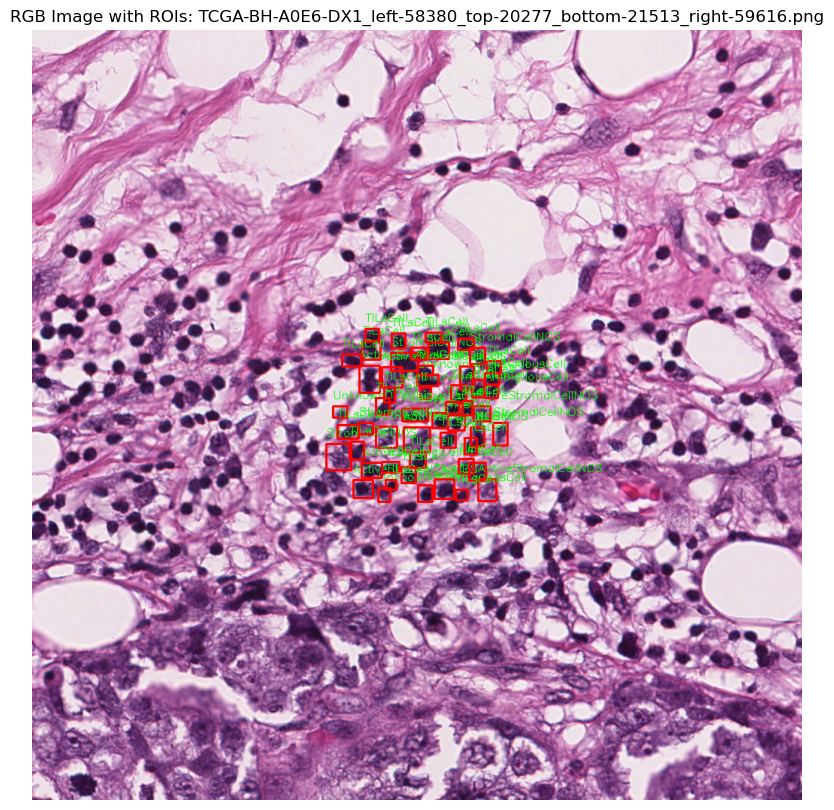

Processing file: TCGA-AR-A0U1-DX1_left-65494_top-25467_bottom-26712_right-66739.png


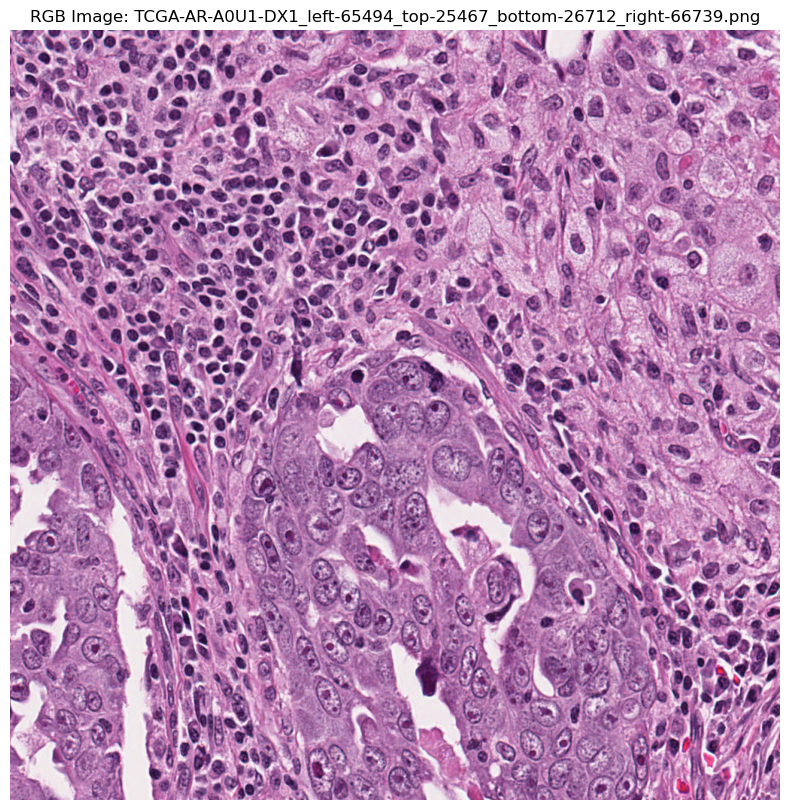

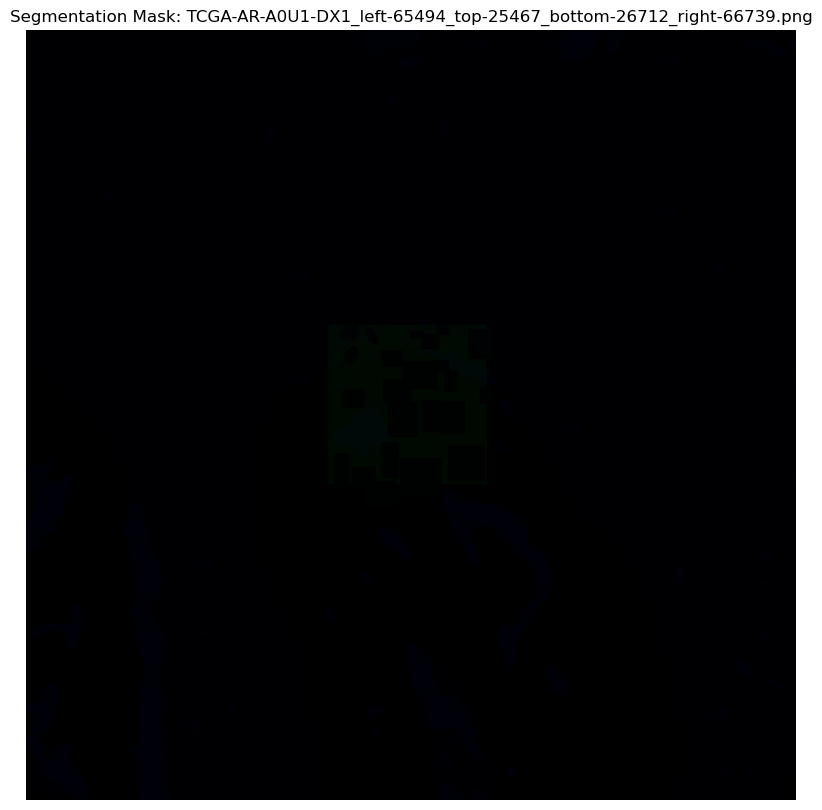

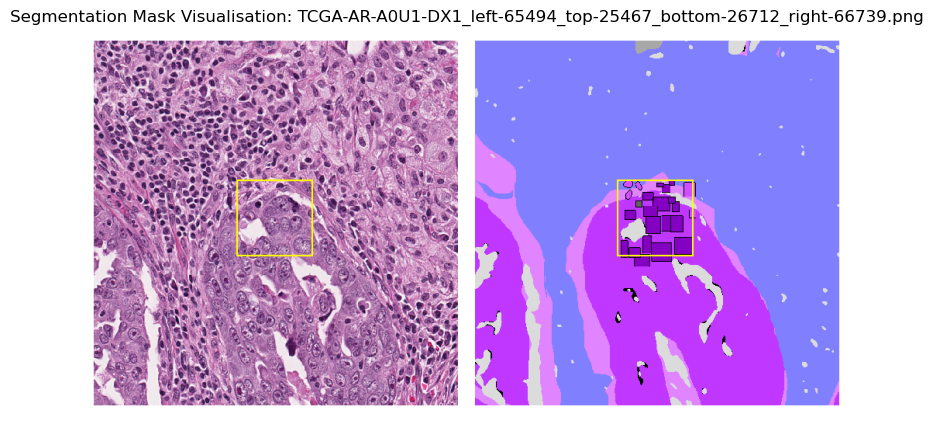

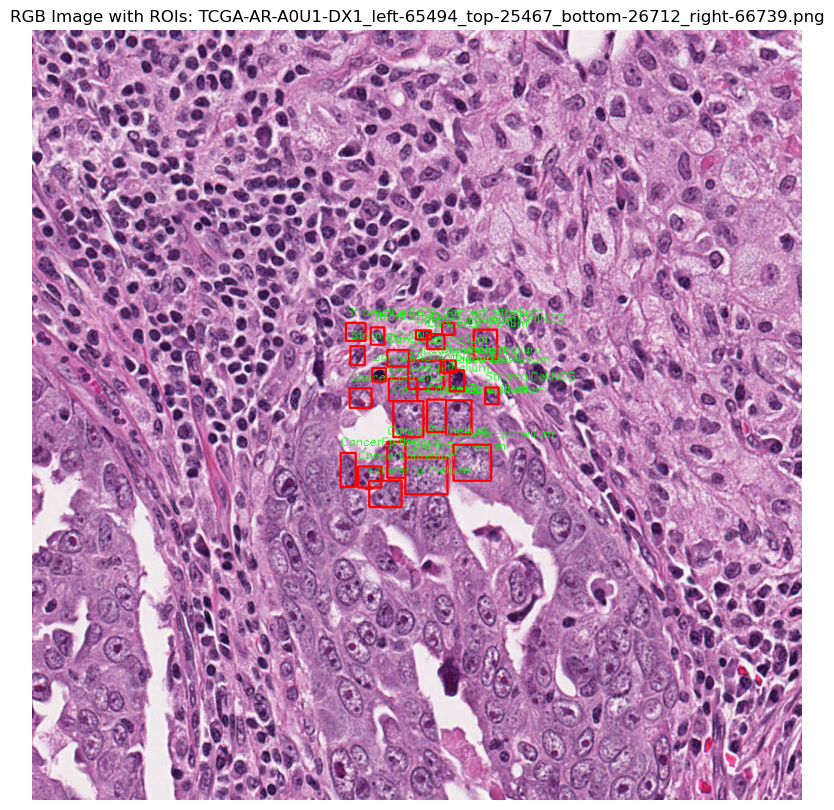

Processing file: TCGA-A2-A0SX-DX1_left-55604_top-56967_bottom-58206_right-56843.png


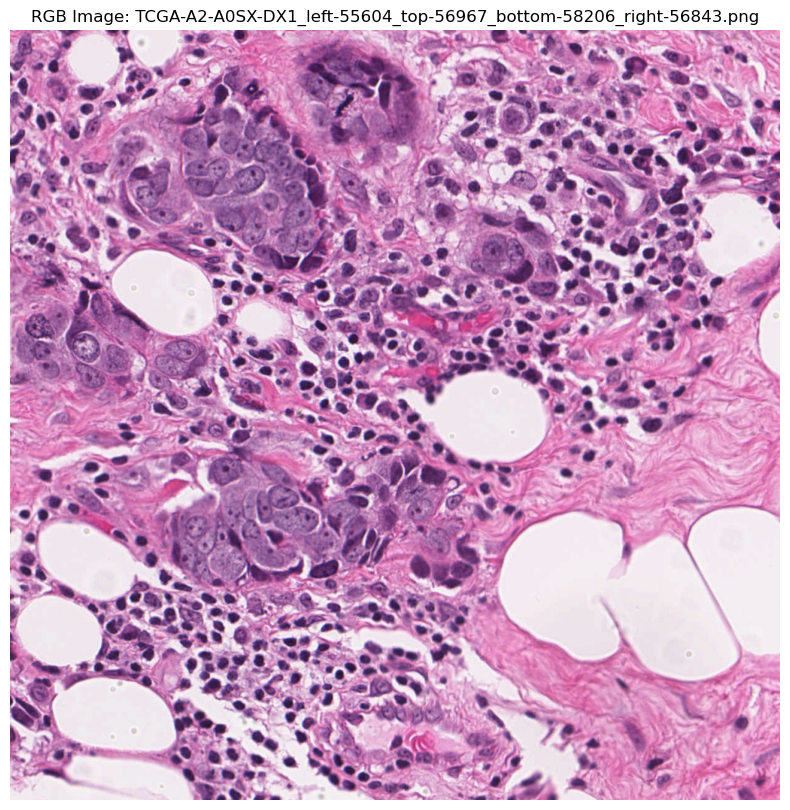

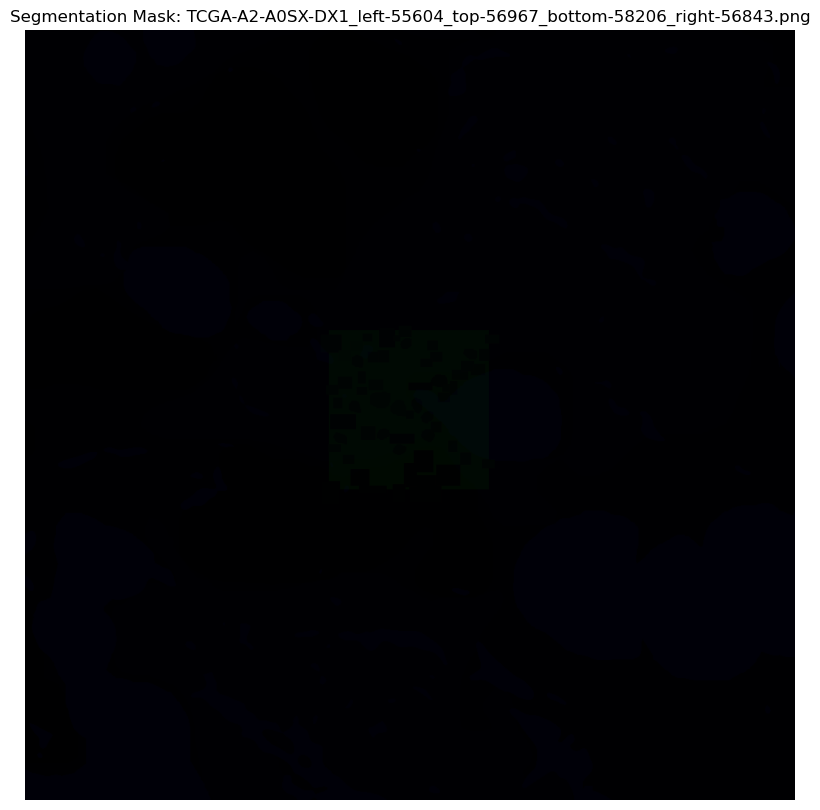

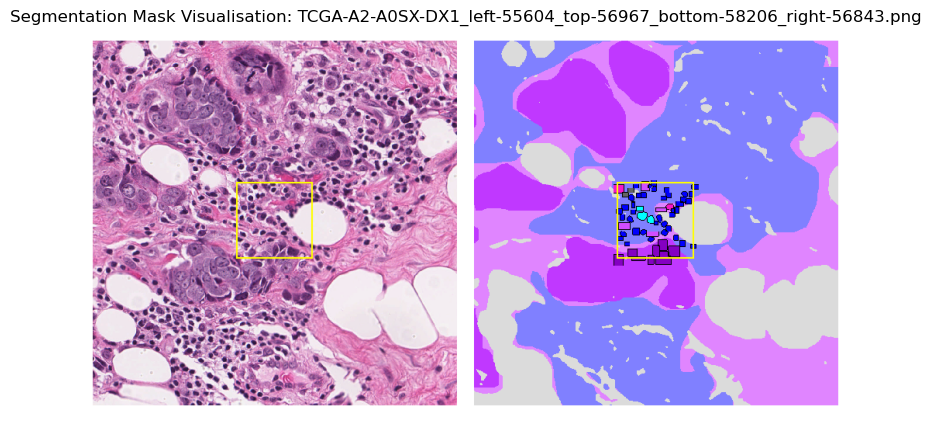

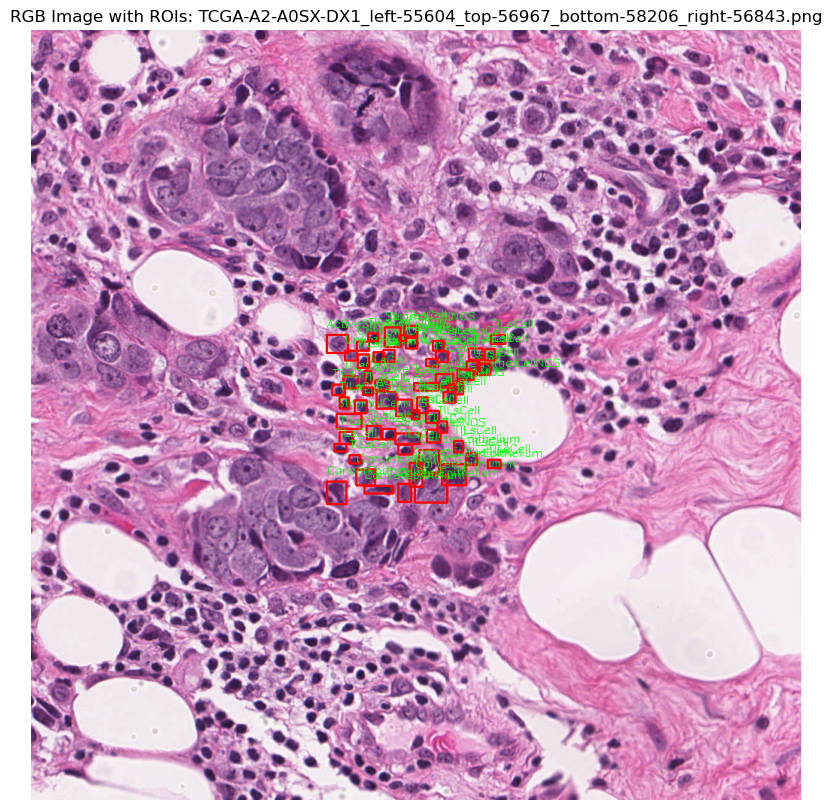

Processing file: TCGA-BH-A0B3-DX1_left-87161_top-42726_bottom-43962_right-88398.png


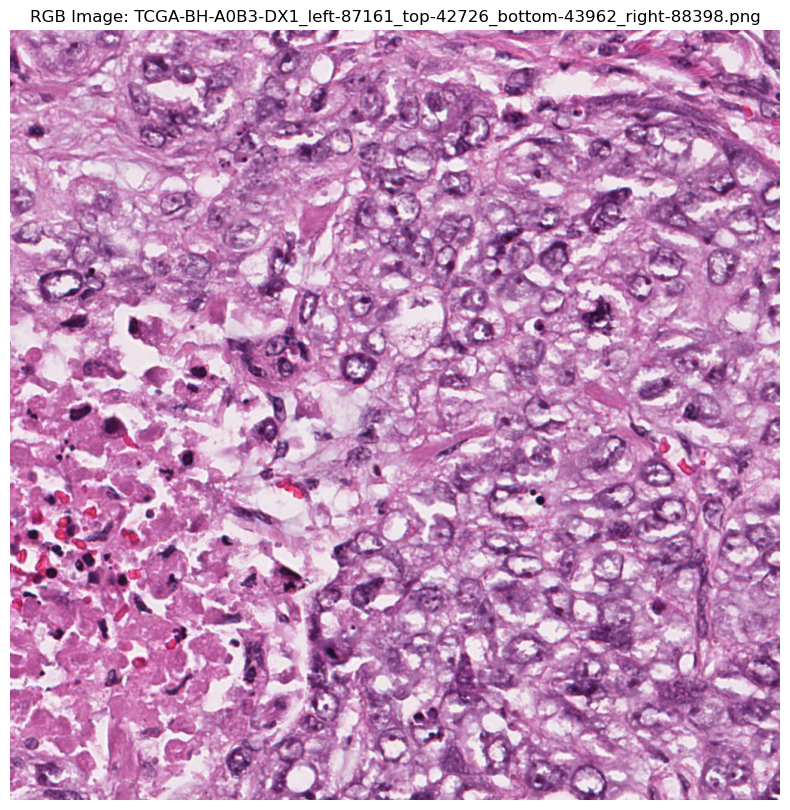

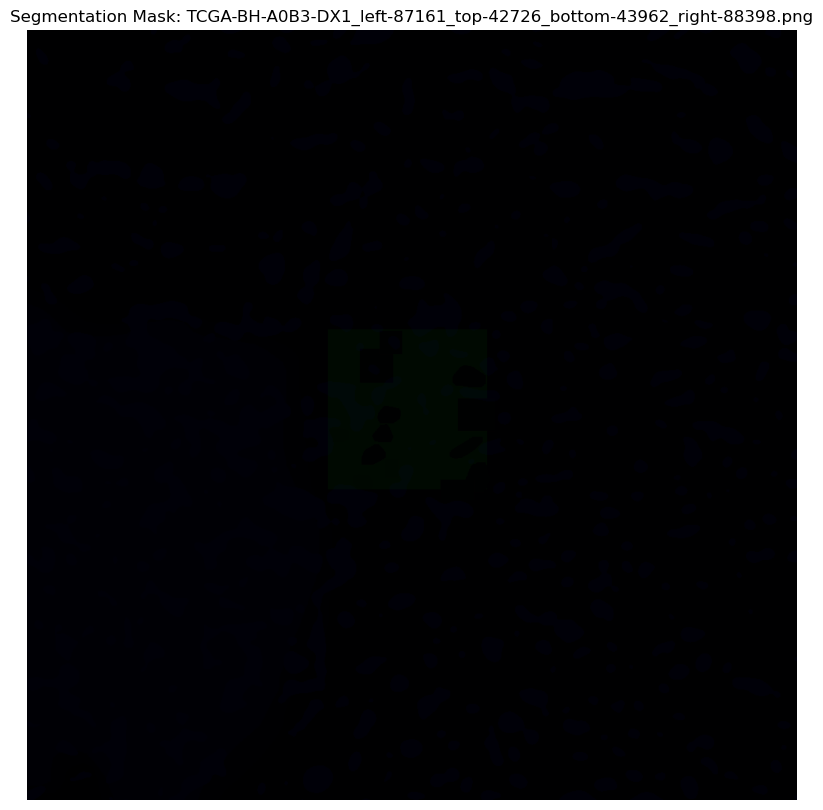

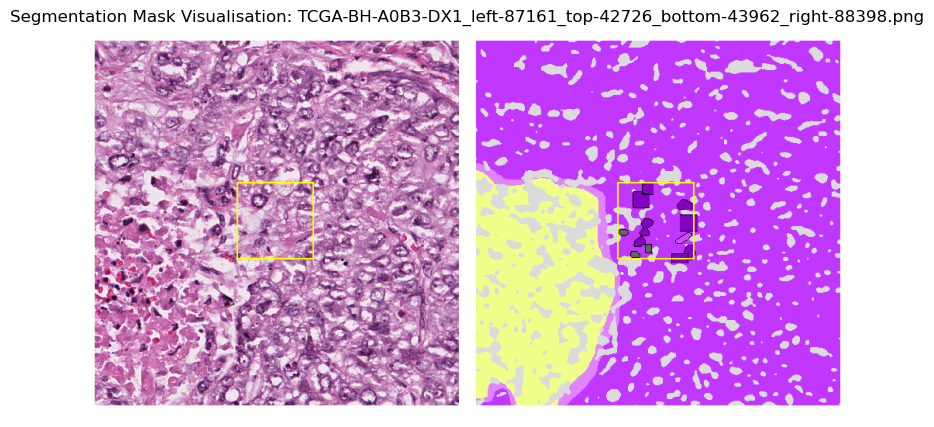

KeyboardInterrupt: 

In [7]:
# Exploring and displaying segmented WSIs with ROIs and masks

# Folder paths (different assigned variables as for a separate task)
rgb_folder = "/Users/ashishsingh/Desktop/filtered_rgbs"  
mask_folder = "/Users/ashishsingh/Desktop/filtered_masks" 
csv_folder = "/Users/ashishsingh/Desktop/filtered_csvs"
vis_folder = "/Users/ashishsingh/Desktop/filtered_visualizations"

# Function to load an image with error handling
def load_image(file_path, convert_color=True):
    if not os.path.exists(file_path):
        print(f"File not found: {file_path}")
        return None
    
    image = cv2.imread(file_path)
    if image is None:
        print(f"Failed to load image: {file_path}. Check the file format or integrity.")
        return None
    
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB) if convert_color else image

# Process each RGB image in the folder
for rgb_file in os.listdir(rgb_folder):
    if rgb_file.endswith(".png"):
        # File paths
        rgb_image_path = os.path.join(rgb_folder, rgb_file)
        mask_image_path = os.path.join(mask_folder, rgb_file.replace(".png", ".png"))
        vis_image_path = os.path.join(vis_folder, rgb_file.replace(".png", ".png"))
        csv_file_path = os.path.join(csv_folder, rgb_file.replace(".png", ".csv"))

        print(f"Processing file: {rgb_file}")
        
        # Load images
        rgb_image = load_image(rgb_image_path)
        mask_image = load_image(mask_image_path, convert_color=False)
        vis_image = load_image(vis_image_path)

        # Load CSV
        if os.path.exists(csv_file_path):
            csv_data = pd.read_csv(csv_file_path)
        else:
            print(f"CSV file not found: {csv_file_path}")
            csv_data = None

        # Ensure the CSV contains necessary columns
        required_columns = {"raw_group", "group", "type", "left", "right", "top", "bottom", "coords_x", "coords_y"}
        if csv_data is not None and not required_columns.issubset(csv_data.columns):
            print(f"The CSV file does not contain the required columns: {required_columns}")
            continue

        # Display images
        if rgb_image is not None:
            plt.figure(figsize=(10, 10))
            plt.imshow(rgb_image)
            plt.title(f"RGB Image: {rgb_file}")
            plt.axis("off")
            plt.show()

        if mask_image is not None:
            plt.figure(figsize=(10, 10))
            plt.imshow(mask_image, cmap="gray")
            plt.title(f"Segmentation Mask: {rgb_file}")
            plt.axis("off")
            plt.show()

        if vis_image is not None:
            plt.figure(figsize=(10, 10))
            plt.imshow(vis_image)
            plt.title(f"Segmentation Mask Visualisation: {rgb_file}")
            plt.axis("off")
            plt.show()

        # Draw ROIs on the RGB image
        if csv_data is not None and rgb_image is not None:
            rgb_with_rois = rgb_image.copy()
            for _, roi in csv_data.iterrows():
                x1, x2, y1, y2 = roi["left"], roi["right"], roi["top"], roi["bottom"]
                group = roi["group"]
                # Draw rectangle (colour blue for all ROIs)
                cv2.rectangle(rgb_with_rois, (x1, y1), (x2, y2), (255, 0, 0), 2)
                # Optionally, annotate with group type
                cv2.putText(rgb_with_rois, group, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

            # Display the RGB image with ROIs
            plt.figure(figsize=(10, 10))
            plt.imshow(rgb_with_rois)
            plt.title(f"RGB Image with ROIs: {rgb_file}")
            plt.axis("off")
            plt.show()

No TILsCell regions found in TCGA-A2-A0D2-DX1_left-99722_top-22842_bottom-24080_right-100961.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_y'] = (tils_data['top'] + tils_data['bottom']) / 2


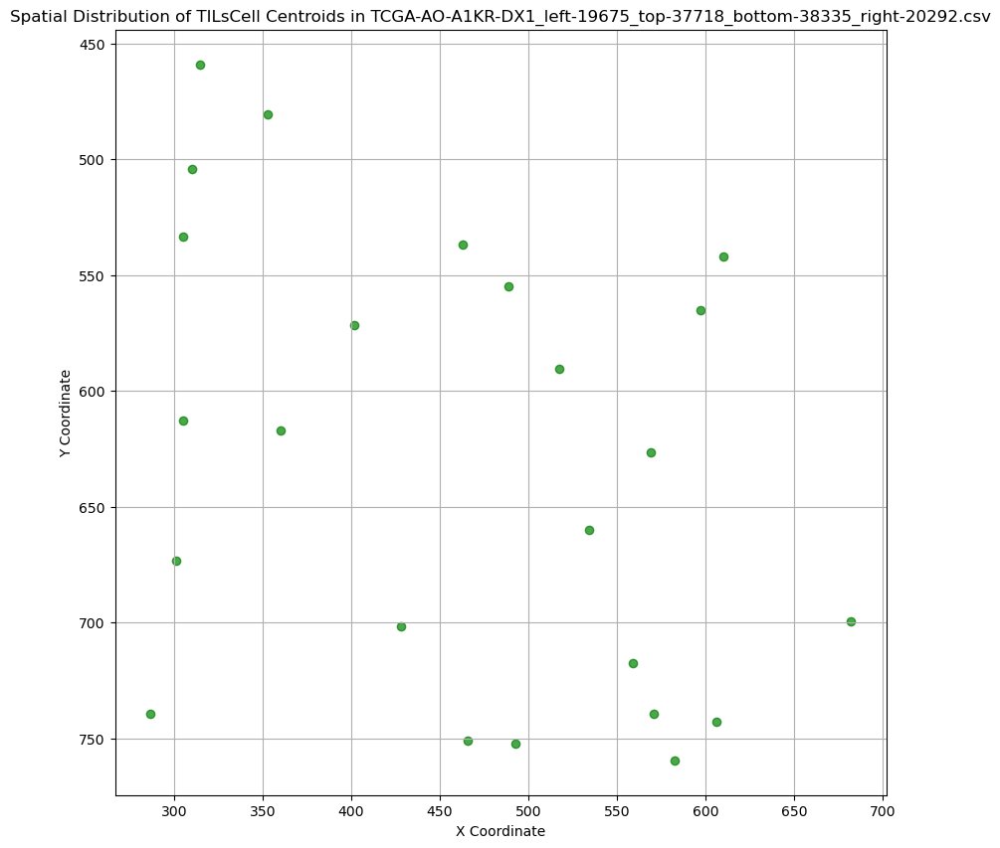

TILsCell Spatial Analysis for TCGA-AO-A1KR-DX1_left-19675_top-37718_bottom-38335_right-20292.csv:
Number of TILsCell regions: 24
Mean area: 430.79
Standard deviation of area: 141.71
Coefficient of variation (heterogeneity): 0.33


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

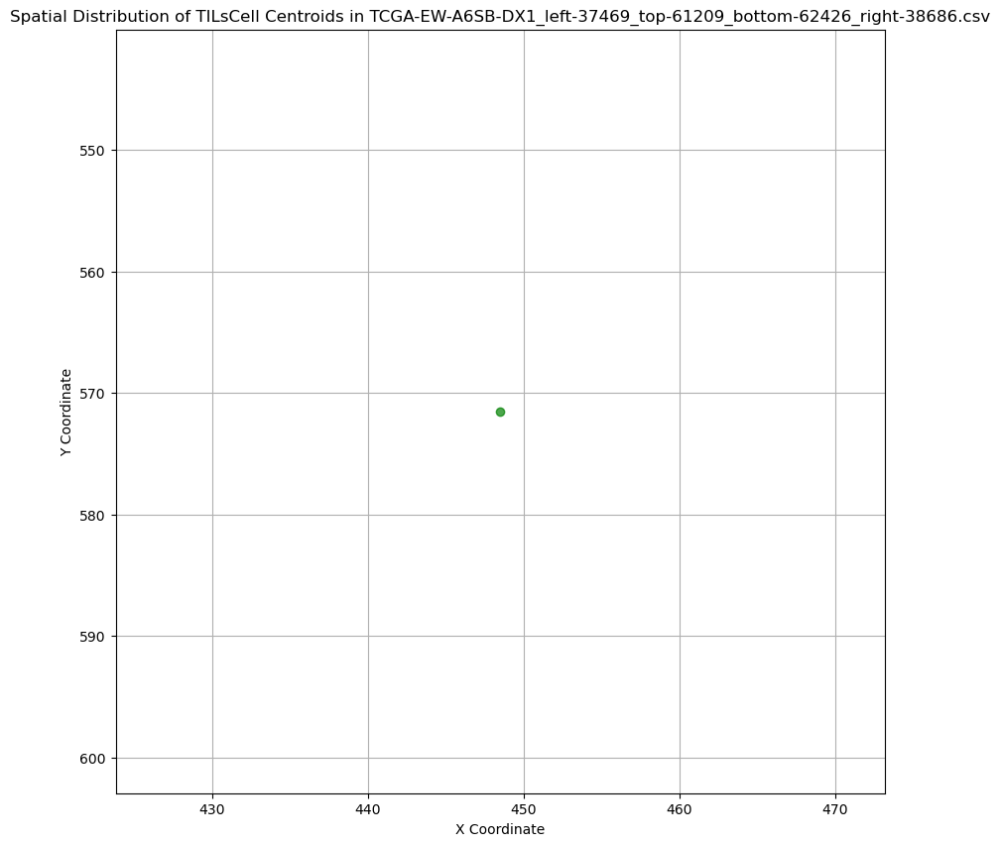

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-37469_top-61209_bottom-62426_right-38686.csv:
Number of TILsCell regions: 1
Mean area: 99.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


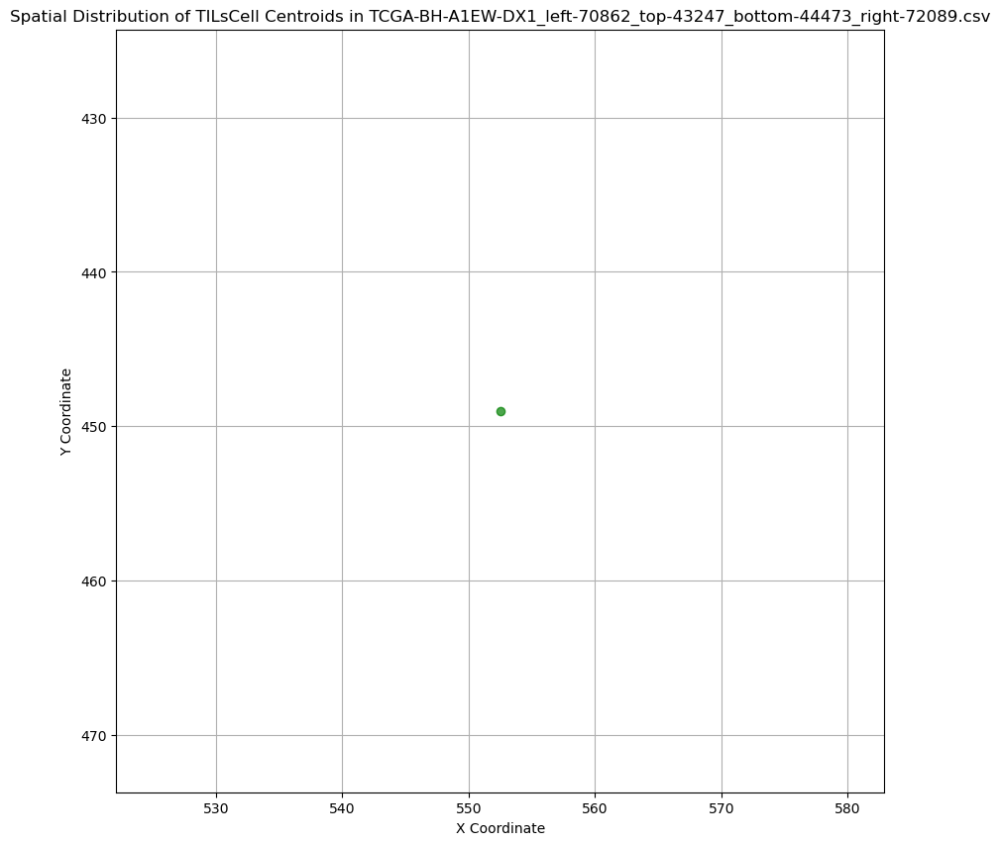

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-BH-A1EW-DX1_left-70862_top-43247_bottom-44473_right-72089.csv:
Number of TILsCell regions: 1
Mean area: 380.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


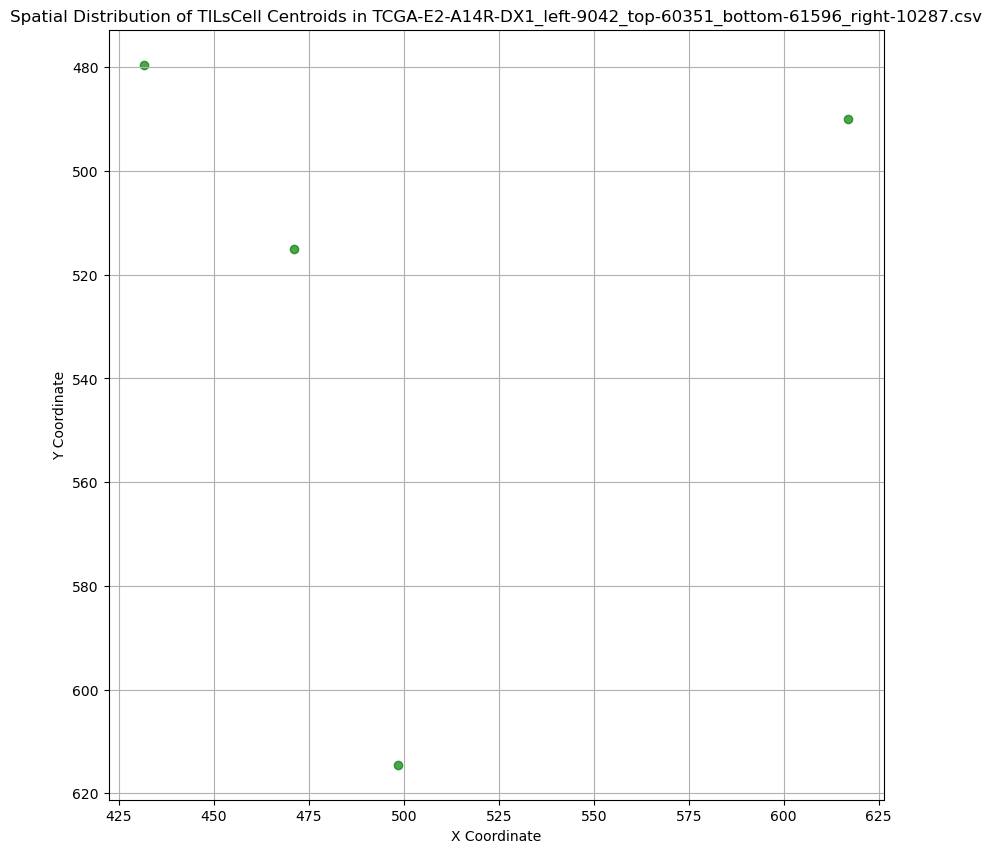

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A14R-DX1_left-9042_top-60351_bottom-61596_right-10287.csv:
Number of TILsCell regions: 4
Mean area: 322.00
Standard deviation of area: 73.62
Coefficient of variation (heterogeneity): 0.23


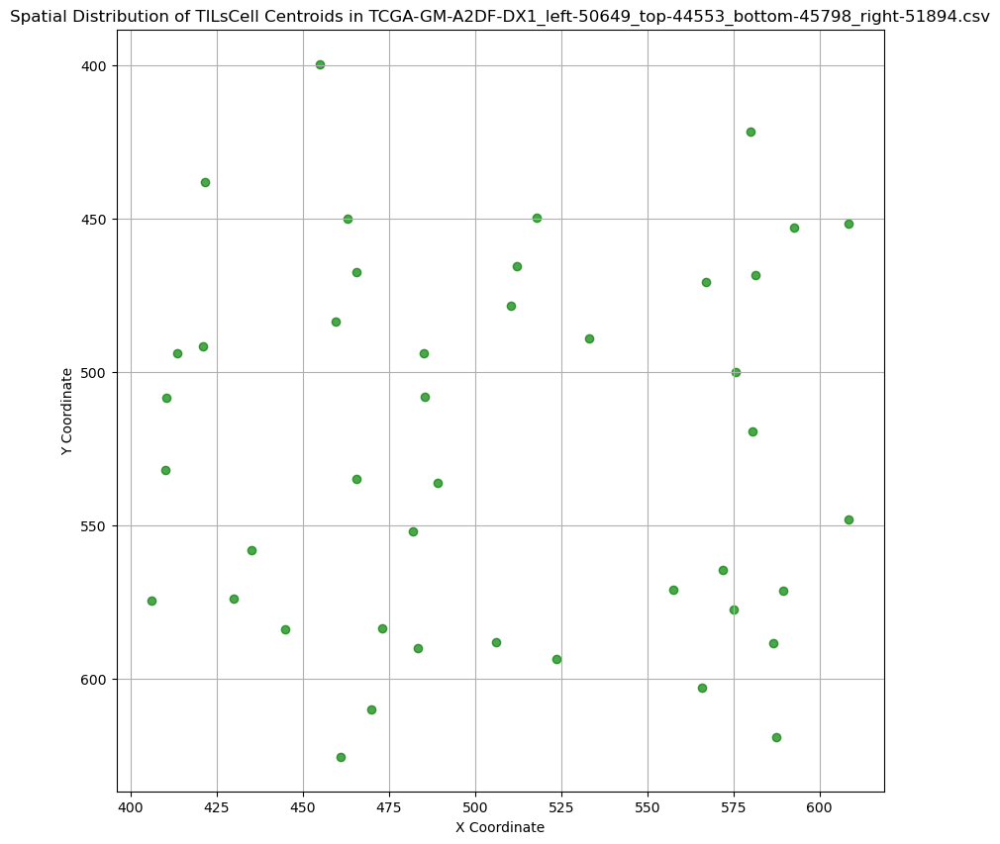

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-GM-A2DF-DX1_left-50649_top-44553_bottom-45798_right-51894.csv:
Number of TILsCell regions: 43
Mean area: 279.49
Standard deviation of area: 85.50
Coefficient of variation (heterogeneity): 0.31


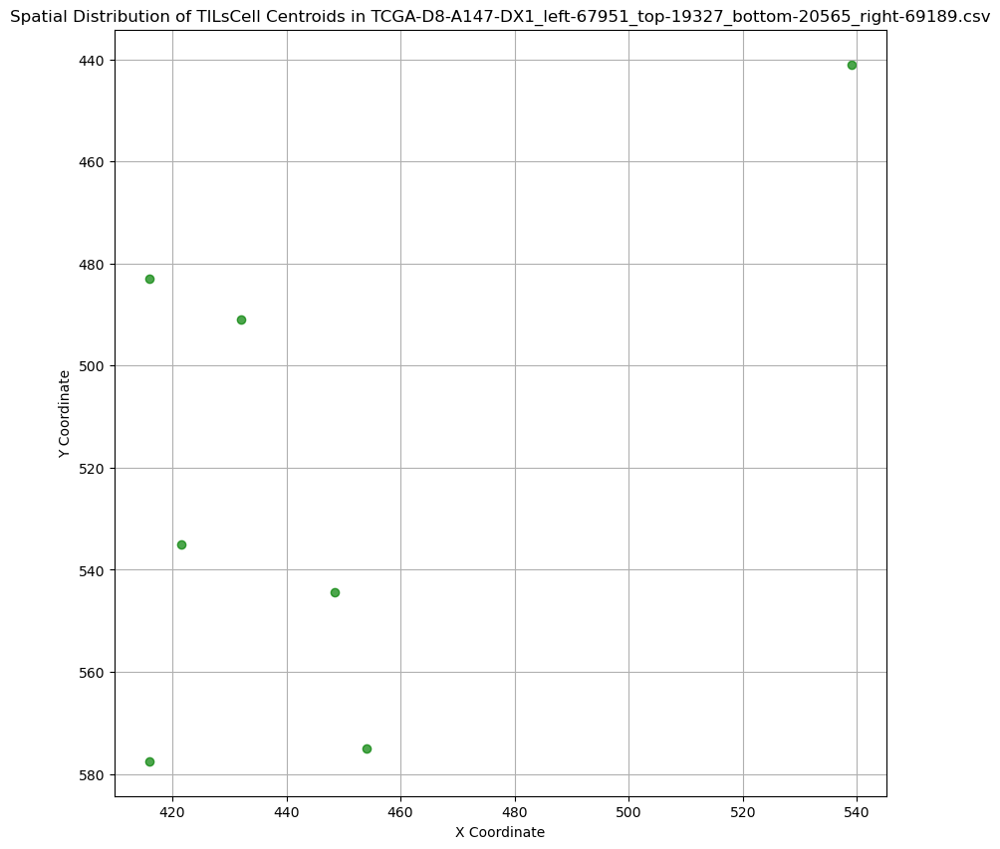

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A147-DX1_left-67951_top-19327_bottom-20565_right-69189.csv:
Number of TILsCell regions: 7
Mean area: 419.57
Standard deviation of area: 199.06
Coefficient of variation (heterogeneity): 0.47


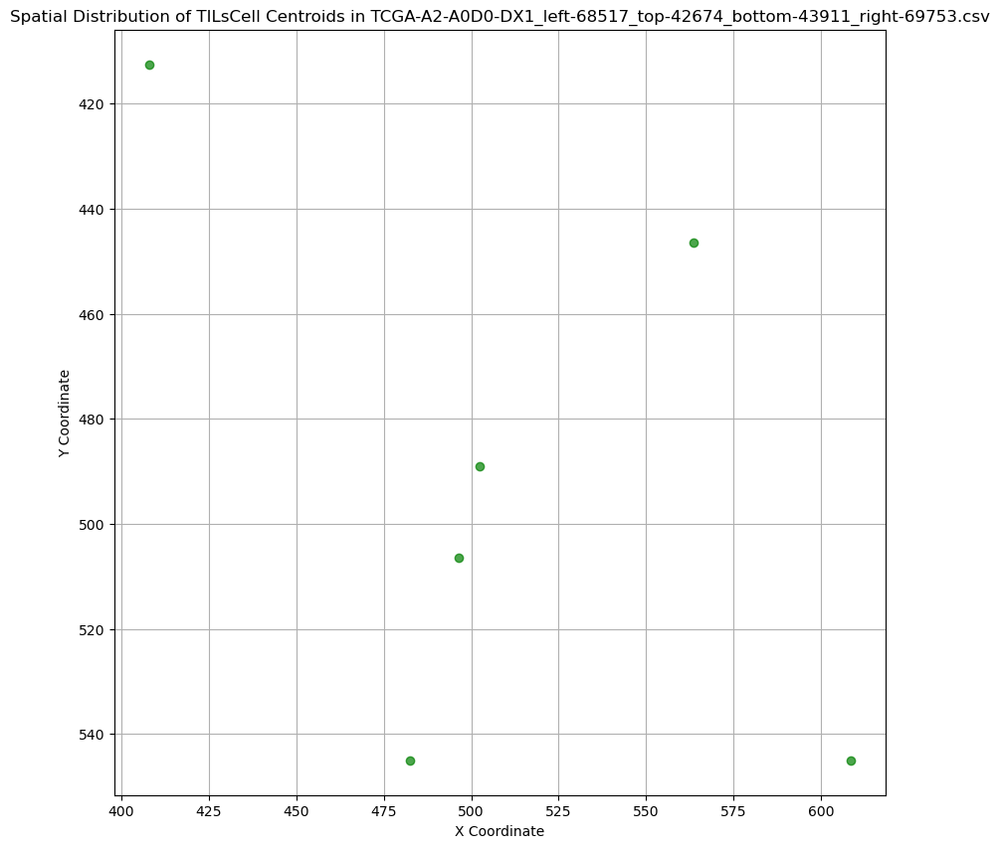

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A0D0-DX1_left-68517_top-42674_bottom-43911_right-69753.csv:
Number of TILsCell regions: 6
Mean area: 264.33
Standard deviation of area: 75.19
Coefficient of variation (heterogeneity): 0.28
No TILsCell regions found in TCGA-BH-A18V-DX1_left-54643_top-51546_bottom-52782_right-55879.csv.


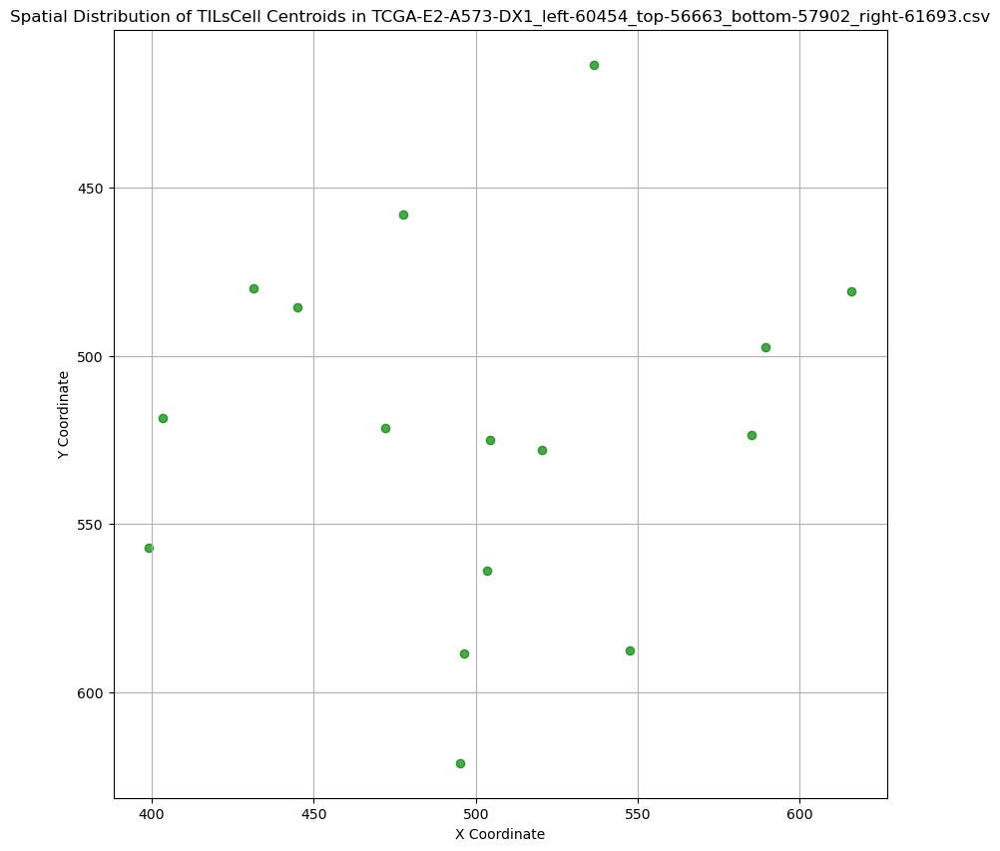

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A573-DX1_left-60454_top-56663_bottom-57902_right-61693.csv:
Number of TILsCell regions: 16
Mean area: 250.94
Standard deviation of area: 70.27
Coefficient of variation (heterogeneity): 0.28


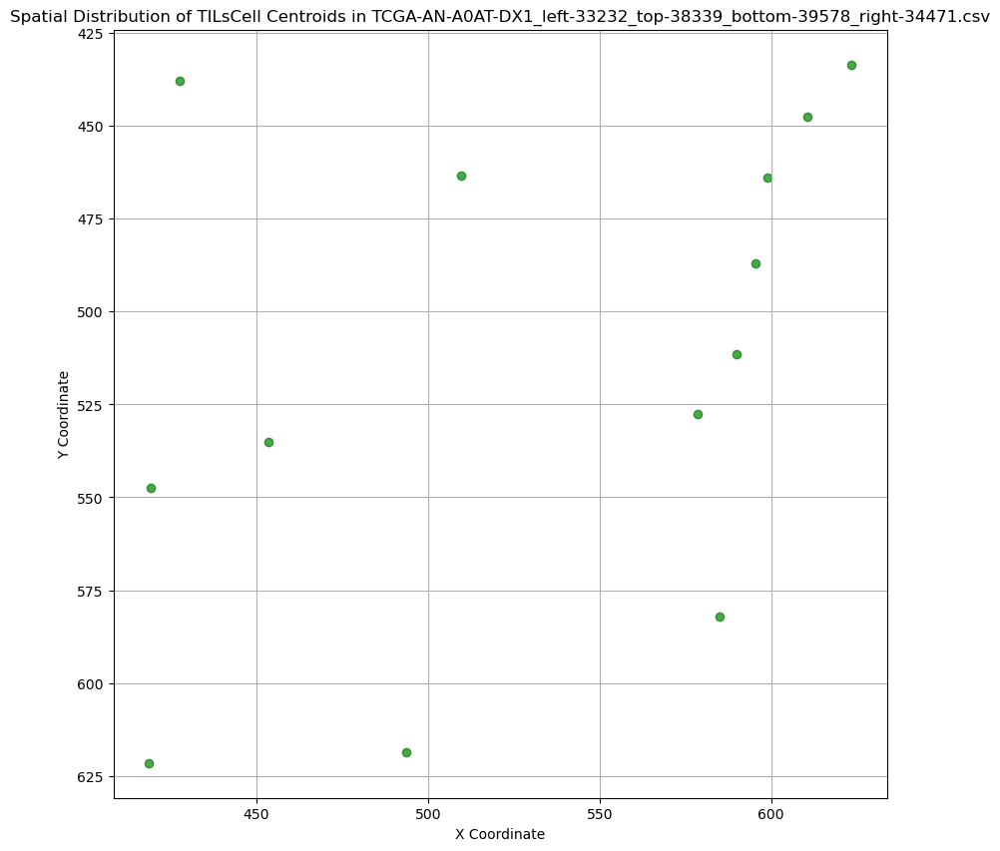

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-AN-A0AT-DX1_left-33232_top-38339_bottom-39578_right-34471.csv:
Number of TILsCell regions: 13
Mean area: 231.85
Standard deviation of area: 64.87
Coefficient of variation (heterogeneity): 0.28
No TILsCell regions found in TCGA-A2-A0YE-DX1_left-61539_top-36348_bottom-37574_right-62765.csv.


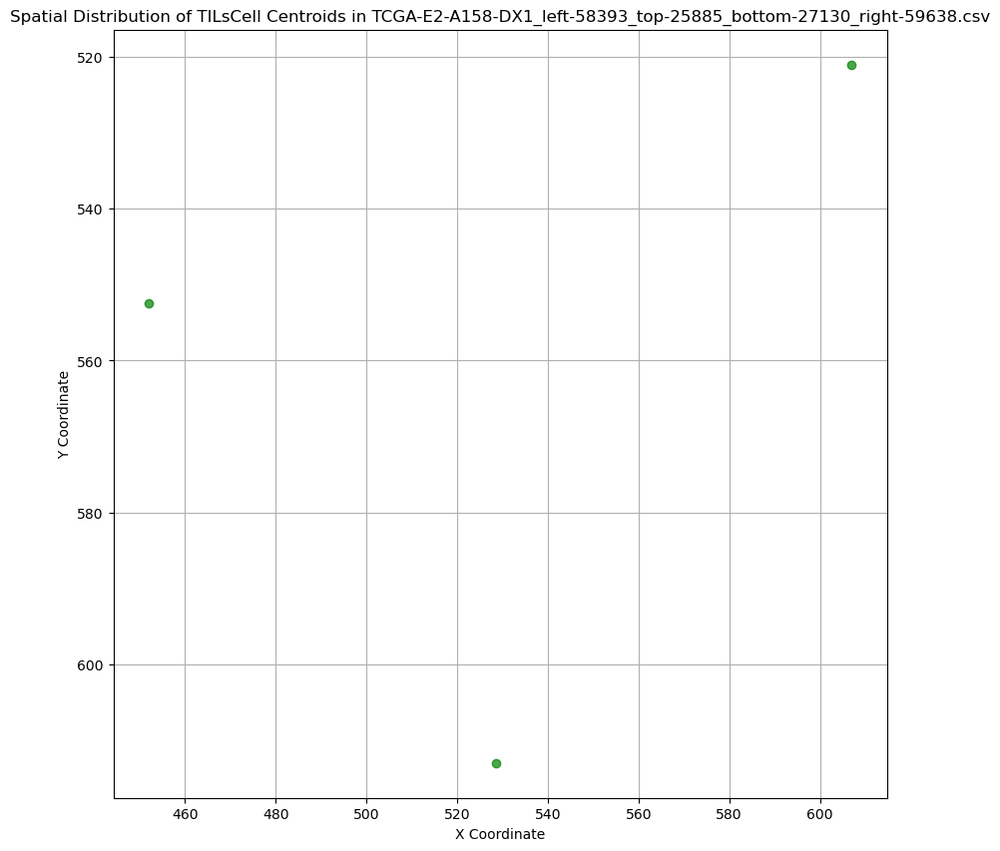

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A158-DX1_left-58393_top-25885_bottom-27130_right-59638.csv:
Number of TILsCell regions: 3
Mean area: 461.33
Standard deviation of area: 253.62
Coefficient of variation (heterogeneity): 0.55
No TILsCell regions found in TCGA-D8-A142-DX1_left-69082_top-42133_bottom-43371_right-70321.csv.


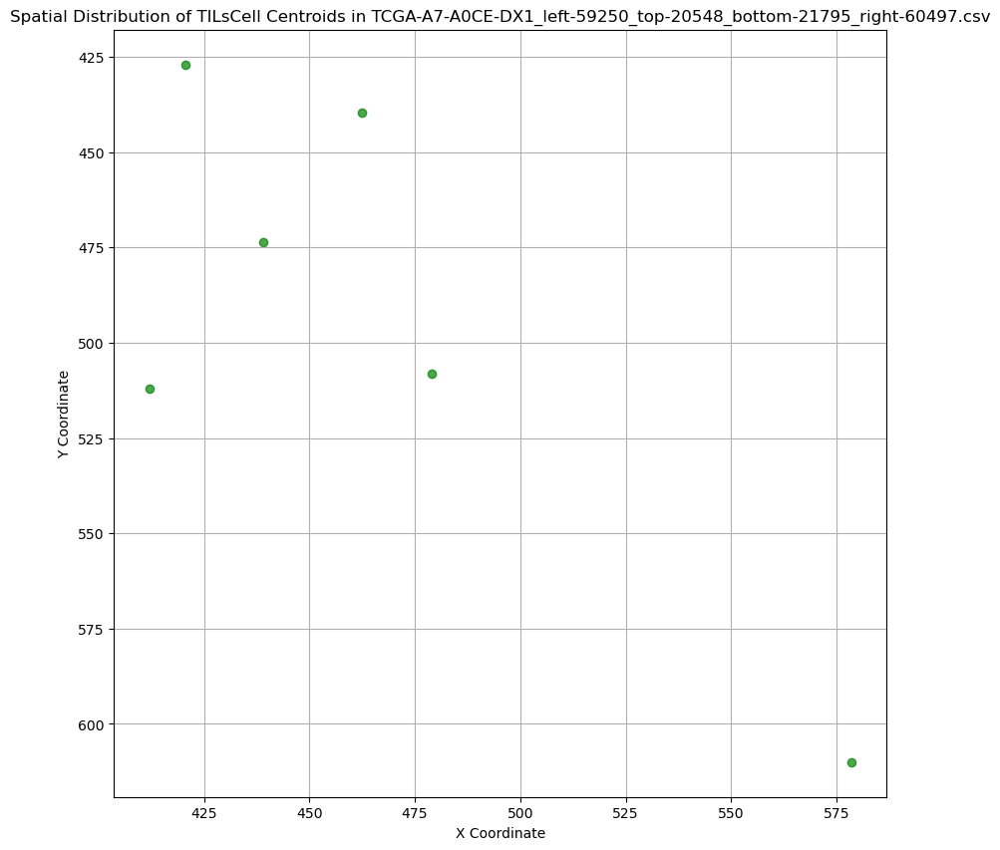

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A7-A0CE-DX1_left-59250_top-20548_bottom-21795_right-60497.csv:
Number of TILsCell regions: 6
Mean area: 404.50
Standard deviation of area: 165.64
Coefficient of variation (heterogeneity): 0.41
No TILsCell regions found in TCGA-AN-A0G0-DX1_left-35576_top-14804_bottom-16043_right-36815.csv.


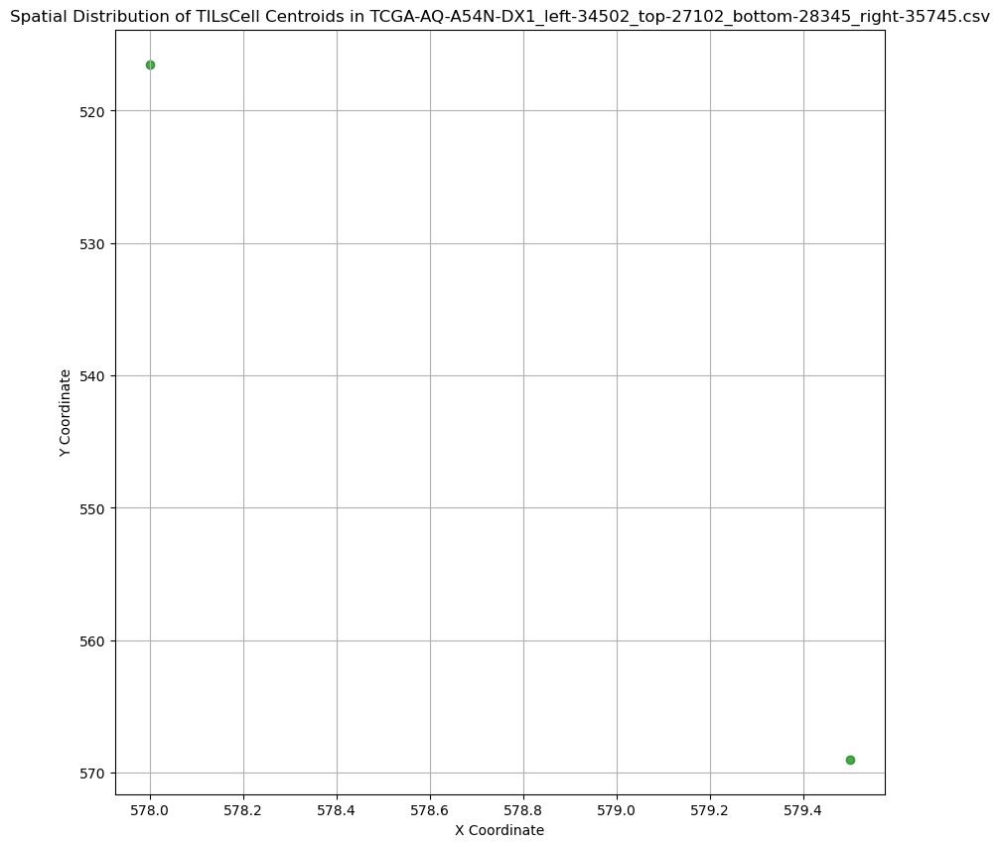

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-AQ-A54N-DX1_left-34502_top-27102_bottom-28345_right-35745.csv:
Number of TILsCell regions: 2
Mean area: 459.00
Standard deviation of area: 38.18
Coefficient of variation (heterogeneity): 0.08
No TILsCell regions found in TCGA-GM-A2DH-DX1_left-53801_top-57867_bottom-59112_right-55046.csv.


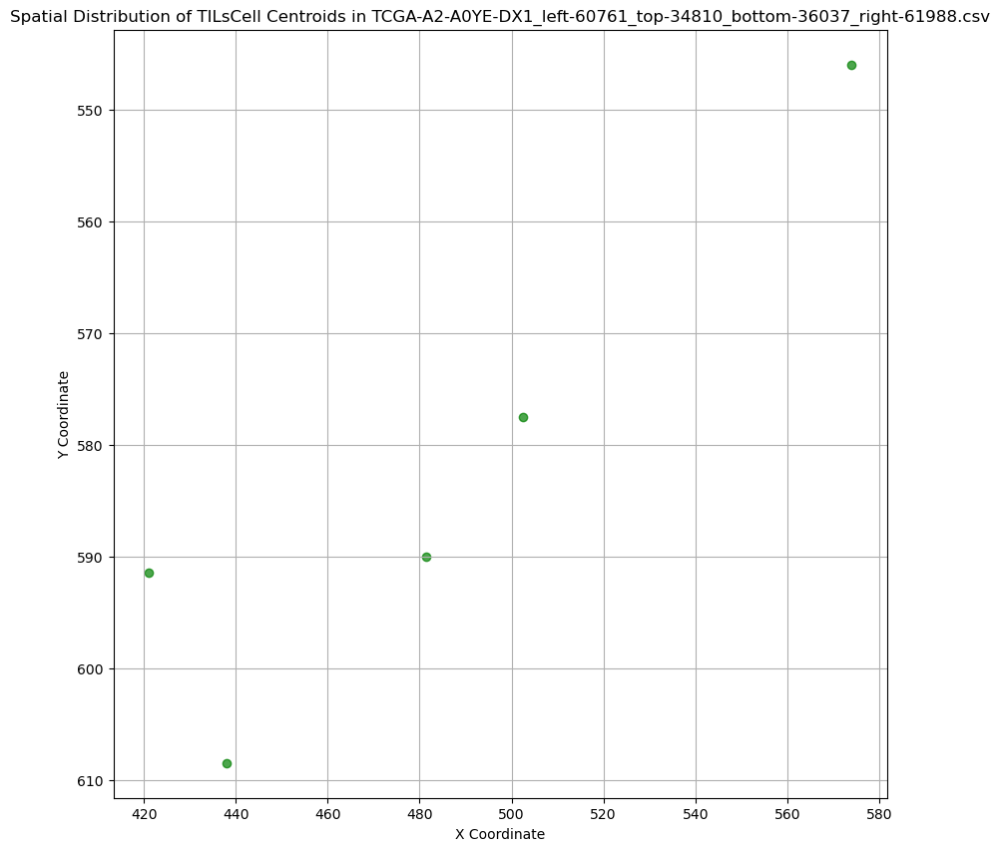

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A0YE-DX1_left-60761_top-34810_bottom-36037_right-61988.csv:
Number of TILsCell regions: 5
Mean area: 338.60
Standard deviation of area: 123.76
Coefficient of variation (heterogeneity): 0.37


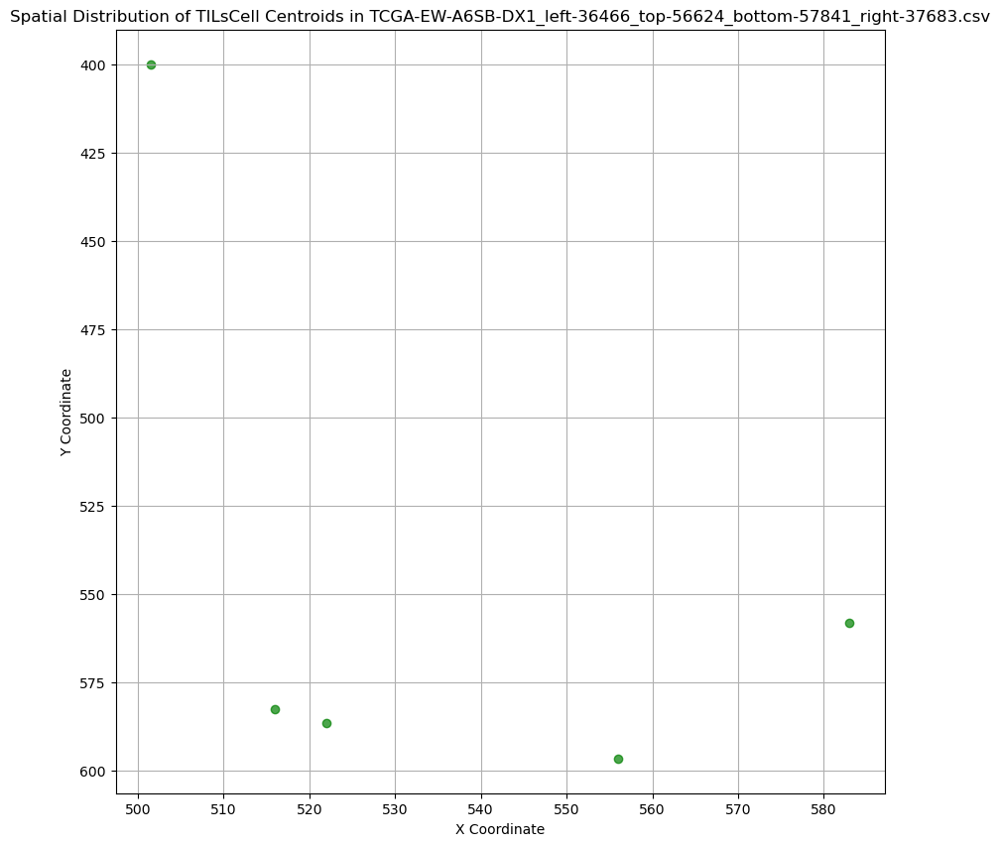

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-36466_top-56624_bottom-57841_right-37683.csv:
Number of TILsCell regions: 5
Mean area: 140.40
Standard deviation of area: 76.92
Coefficient of variation (heterogeneity): 0.55


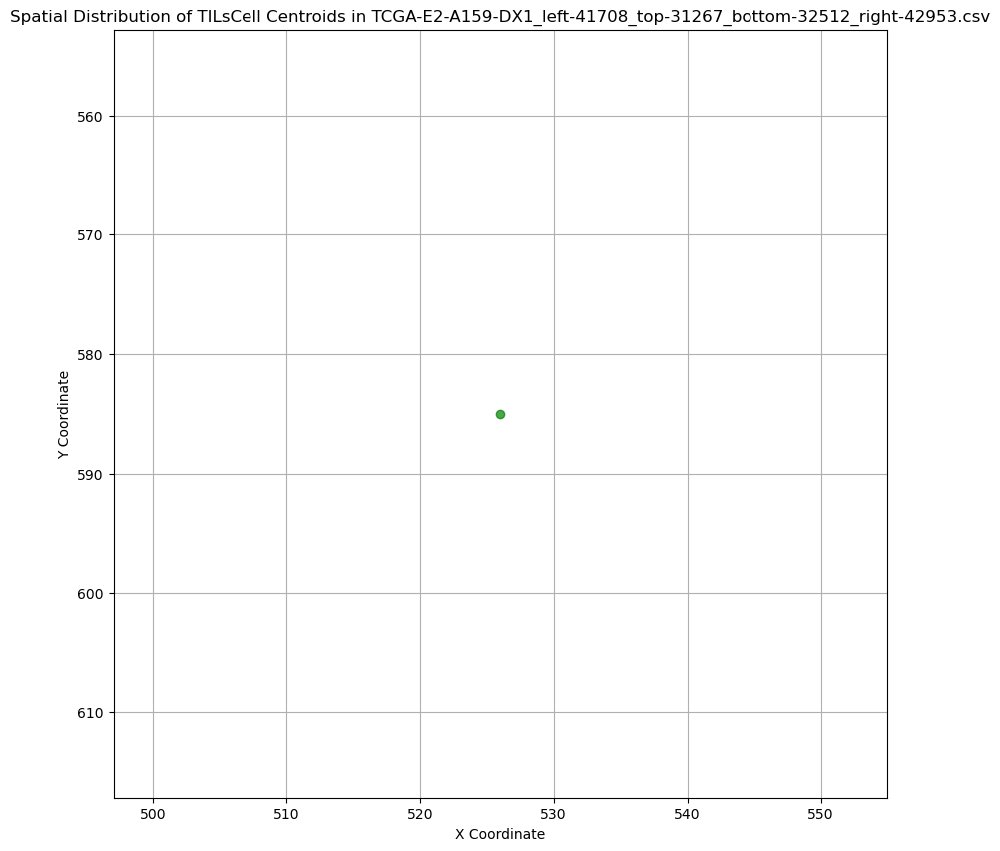

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A159-DX1_left-41708_top-31267_bottom-32512_right-42953.csv:
Number of TILsCell regions: 1
Mean area: 288.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-A2-A3XX-DX1_left-70193_top-43106_bottom-44358_right-71444.csv.
No TILsCell regions found in TCGA-E2-A159-DX1_left-39407_top-29236_bottom-30480_right-40652.csv.
No TILsCell regions found in TCGA-BH-A0E0-DX1_left-19469_top-46845_bottom-48081_right-20705.csv.
No TILsCell regions found in TCGA-A7-A0CE-DX1_left-64366_top-21842_bottom-23089_right-65612.csv.


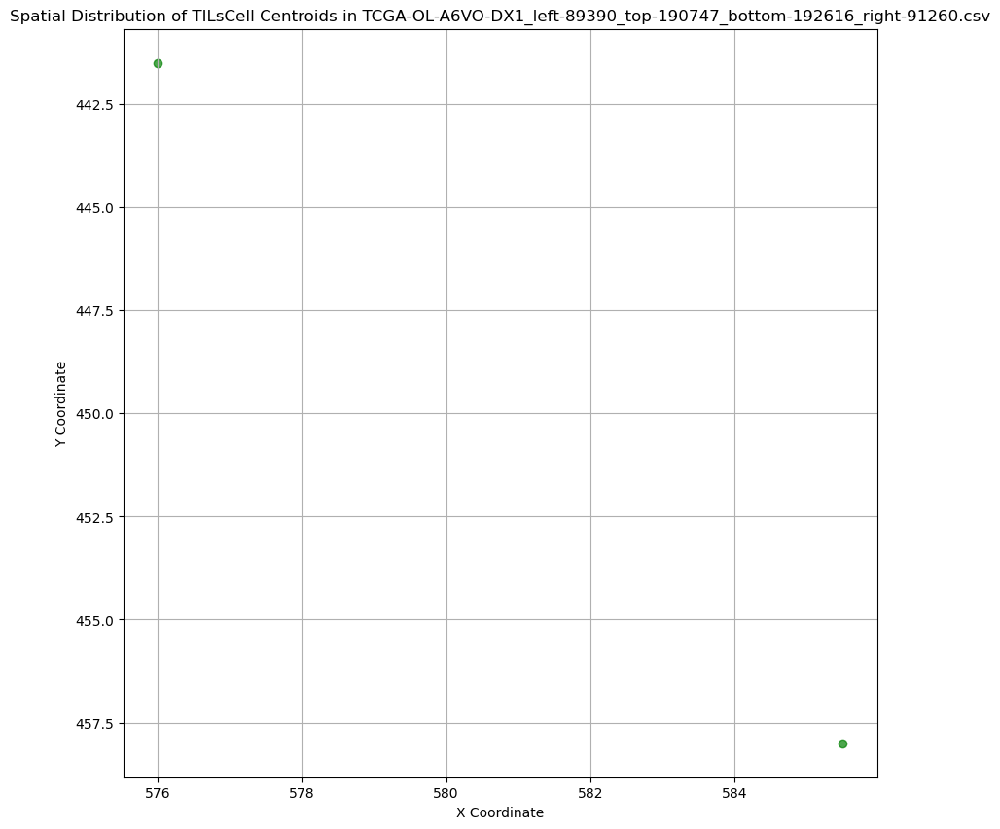

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-OL-A6VO-DX1_left-89390_top-190747_bottom-192616_right-91260.csv:
Number of TILsCell regions: 2
Mean area: 269.00
Standard deviation of area: 86.27
Coefficient of variation (heterogeneity): 0.32
No TILsCell regions found in TCGA-BH-A0E0-DX1_left-19724_top-45571_bottom-46808_right-20960.csv.
No TILsCell regions found in TCGA-A2-A0YE-DX1_left-62050_top-35829_bottom-37056_right-63277.csv.


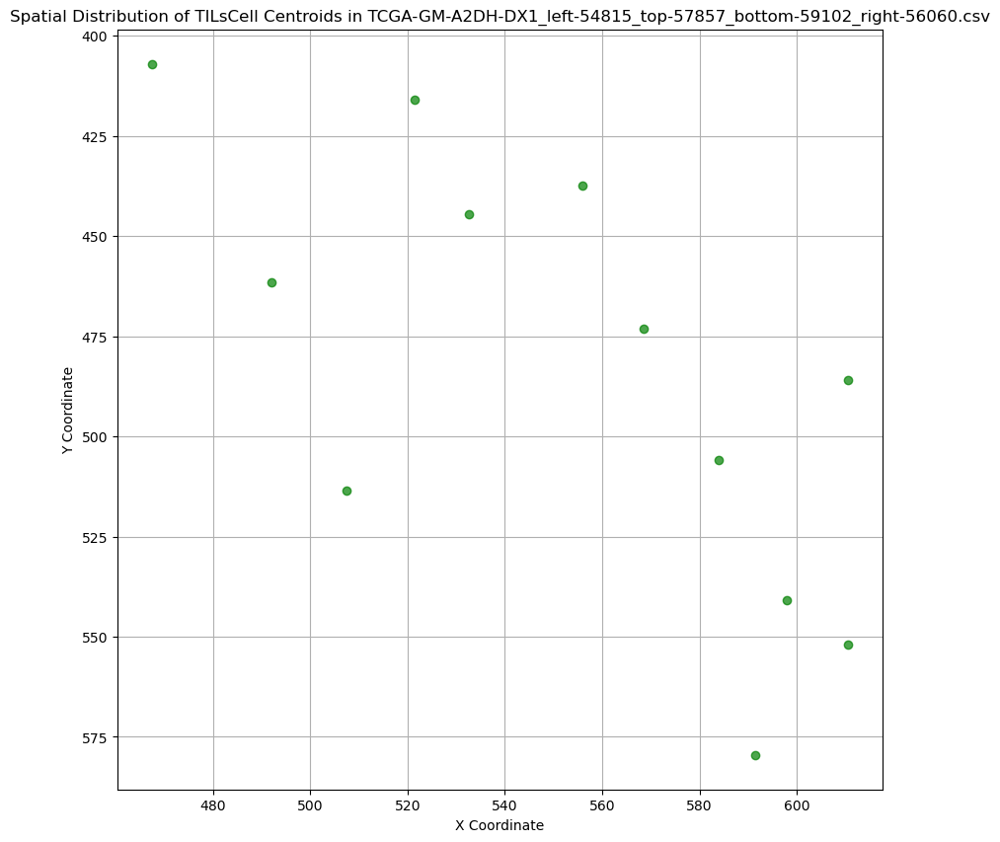

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-GM-A2DH-DX1_left-54815_top-57857_bottom-59102_right-56060.csv:
Number of TILsCell regions: 12
Mean area: 274.42
Standard deviation of area: 46.55
Coefficient of variation (heterogeneity): 0.17
No TILsCell regions found in TCGA-A7-A6VV-DX1_left-48929_top-38013_bottom-39258_right-50174.csv.


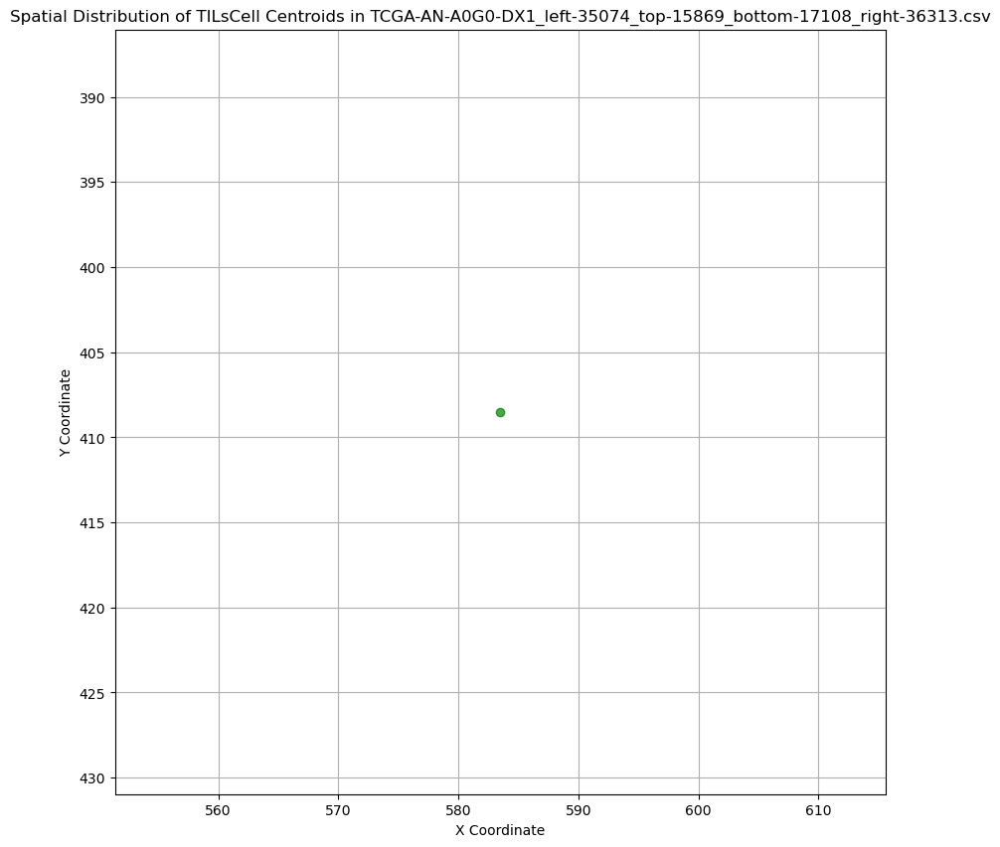

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-AN-A0G0-DX1_left-35074_top-15869_bottom-17108_right-36313.csv:
Number of TILsCell regions: 1
Mean area: 837.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-GM-A2DH-DX1_left-55071_top-56835_bottom-58080_right-56316.csv.


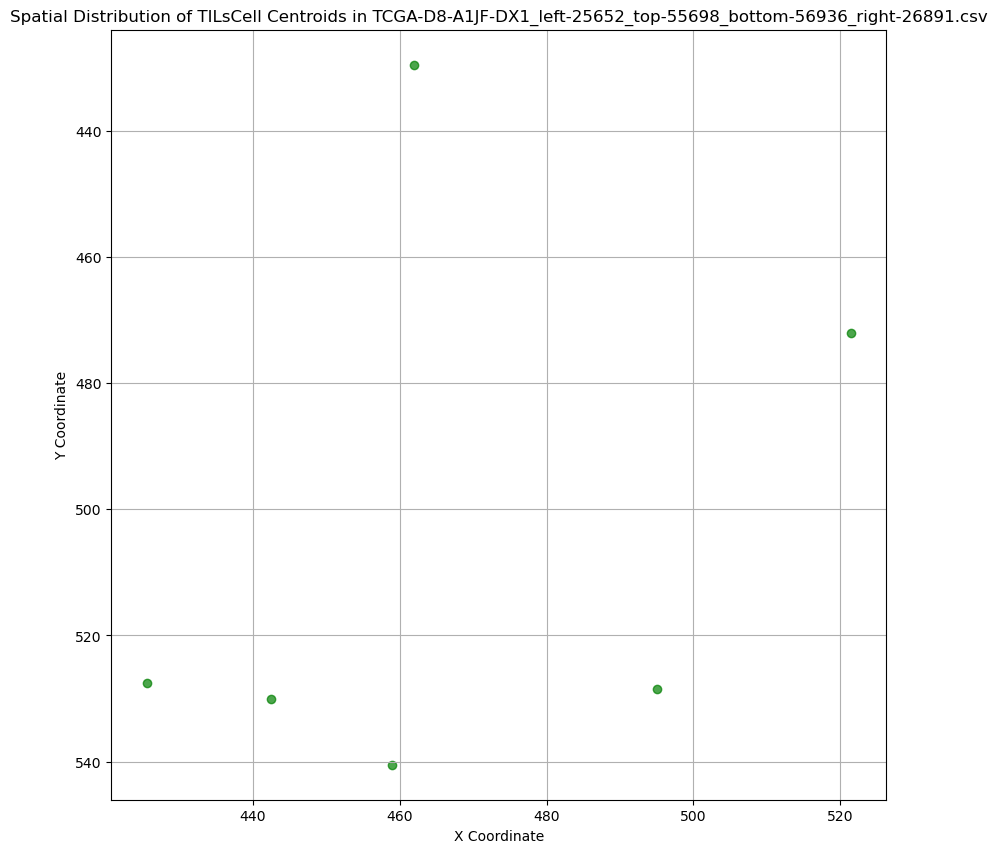

TILsCell Spatial Analysis for TCGA-D8-A1JF-DX1_left-25652_top-55698_bottom-56936_right-26891.csv:
Number of TILsCell regions: 6
Mean area: 226.17
Standard deviation of area: 40.59
Coefficient of variation (heterogeneity): 0.18
No TILsCell regions found in TCGA-A2-A3XX-DX1_left-71477_top-42849_bottom-44100_right-72729.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

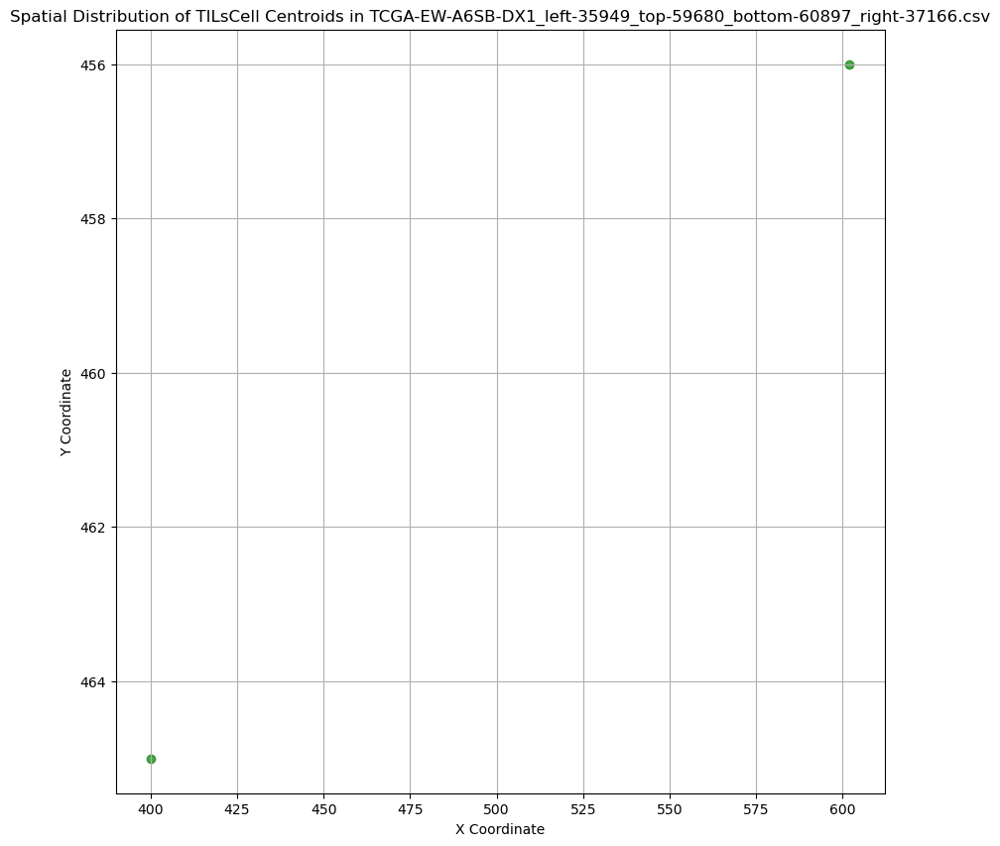

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-35949_top-59680_bottom-60897_right-37166.csv:
Number of TILsCell regions: 2
Mean area: 120.00
Standard deviation of area: 28.28
Coefficient of variation (heterogeneity): 0.24


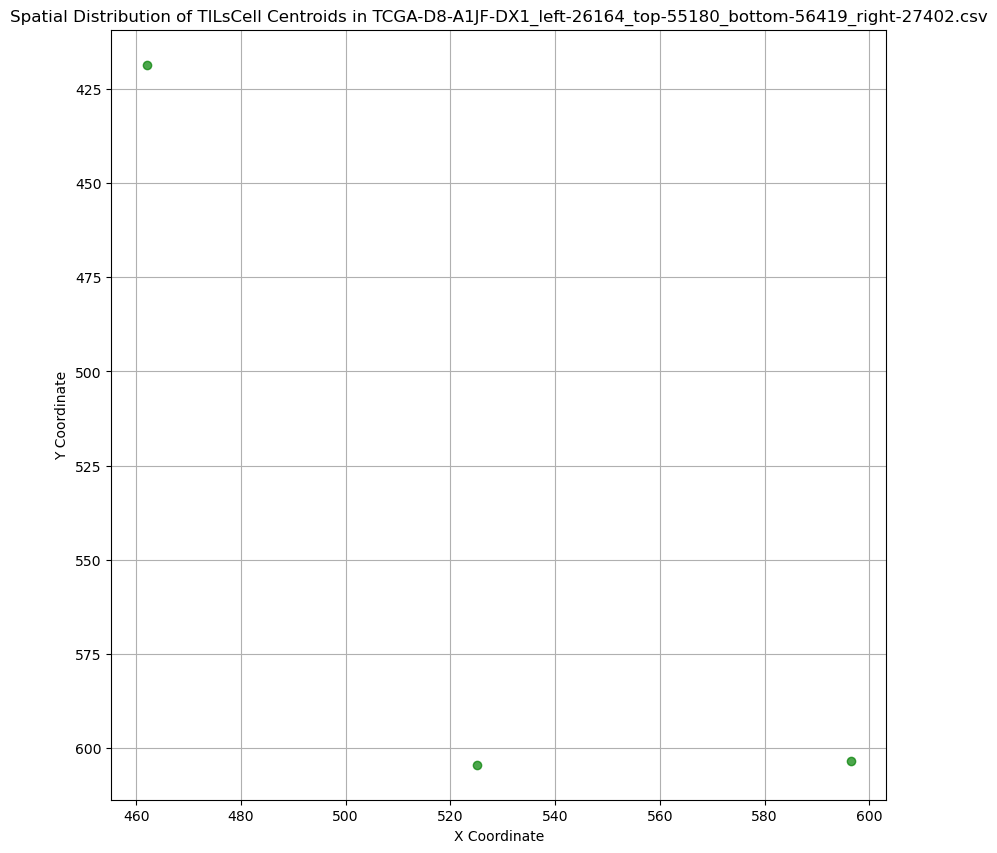

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A1JF-DX1_left-26164_top-55180_bottom-56419_right-27402.csv:
Number of TILsCell regions: 3
Mean area: 207.67
Standard deviation of area: 51.23
Coefficient of variation (heterogeneity): 0.25


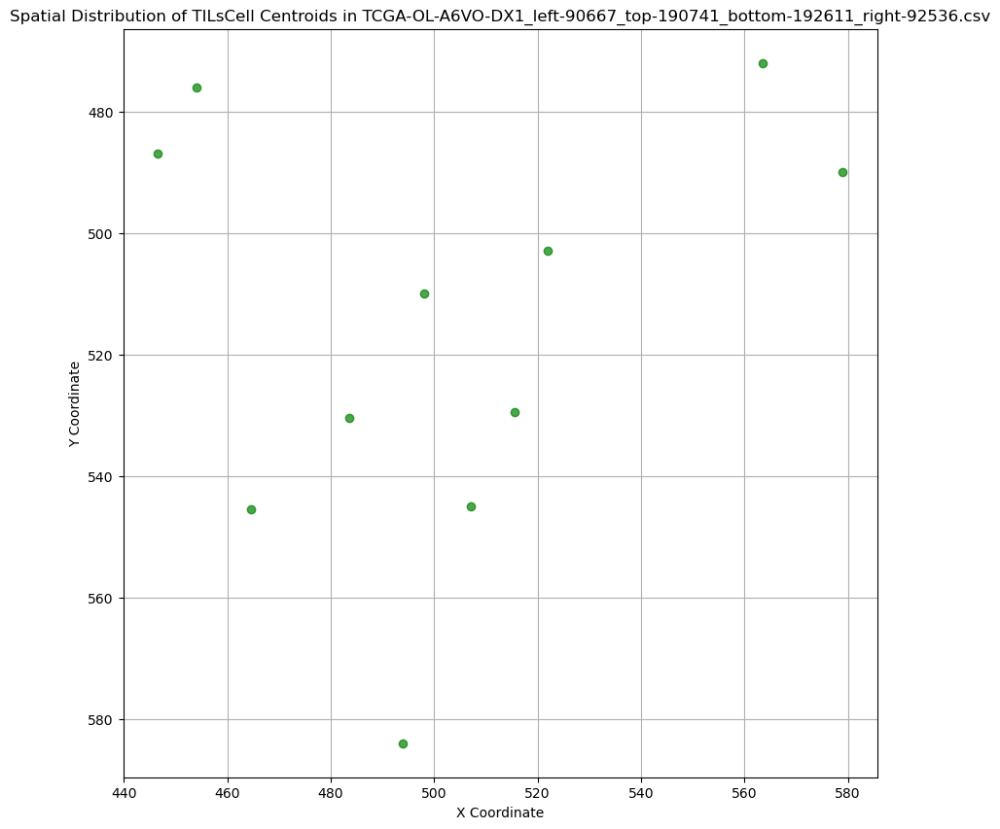

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-OL-A6VO-DX1_left-90667_top-190741_bottom-192611_right-92536.csv:
Number of TILsCell regions: 11
Mean area: 328.82
Standard deviation of area: 77.52
Coefficient of variation (heterogeneity): 0.24
No TILsCell regions found in TCGA-E2-A1B6-DX1_left-19864_top-53717_bottom-54962_right-21108.csv.


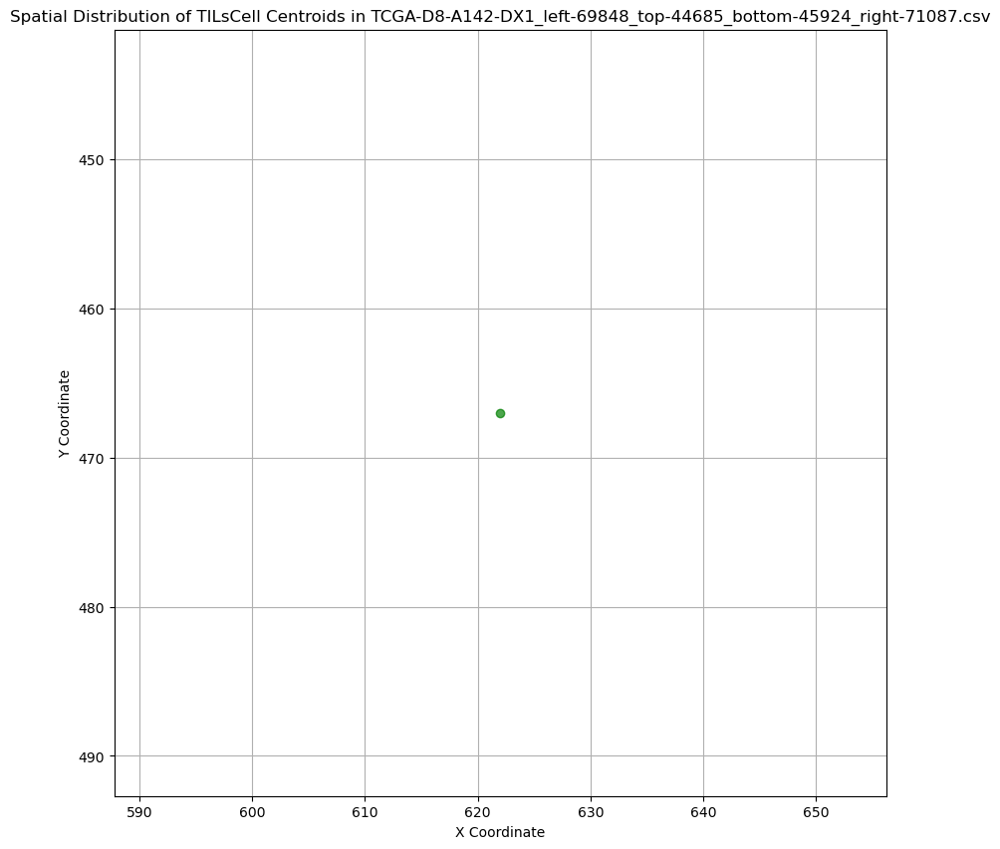

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A142-DX1_left-69848_top-44685_bottom-45924_right-71087.csv:
Number of TILsCell regions: 1
Mean area: 140.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


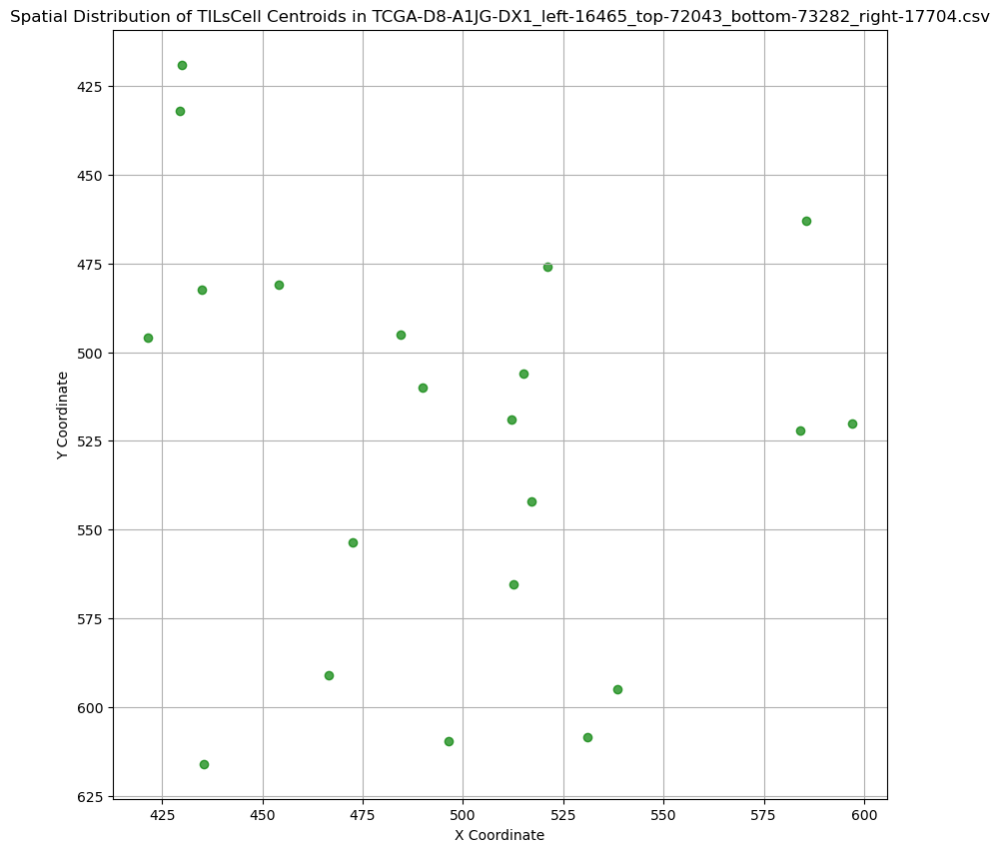

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A1JG-DX1_left-16465_top-72043_bottom-73282_right-17704.csv:
Number of TILsCell regions: 21
Mean area: 233.76
Standard deviation of area: 83.29
Coefficient of variation (heterogeneity): 0.36
No TILsCell regions found in TCGA-A2-A0D2-DX1_left-98697_top-22568_bottom-23807_right-99936.csv.
No TILsCell regions found in TCGA-S3-AA10-DX1_left-44859_top-24785_bottom-26001_right-46075.csv.


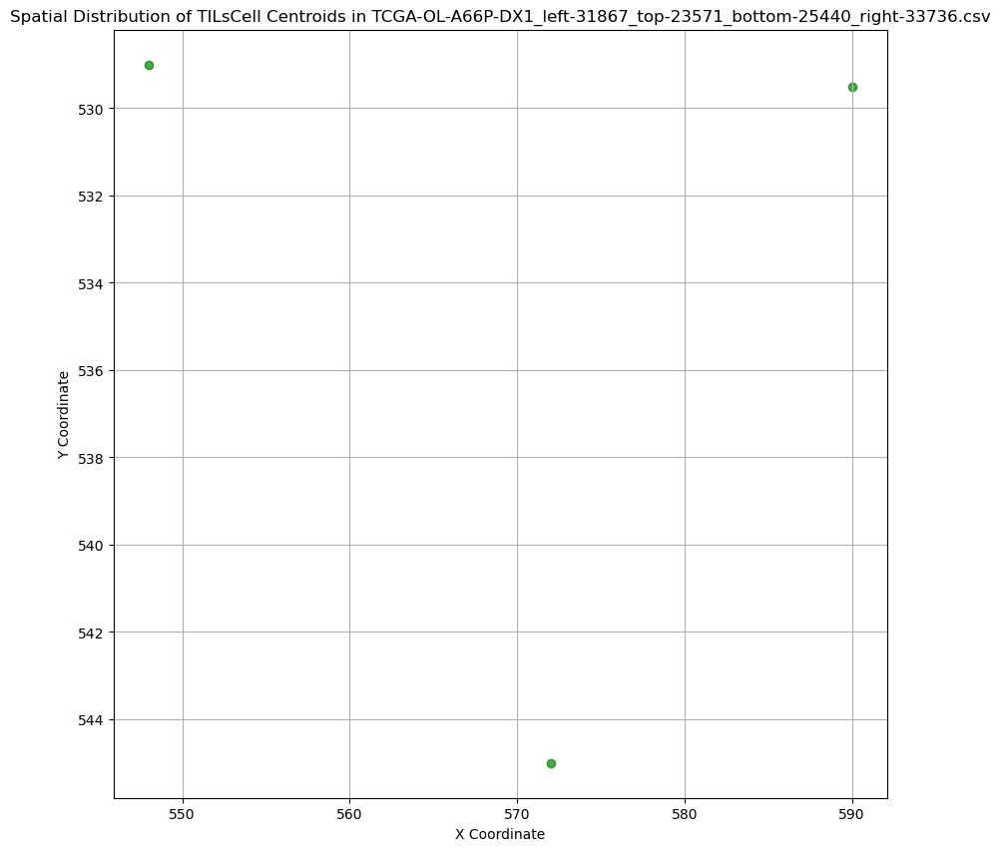

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-OL-A66P-DX1_left-31867_top-23571_bottom-25440_right-33736.csv:
Number of TILsCell regions: 3
Mean area: 351.33
Standard deviation of area: 142.97
Coefficient of variation (heterogeneity): 0.41
No TILsCell regions found in TCGA-A2-A04T-DX1_left-72924_top-41160_bottom-42387_right-74151.csv.
No TILsCell regions found in TCGA-D8-A27M-DX1_left-55502_top-19454_bottom-20699_right-56747.csv.


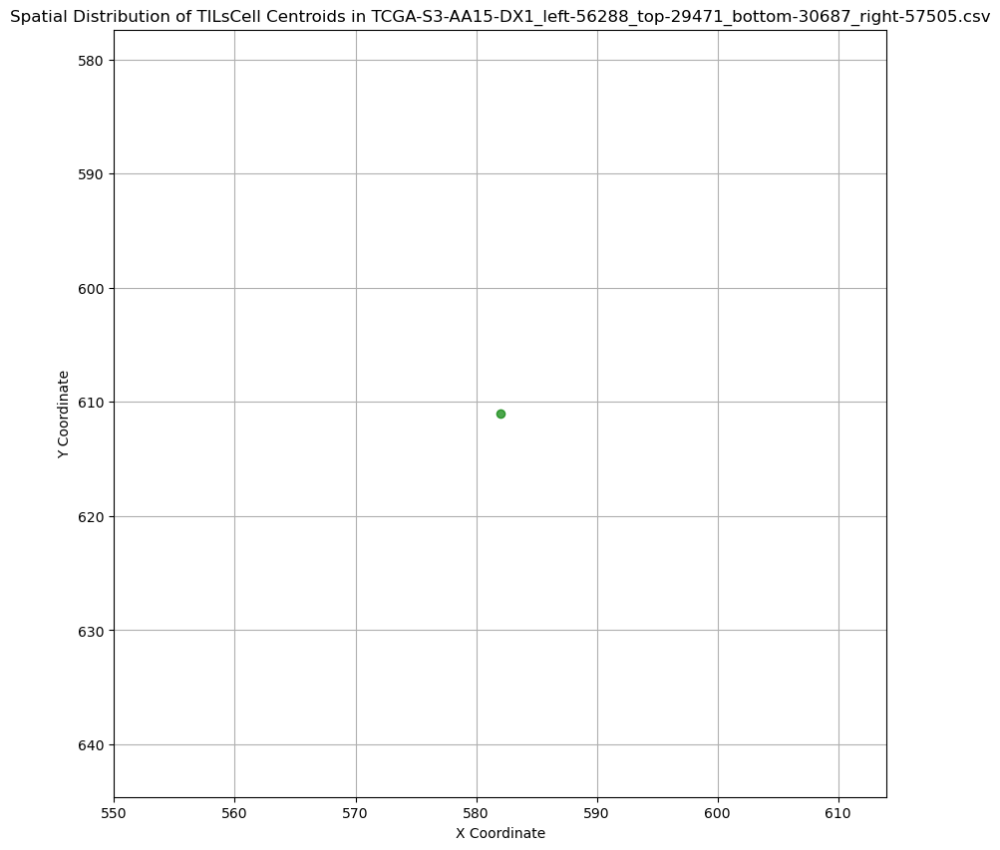

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-S3-AA15-DX1_left-56288_top-29471_bottom-30687_right-57505.csv:
Number of TILsCell regions: 1
Mean area: 560.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


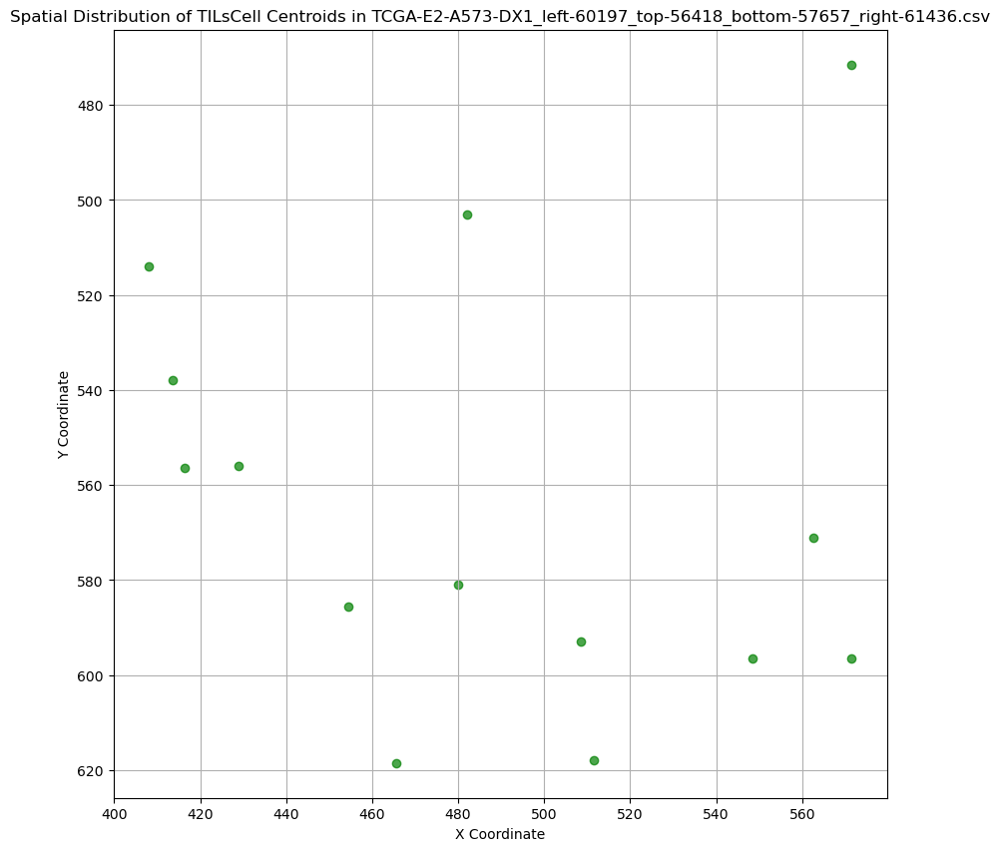

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A573-DX1_left-60197_top-56418_bottom-57657_right-61436.csv:
Number of TILsCell regions: 14
Mean area: 343.29
Standard deviation of area: 99.50
Coefficient of variation (heterogeneity): 0.29


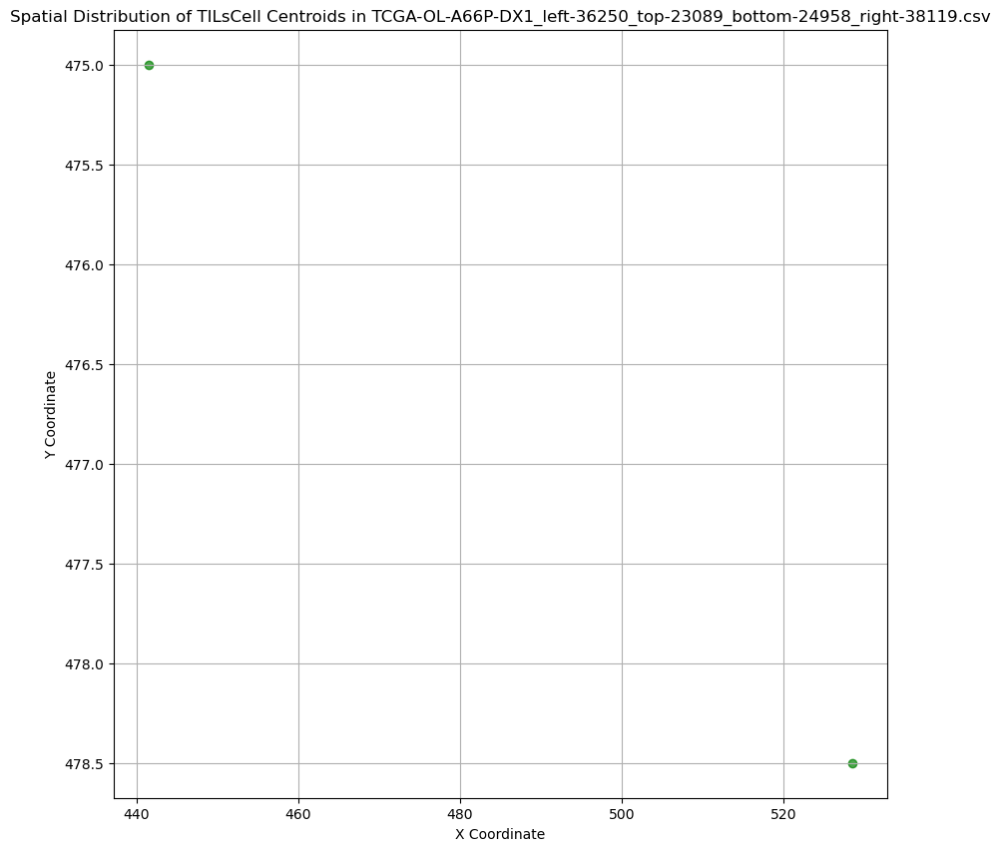

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-OL-A66P-DX1_left-36250_top-23089_bottom-24958_right-38119.csv:
Number of TILsCell regions: 2
Mean area: 175.50
Standard deviation of area: 27.58
Coefficient of variation (heterogeneity): 0.16
No TILsCell regions found in TCGA-D8-A1JF-DX1_left-25660_top-55436_bottom-56675_right-26899.csv.
No TILsCell regions found in TCGA-A2-A3XU-DX1_left-36409_top-26686_bottom-27937_right-37660.csv.
No TILsCell regions found in TCGA-A2-A0YM-DX1_left-48886_top-66937_bottom-68164_right-50113.csv.


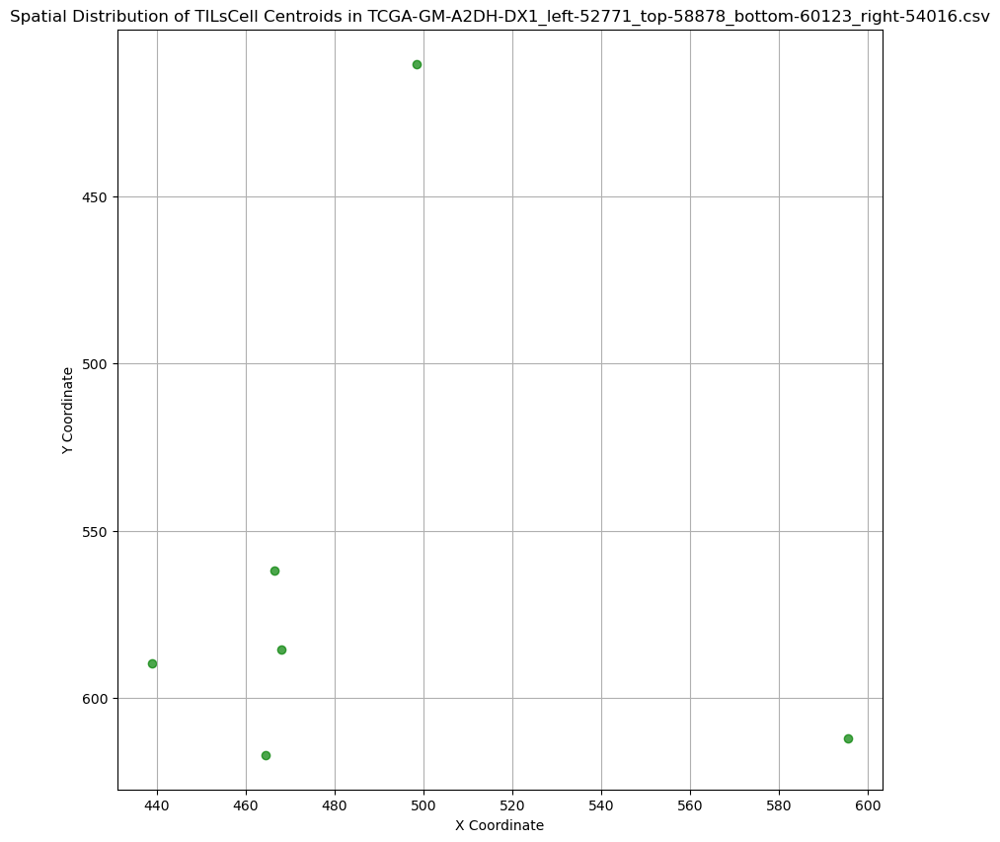

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-GM-A2DH-DX1_left-52771_top-58878_bottom-60123_right-54016.csv:
Number of TILsCell regions: 6
Mean area: 330.83
Standard deviation of area: 45.85
Coefficient of variation (heterogeneity): 0.14
No TILsCell regions found in TCGA-GM-A2DB-DX1_left-52650_top-43401_bottom-44646_right-53894.csv.


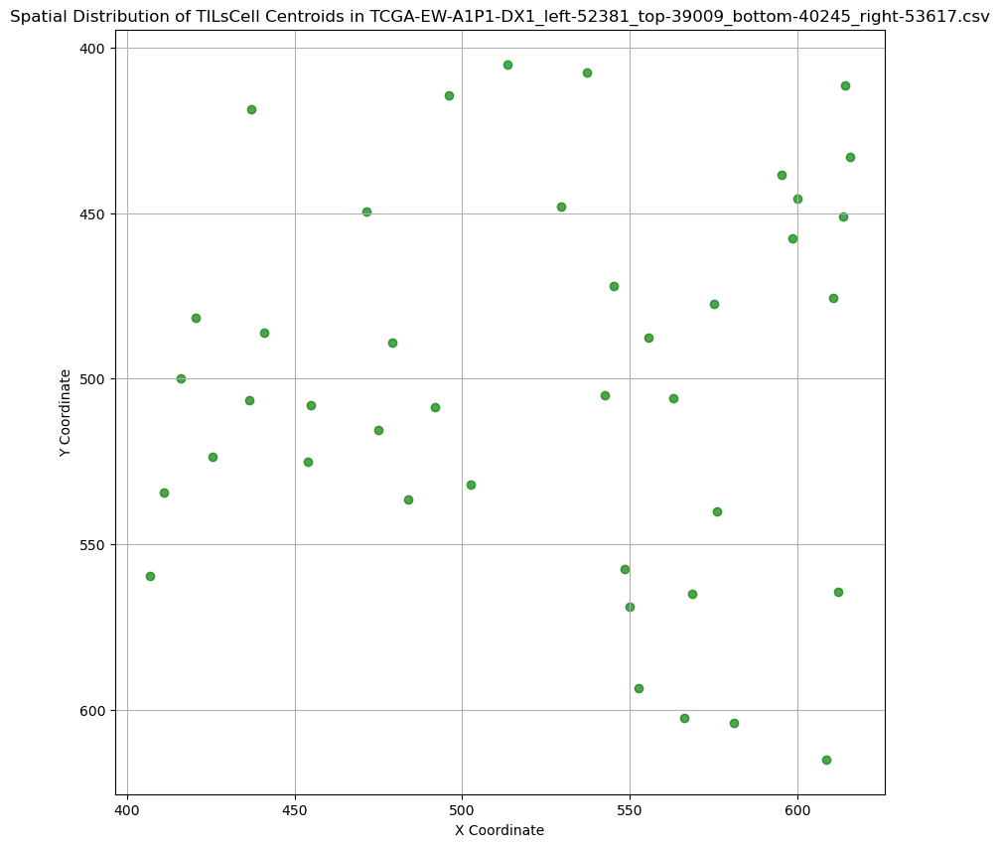

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A1P1-DX1_left-52381_top-39009_bottom-40245_right-53617.csv:
Number of TILsCell regions: 41
Mean area: 354.12
Standard deviation of area: 98.47
Coefficient of variation (heterogeneity): 0.28


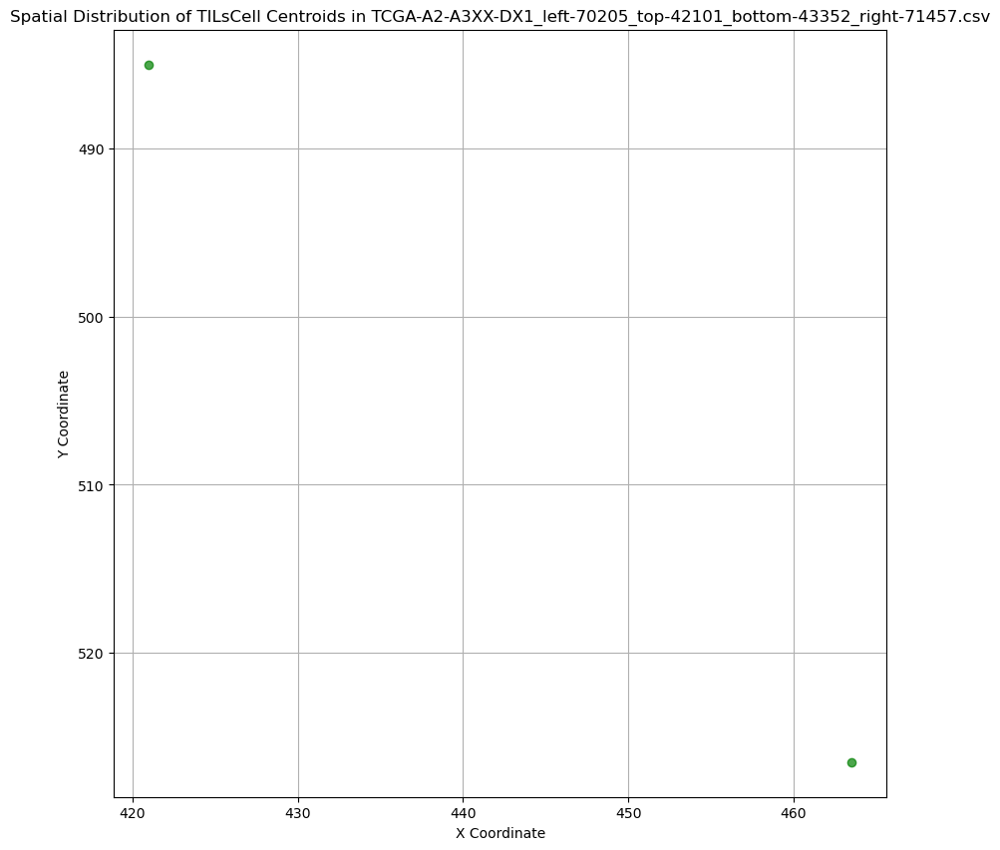

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A3XX-DX1_left-70205_top-42101_bottom-43352_right-71457.csv:
Number of TILsCell regions: 2
Mean area: 457.50
Standard deviation of area: 286.38
Coefficient of variation (heterogeneity): 0.63
No TILsCell regions found in TCGA-AR-A0U4-DX1_left-41921_top-70301_bottom-71546_right-43166.csv.


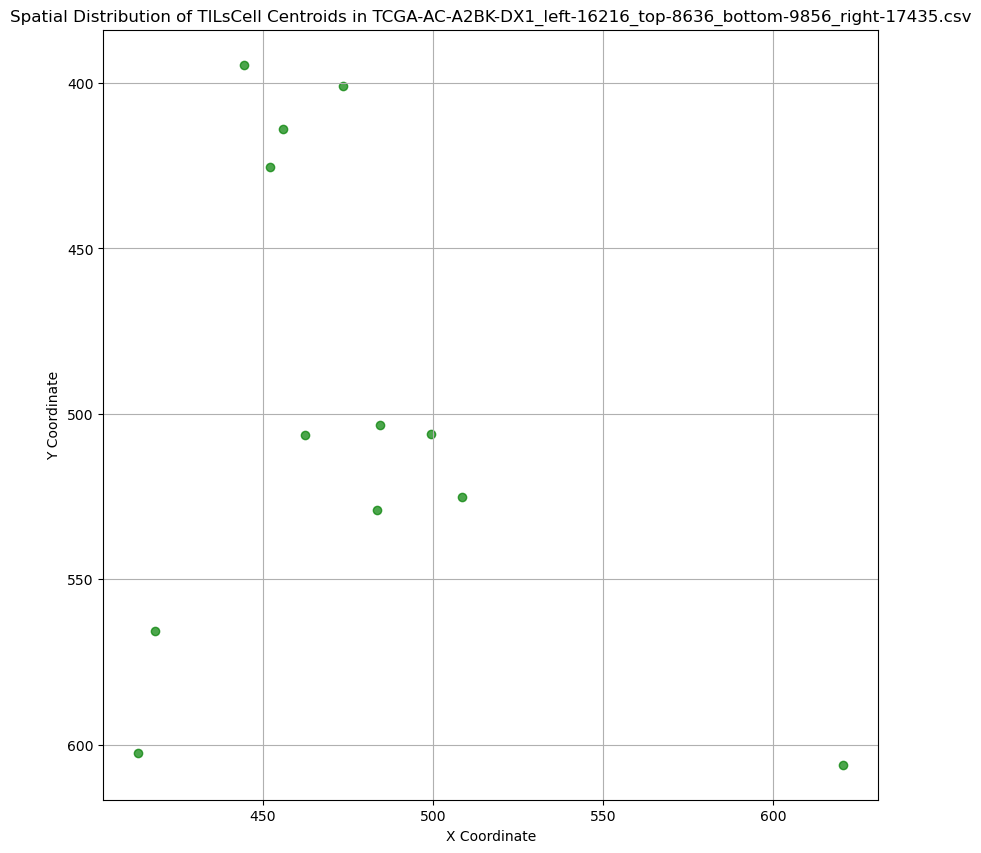

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-AC-A2BK-DX1_left-16216_top-8636_bottom-9856_right-17435.csv:
Number of TILsCell regions: 12
Mean area: 235.25
Standard deviation of area: 86.99
Coefficient of variation (heterogeneity): 0.37


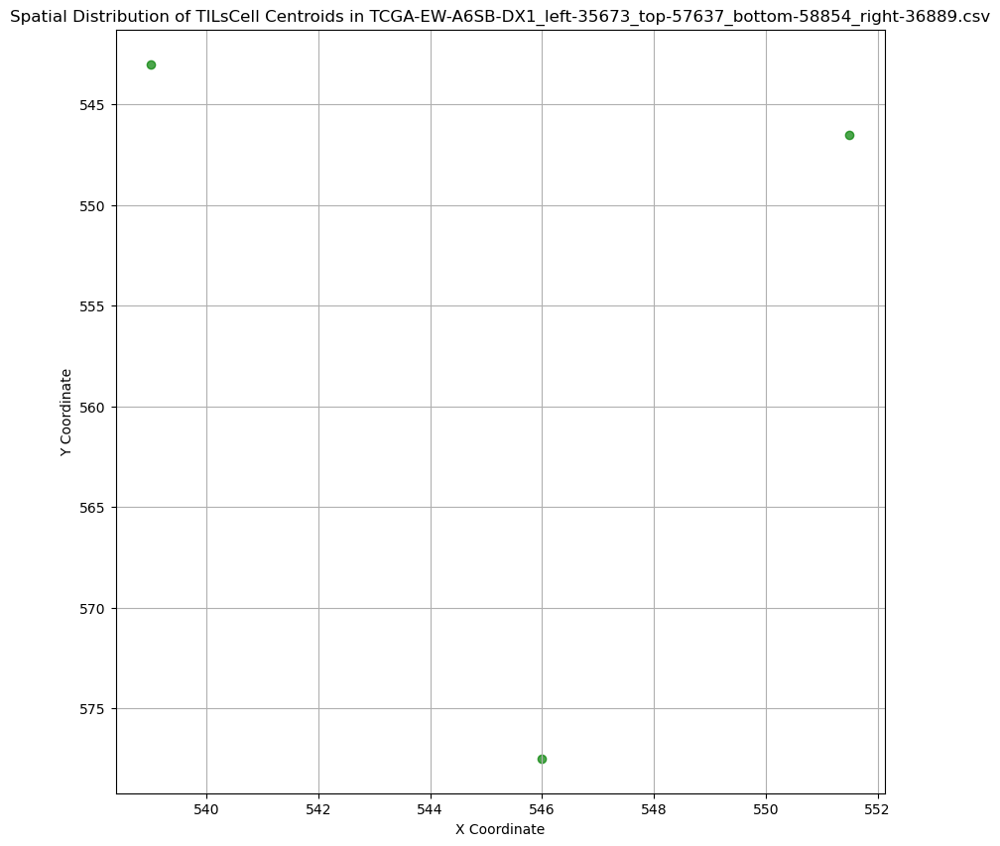

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-35673_top-57637_bottom-58854_right-36889.csv:
Number of TILsCell regions: 3
Mean area: 207.67
Standard deviation of area: 114.61
Coefficient of variation (heterogeneity): 0.55
No TILsCell regions found in TCGA-A2-A0T2-DX1_left-67677_top-57279_bottom-58518_right-68915.csv.


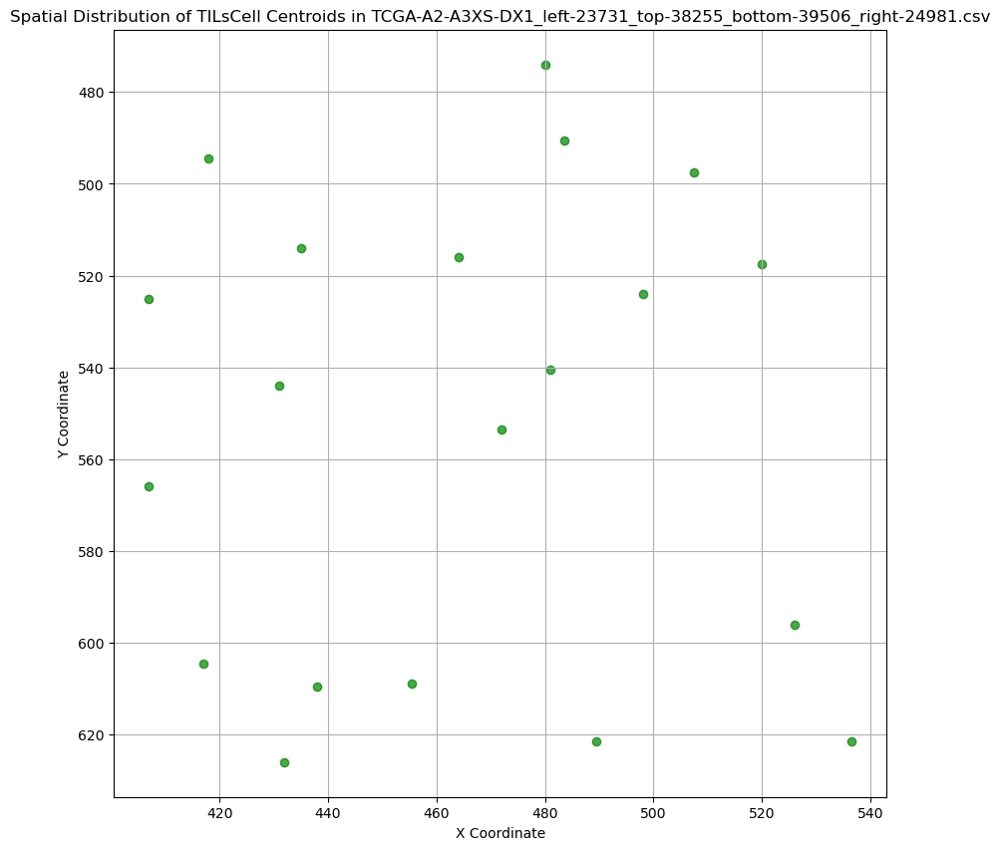

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A3XS-DX1_left-23731_top-38255_bottom-39506_right-24981.csv:
Number of TILsCell regions: 20
Mean area: 308.20
Standard deviation of area: 83.44
Coefficient of variation (heterogeneity): 0.27
No TILsCell regions found in TCGA-A7-A6VV-DX1_left-49955_top-37490_bottom-38735_right-51199.csv.


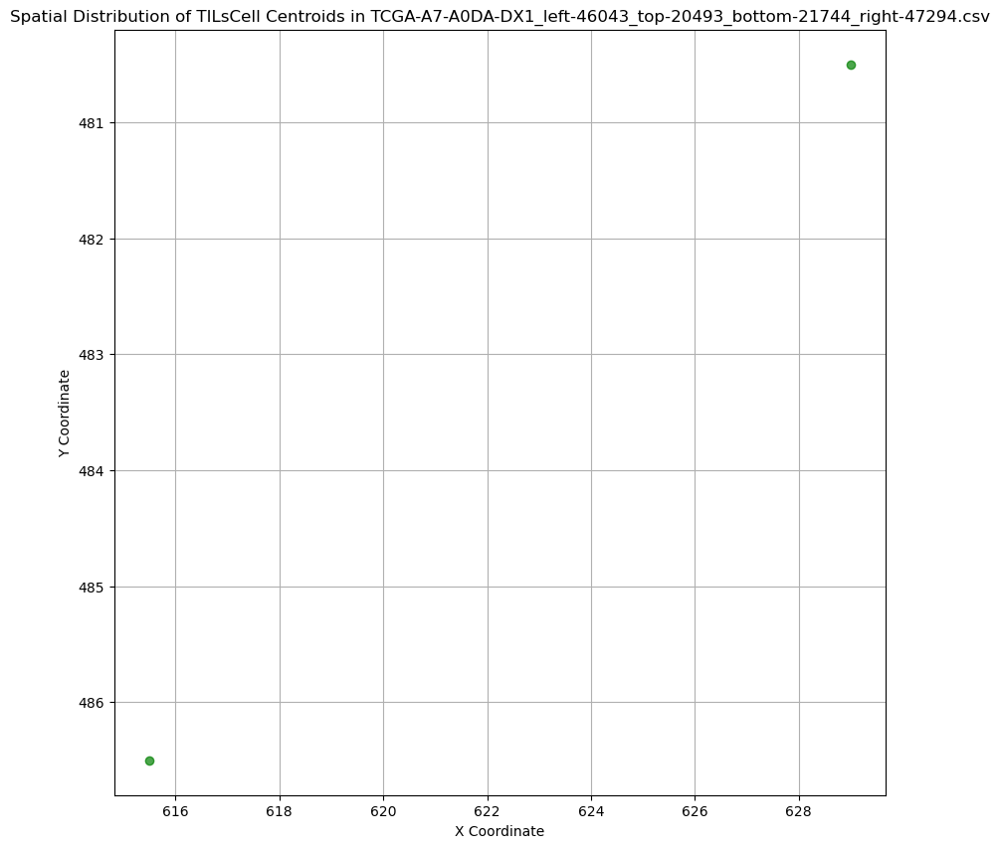

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A7-A0DA-DX1_left-46043_top-20493_bottom-21744_right-47294.csv:
Number of TILsCell regions: 2
Mean area: 249.50
Standard deviation of area: 113.84
Coefficient of variation (heterogeneity): 0.46


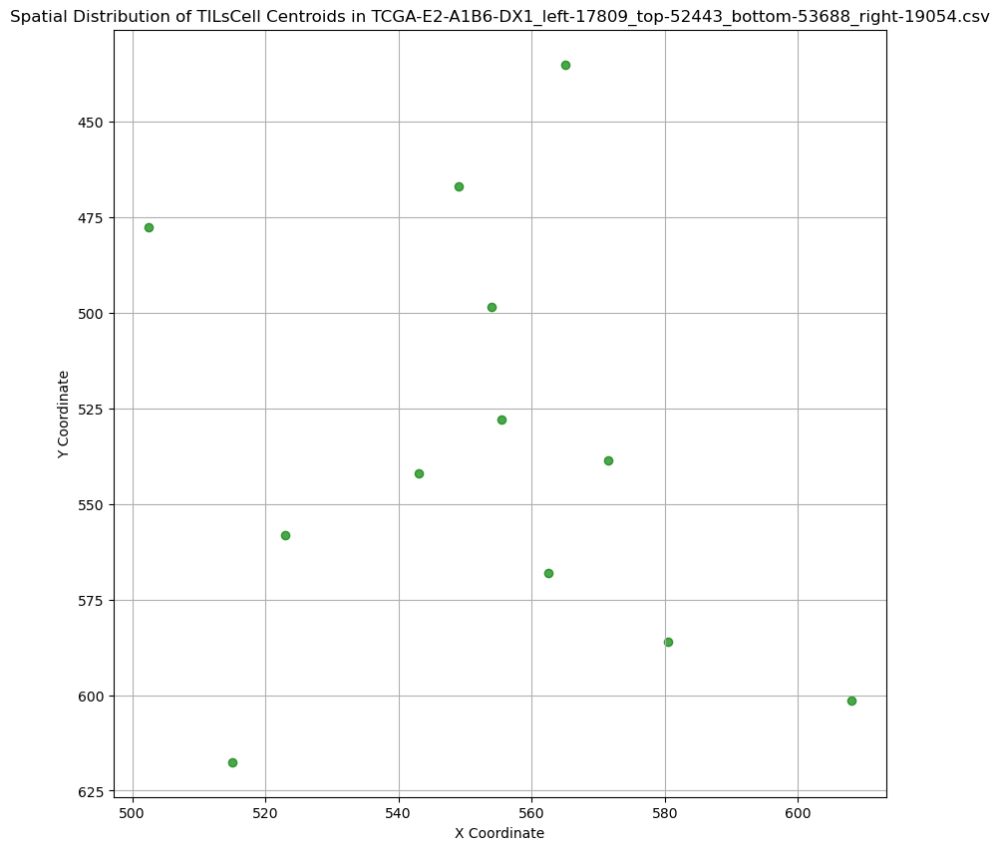

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A1B6-DX1_left-17809_top-52443_bottom-53688_right-19054.csv:
Number of TILsCell regions: 12
Mean area: 279.67
Standard deviation of area: 98.26
Coefficient of variation (heterogeneity): 0.35
No TILsCell regions found in TCGA-D8-A1XQ-DX1_left-63840_top-35900_bottom-37145_right-65085.csv.
No TILsCell regions found in TCGA-A2-A0D0-DX1_left-71561_top-45494_bottom-46730_right-72798.csv.
No TILsCell regions found in TCGA-A2-A0YE-DX1_left-61539_top-34047_bottom-35274_right-62765.csv.


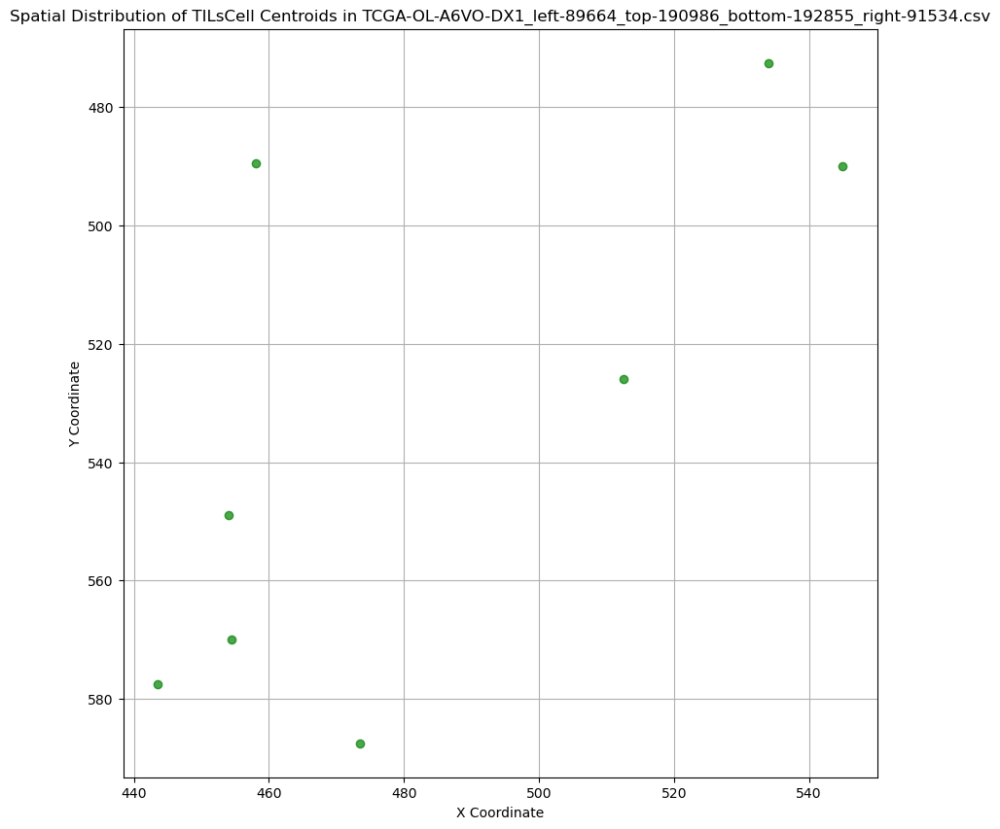

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-OL-A6VO-DX1_left-89664_top-190986_bottom-192855_right-91534.csv:
Number of TILsCell regions: 8
Mean area: 260.75
Standard deviation of area: 51.53
Coefficient of variation (heterogeneity): 0.20
No TILsCell regions found in TCGA-E2-A1LI-DX1_left-48556_top-22050_bottom-23289_right-49795.csv.
No TILsCell regions found in TCGA-EW-A6SB-DX1_left-37477_top-57628_bottom-58845_right-38694.csv.


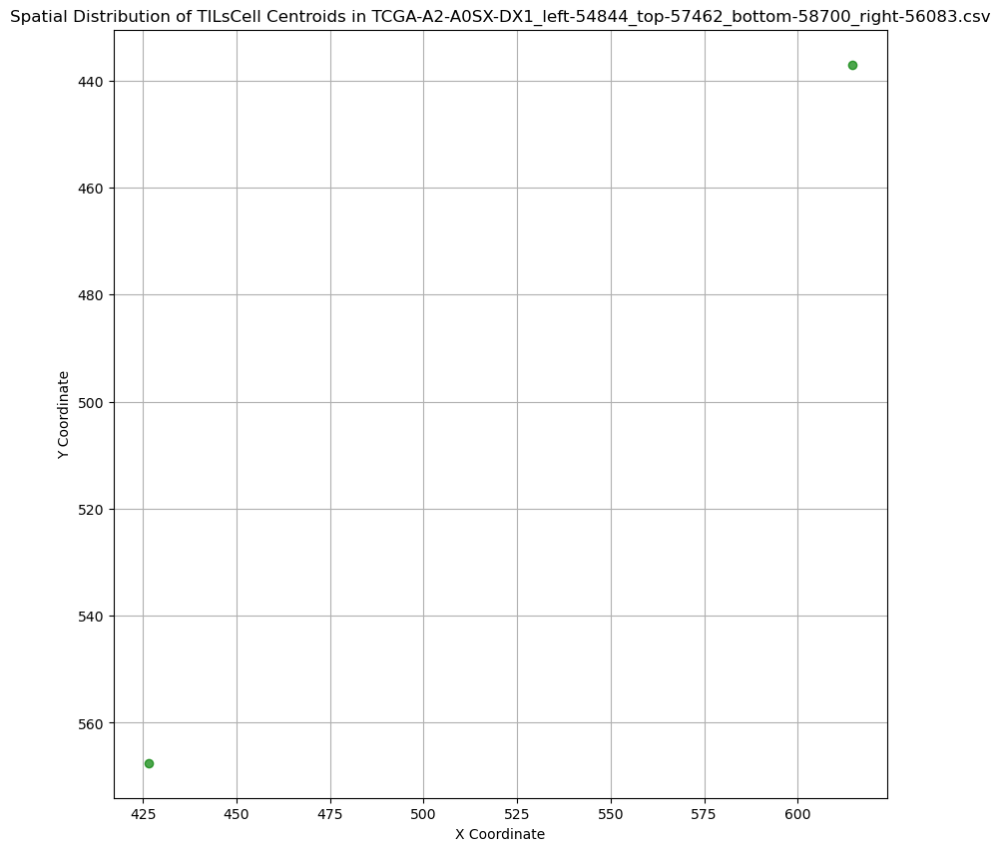

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A0SX-DX1_left-54844_top-57462_bottom-58700_right-56083.csv:
Number of TILsCell regions: 2
Mean area: 334.50
Standard deviation of area: 239.71
Coefficient of variation (heterogeneity): 0.72


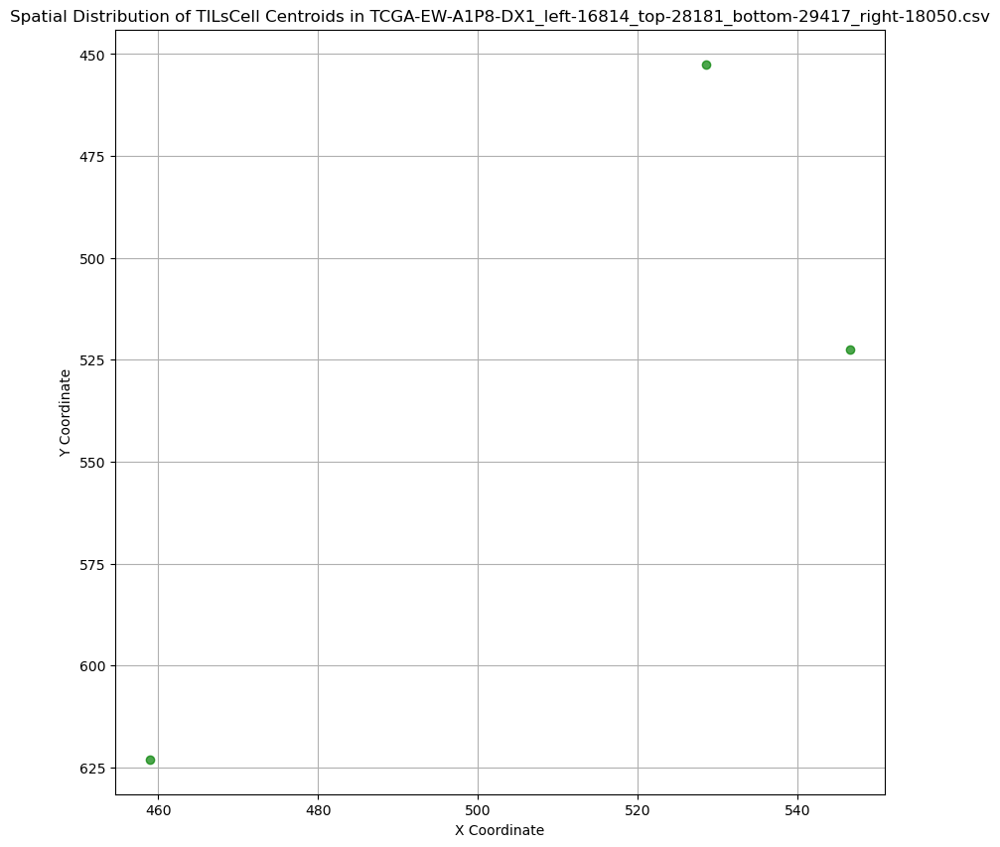

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A1P8-DX1_left-16814_top-28181_bottom-29417_right-18050.csv:
Number of TILsCell regions: 3
Mean area: 293.33
Standard deviation of area: 62.98
Coefficient of variation (heterogeneity): 0.21
No TILsCell regions found in TCGA-AO-A12F-DX1_left-16825_top-29699_bottom-30314_right-17440.csv.


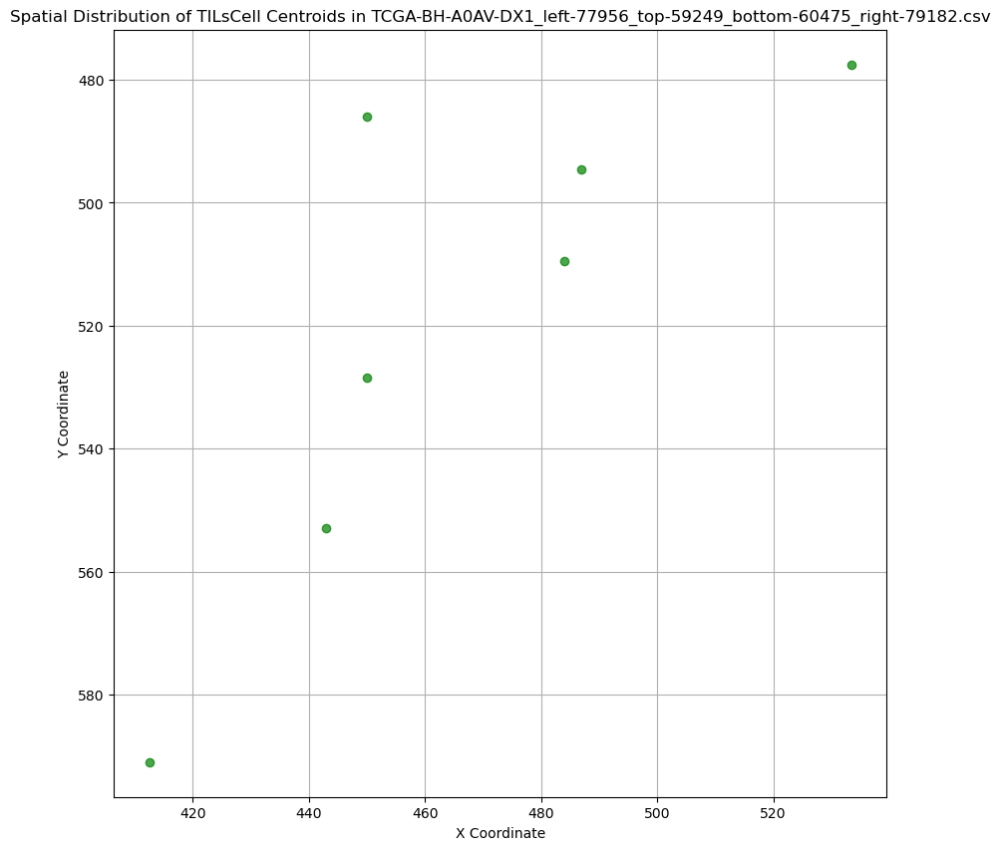

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-BH-A0AV-DX1_left-77956_top-59249_bottom-60475_right-79182.csv:
Number of TILsCell regions: 7
Mean area: 366.71
Standard deviation of area: 125.73
Coefficient of variation (heterogeneity): 0.34
No TILsCell regions found in TCGA-BH-A1F6-DX1_left-54091_top-51224_bottom-52450_right-55317.csv.
No TILsCell regions found in TCGA-A2-A3XY-DX1_left-76551_top-36814_bottom-38066_right-77802.csv.


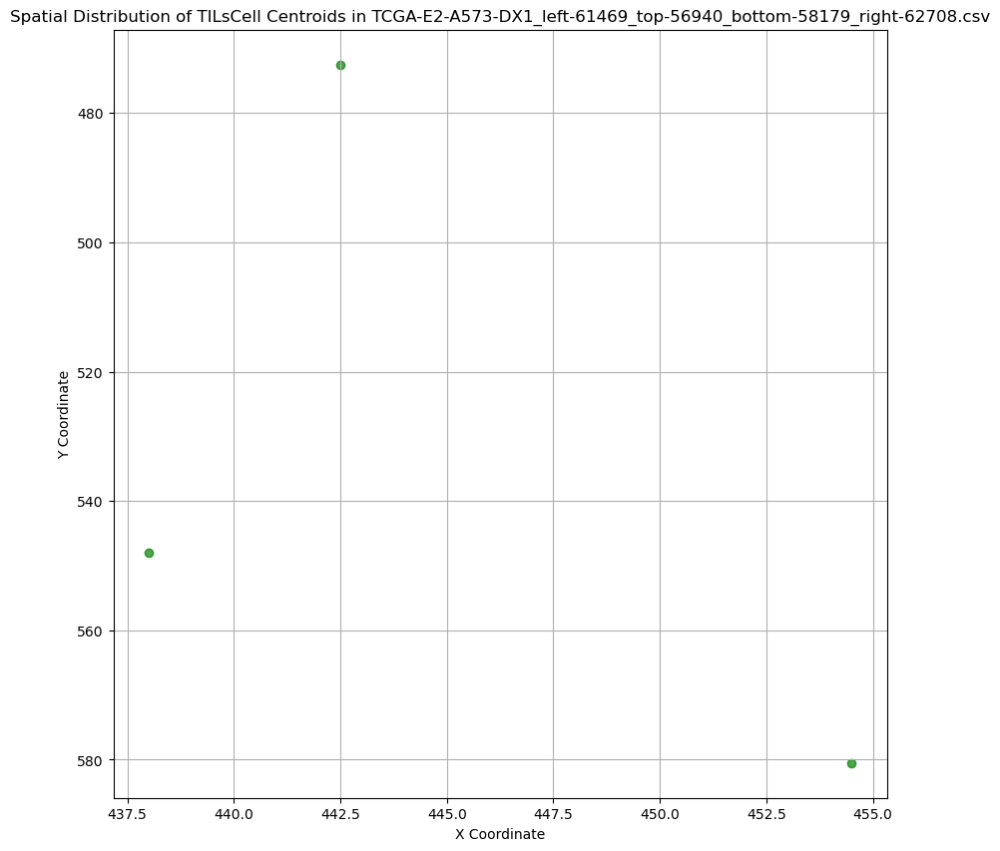

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-E2-A573-DX1_left-61469_top-56940_bottom-58179_right-62708.csv:
Number of TILsCell regions: 3
Mean area: 350.67
Standard deviation of area: 45.76
Coefficient of variation (heterogeneity): 0.13


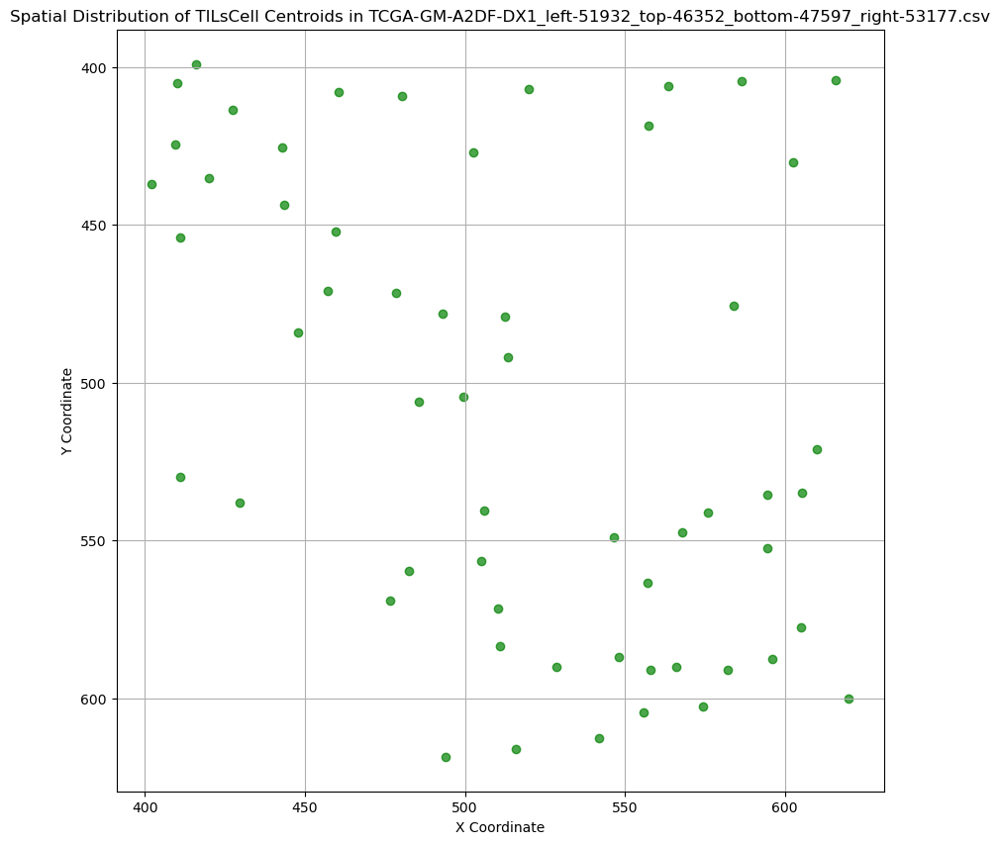

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-GM-A2DF-DX1_left-51932_top-46352_bottom-47597_right-53177.csv:
Number of TILsCell regions: 57
Mean area: 280.11
Standard deviation of area: 72.53
Coefficient of variation (heterogeneity): 0.26


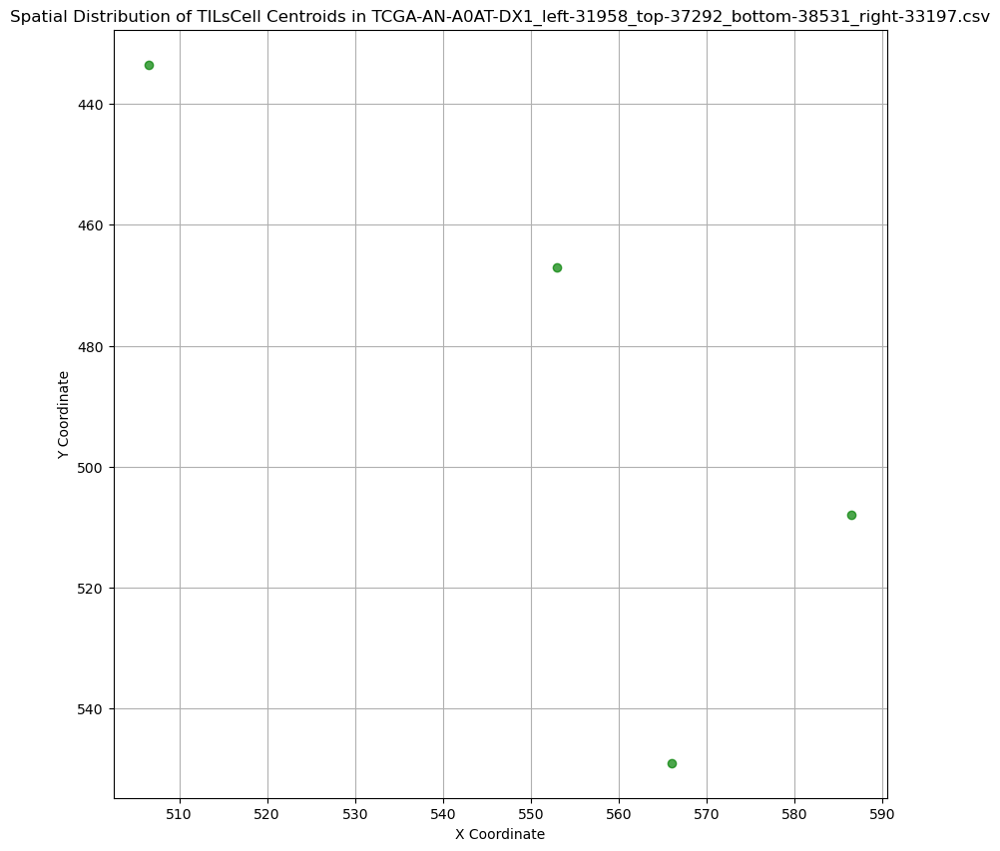

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-AN-A0AT-DX1_left-31958_top-37292_bottom-38531_right-33197.csv:
Number of TILsCell regions: 4
Mean area: 283.25
Standard deviation of area: 47.52
Coefficient of variation (heterogeneity): 0.17


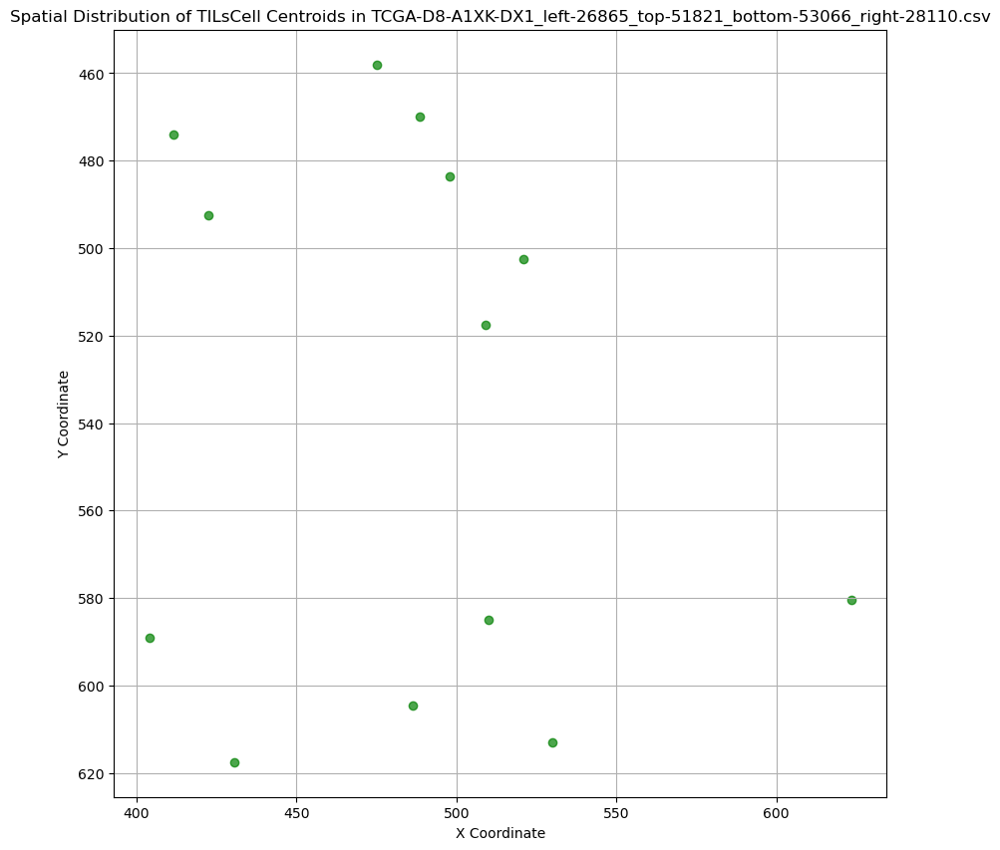

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A1XK-DX1_left-26865_top-51821_bottom-53066_right-28110.csv:
Number of TILsCell regions: 13
Mean area: 241.38
Standard deviation of area: 58.51
Coefficient of variation (heterogeneity): 0.24
No TILsCell regions found in TCGA-E2-A574-DX1_left-54986_top-48255_bottom-49494_right-56225.csv.
No TILsCell regions found in TCGA-A2-A3XY-DX1_left-76312_top-36028_bottom-37279_right-77564.csv.
No TILsCell regions found in TCGA-AO-A0J6-DX1_left-41130_top-11208_bottom-11824_right-41745.csv.
No TILsCell regions found in TCGA-EW-A1P8-DX1_left-18868_top-28191_bottom-29427_right-20104.csv.
No TILsCell regions found in TCGA-A7-A26I-DX1_left-10465_top-26707_bottom-27946_right-11704.csv.


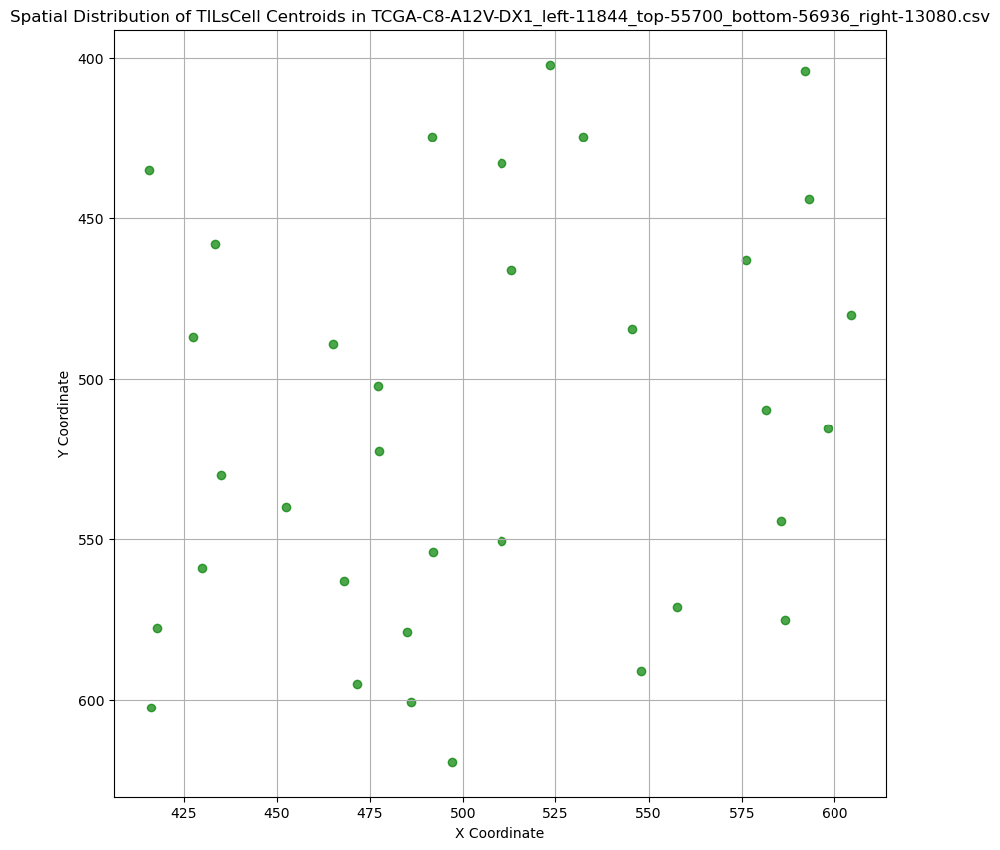

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-C8-A12V-DX1_left-11844_top-55700_bottom-56936_right-13080.csv:
Number of TILsCell regions: 34
Mean area: 269.59
Standard deviation of area: 57.43
Coefficient of variation (heterogeneity): 0.21
No TILsCell regions found in TCGA-BH-A0BW-DX1_left-44154_top-32140_bottom-33366_right-45381.csv.
No TILsCell regions found in TCGA-BH-A0BG-DX1_left-64537_top-27822_bottom-29049_right-65764.csv.
No TILsCell regions found in TCGA-D8-A1XQ-DX1_left-65619_top-35121_bottom-36366_right-66864.csv.
No TILsCell regions found in TCGA-A2-A3XT-DX1_left-87935_top-30455_bottom-31706_right-89186.csv.


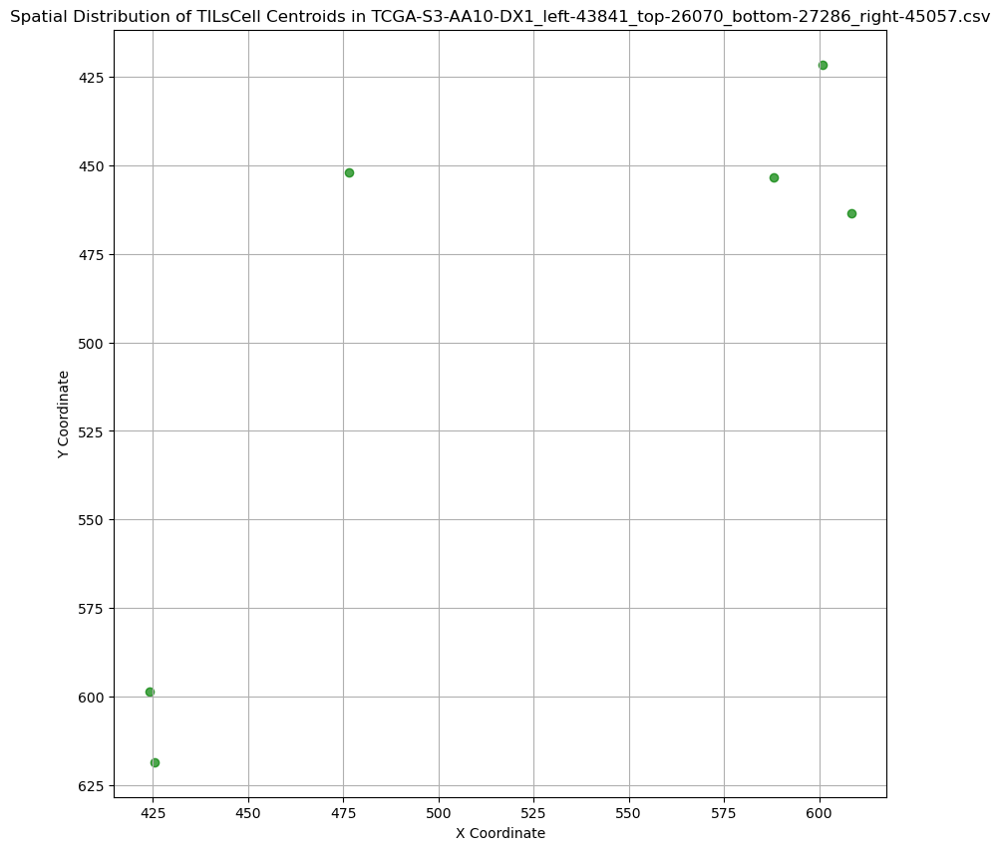

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-S3-AA10-DX1_left-43841_top-26070_bottom-27286_right-45057.csv:
Number of TILsCell regions: 6
Mean area: 335.00
Standard deviation of area: 56.66
Coefficient of variation (heterogeneity): 0.17
No TILsCell regions found in TCGA-D8-A1JF-DX1_left-25904_top-55180_bottom-56419_right-27142.csv.


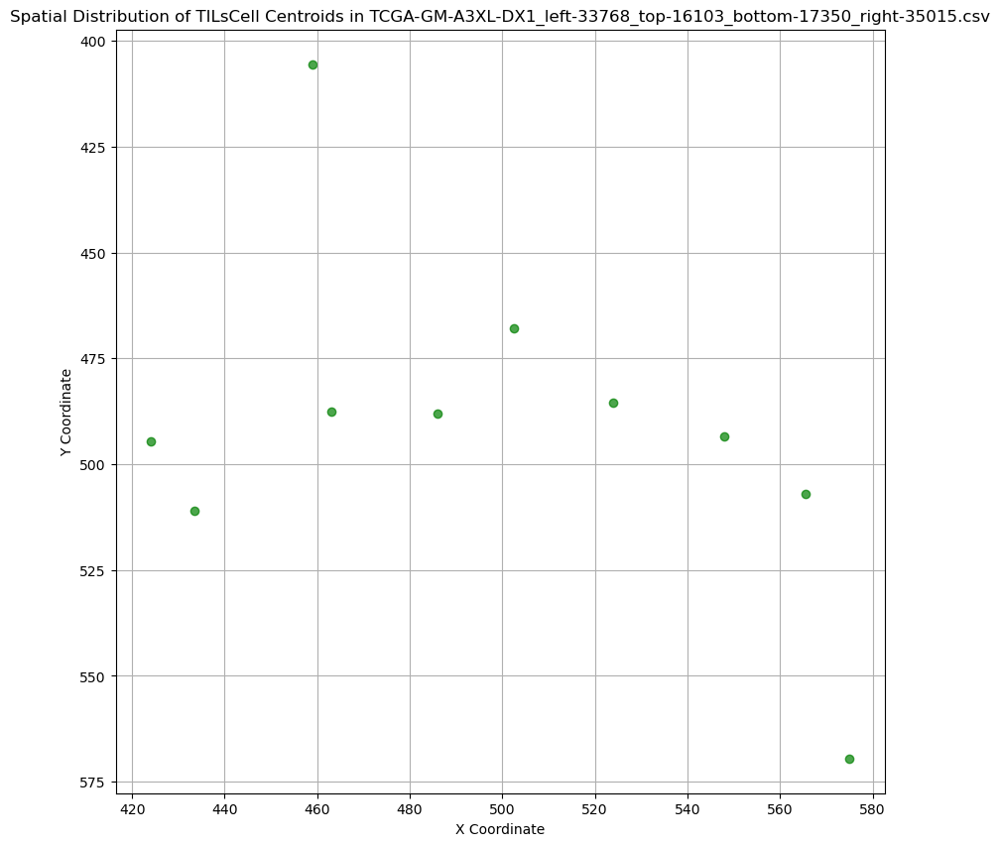

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-GM-A3XL-DX1_left-33768_top-16103_bottom-17350_right-35015.csv:
Number of TILsCell regions: 10
Mean area: 401.40
Standard deviation of area: 99.31
Coefficient of variation (heterogeneity): 0.25
No TILsCell regions found in TCGA-BH-A0B3-DX1_left-86138_top-42957_bottom-44194_right-87374.csv.


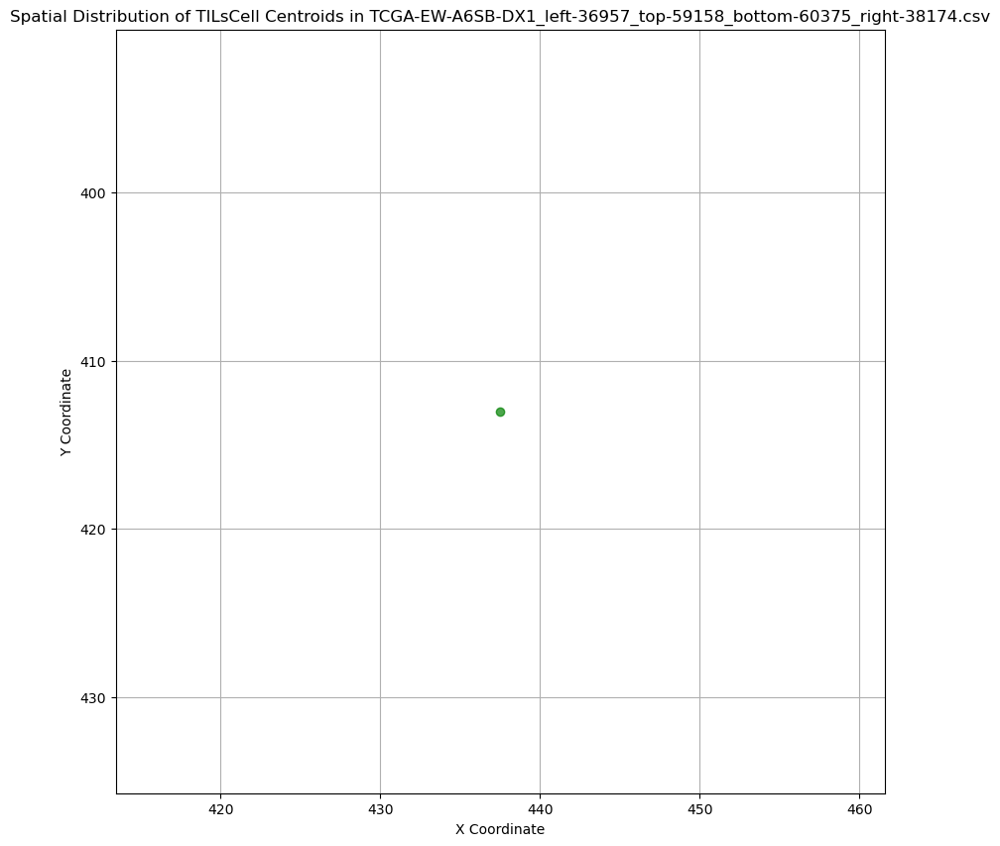

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-36957_top-59158_bottom-60375_right-38174.csv:
Number of TILsCell regions: 1
Mean area: 266.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-A7-A26I-DX1_left-10228_top-26189_bottom-27428_right-11467.csv.
No TILsCell regions found in TCGA-E2-A1LK-DX1_left-77700_top-33244_bottom-34483_right-78939.csv.
No TILsCell regions found in TCGA-BH-A1F6-DX1_left-57942_top-51965_bottom-53192_right-59169.csv.
No TILsCell regions found in TCGA-OL-A5D7-DX1_left-118562_top-23020_bottom-24271_right-119813.csv.
No TILsCell regions found in TCGA-AO-A0J6-DX1_left-42672_top-11723_bottom-12339_right-43287.csv.


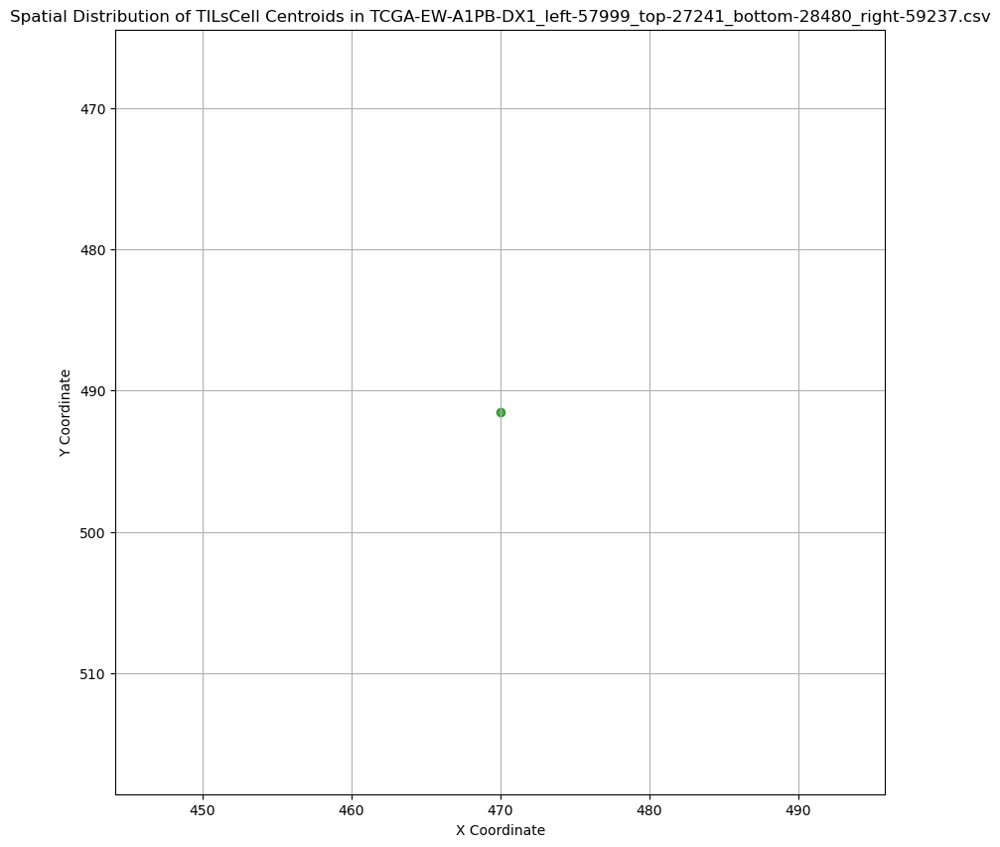

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A1PB-DX1_left-57999_top-27241_bottom-28480_right-59237.csv:
Number of TILsCell regions: 1
Mean area: 210.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-C8-A12V-DX1_left-14407_top-56720_bottom-57956_right-15643.csv.
No TILsCell regions found in TCGA-EW-A6SB-DX1_left-35404_top-57887_bottom-59104_right-36621.csv.
No TILsCell regions found in TCGA-AQ-A54N-DX1_left-32958_top-27354_bottom-28597_right-34201.csv.
No TILsCell regions found in TCGA-A2-A0T2-DX1_left-67923_top-57021_bottom-58260_right-69162.csv.


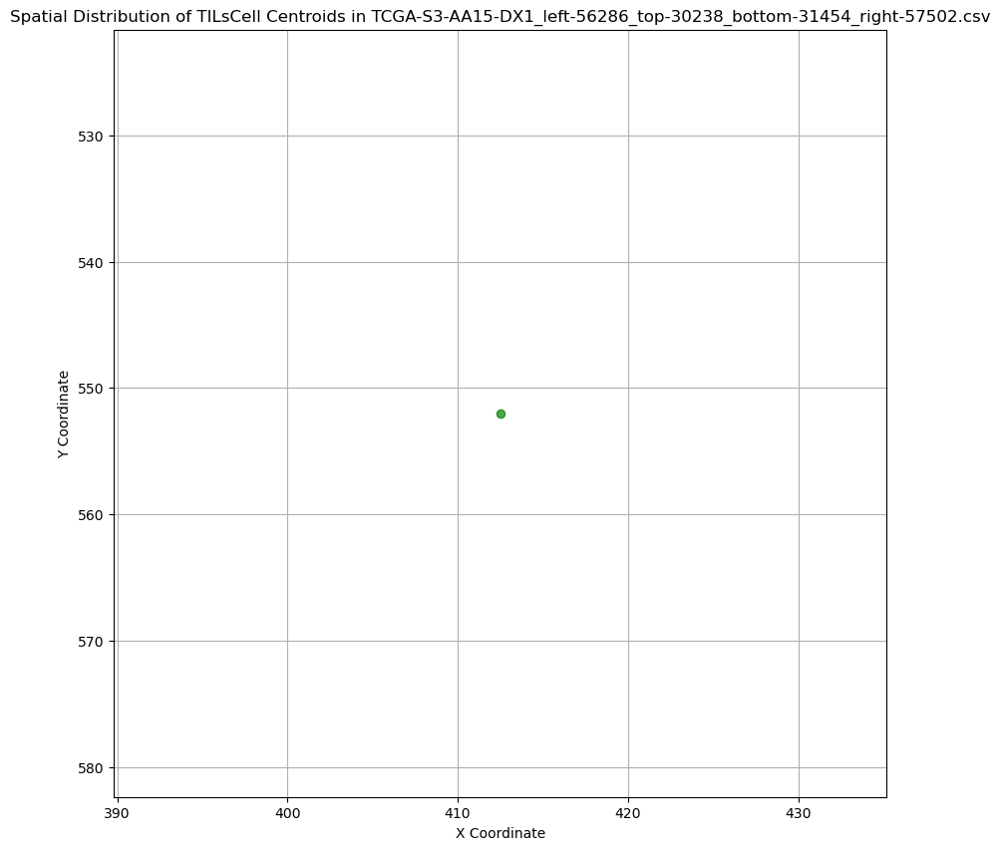

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-S3-AA15-DX1_left-56286_top-30238_bottom-31454_right-57502.csv:
Number of TILsCell regions: 1
Mean area: 418.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-A2-A0D2-DX1_left-98187_top-22842_bottom-24080_right-99426.csv.


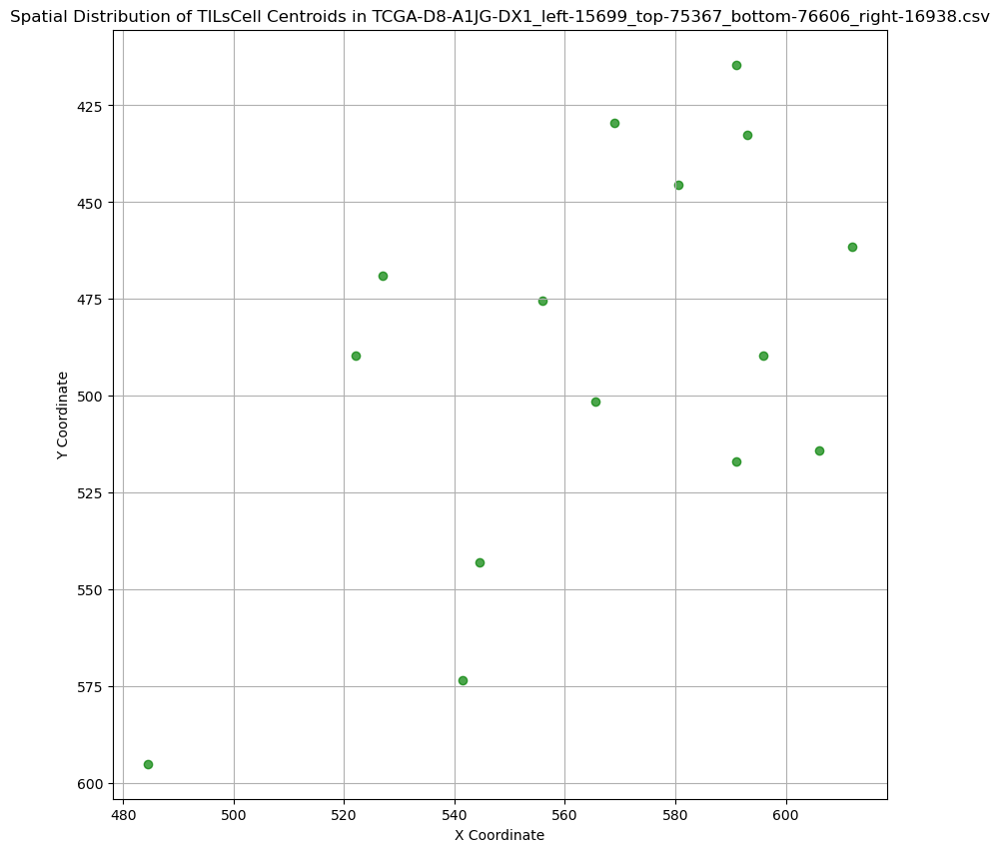

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-D8-A1JG-DX1_left-15699_top-75367_bottom-76606_right-16938.csv:
Number of TILsCell regions: 15
Mean area: 262.60
Standard deviation of area: 58.57
Coefficient of variation (heterogeneity): 0.22
No TILsCell regions found in TCGA-BH-A0B9-DX1_left-67090_top-59786_bottom-61022_right-68326.csv.
No TILsCell regions found in TCGA-E2-A14X-DX1_left-90884_top-67431_bottom-68676_right-92129.csv.


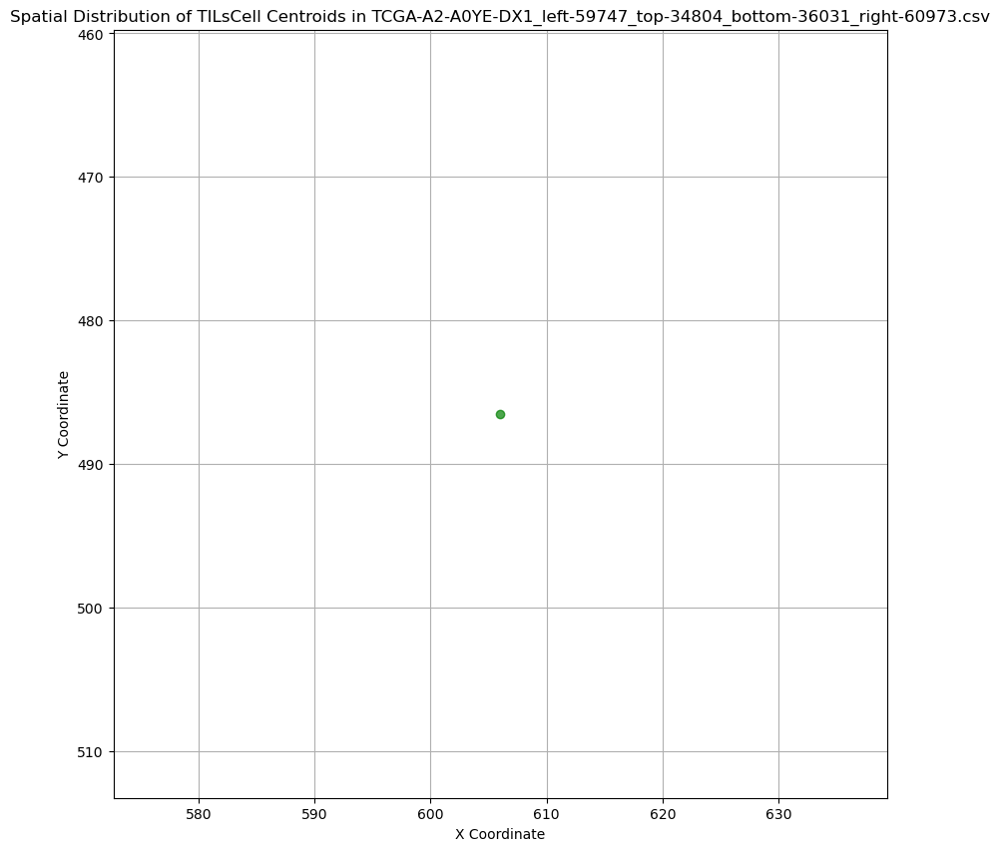

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A0YE-DX1_left-59747_top-34804_bottom-36031_right-60973.csv:
Number of TILsCell regions: 1
Mean area: 306.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


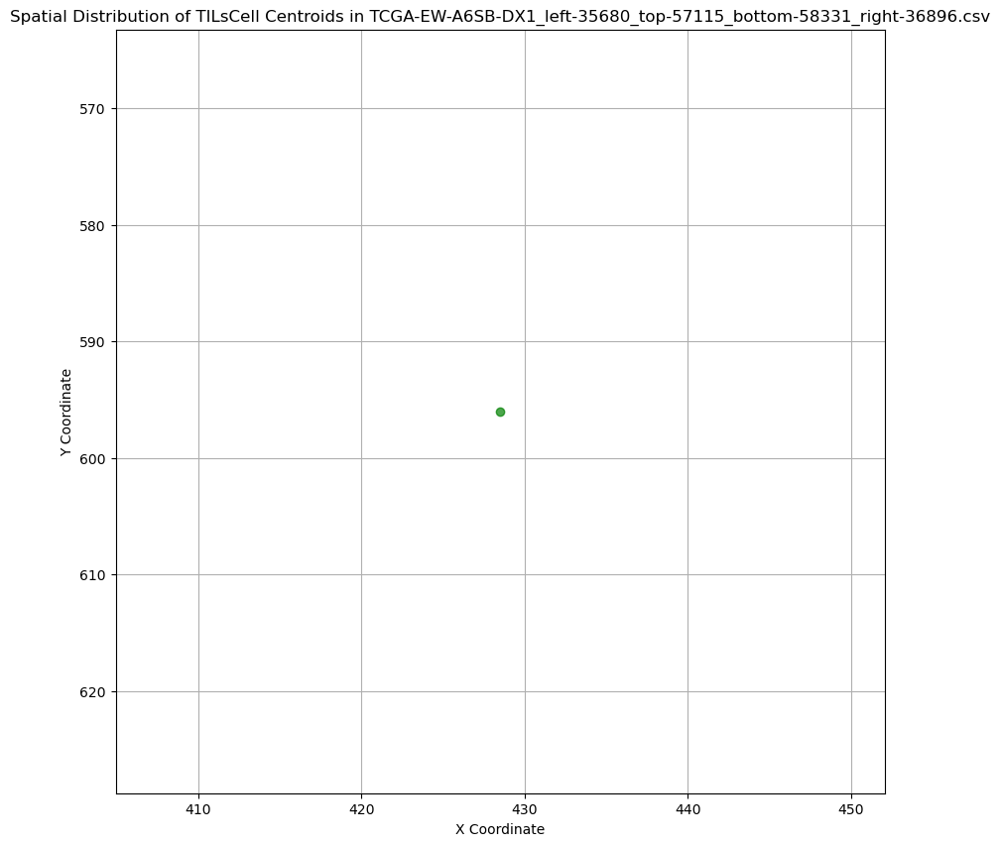

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-EW-A6SB-DX1_left-35680_top-57115_bottom-58331_right-36896.csv:
Number of TILsCell regions: 1
Mean area: 420.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-BH-A0B3-DX1_left-85336_top-42204_bottom-43440_right-86572.csv.


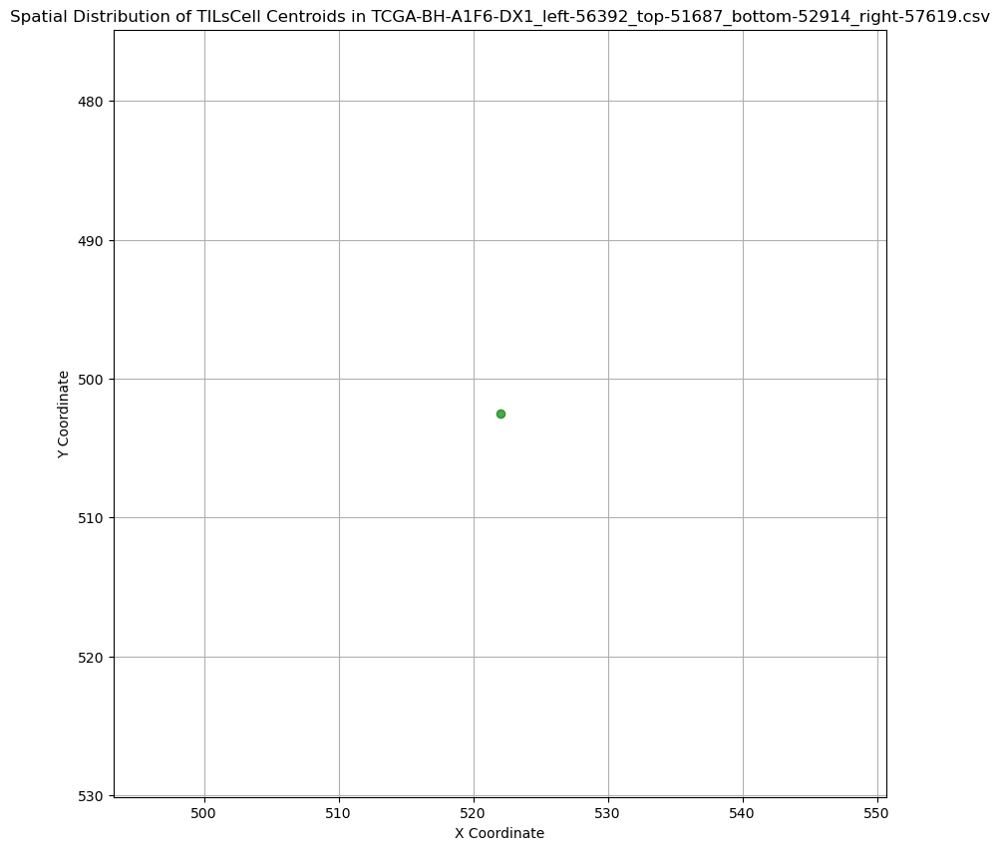

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-BH-A1F6-DX1_left-56392_top-51687_bottom-52914_right-57619.csv:
Number of TILsCell regions: 1
Mean area: 546.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan
No TILsCell regions found in TCGA-GM-A2DH-DX1_left-51483_top-58109_bottom-59354_right-52728.csv.


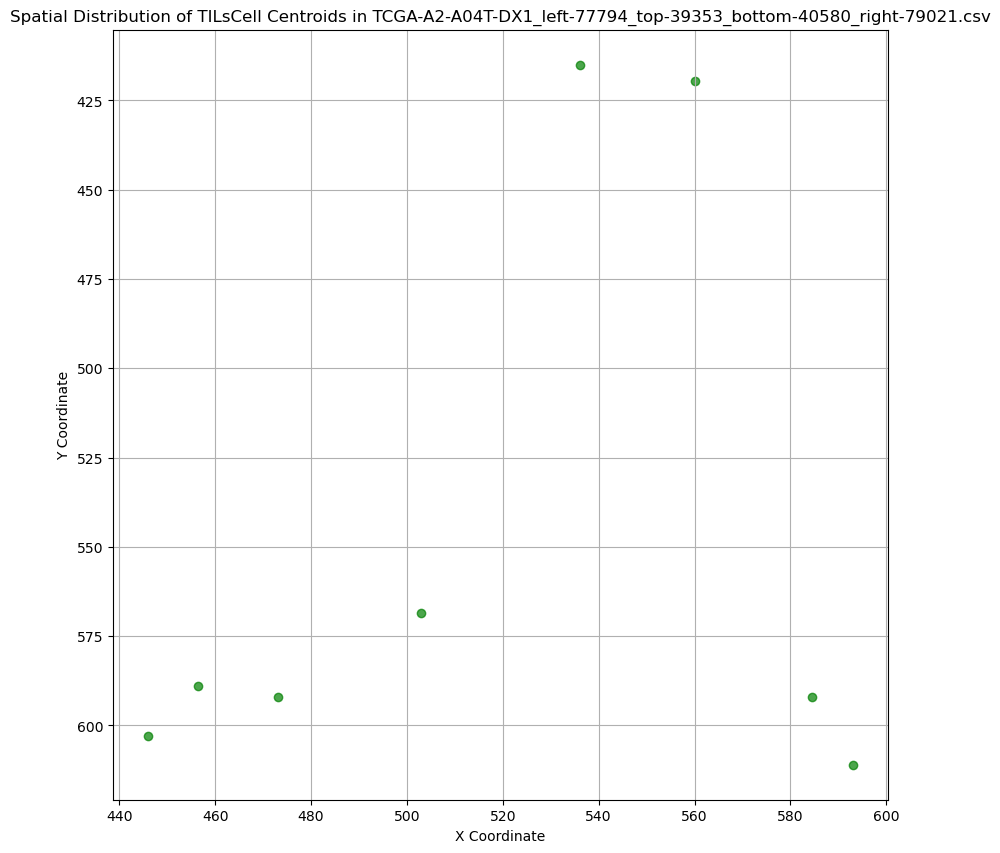

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2000870339.py:

TILsCell Spatial Analysis for TCGA-A2-A04T-DX1_left-77794_top-39353_bottom-40580_right-79021.csv:
Number of TILsCell regions: 8
Mean area: 303.00
Standard deviation of area: 172.15
Coefficient of variation (heterogeneity): 0.57


KeyboardInterrupt: 

In [8]:
# Exploratory analysis of TILs

# Paths to folders (different assigned variables as for a separate task)
filtered_rgb_dir = "/Users/ashishsingh/Desktop/filtered_rgbs"
filtered_vis_dir = "/Users/ashishsingh/Desktop/filtered_visualizations"
filtered_mask_dir = "/Users/ashishsingh/Desktop/filtered_masks"
filtered_csv_dir = "/Users/ashishsingh/Desktop/filtered_csvs"

# Loop through all CSV files in the filtered_csv folder
for csv_file in os.listdir(filtered_csv_dir):
    if csv_file.endswith(".csv"):
        csv_path = os.path.join(filtered_csv_dir, csv_file)
        
        # Load the CSV file
        csv_data = pd.read_csv(csv_path)
        
        # Filter for TILsCell
        tils_data = csv_data[csv_data['group'] == 'TILsCell']

        if tils_data.empty:
            print(f"No TILsCell regions found in {csv_file}.")
            continue
        else:
            # Calculate centroids of each TILsCell region
            tils_data['centroid_x'] = (tils_data['left'] + tils_data['right']) / 2
            tils_data['centroid_y'] = (tils_data['top'] + tils_data['bottom']) / 2

            # Plot spatial distribution
            plt.figure(figsize=(10, 10))
            plt.scatter(tils_data['centroid_x'], tils_data['centroid_y'], alpha=0.7, color='green')
            plt.title(f"Spatial Distribution of TILsCell Centroids in {csv_file}")
            plt.xlabel("X Coordinate")
            plt.ylabel("Y Coordinate")
            plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
            plt.grid(True)
            plt.show()

            # Calculate area of each TILsCell region
            tils_data['area'] = (tils_data['right'] - tils_data['left']) * (tils_data['bottom'] - tils_data['top'])

            # Calculate heterogeneity
            area_mean = tils_data['area'].mean()
            area_std = tils_data['area'].std()
            area_coefficient_of_variation = area_std / area_mean

            # Print analysis results
            print(f"TILsCell Spatial Analysis for {csv_file}:")
            print(f"Number of TILsCell regions: {len(tils_data)}")
            print(f"Mean area: {area_mean:.2f}")
            print(f"Standard deviation of area: {area_std:.2f}")
            print(f"Coefficient of variation (heterogeneity): {area_coefficient_of_variation:.2f}")

# Summary of processing
print("\nProcessing complete. Check the visualizations and results for each file.")

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


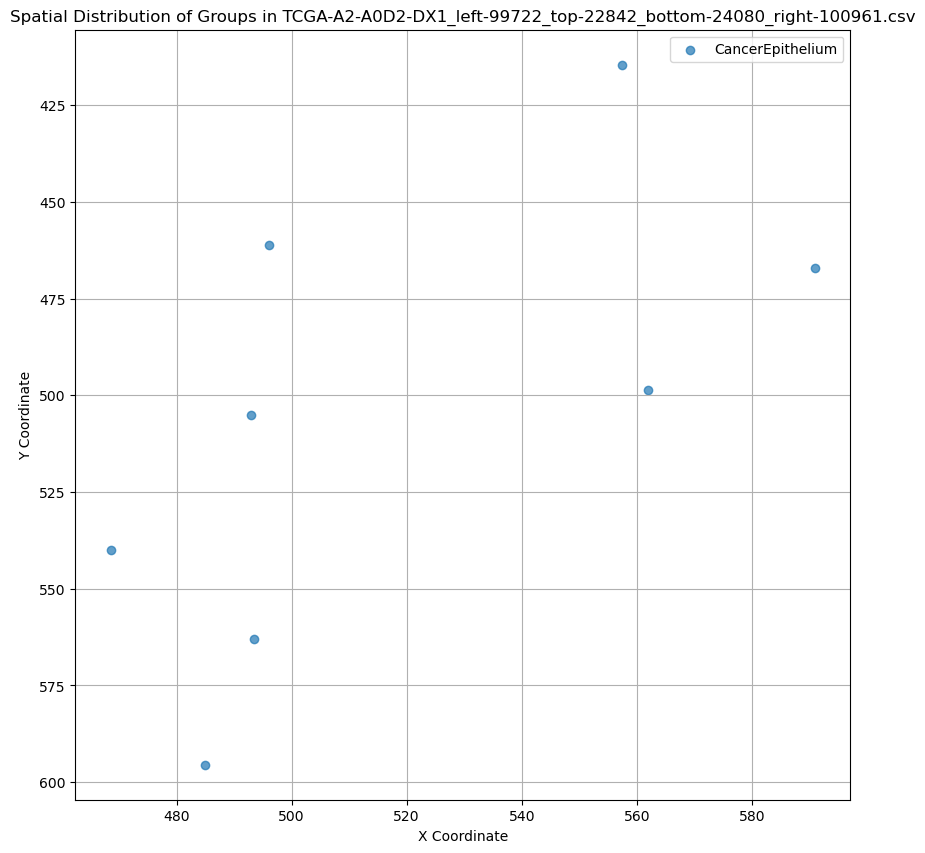

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

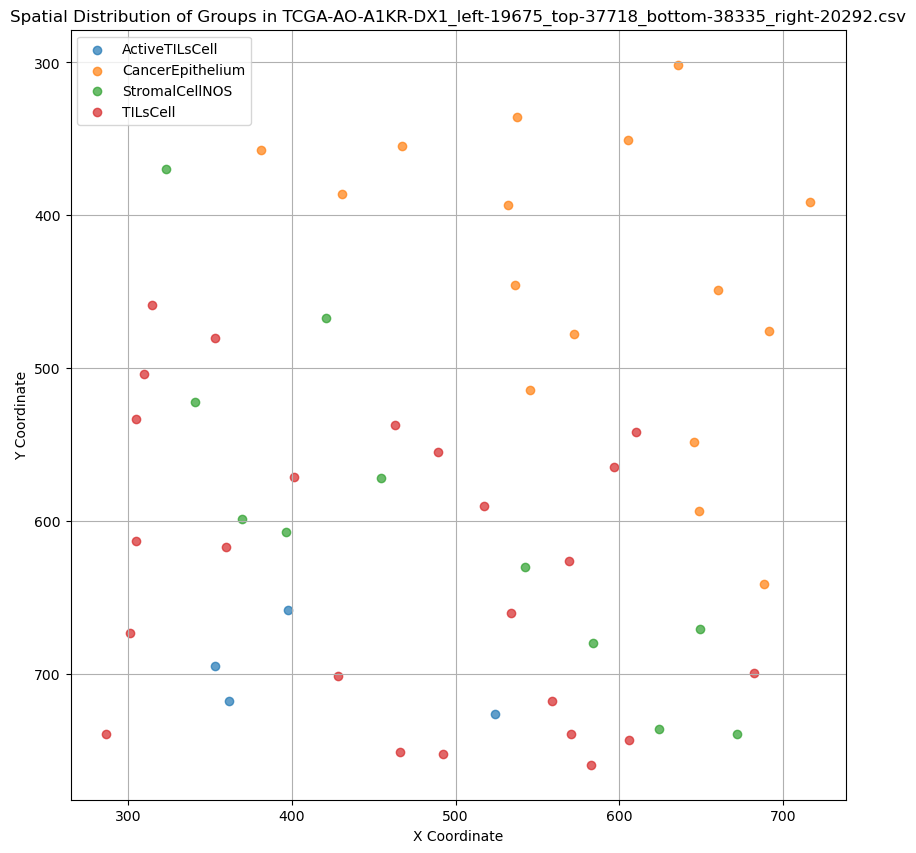

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

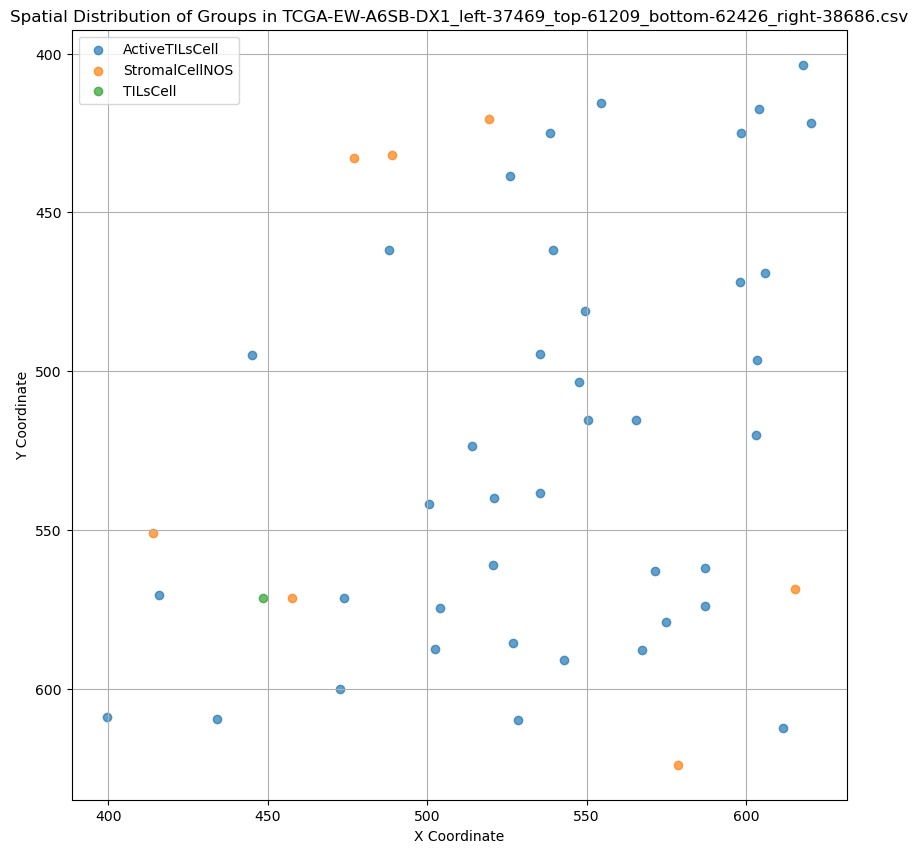

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

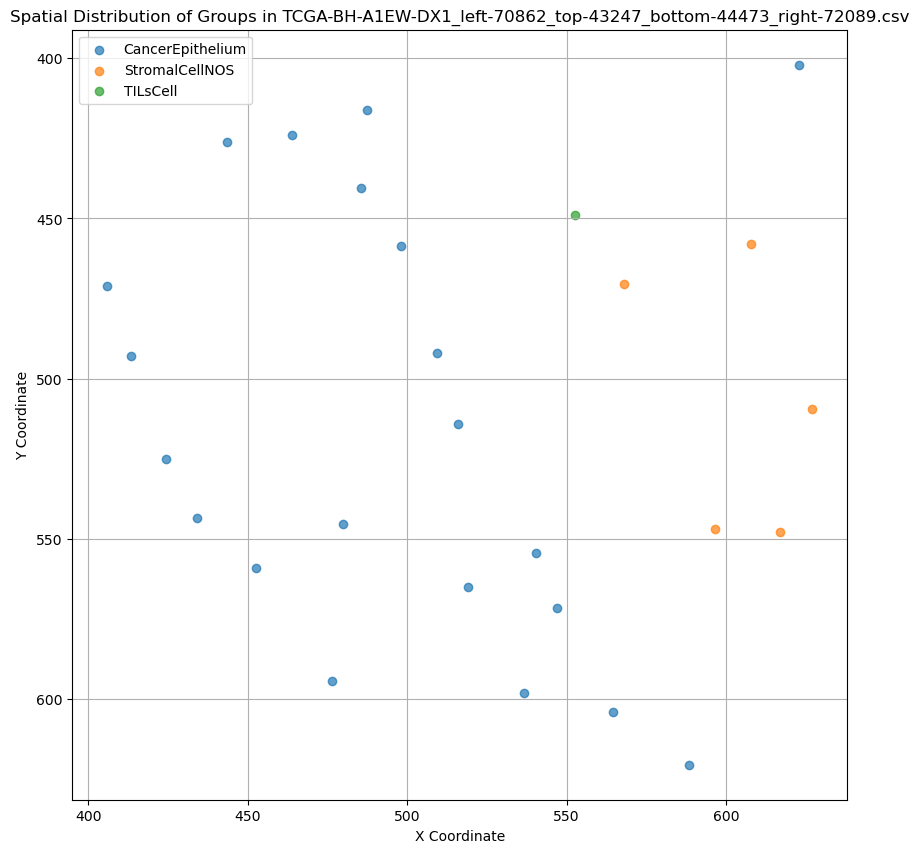

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

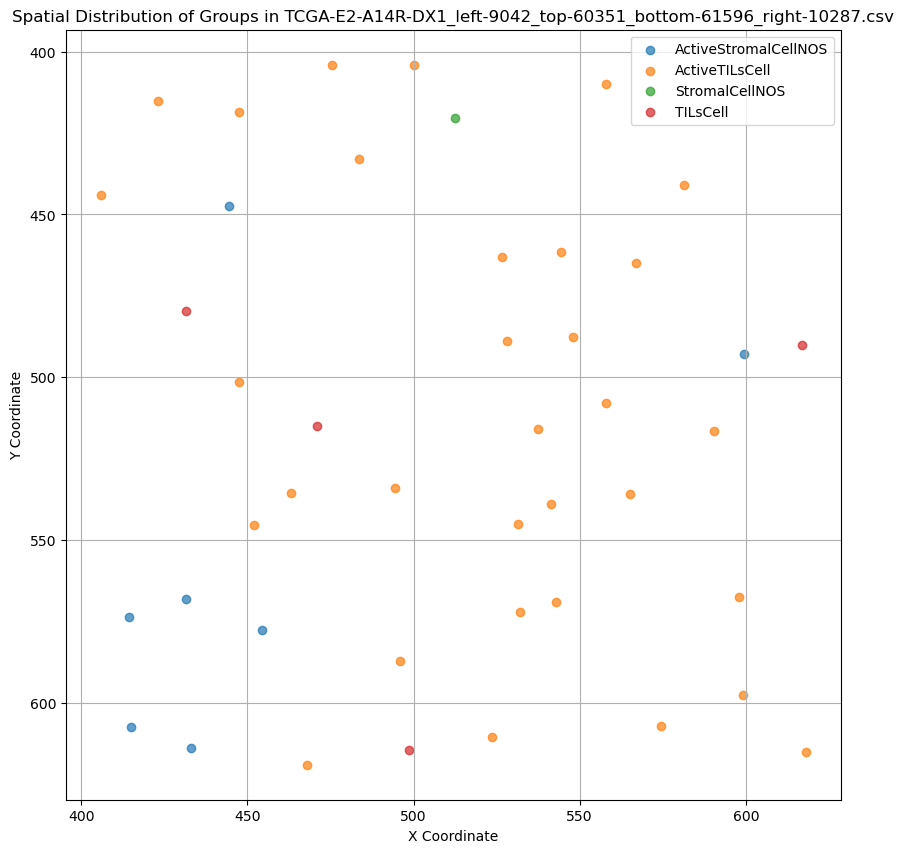

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

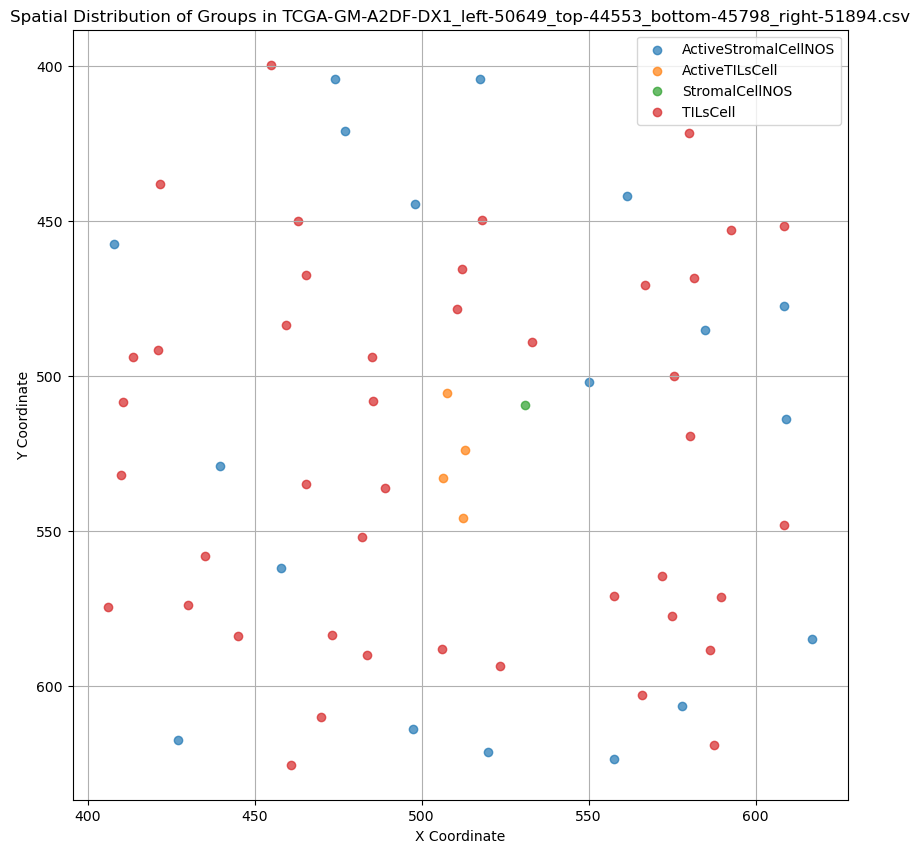

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

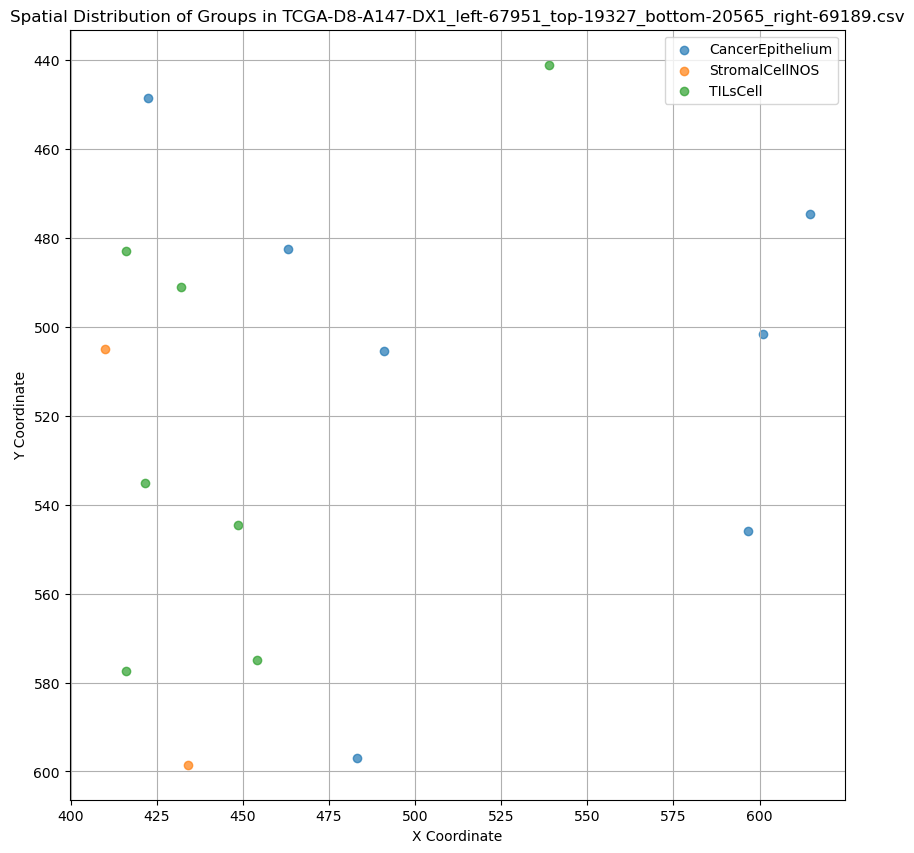

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

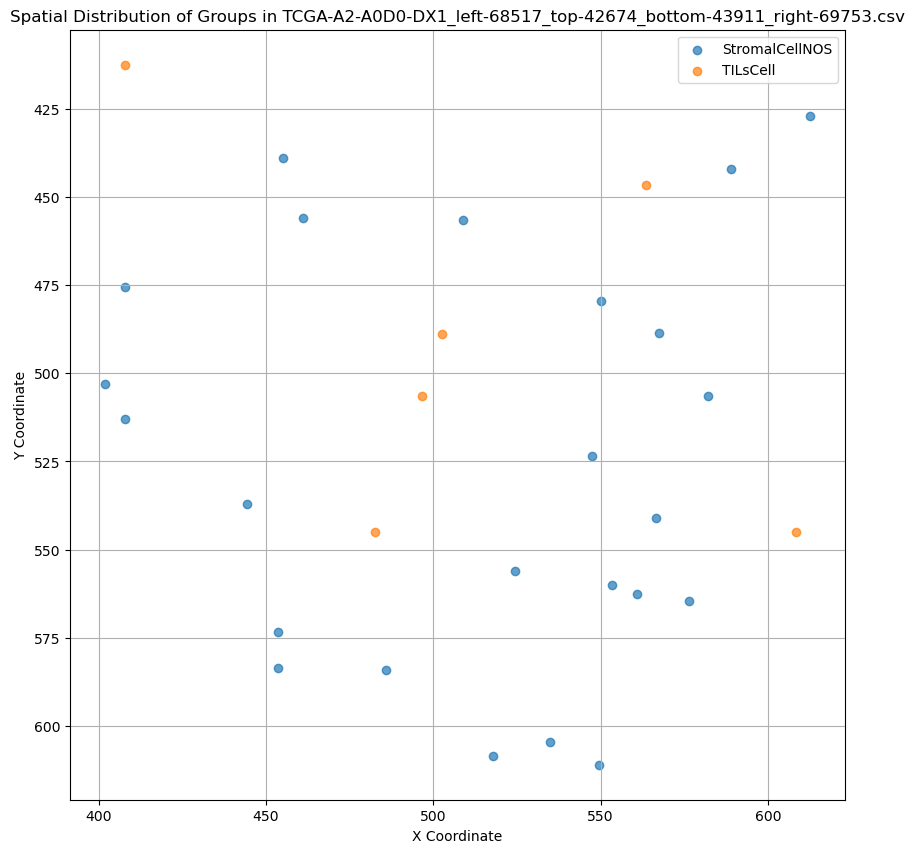

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

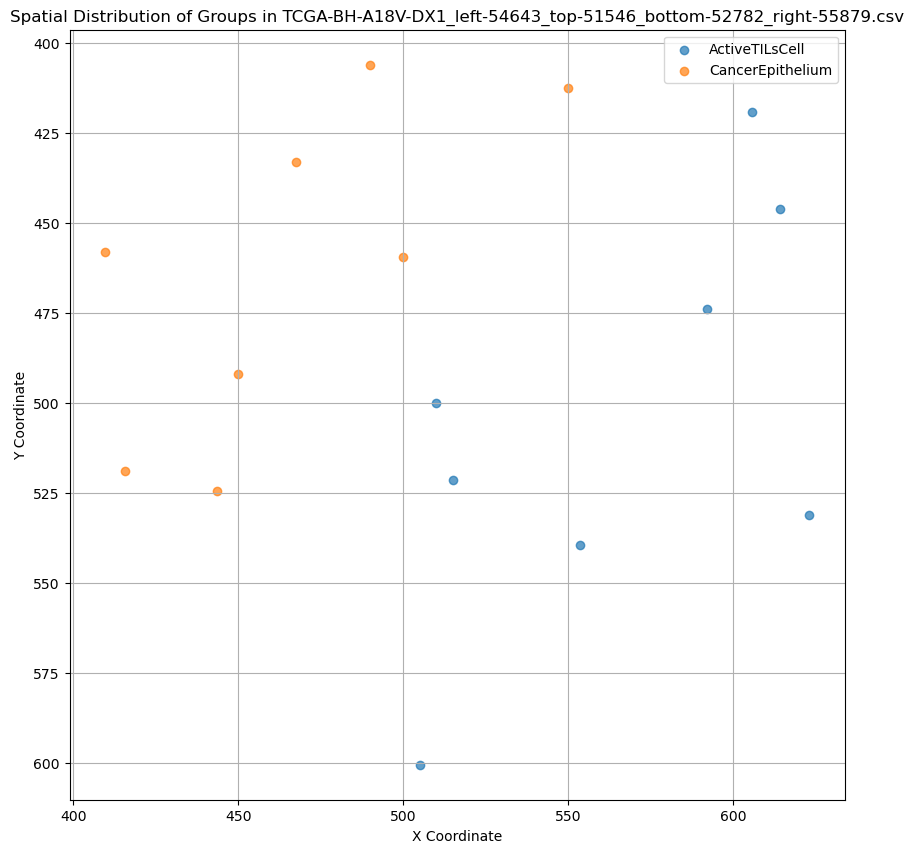

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

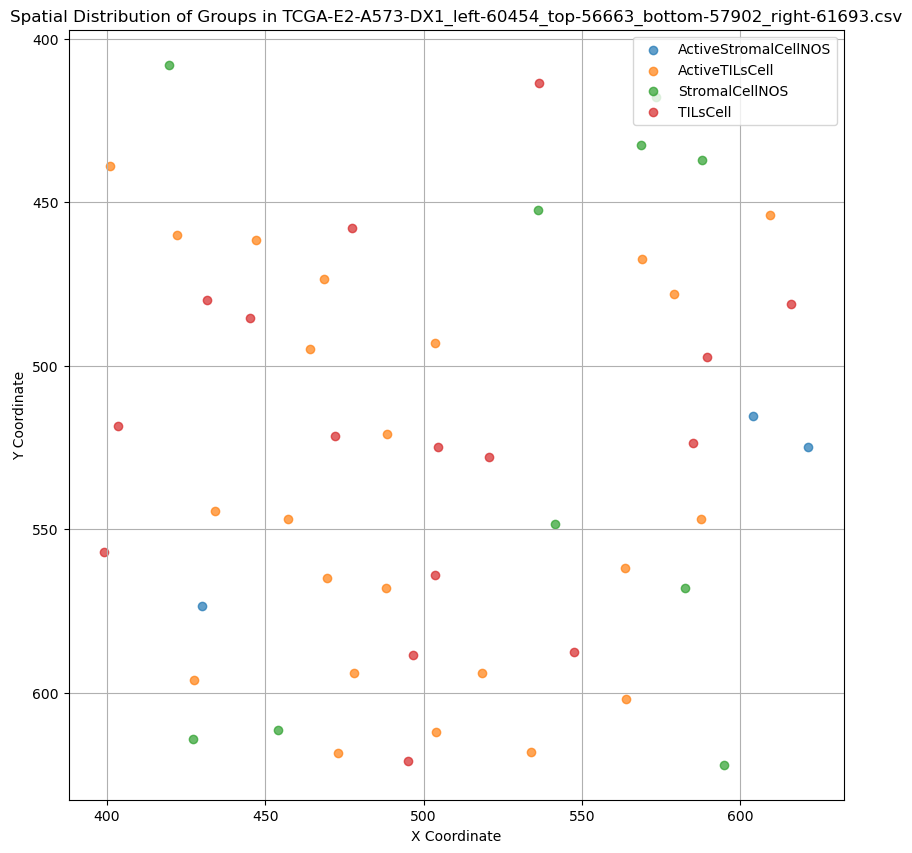

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

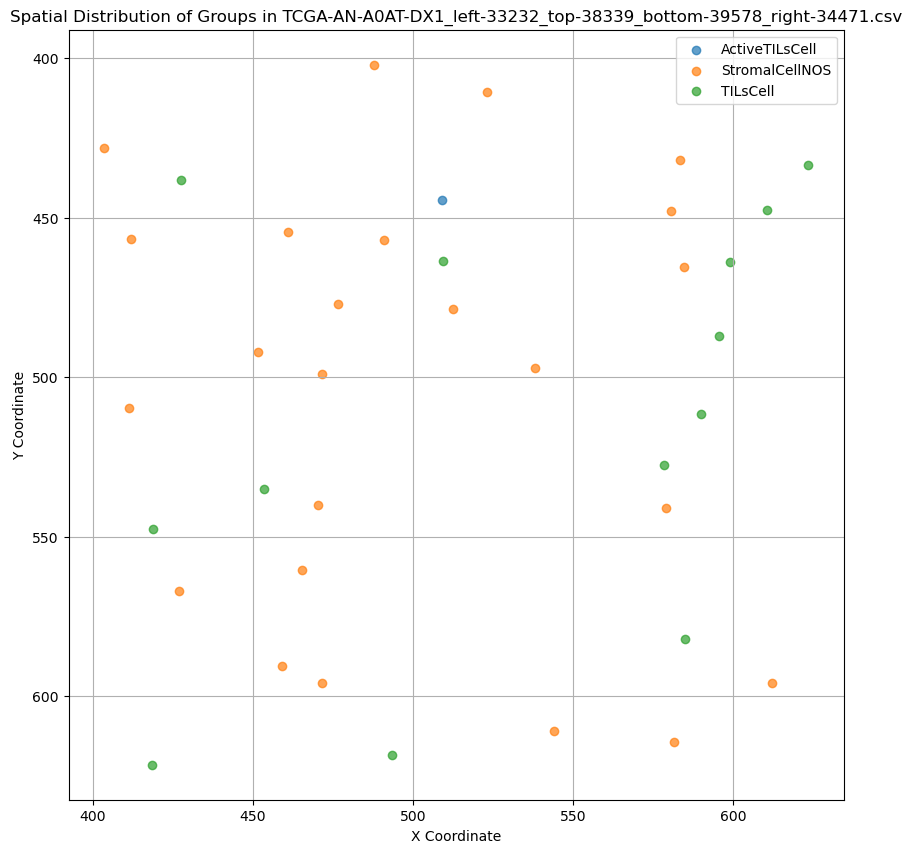

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

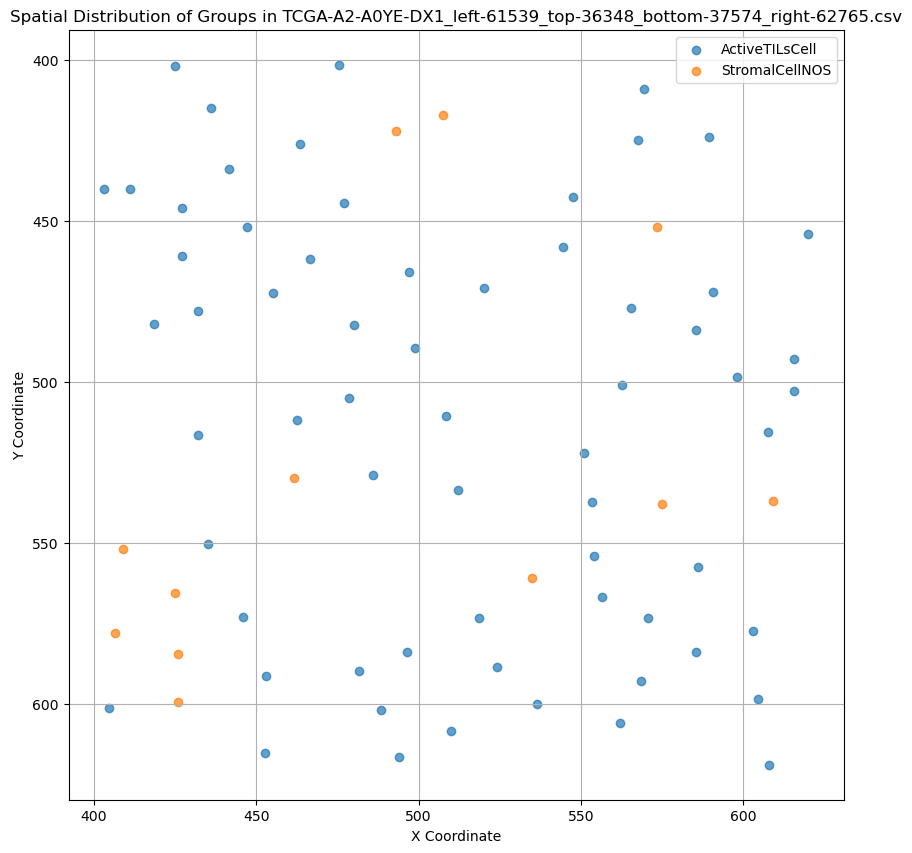

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

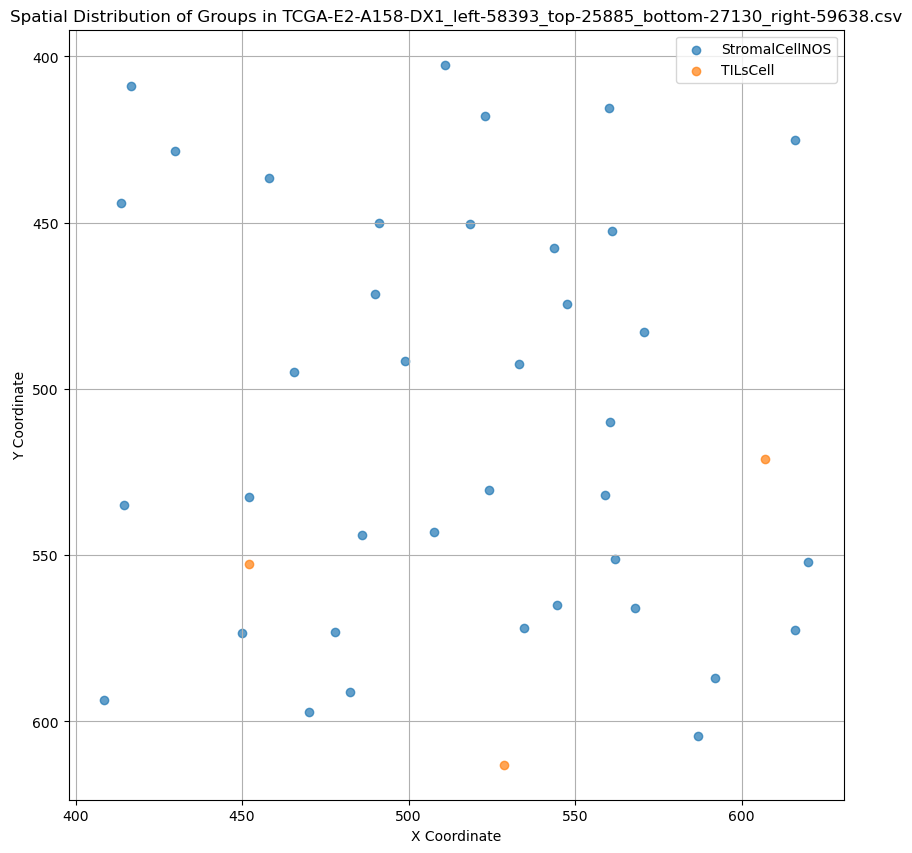

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

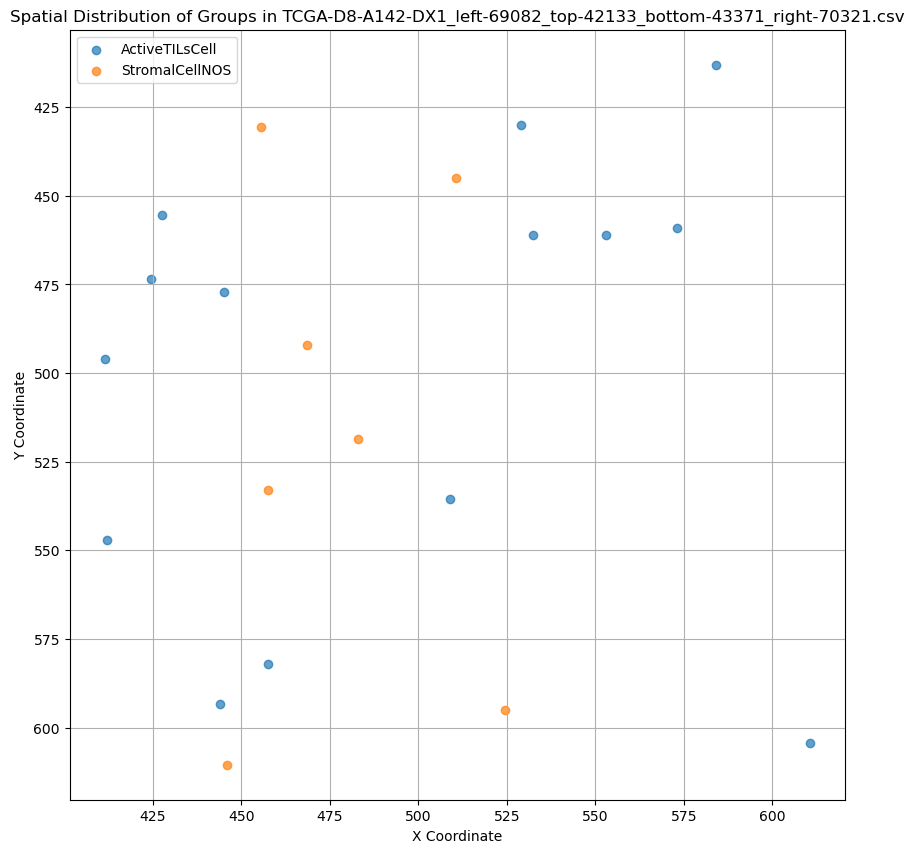

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

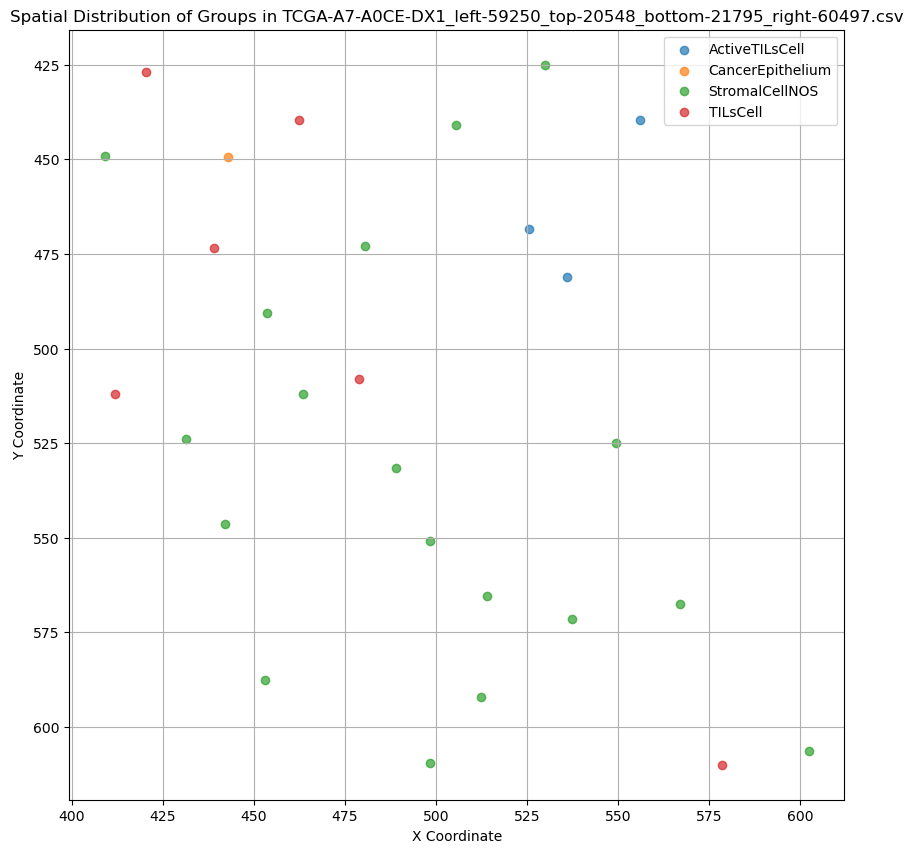

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

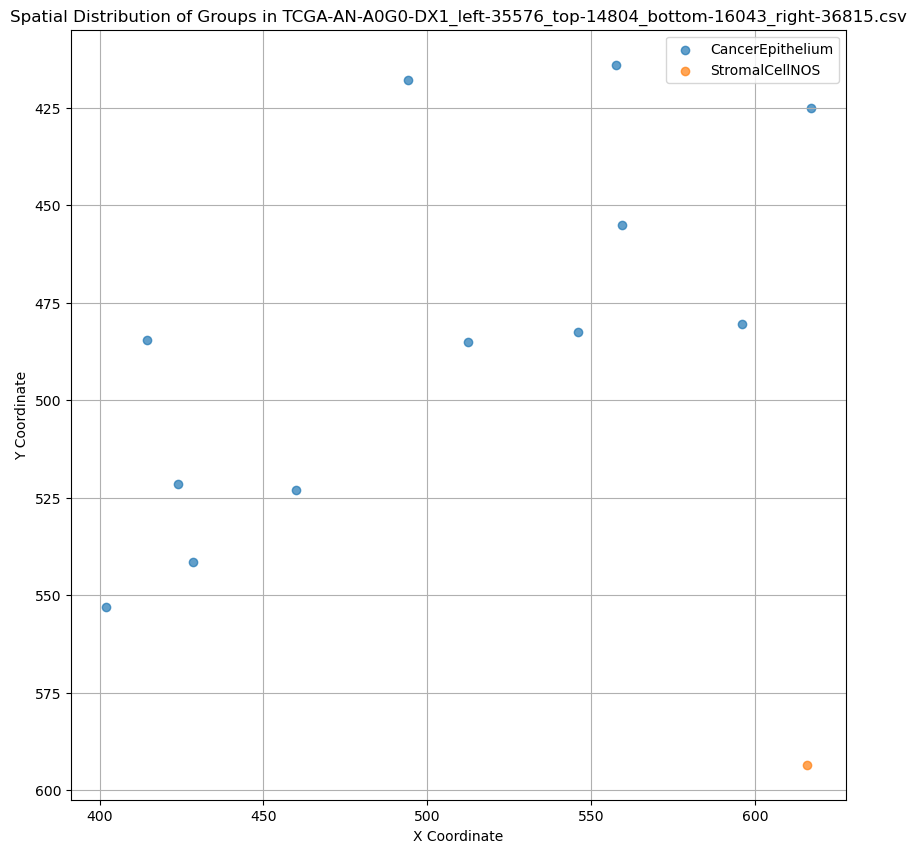

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

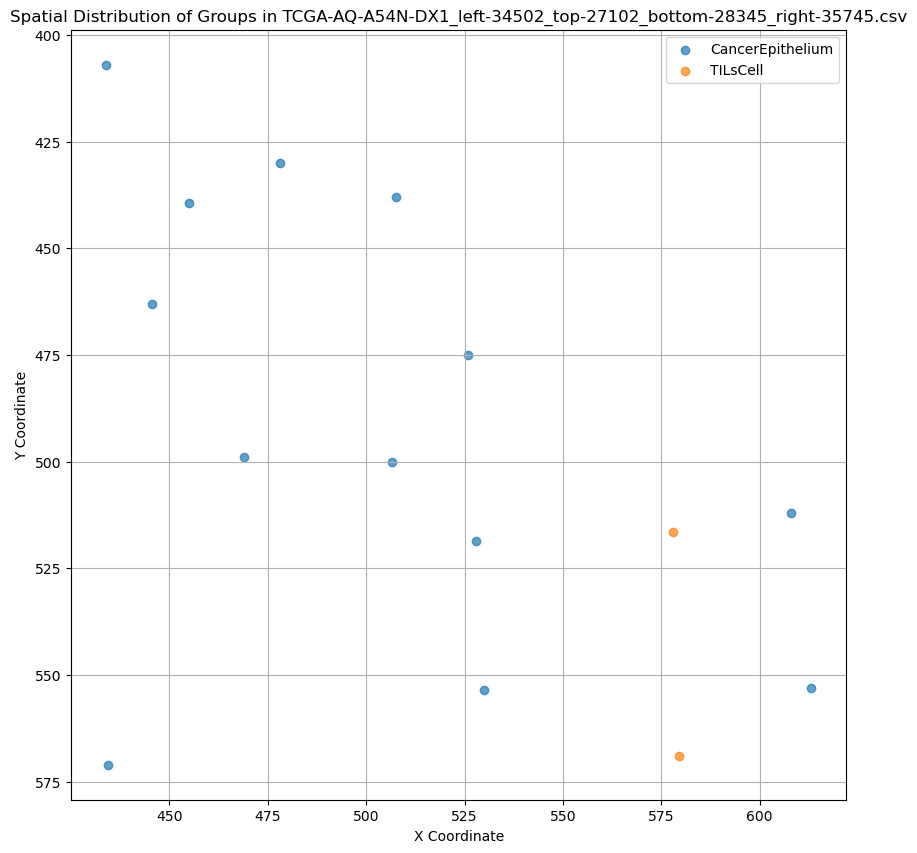

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


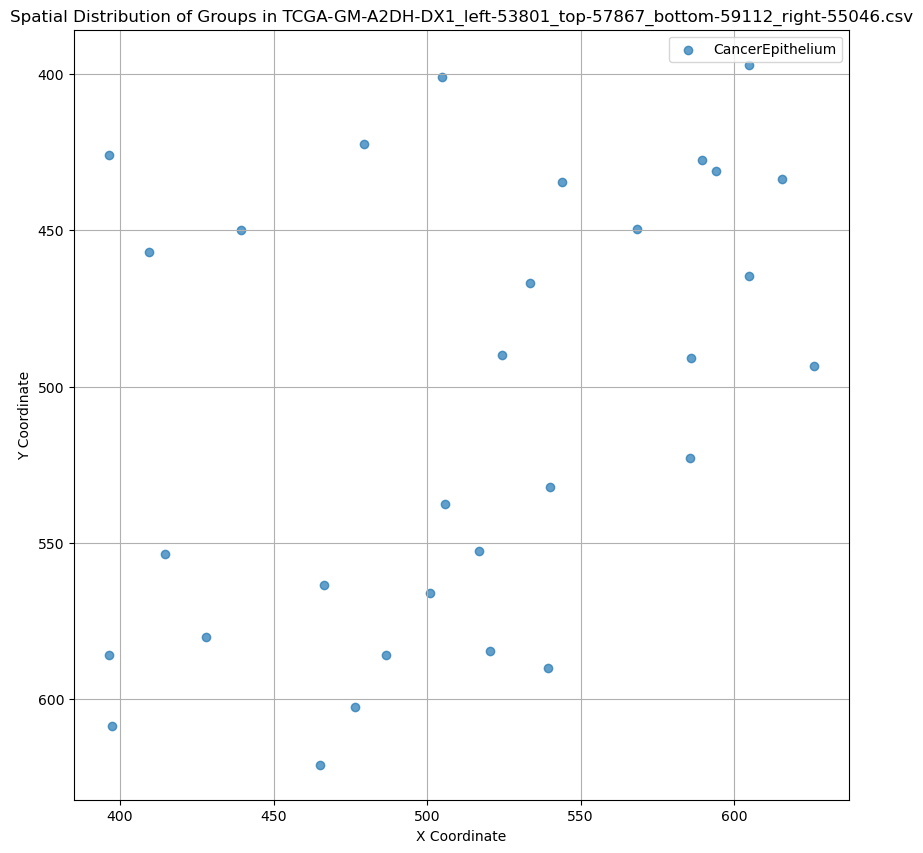

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

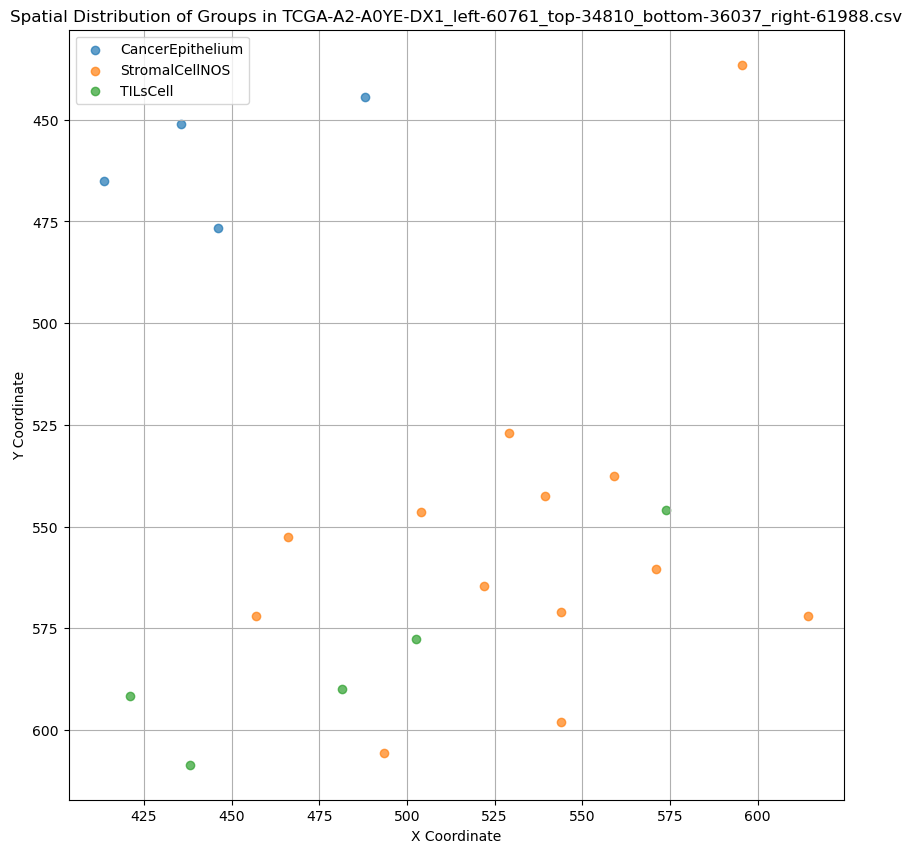

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

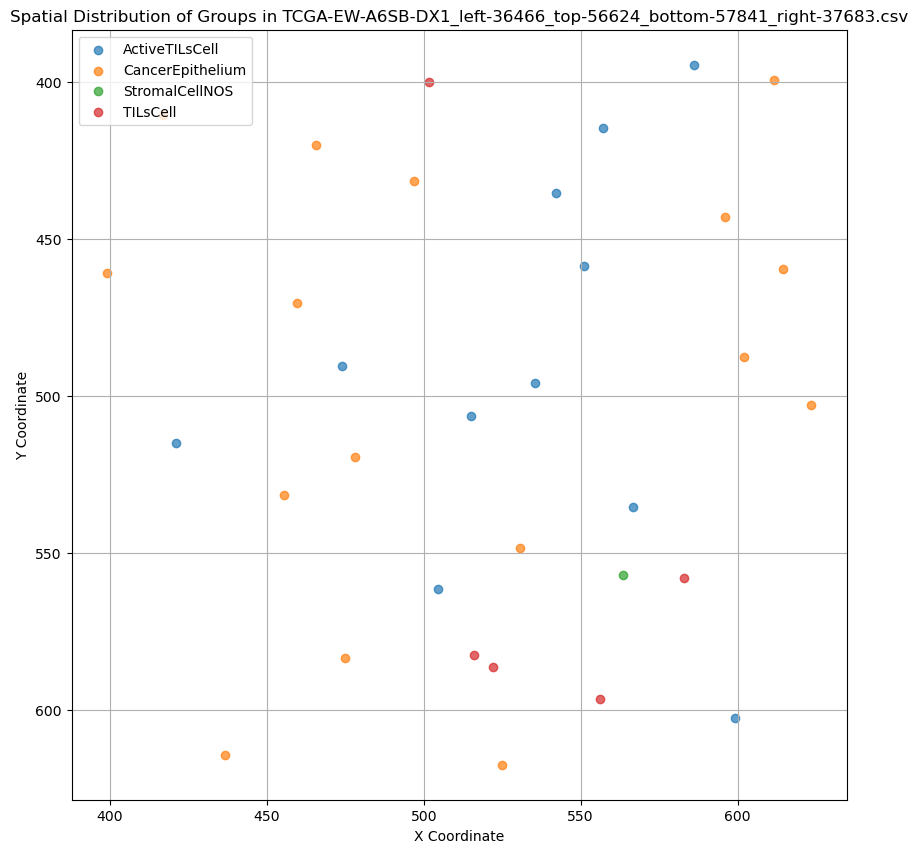

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

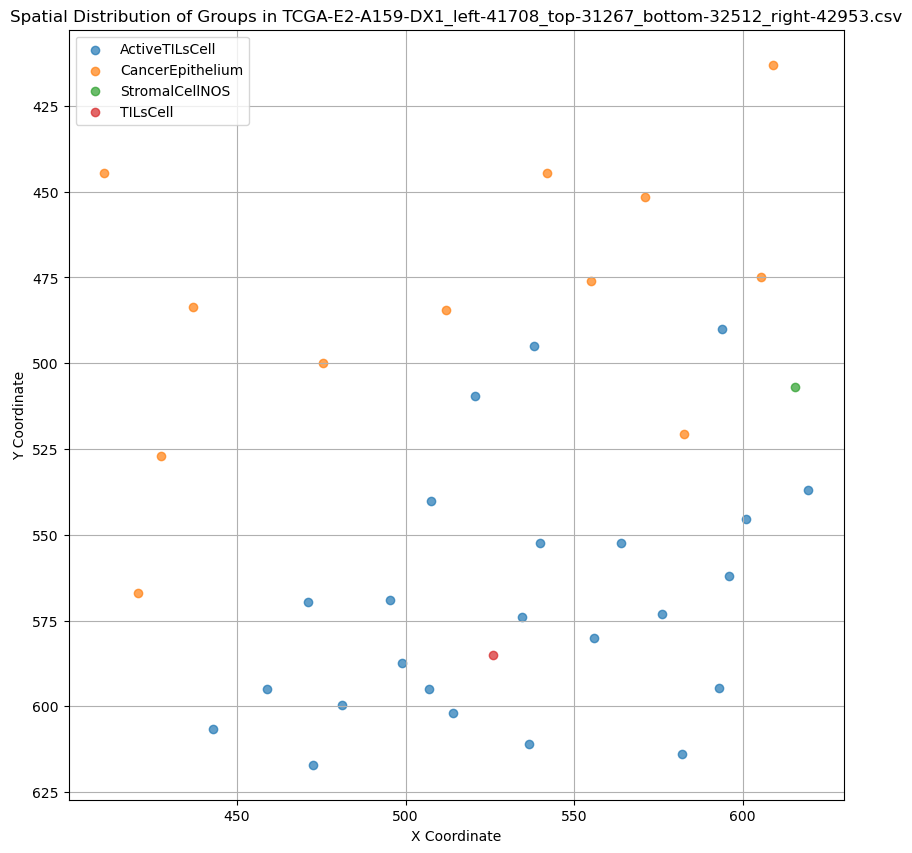

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

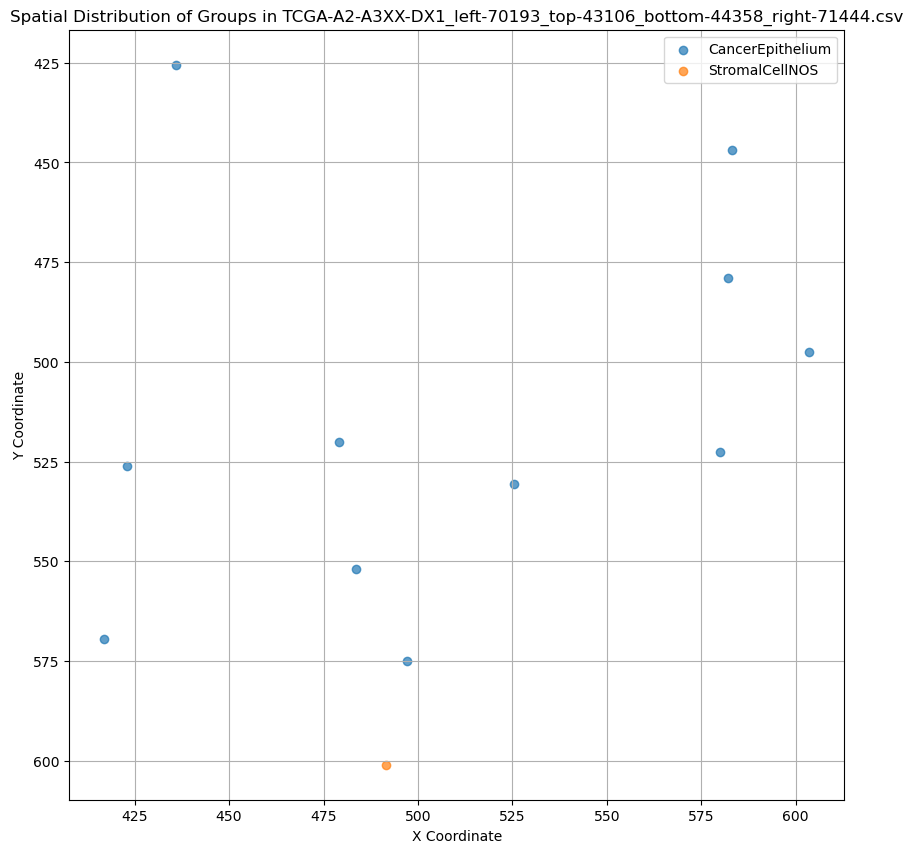

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


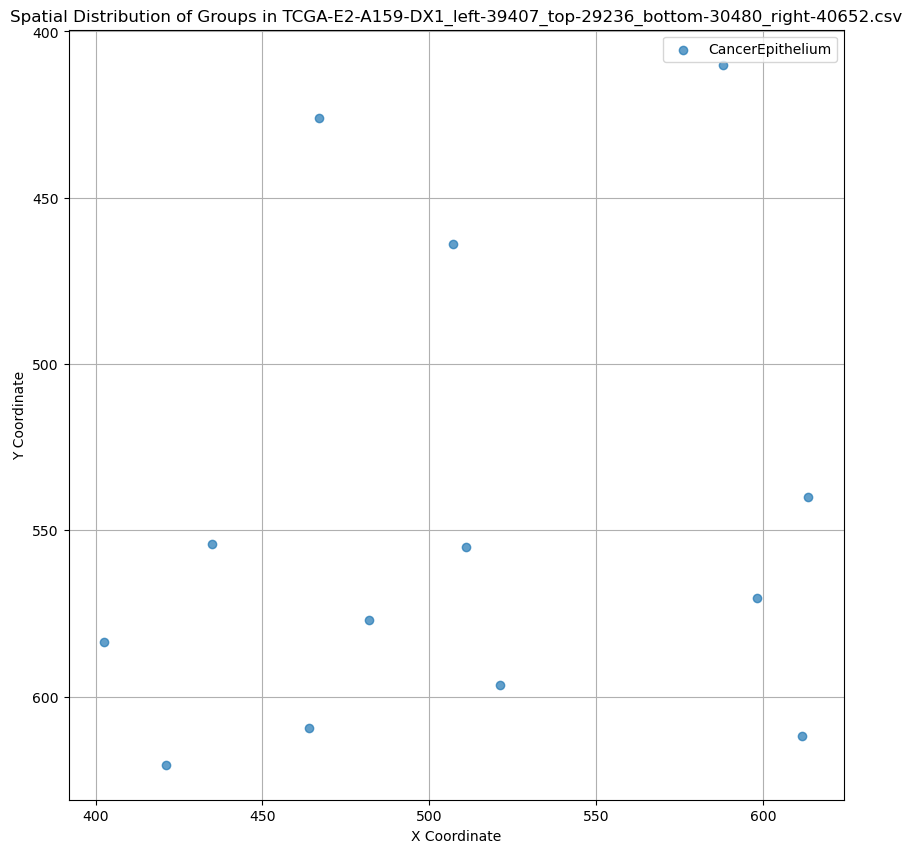

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

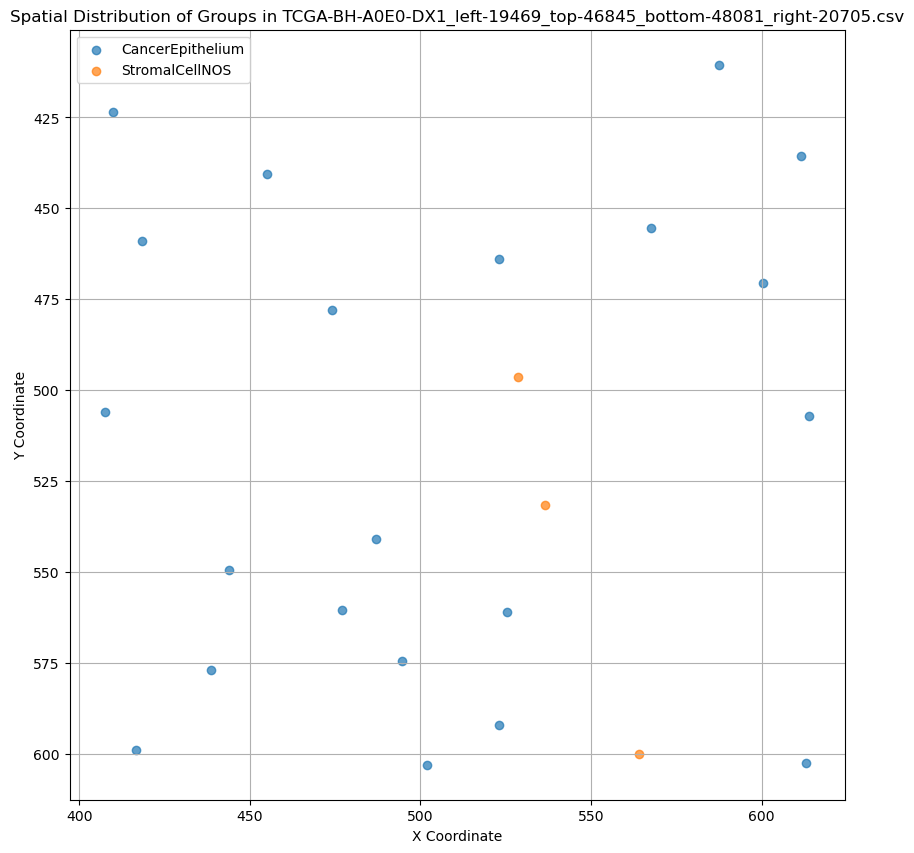

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


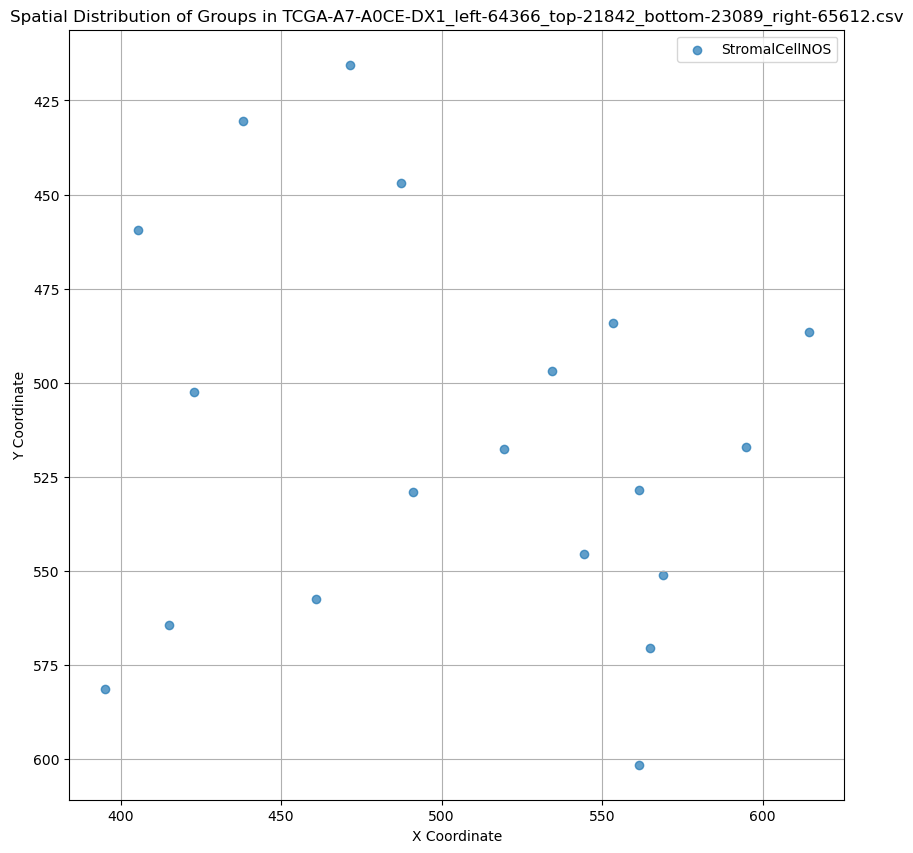

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

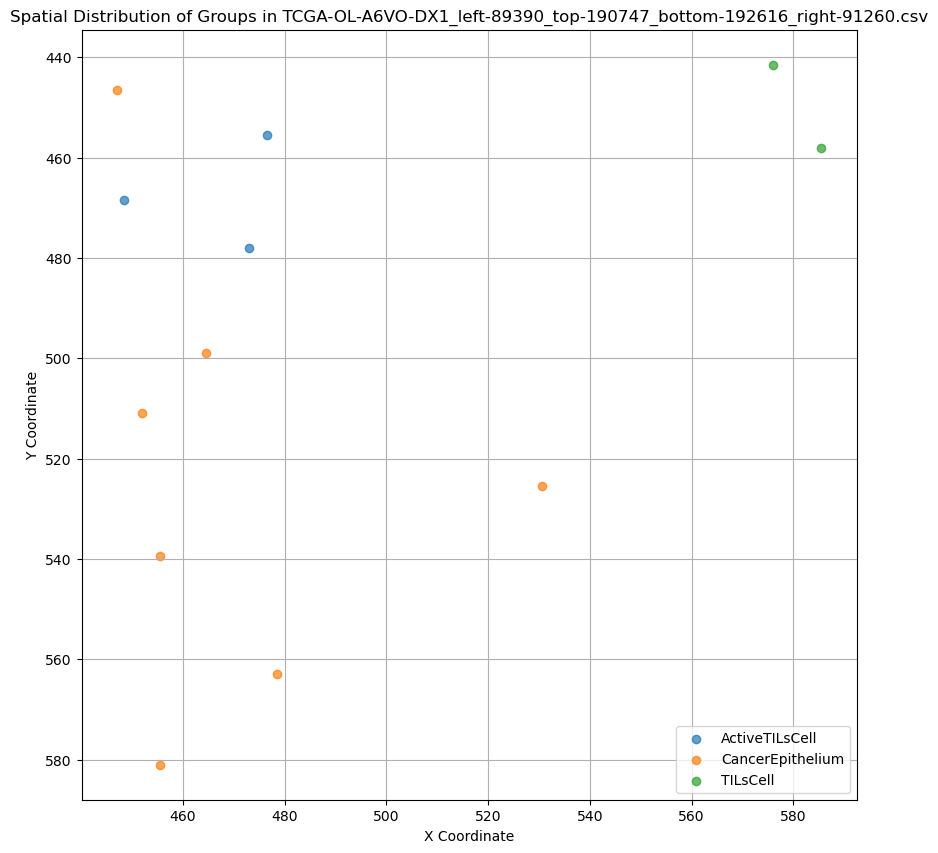

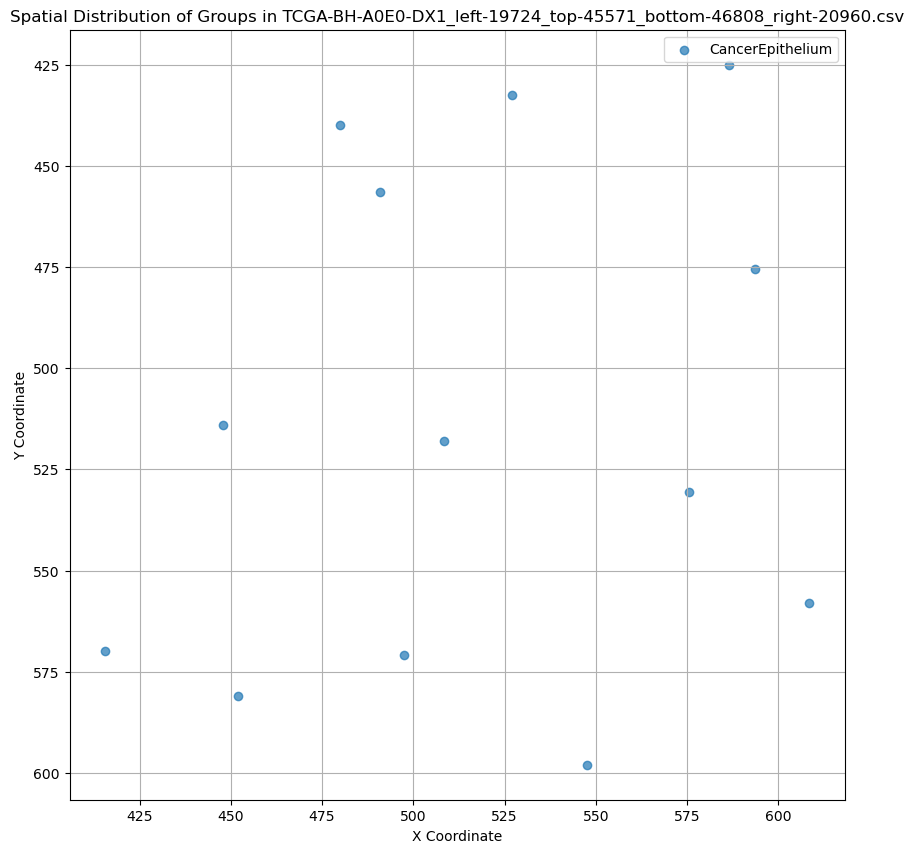

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

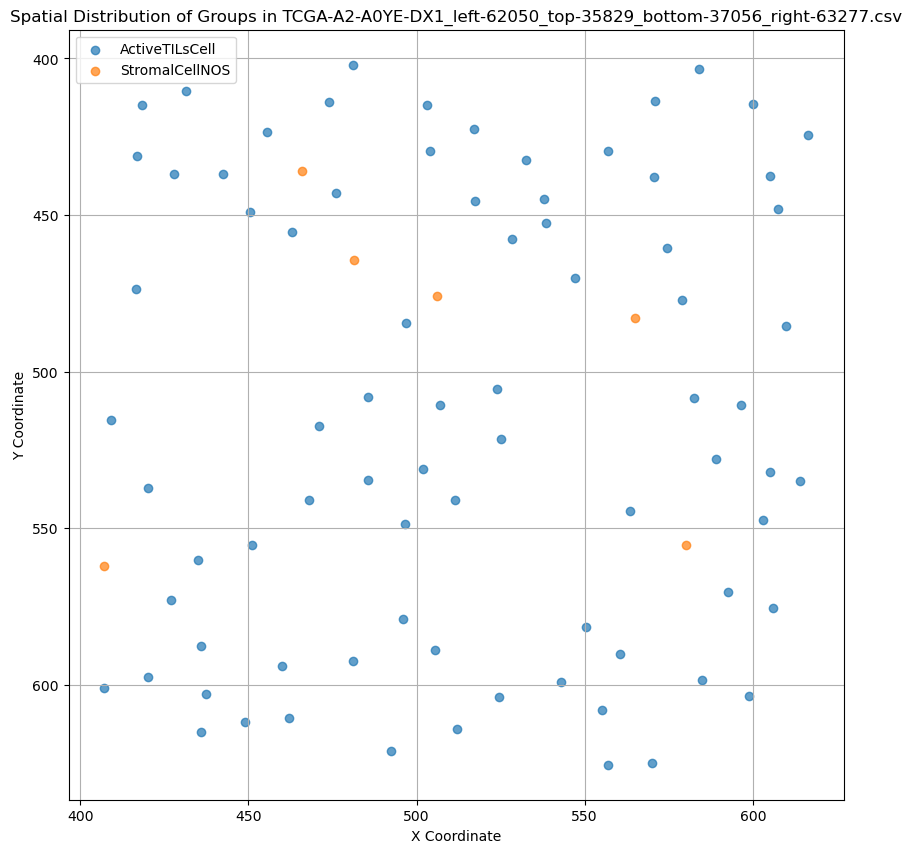

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

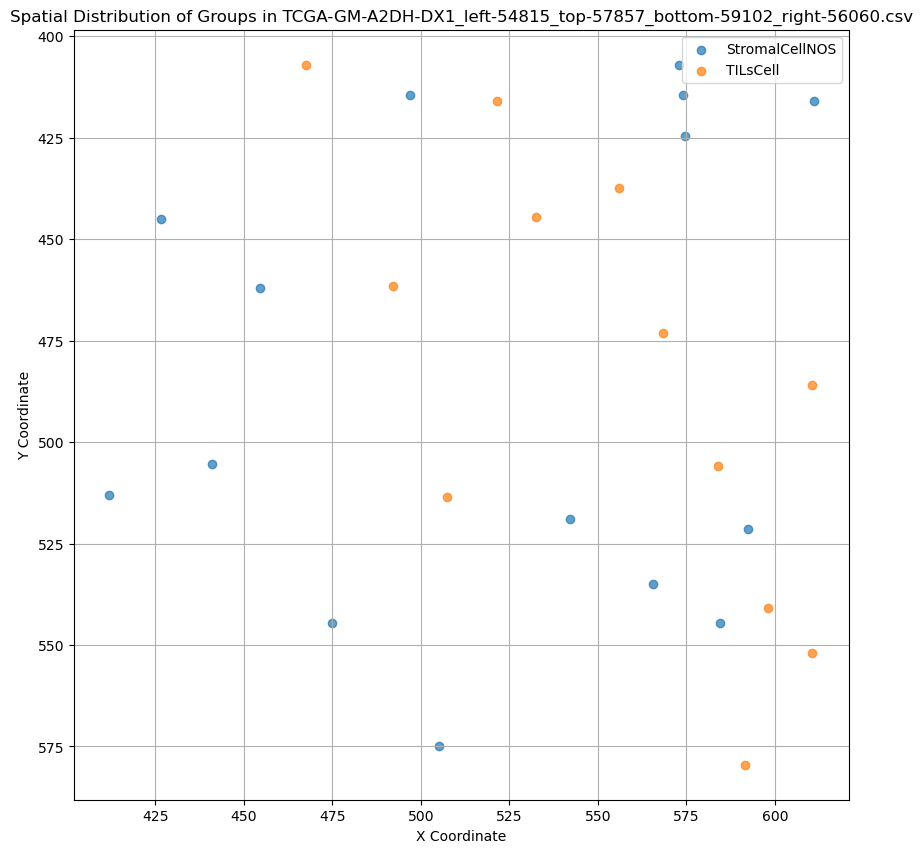

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

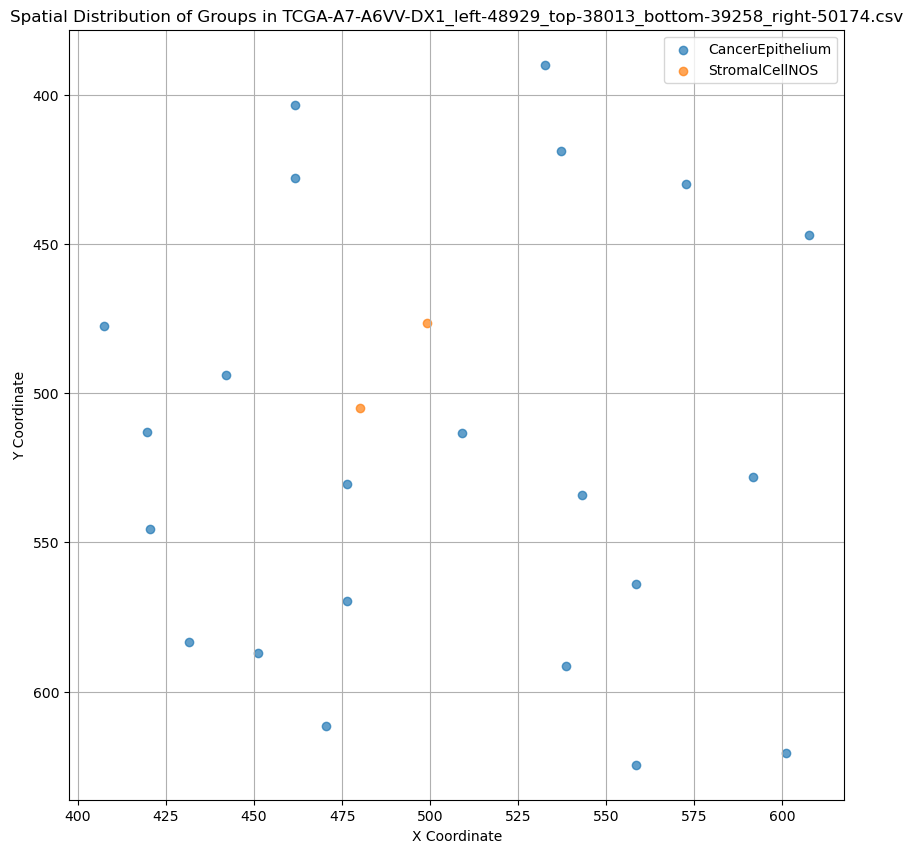

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

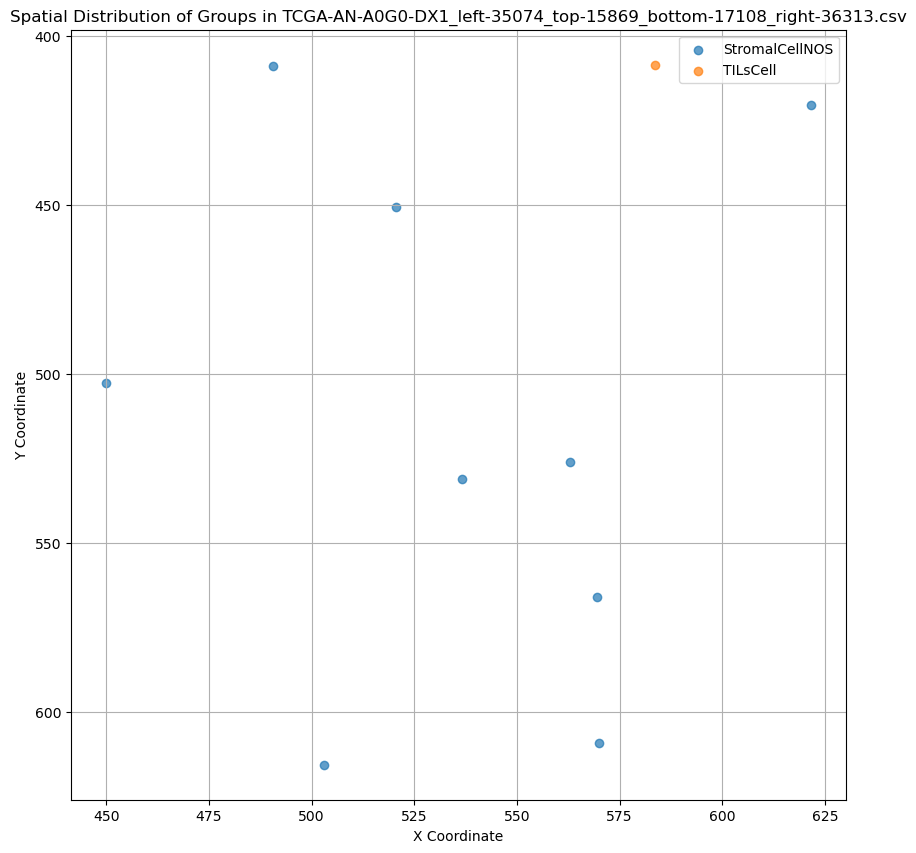

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


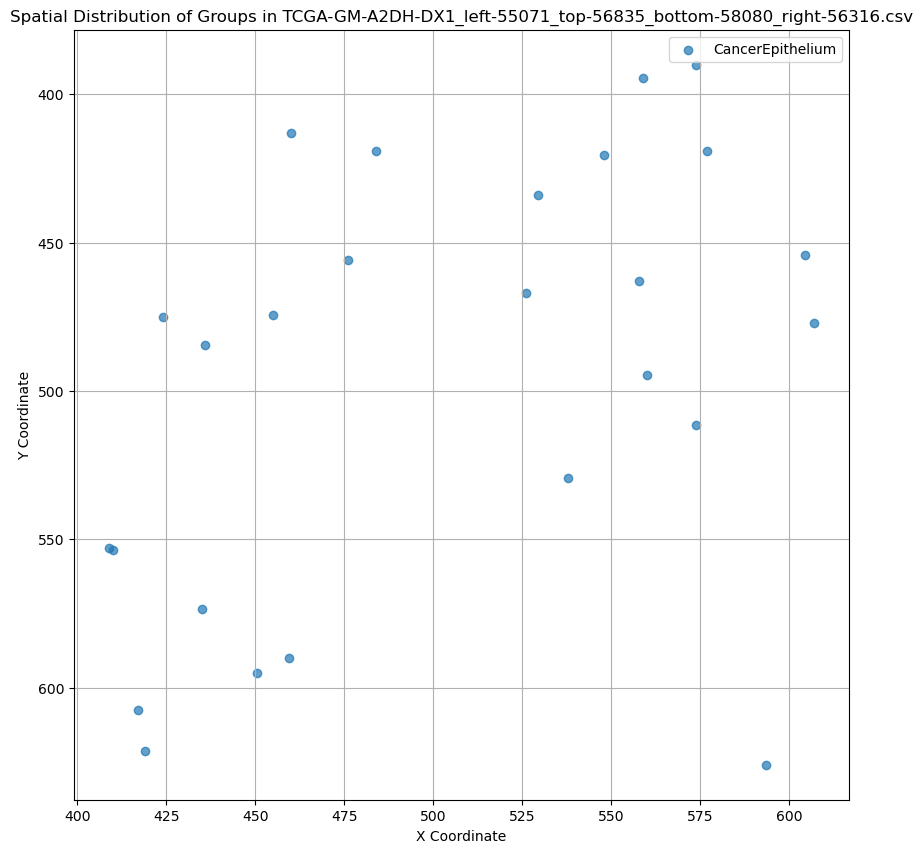

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

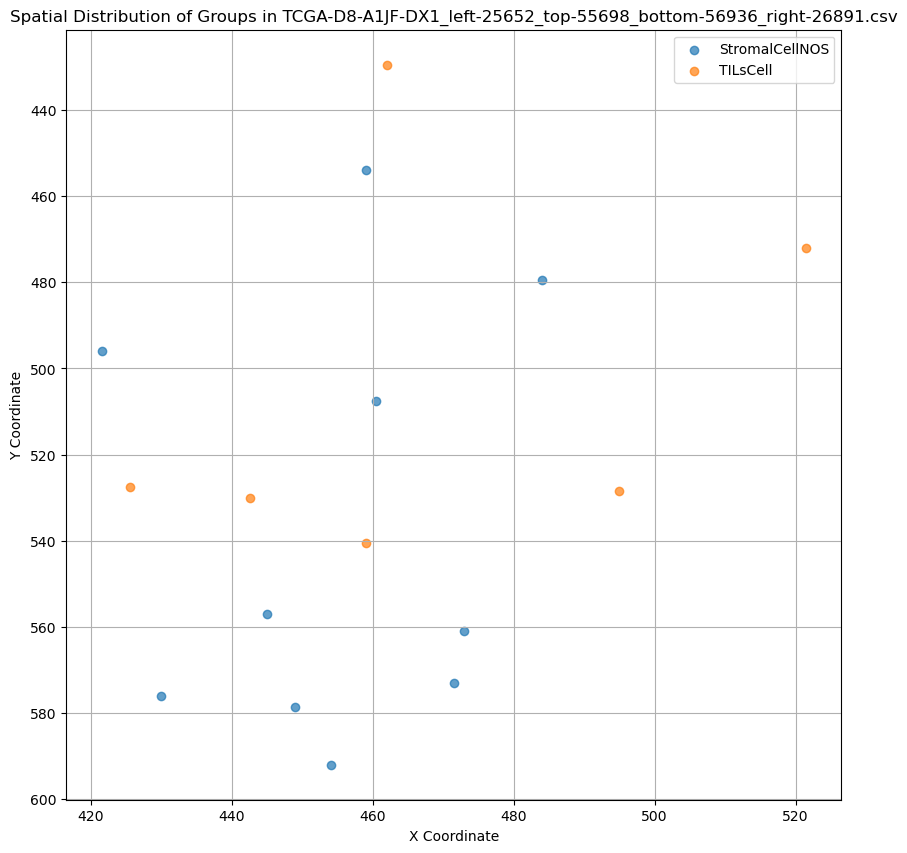

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


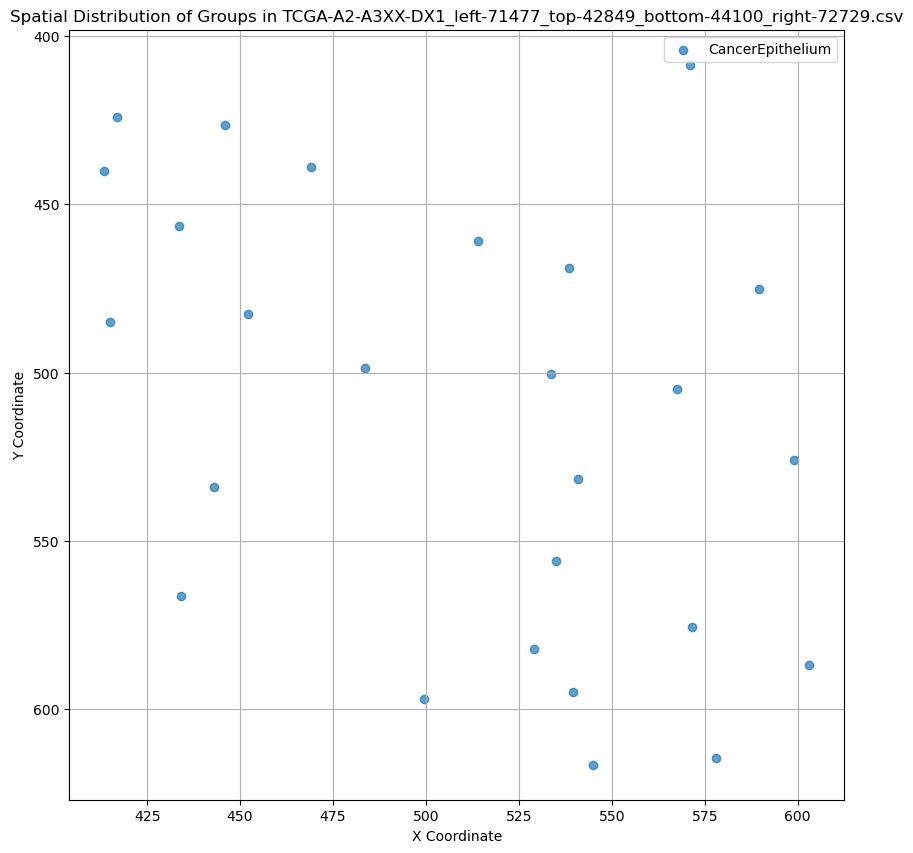

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

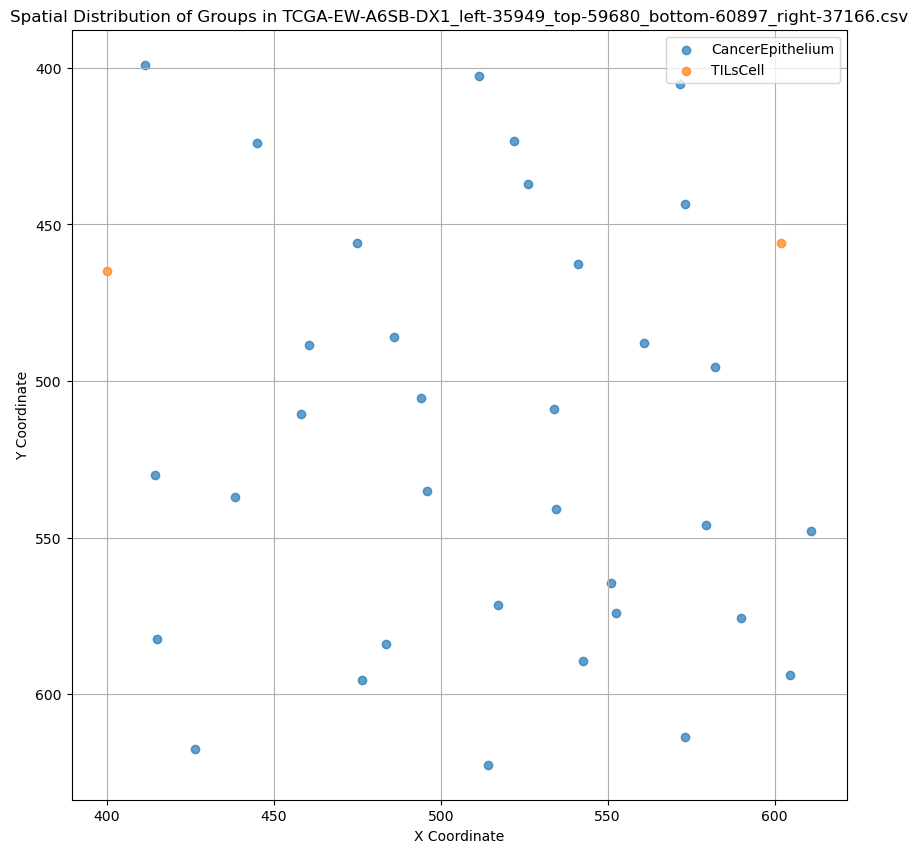

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

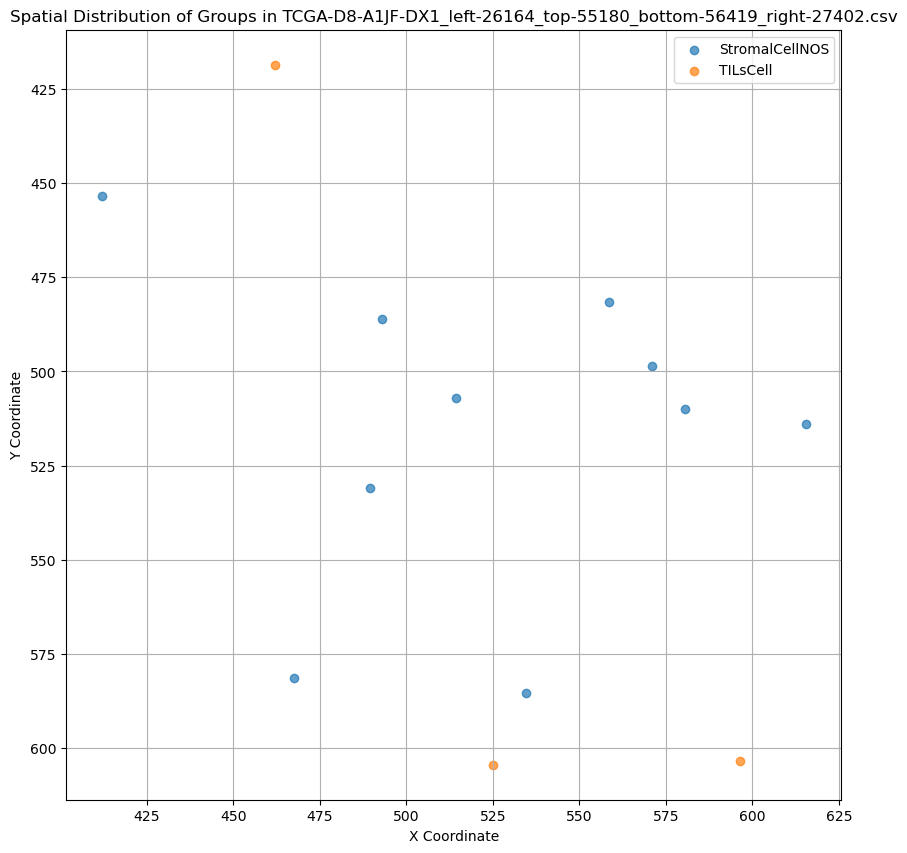

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

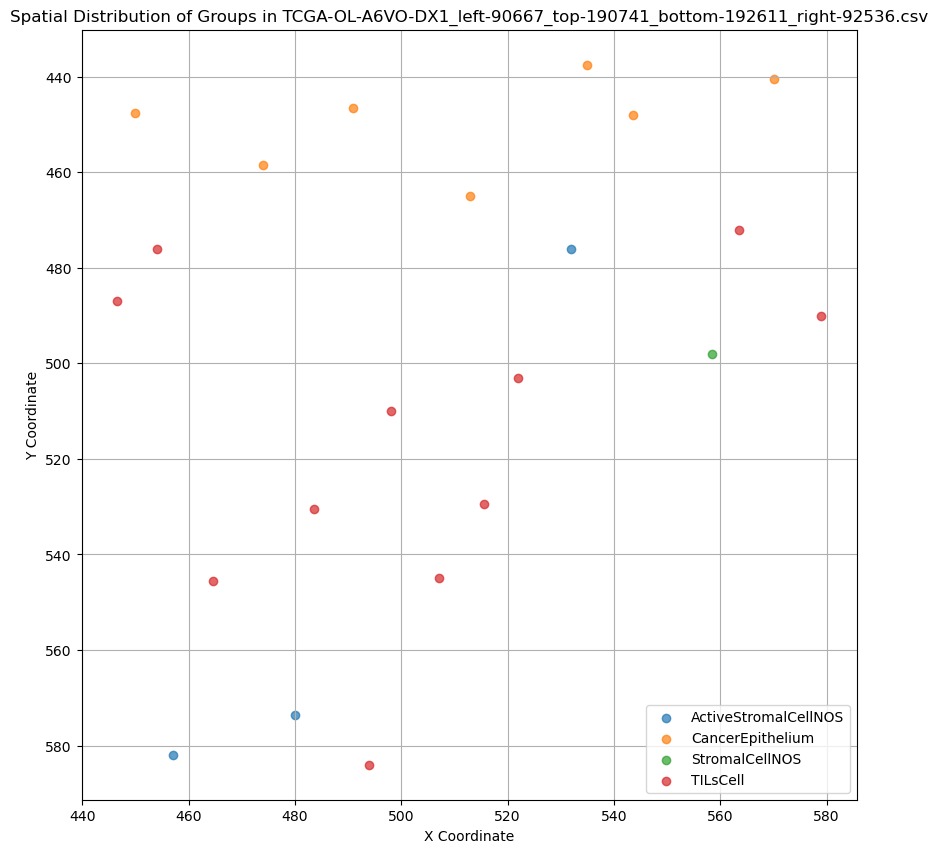

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

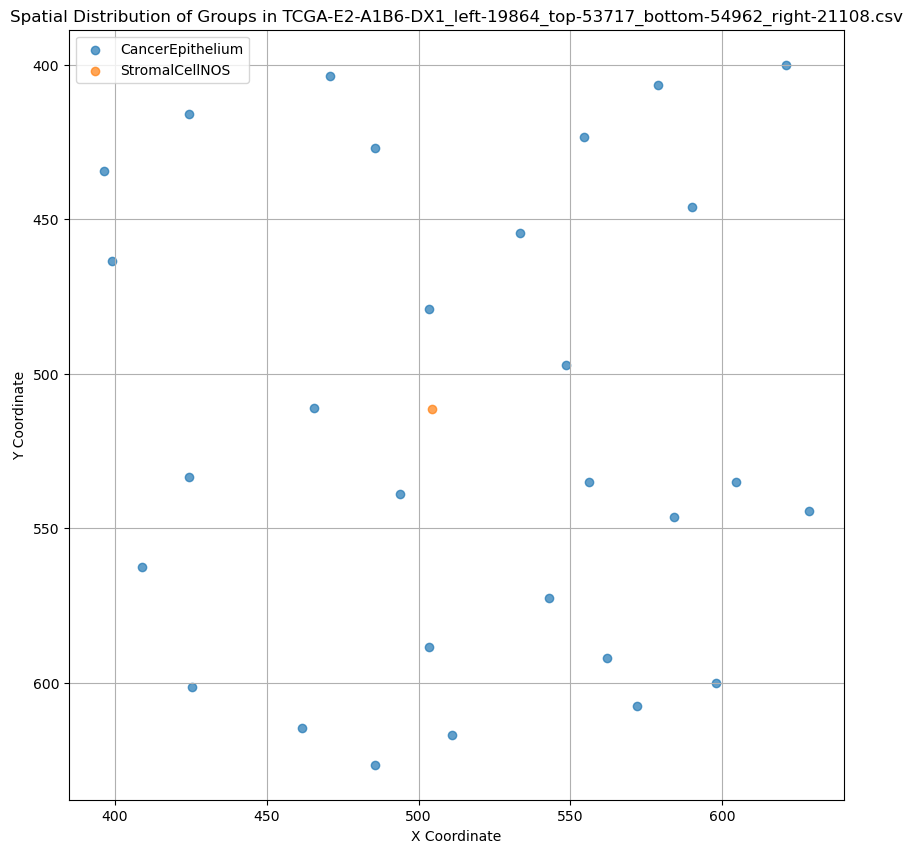

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

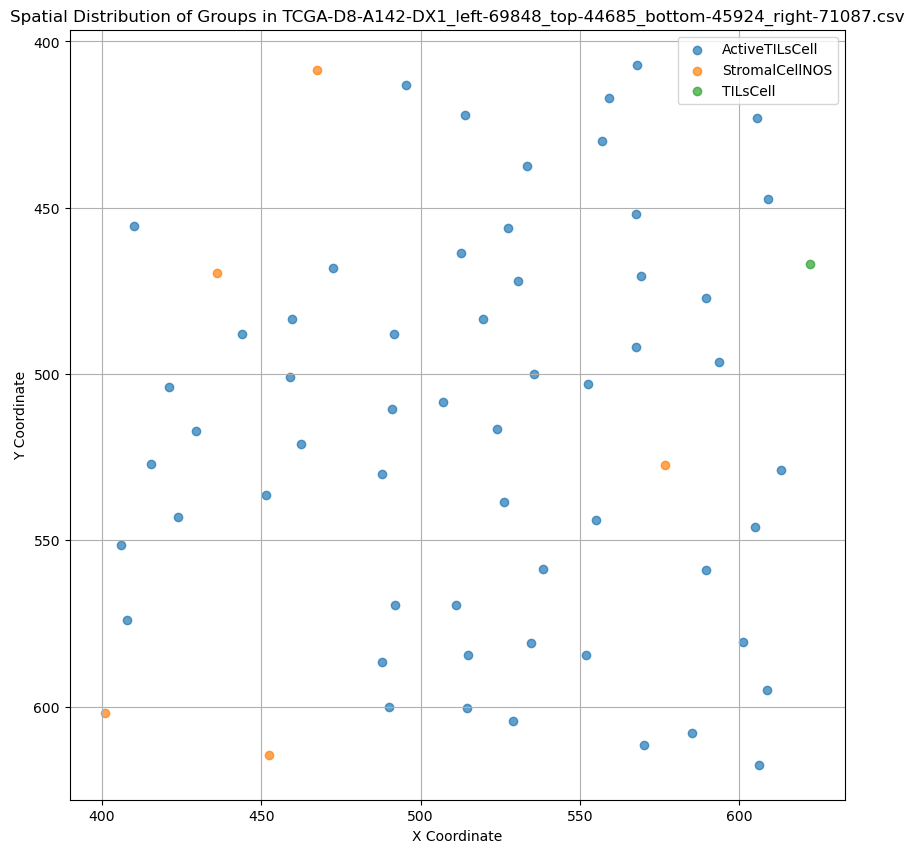

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

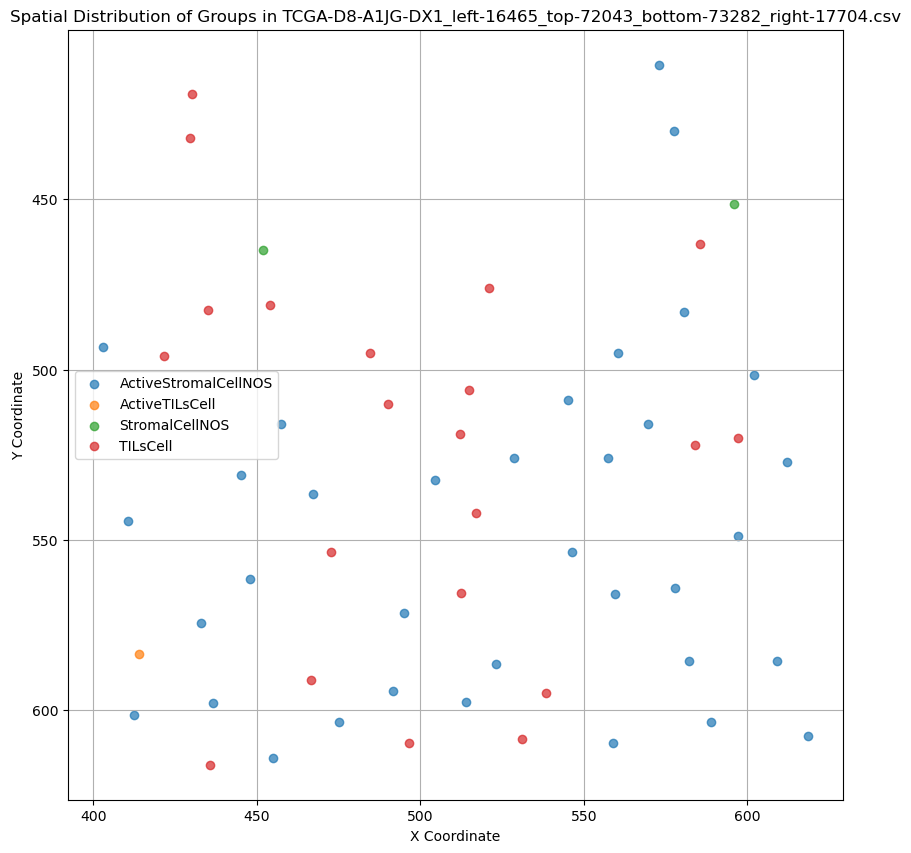

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

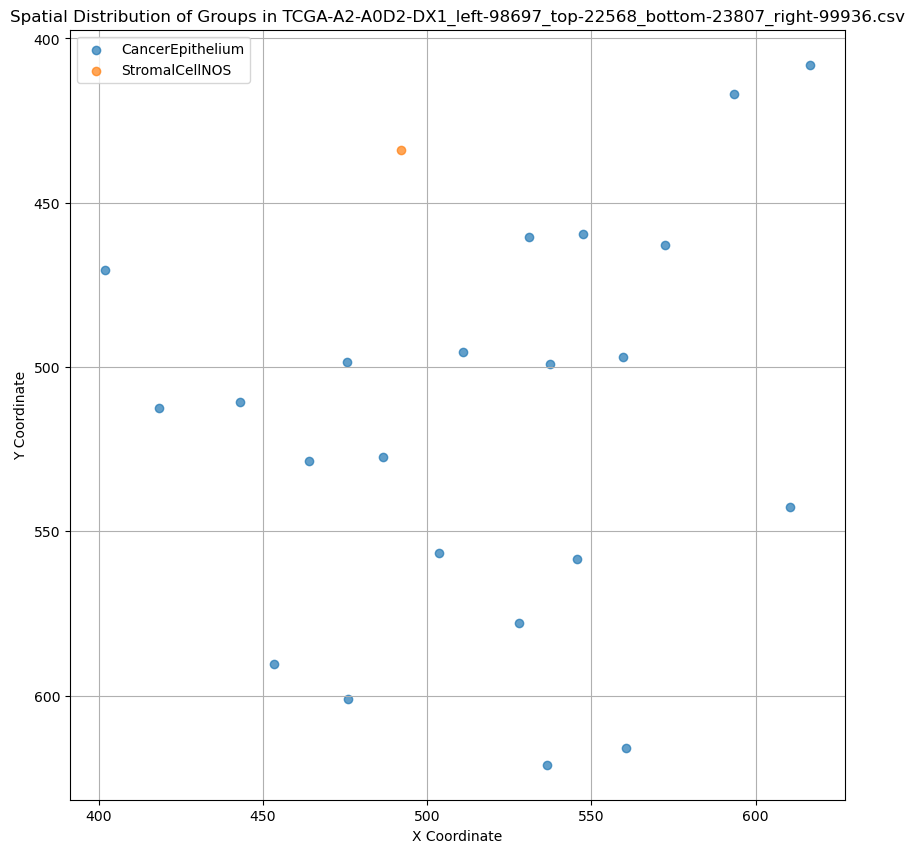

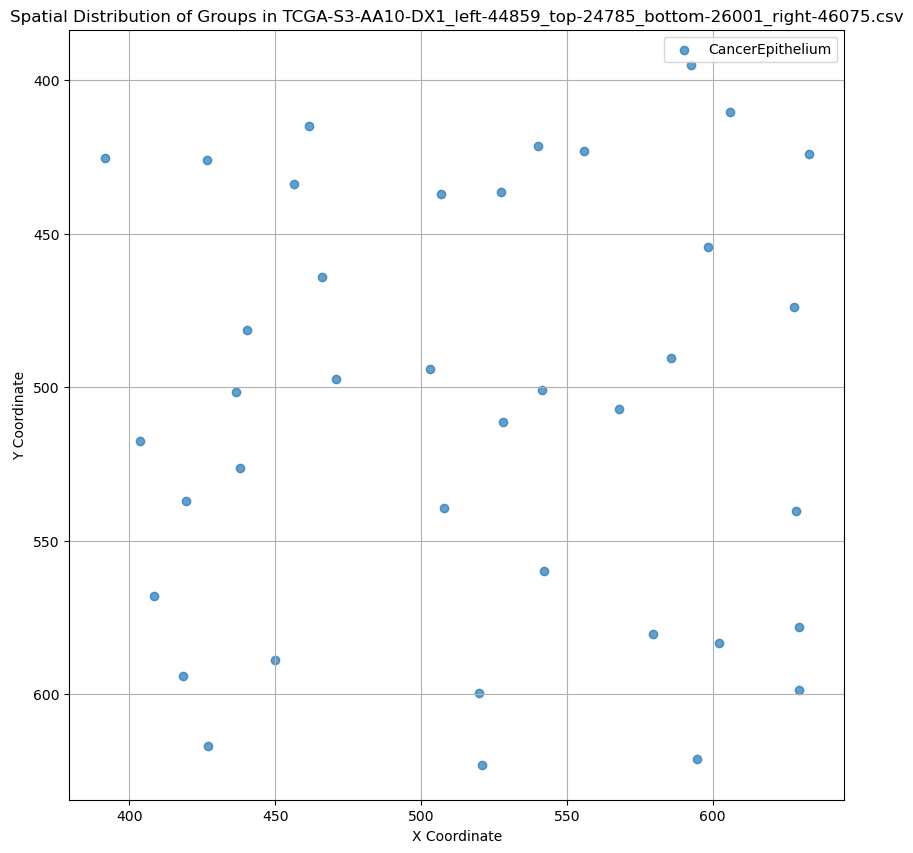

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

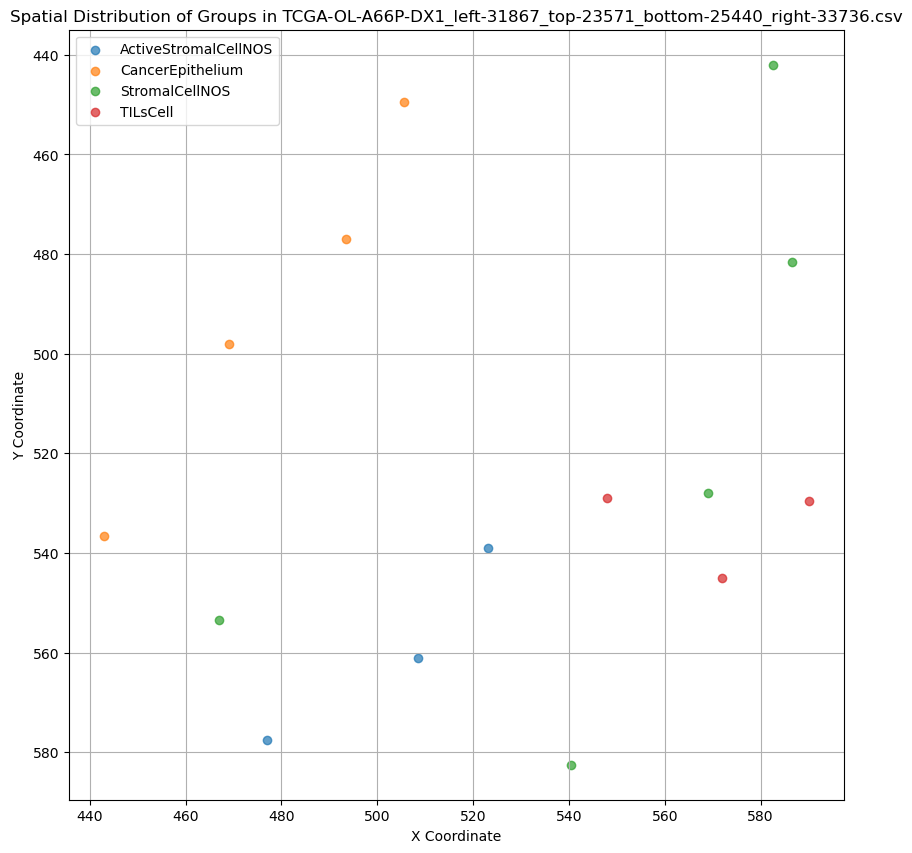

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

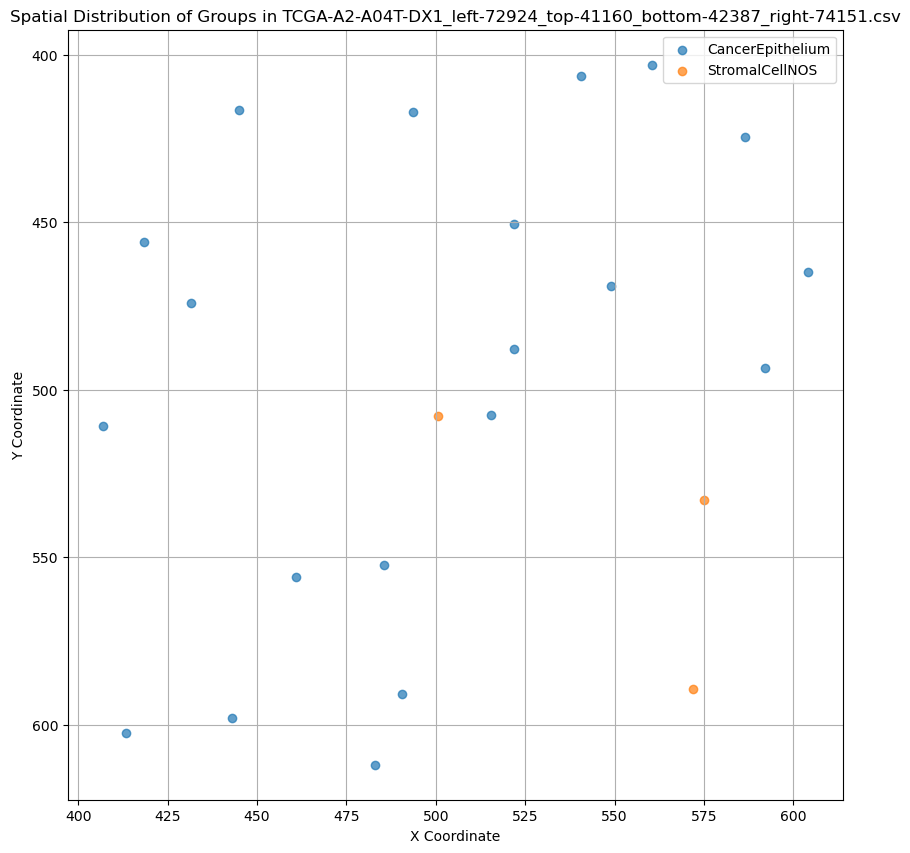

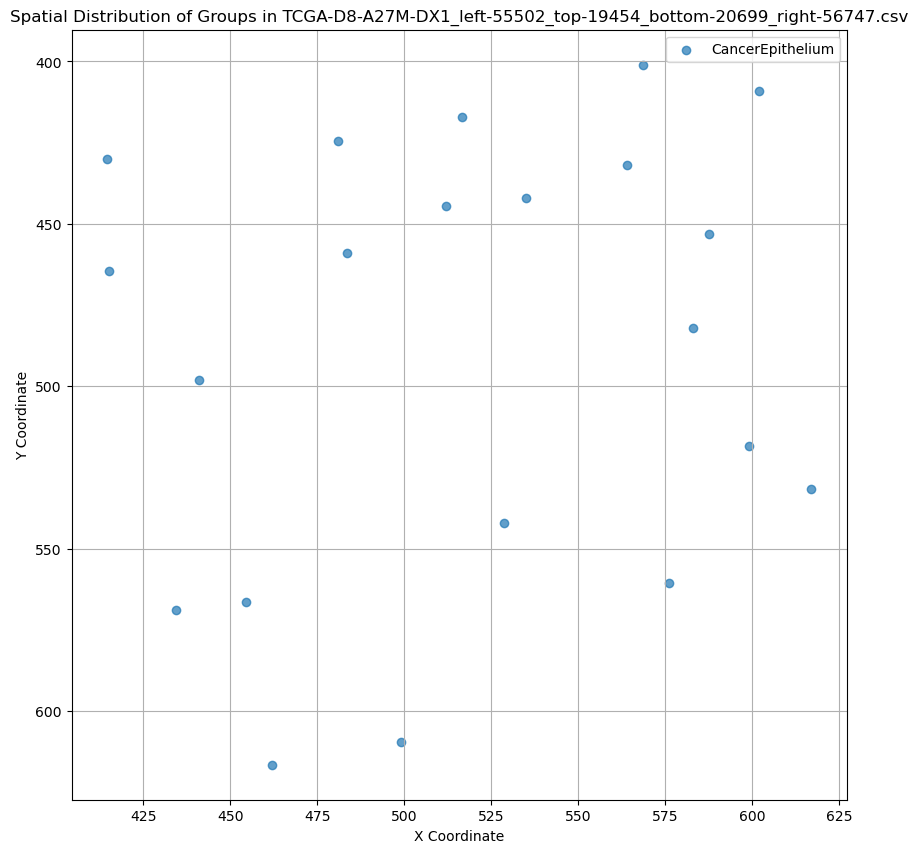

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

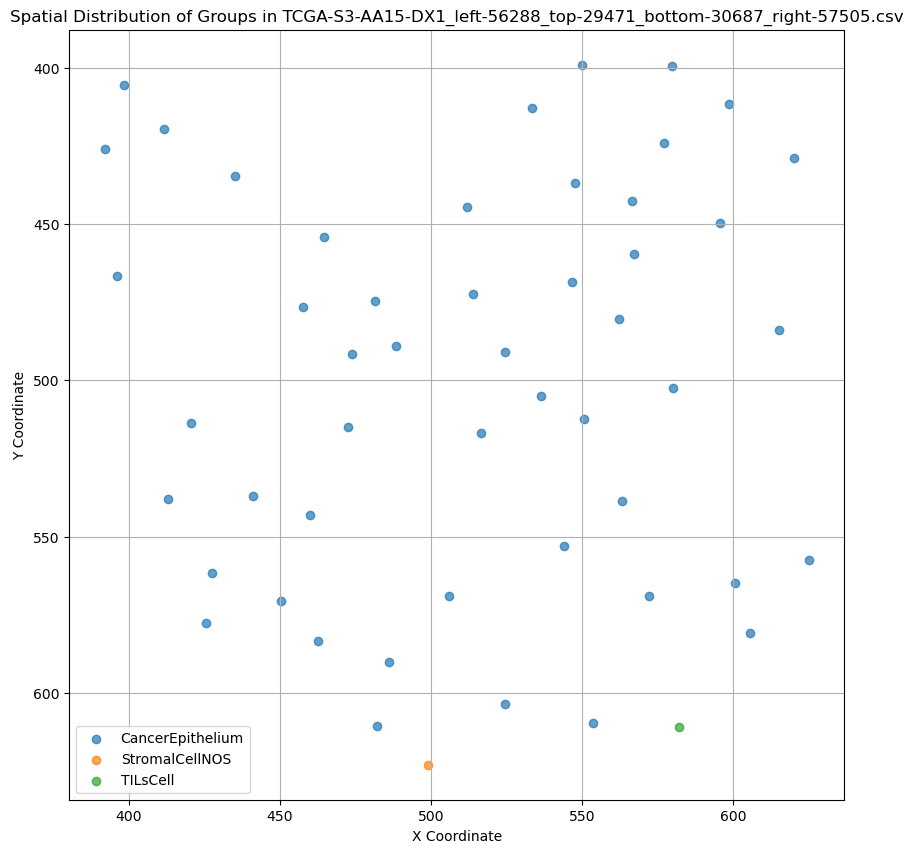

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

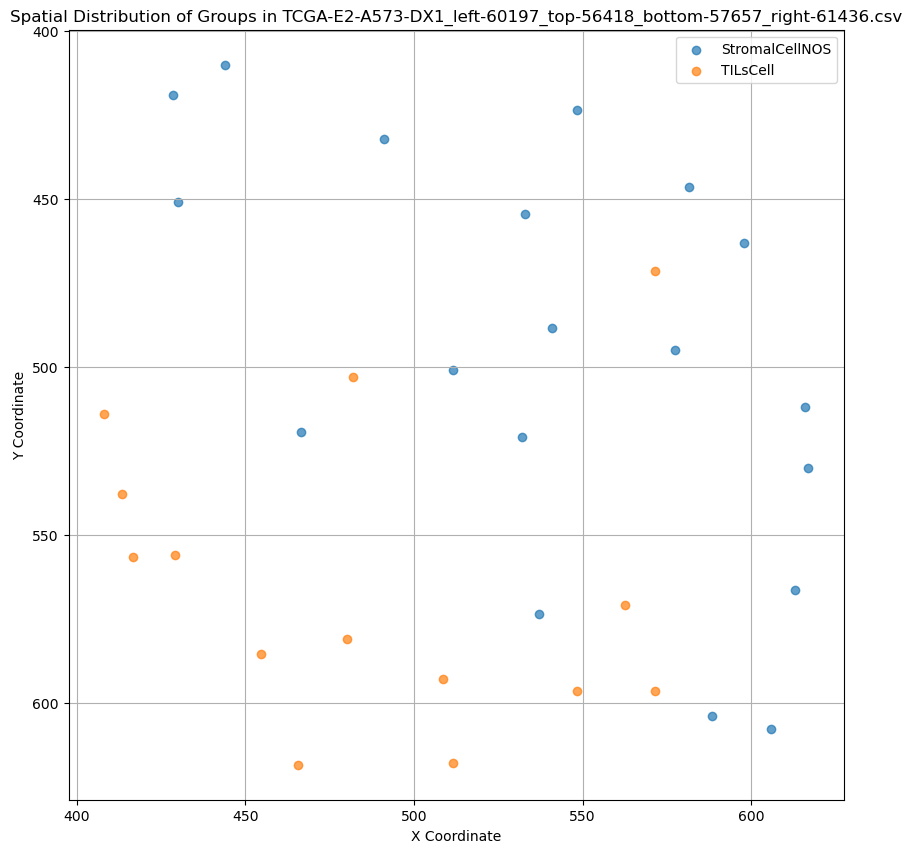

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

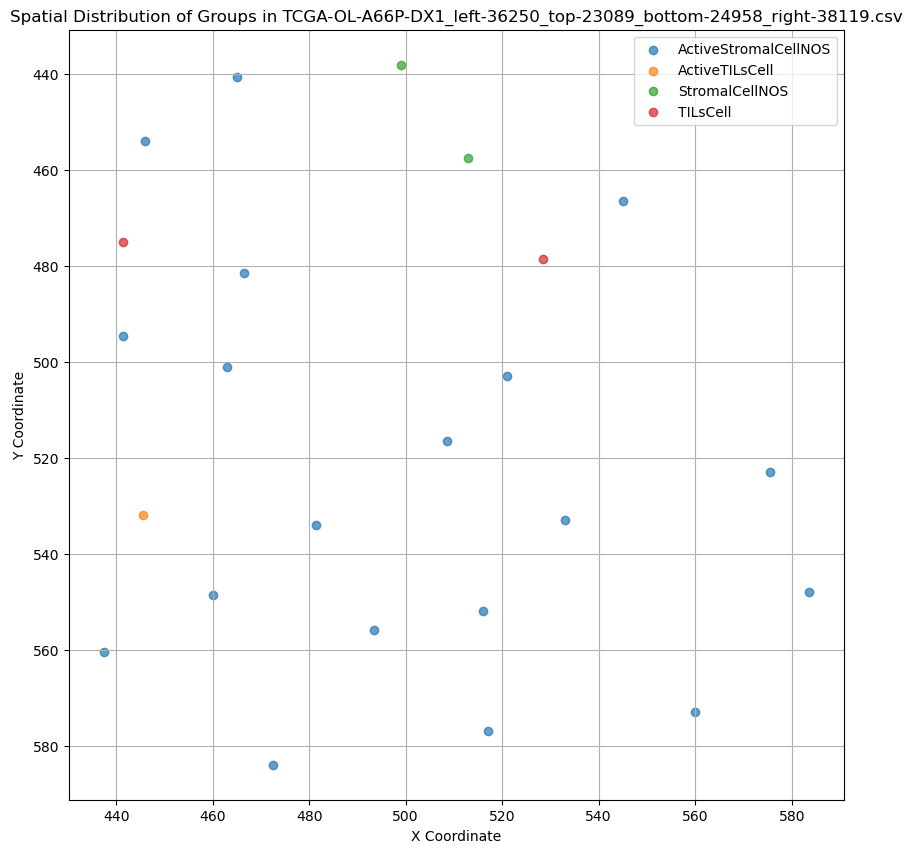

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


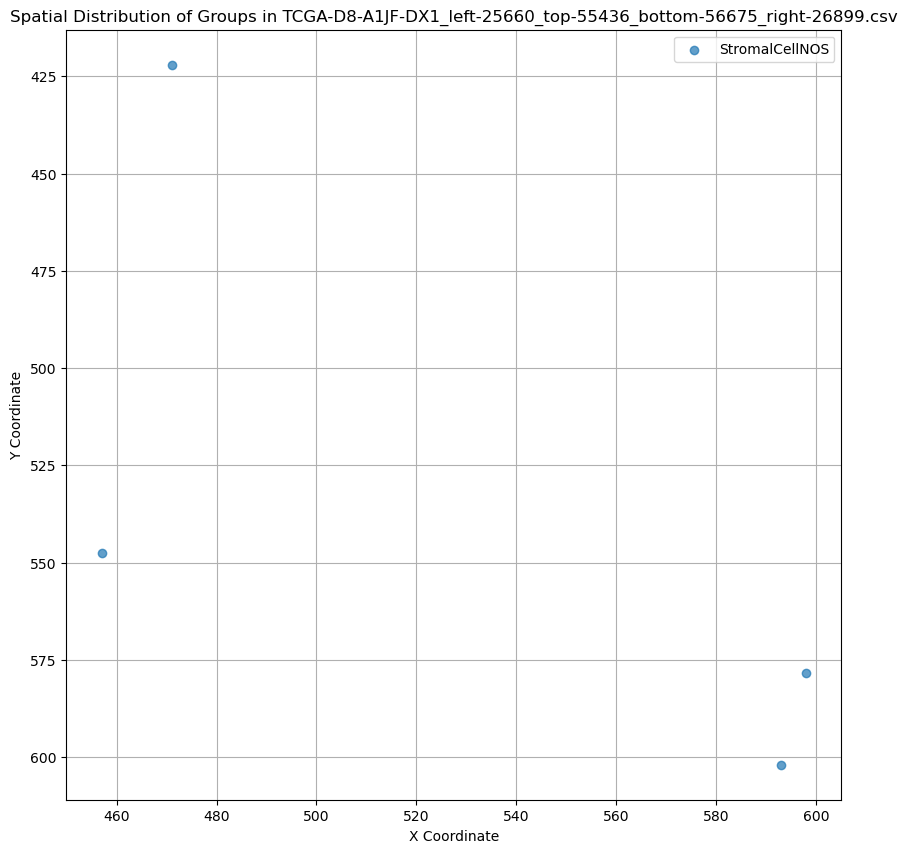

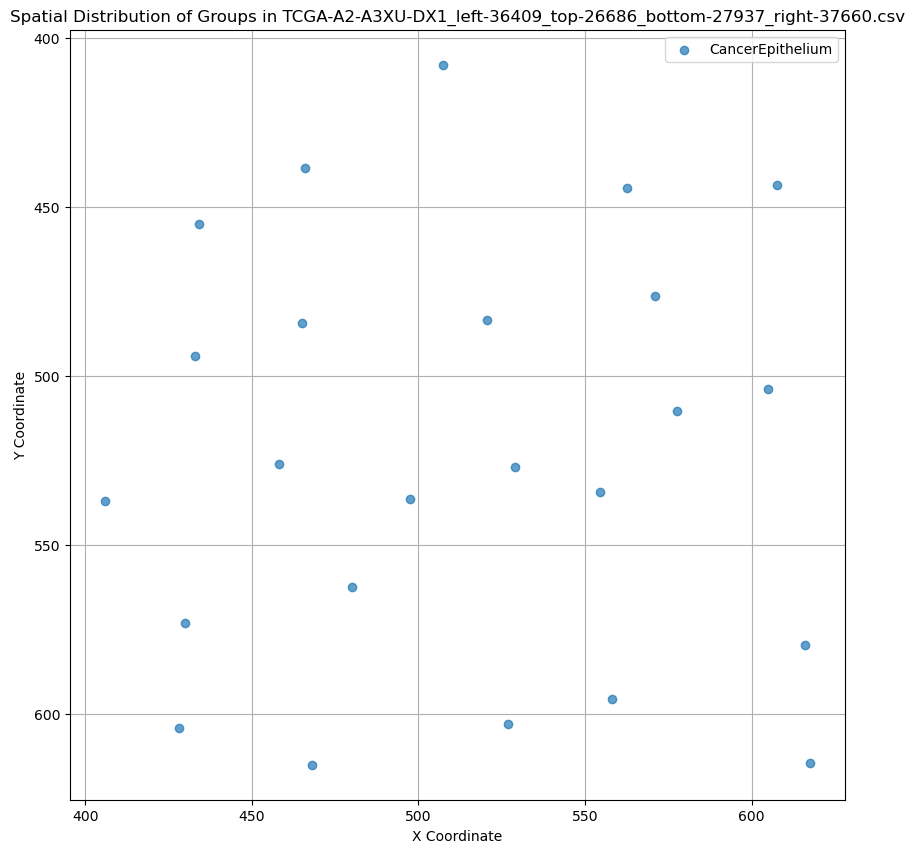

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


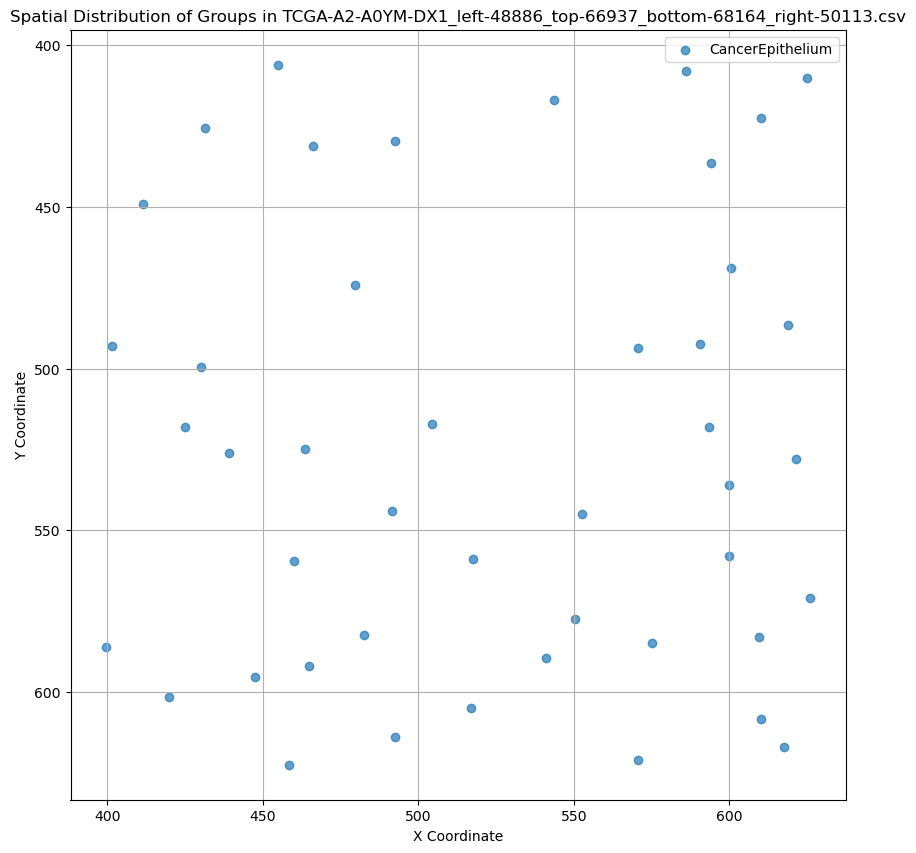

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

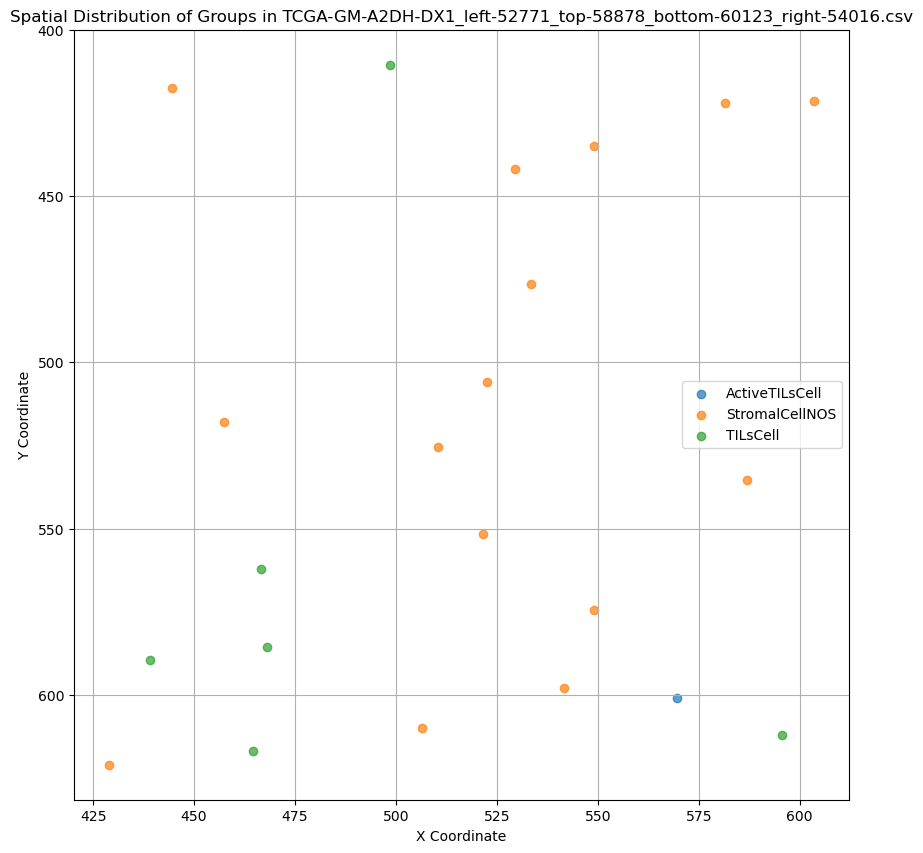

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


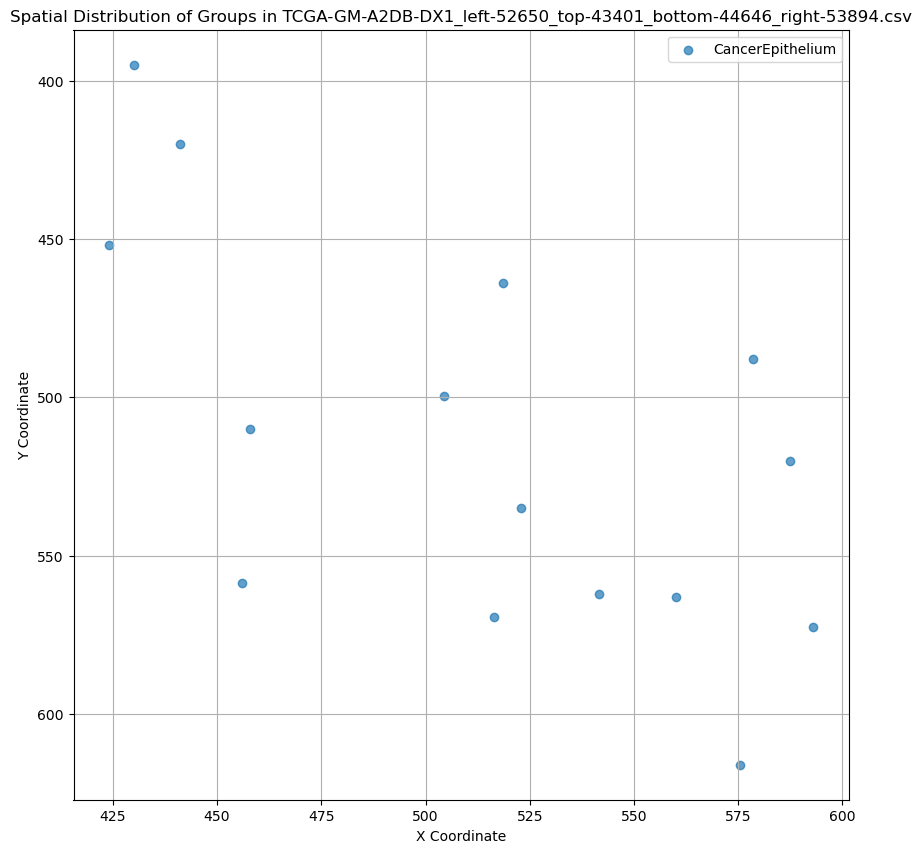

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

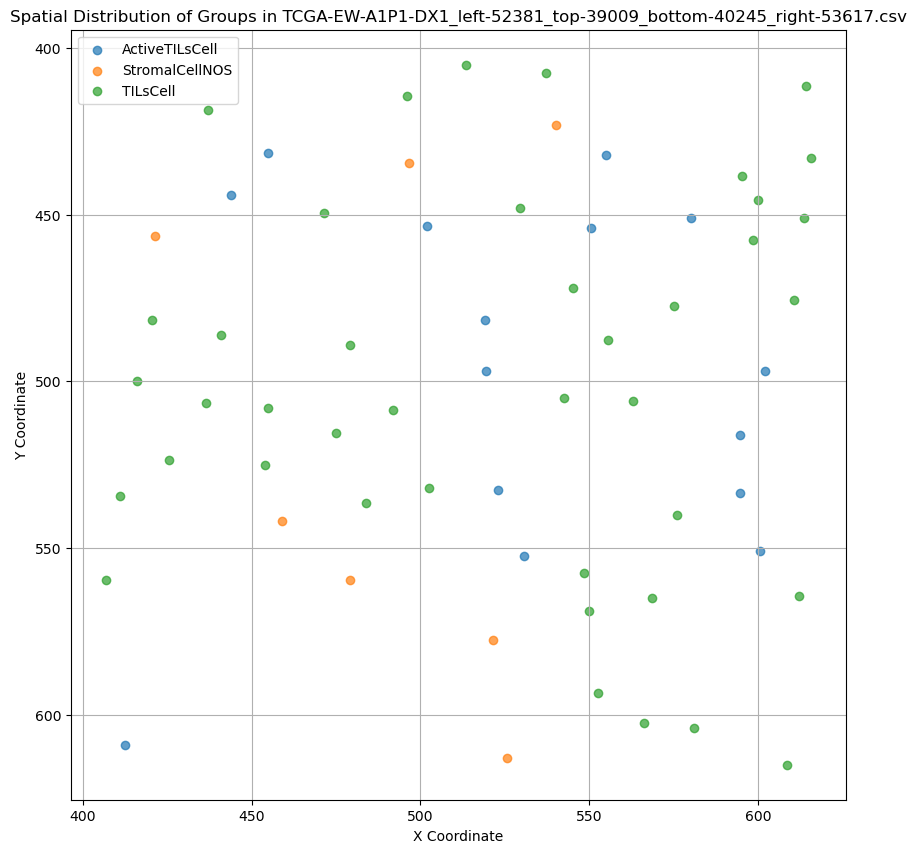

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

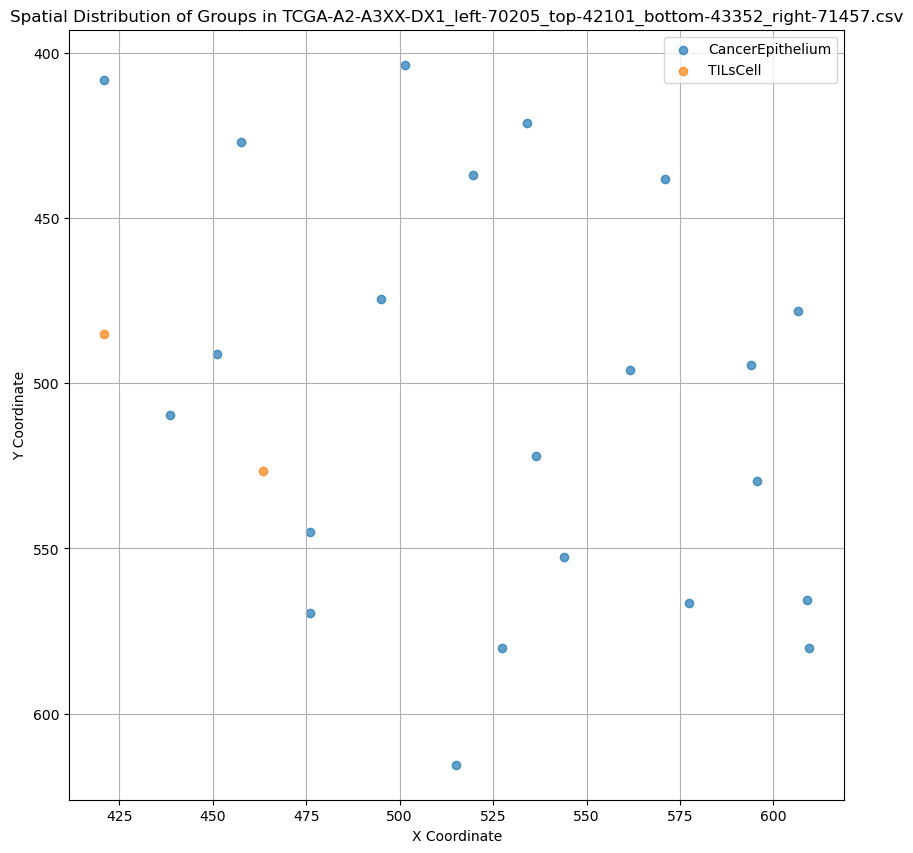

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2


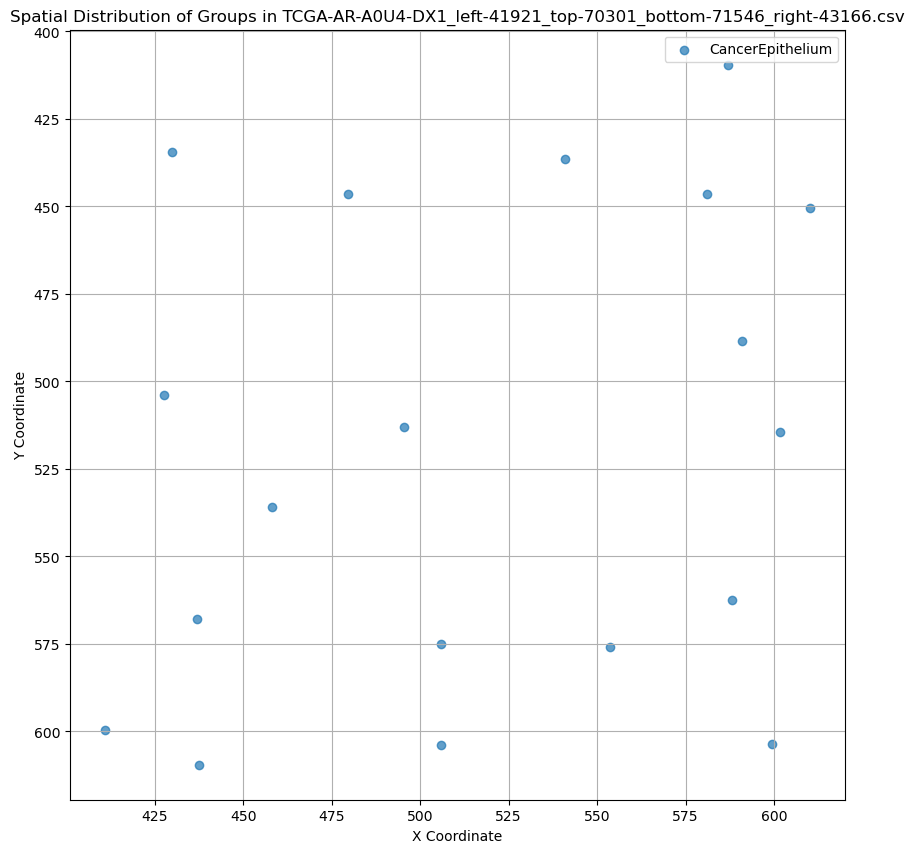

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/2465483991.py:29: SettingWithCopyWarning:

KeyboardInterrupt: 

In [9]:
# Measuring spatial distribution of cancer cells, TILs and stroma on a scatter plot

# Define groups of interest
groups_of_interest = [
    'ActiveStromalCellNOS', 
    'ActiveTILsCell', 
    'CancerEpithelium', 
    'StromalCellNOS', 
    'TILsCell'
]

# Loop through all CSV files in the filtered_csv folder
for csv_file in os.listdir(filtered_csv_dir):
    if csv_file.endswith(".csv"):
        csv_path = os.path.join(filtered_csv_dir, csv_file)
        
        # Load the CSV file
        csv_data = pd.read_csv(csv_path)
        
        # Initialise a plot
        plt.figure(figsize=(10, 10))
        
        # Loop through each group of interest
        for group in groups_of_interest:
            group_data = csv_data[csv_data['group'] == group]

            if not group_data.empty:
                # Calculate centroids
                group_data['centroid_x'] = (group_data['left'] + group_data['right']) / 2
                group_data['centroid_y'] = (group_data['top'] + group_data['bottom']) / 2

                # Plot centroids
                plt.scatter(
                    group_data['centroid_x'], 
                    group_data['centroid_y'], 
                    alpha=0.7, 
                    label=group
                )

        # Customise plot
        plt.title(f"Spatial Distribution of Groups in {csv_file}")
        plt.xlabel("X Coordinate")
        plt.ylabel("Y Coordinate")
        plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
        plt.legend(loc='best')
        plt.grid(True)
        plt.show()


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


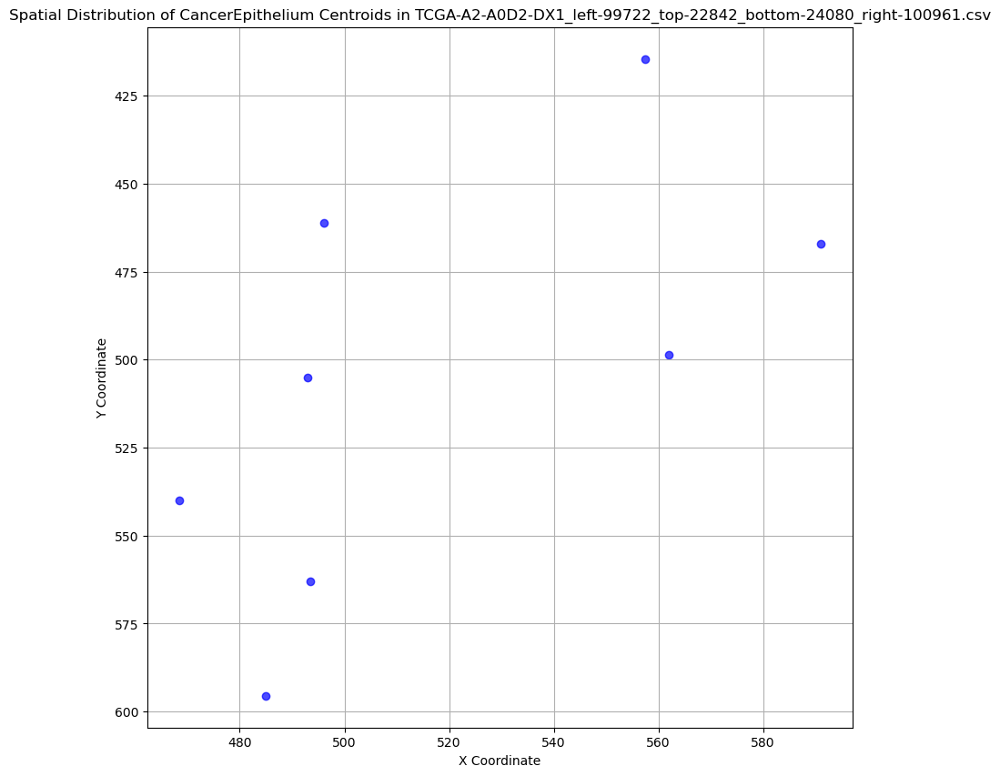

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A0D2-DX1_left-99722_top-22842_bottom-24080_right-100961.csv:
Number of CancerEpithelium regions: 8
Mean area: 833.12
Standard deviation of area: 371.01
Coefficient of variation (heterogeneity): 0.45


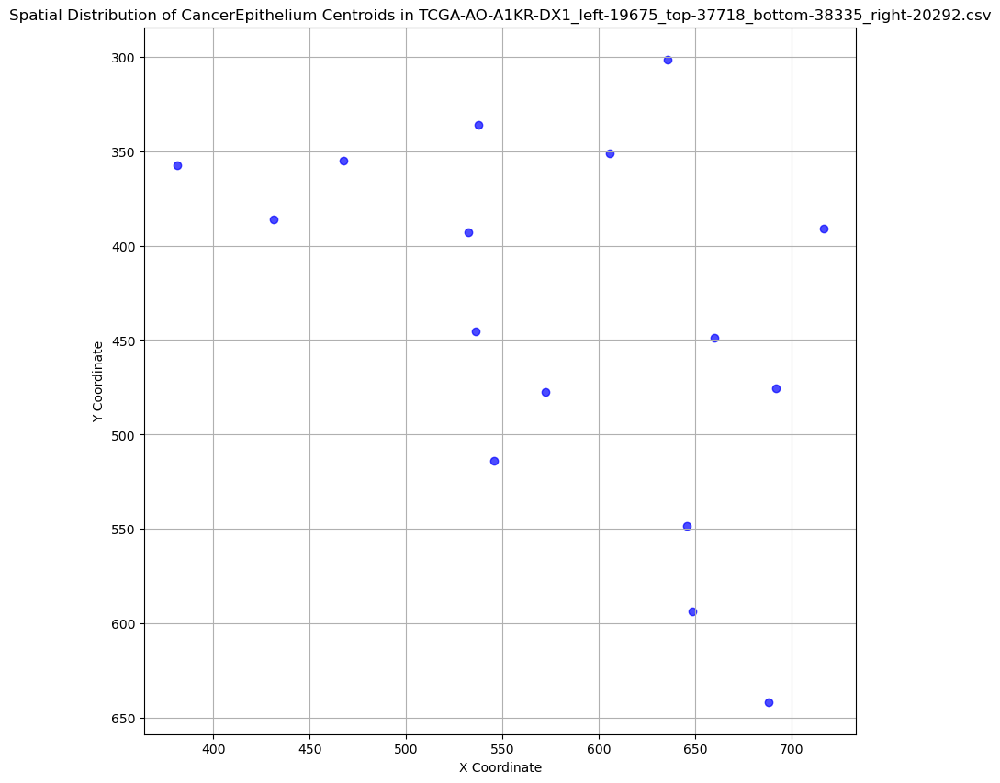

CancerEpithelium Spatial Analysis for TCGA-AO-A1KR-DX1_left-19675_top-37718_bottom-38335_right-20292.csv:
Number of CancerEpithelium regions: 16
Mean area: 1760.38
Standard deviation of area: 772.24
Coefficient of variation (heterogeneity): 0.44
No CancerEpithelium regions found in TCGA-EW-A6SB-DX1_left-37469_top-61209_bottom-62426_right-38686.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

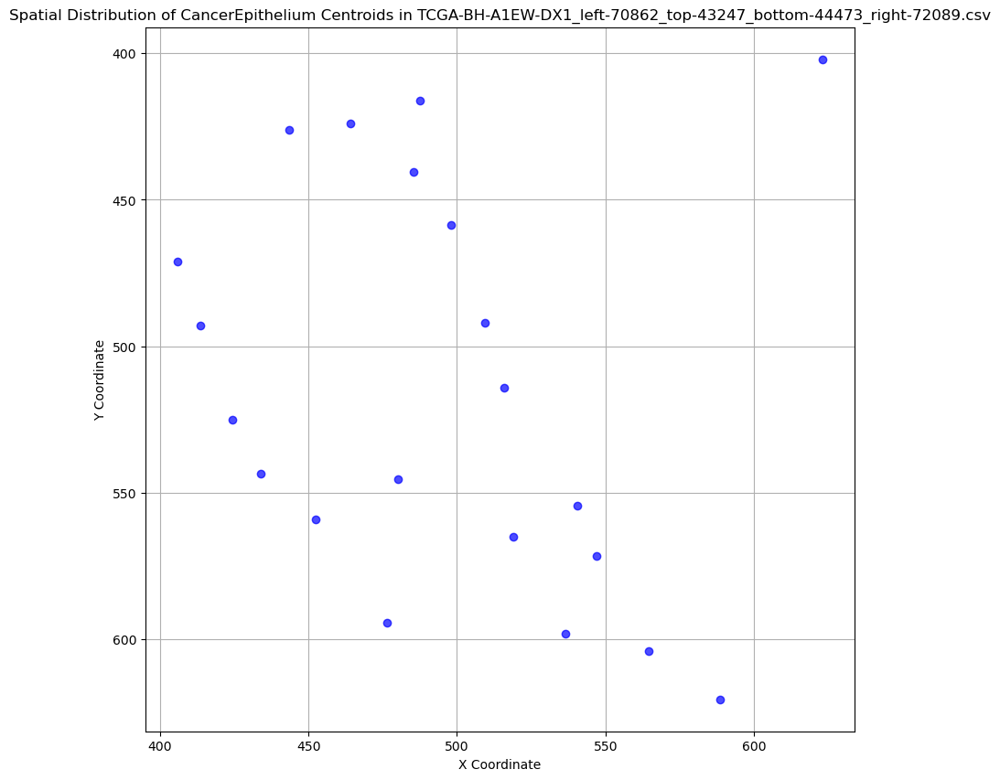

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-BH-A1EW-DX1_left-70862_top-43247_bottom-44473_right-72089.csv:
Number of CancerEpithelium regions: 21
Mean area: 825.81
Standard deviation of area: 373.87
Coefficient of variation (heterogeneity): 0.45
No CancerEpithelium regions found in TCGA-E2-A14R-DX1_left-9042_top-60351_bottom-61596_right-10287.csv.
No CancerEpithelium regions found in TCGA-GM-A2DF-DX1_left-50649_top-44553_bottom-45798_right-51894.csv.


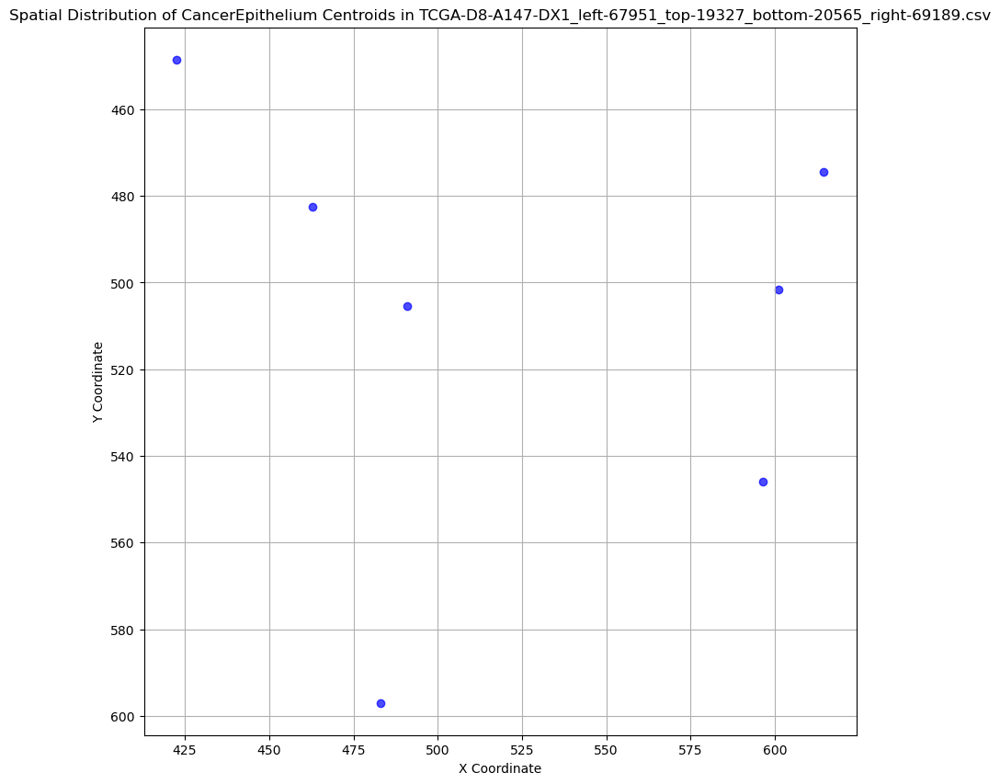

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-D8-A147-DX1_left-67951_top-19327_bottom-20565_right-69189.csv:
Number of CancerEpithelium regions: 7
Mean area: 1474.00
Standard deviation of area: 502.86
Coefficient of variation (heterogeneity): 0.34
No CancerEpithelium regions found in TCGA-A2-A0D0-DX1_left-68517_top-42674_bottom-43911_right-69753.csv.


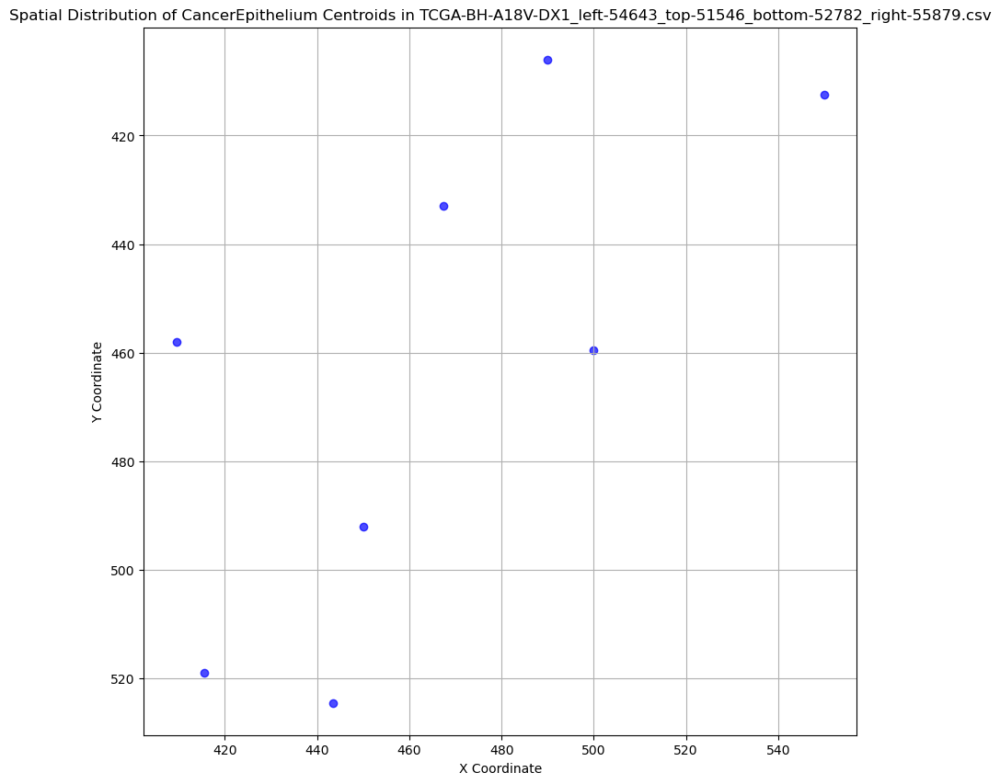

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-BH-A18V-DX1_left-54643_top-51546_bottom-52782_right-55879.csv:
Number of CancerEpithelium regions: 8
Mean area: 797.62
Standard deviation of area: 300.88
Coefficient of variation (heterogeneity): 0.38
No CancerEpithelium regions found in TCGA-E2-A573-DX1_left-60454_top-56663_bottom-57902_right-61693.csv.
No CancerEpithelium regions found in TCGA-AN-A0AT-DX1_left-33232_top-38339_bottom-39578_right-34471.csv.
No CancerEpithelium regions found in TCGA-A2-A0YE-DX1_left-61539_top-36348_bottom-37574_right-62765.csv.
No CancerEpithelium regions found in TCGA-E2-A158-DX1_left-58393_top-25885_bottom-27130_right-59638.csv.
No CancerEpithelium regions found in TCGA-D8-A142-DX1_left-69082_top-42133_bottom-43371_right-70321.csv.


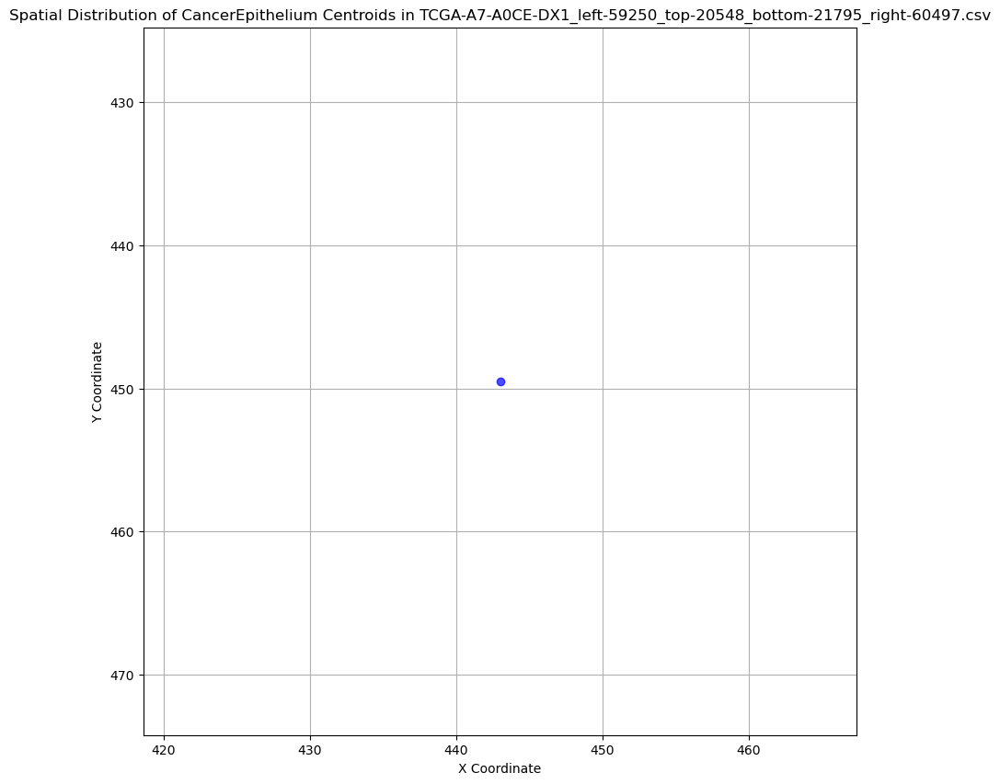

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A7-A0CE-DX1_left-59250_top-20548_bottom-21795_right-60497.csv:
Number of CancerEpithelium regions: 1
Mean area: 378.00
Standard deviation of area: nan
Coefficient of variation (heterogeneity): nan


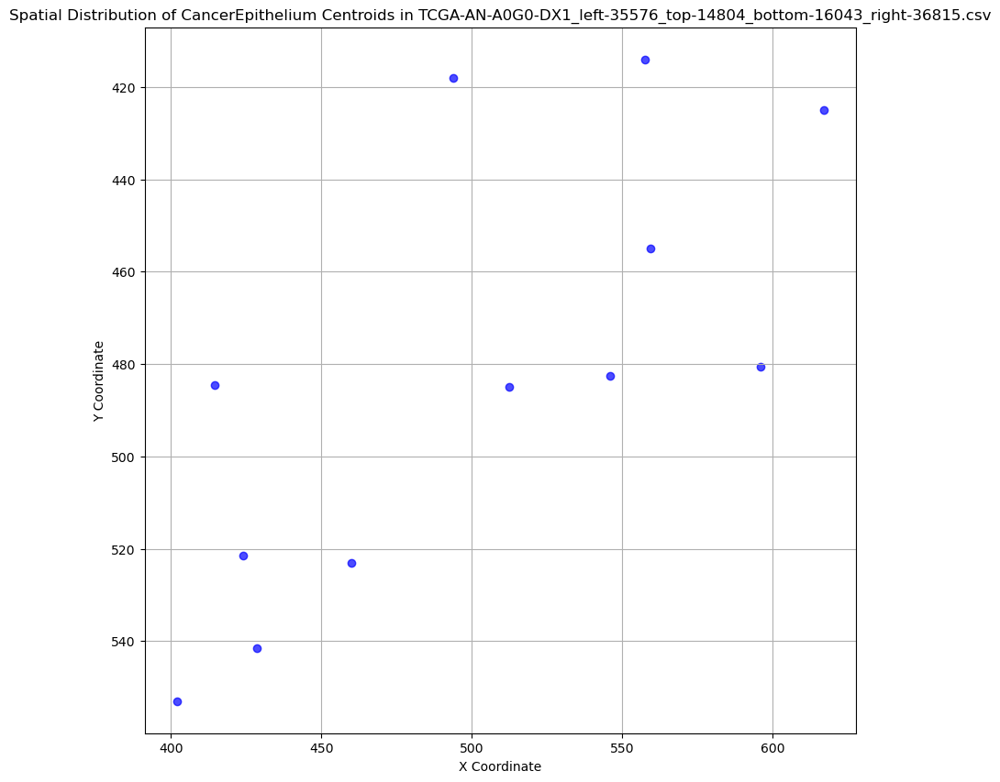

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-AN-A0G0-DX1_left-35576_top-14804_bottom-16043_right-36815.csv:
Number of CancerEpithelium regions: 12
Mean area: 1007.50
Standard deviation of area: 530.62
Coefficient of variation (heterogeneity): 0.53


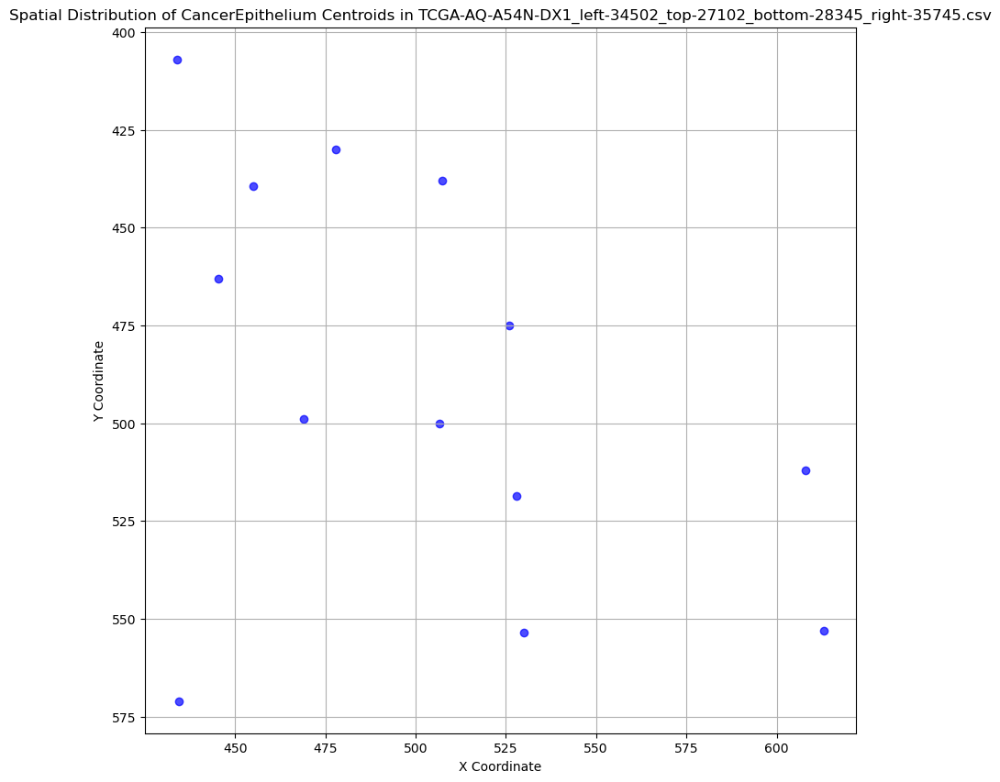

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-AQ-A54N-DX1_left-34502_top-27102_bottom-28345_right-35745.csv:
Number of CancerEpithelium regions: 13
Mean area: 1169.69
Standard deviation of area: 579.83
Coefficient of variation (heterogeneity): 0.50


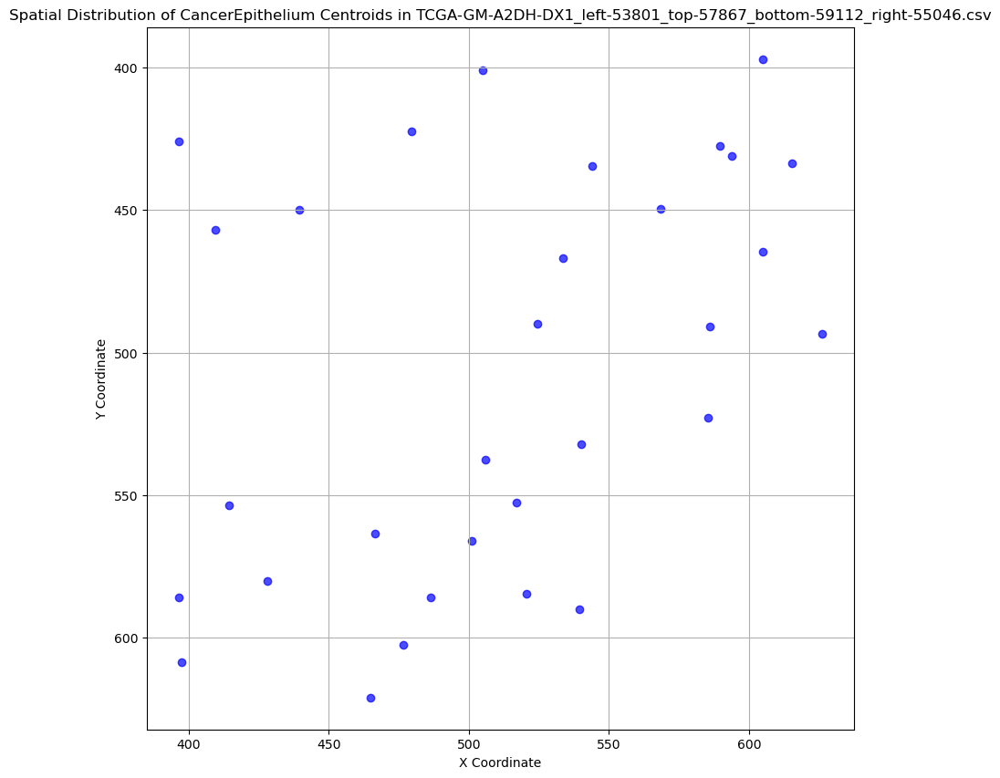

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-GM-A2DH-DX1_left-53801_top-57867_bottom-59112_right-55046.csv:
Number of CancerEpithelium regions: 31
Mean area: 816.16
Standard deviation of area: 409.99
Coefficient of variation (heterogeneity): 0.50


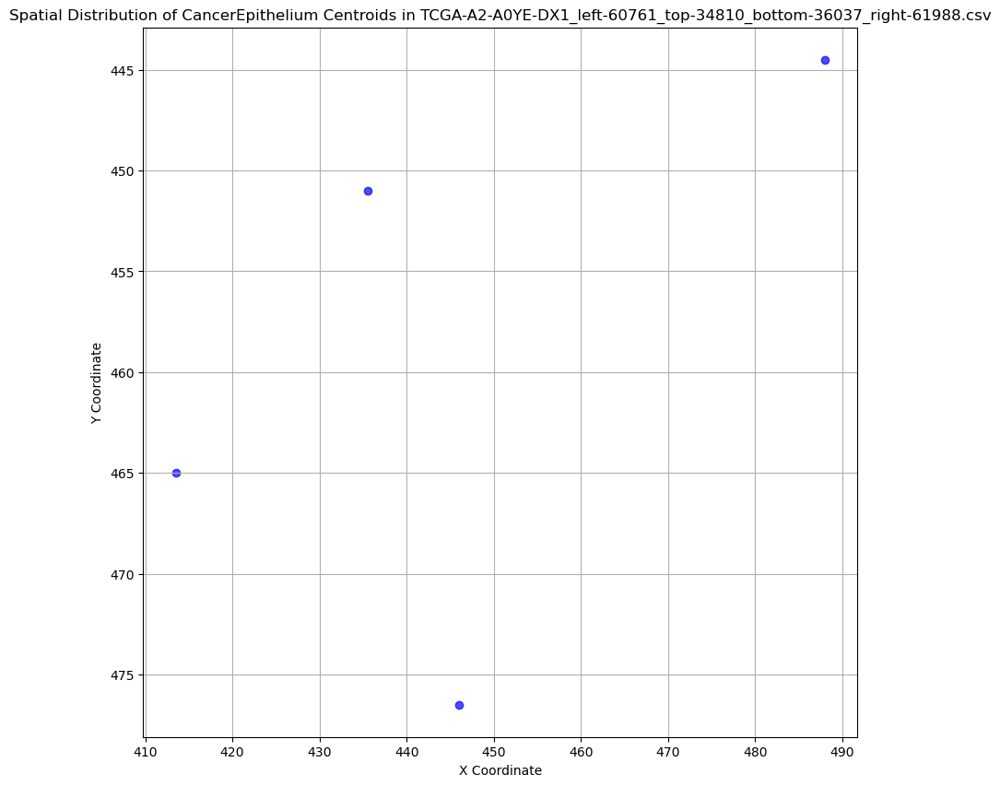

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A0YE-DX1_left-60761_top-34810_bottom-36037_right-61988.csv:
Number of CancerEpithelium regions: 4
Mean area: 856.50
Standard deviation of area: 316.32
Coefficient of variation (heterogeneity): 0.37


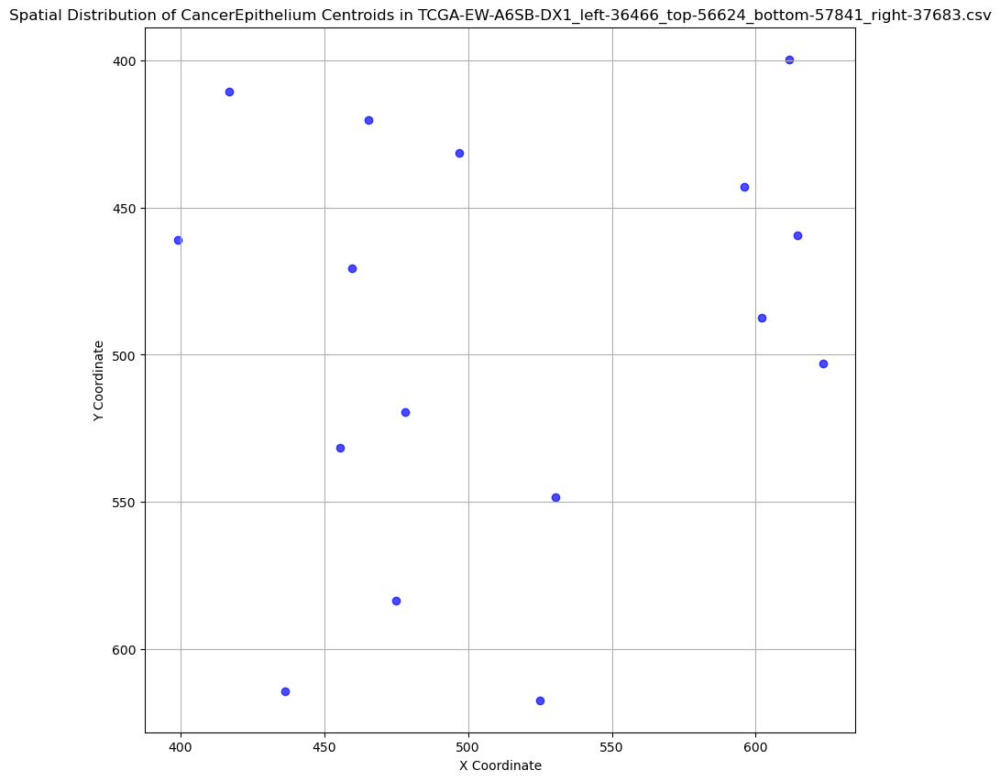

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-EW-A6SB-DX1_left-36466_top-56624_bottom-57841_right-37683.csv:
Number of CancerEpithelium regions: 16
Mean area: 1229.75
Standard deviation of area: 752.21
Coefficient of variation (heterogeneity): 0.61


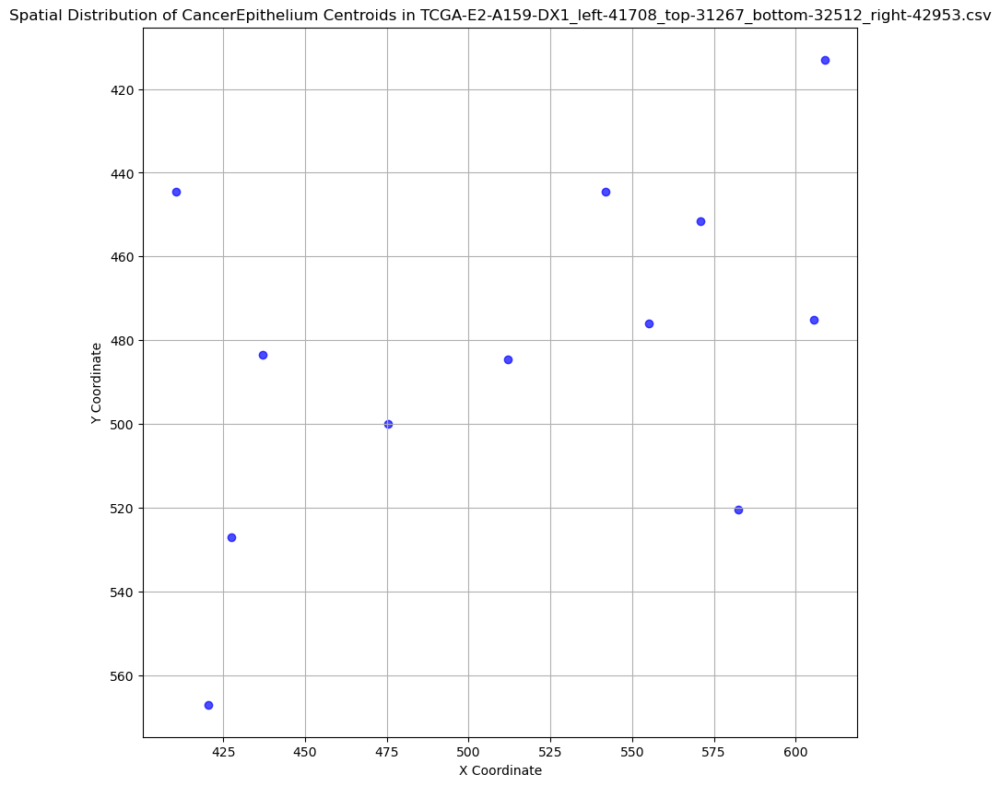

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-E2-A159-DX1_left-41708_top-31267_bottom-32512_right-42953.csv:
Number of CancerEpithelium regions: 12
Mean area: 889.33
Standard deviation of area: 379.43
Coefficient of variation (heterogeneity): 0.43


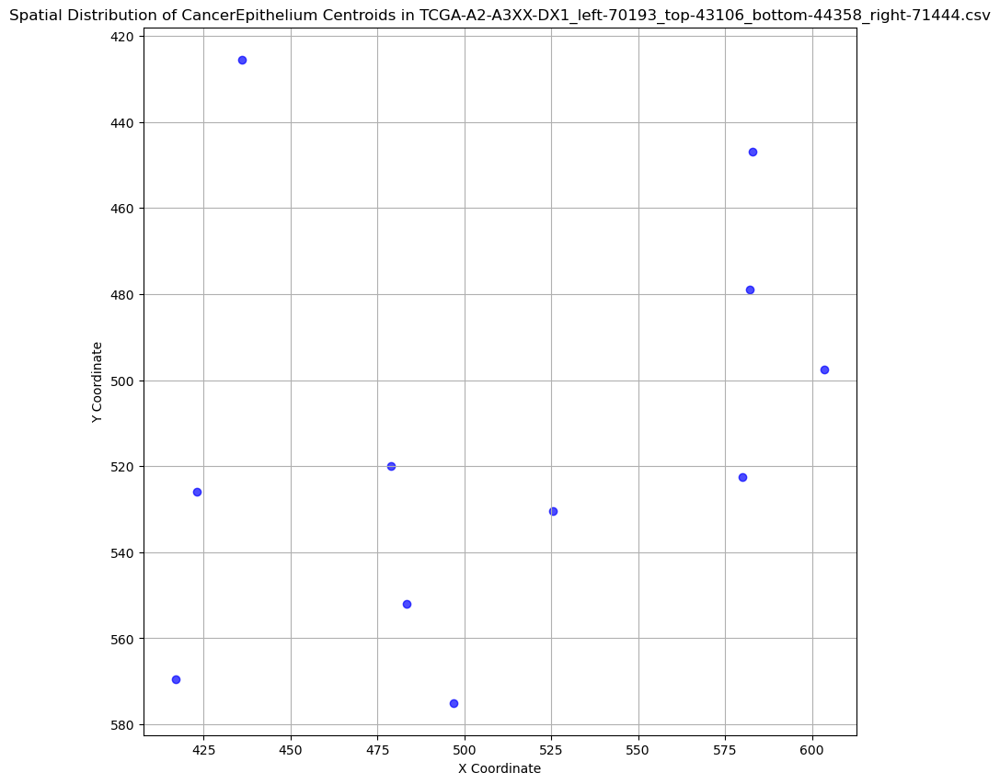

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A3XX-DX1_left-70193_top-43106_bottom-44358_right-71444.csv:
Number of CancerEpithelium regions: 11
Mean area: 962.36
Standard deviation of area: 467.16
Coefficient of variation (heterogeneity): 0.49


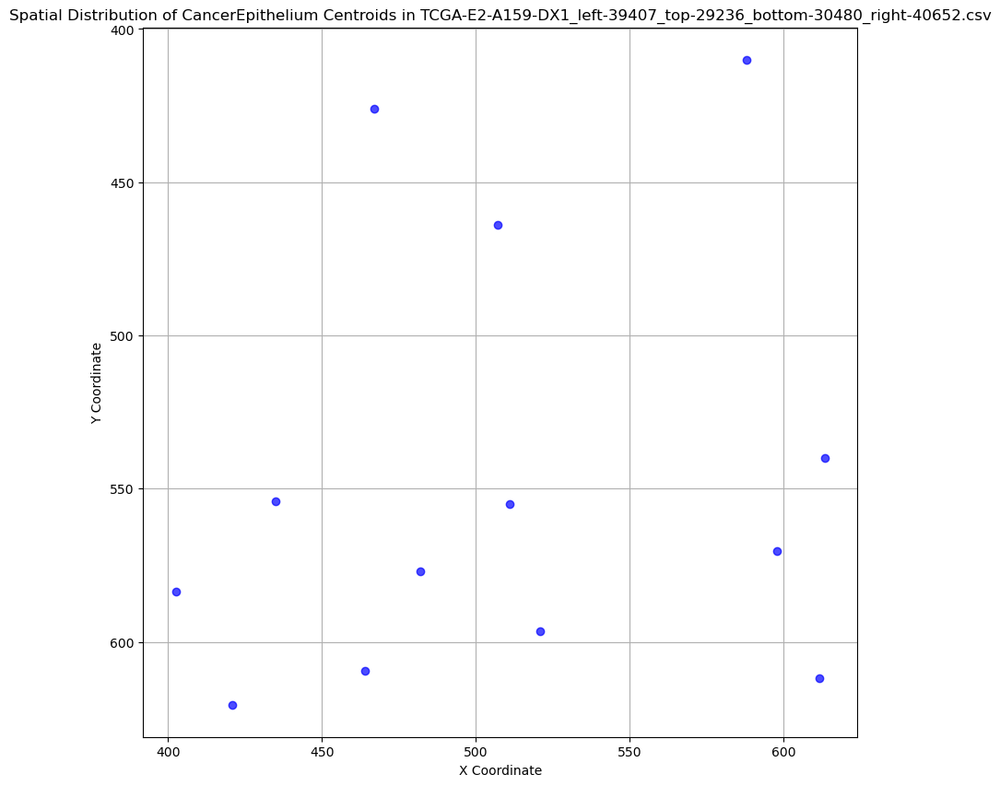

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-E2-A159-DX1_left-39407_top-29236_bottom-30480_right-40652.csv:
Number of CancerEpithelium regions: 13
Mean area: 998.23
Standard deviation of area: 334.43
Coefficient of variation (heterogeneity): 0.34


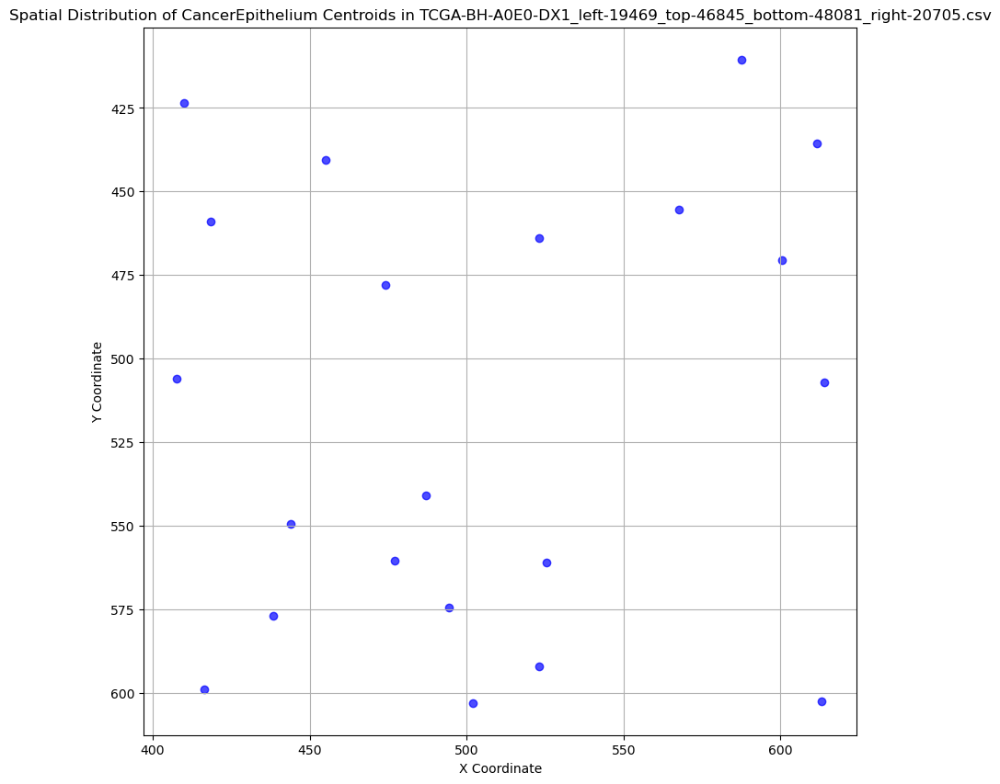

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-BH-A0E0-DX1_left-19469_top-46845_bottom-48081_right-20705.csv:
Number of CancerEpithelium regions: 21
Mean area: 767.86
Standard deviation of area: 374.94
Coefficient of variation (heterogeneity): 0.49
No CancerEpithelium regions found in TCGA-A7-A0CE-DX1_left-64366_top-21842_bottom-23089_right-65612.csv.


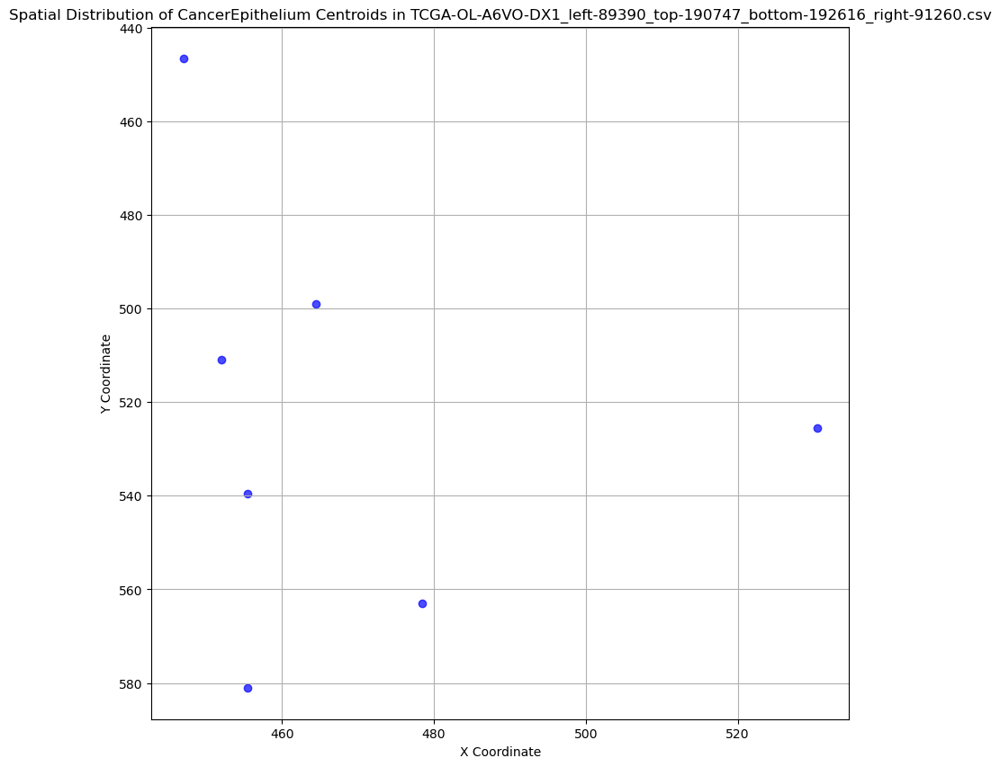

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


CancerEpithelium Spatial Analysis for TCGA-OL-A6VO-DX1_left-89390_top-190747_bottom-192616_right-91260.csv:
Number of CancerEpithelium regions: 7
Mean area: 938.57
Standard deviation of area: 362.72
Coefficient of variation (heterogeneity): 0.39


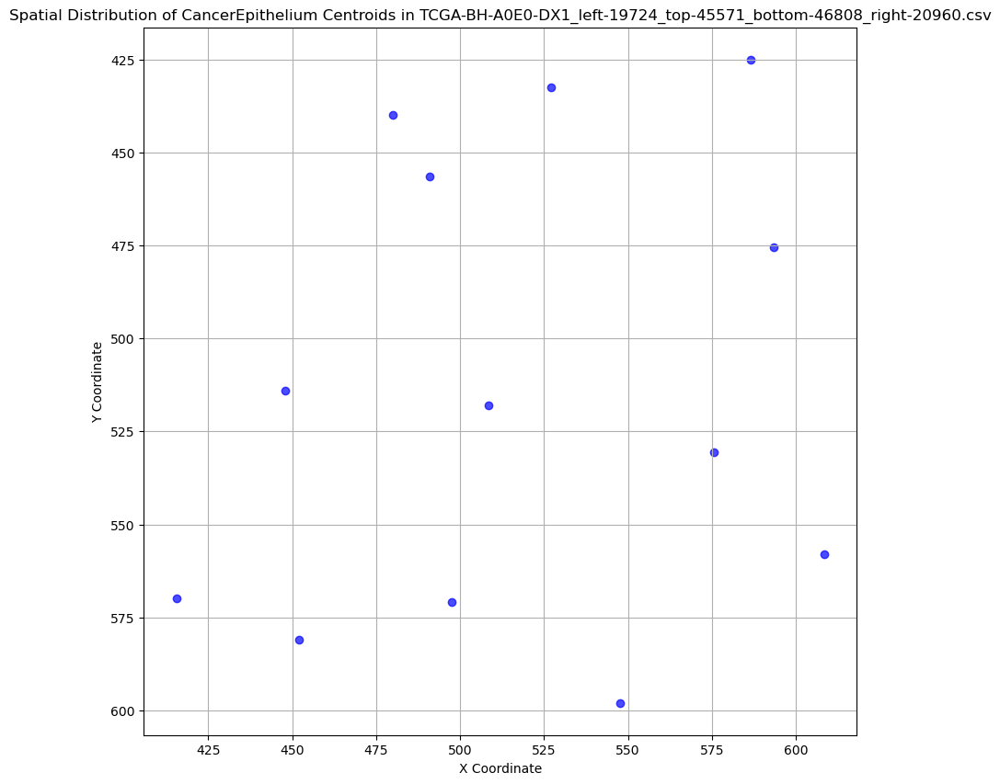

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-BH-A0E0-DX1_left-19724_top-45571_bottom-46808_right-20960.csv:
Number of CancerEpithelium regions: 13
Mean area: 1086.62
Standard deviation of area: 391.84
Coefficient of variation (heterogeneity): 0.36
No CancerEpithelium regions found in TCGA-A2-A0YE-DX1_left-62050_top-35829_bottom-37056_right-63277.csv.
No CancerEpithelium regions found in TCGA-GM-A2DH-DX1_left-54815_top-57857_bottom-59102_right-56060.csv.


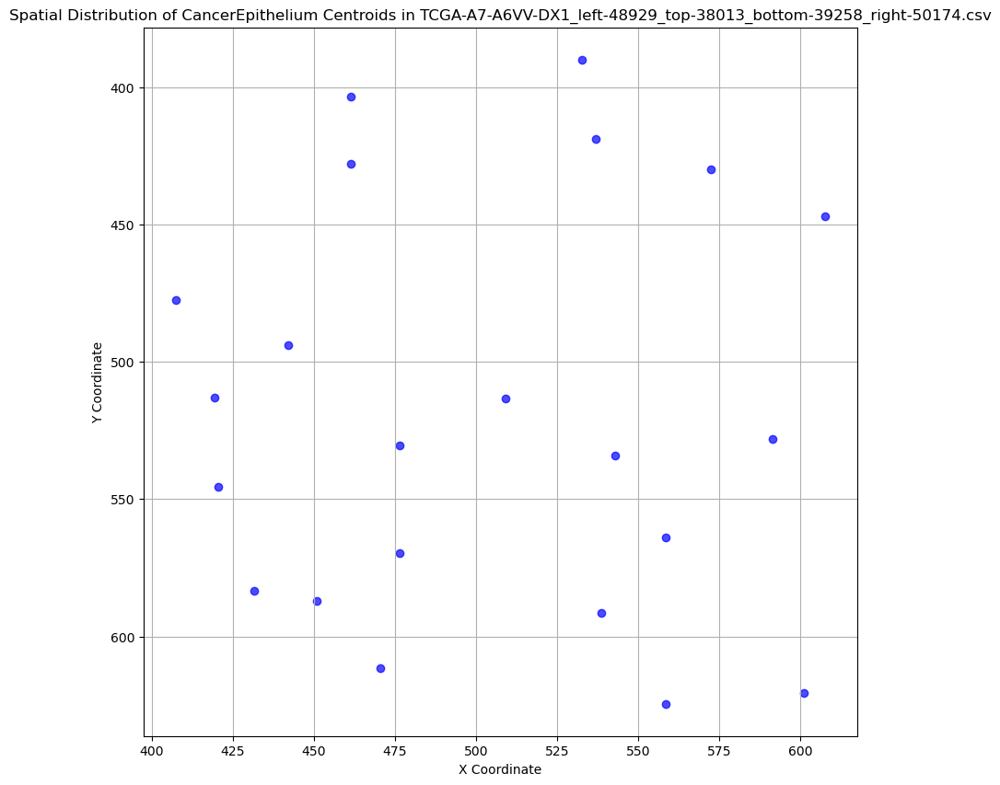

CancerEpithelium Spatial Analysis for TCGA-A7-A6VV-DX1_left-48929_top-38013_bottom-39258_right-50174.csv:
Number of CancerEpithelium regions: 22
Mean area: 1064.86
Standard deviation of area: 521.67
Coefficient of variation (heterogeneity): 0.49
No CancerEpithelium regions found in TCGA-AN-A0G0-DX1_left-35074_top-15869_bottom-17108_right-36313.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

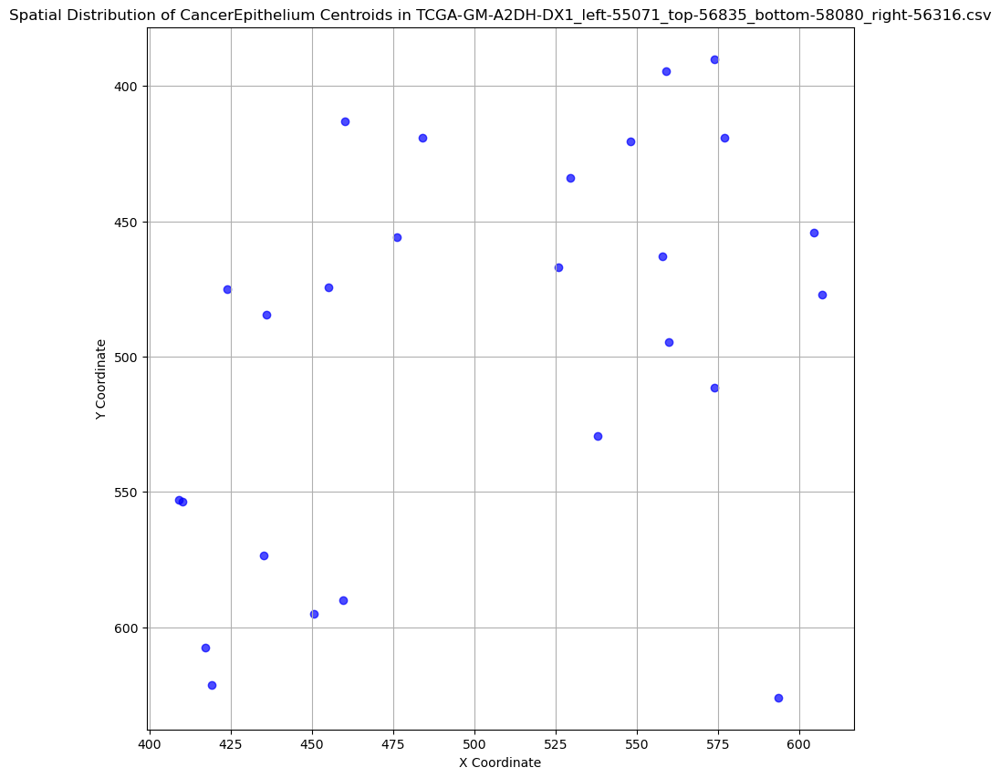

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-GM-A2DH-DX1_left-55071_top-56835_bottom-58080_right-56316.csv:
Number of CancerEpithelium regions: 26
Mean area: 870.62
Standard deviation of area: 325.00
Coefficient of variation (heterogeneity): 0.37
No CancerEpithelium regions found in TCGA-D8-A1JF-DX1_left-25652_top-55698_bottom-56936_right-26891.csv.


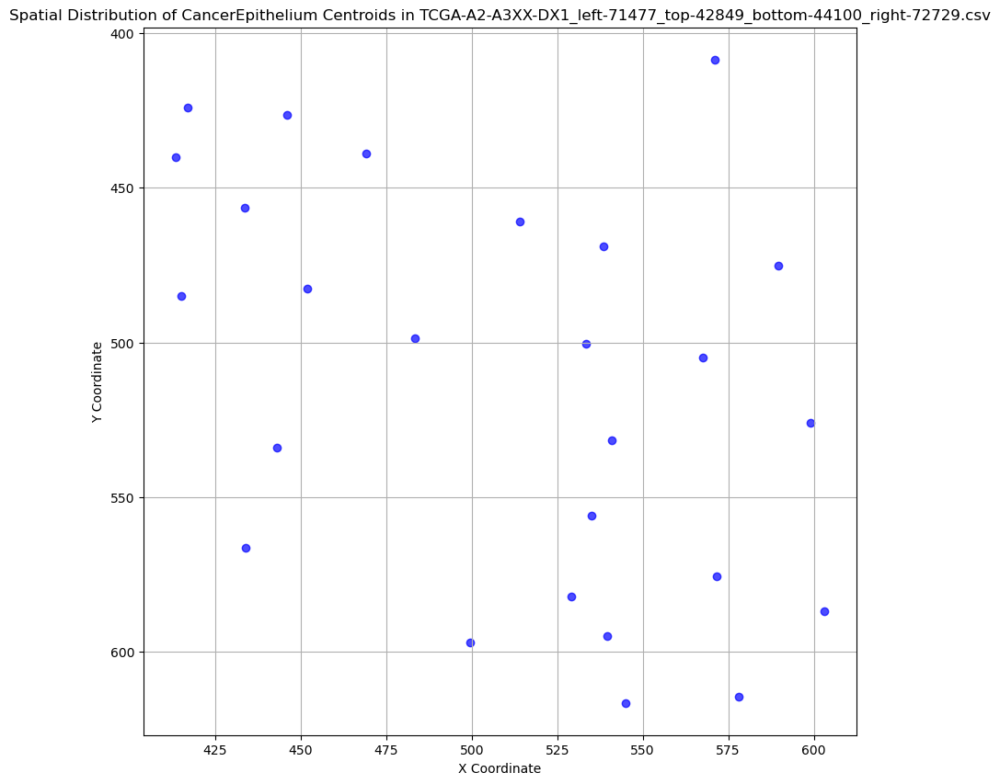

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A3XX-DX1_left-71477_top-42849_bottom-44100_right-72729.csv:
Number of CancerEpithelium regions: 26
Mean area: 824.62
Standard deviation of area: 309.08
Coefficient of variation (heterogeneity): 0.37


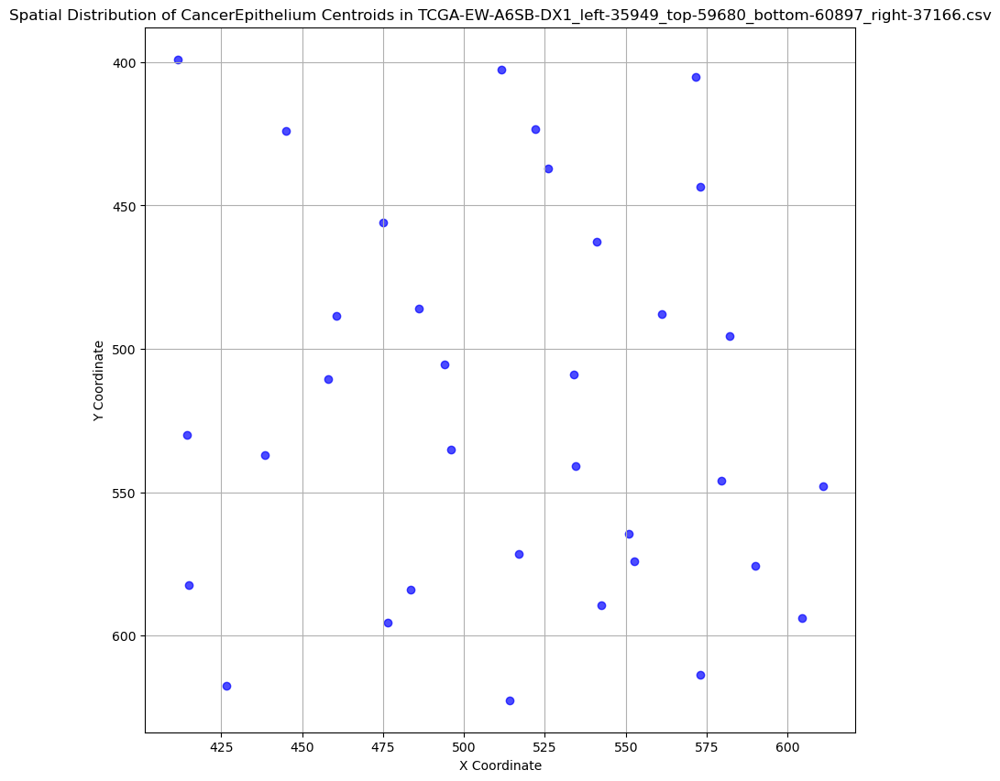

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-EW-A6SB-DX1_left-35949_top-59680_bottom-60897_right-37166.csv:
Number of CancerEpithelium regions: 34
Mean area: 712.09
Standard deviation of area: 511.88
Coefficient of variation (heterogeneity): 0.72
No CancerEpithelium regions found in TCGA-D8-A1JF-DX1_left-26164_top-55180_bottom-56419_right-27402.csv.


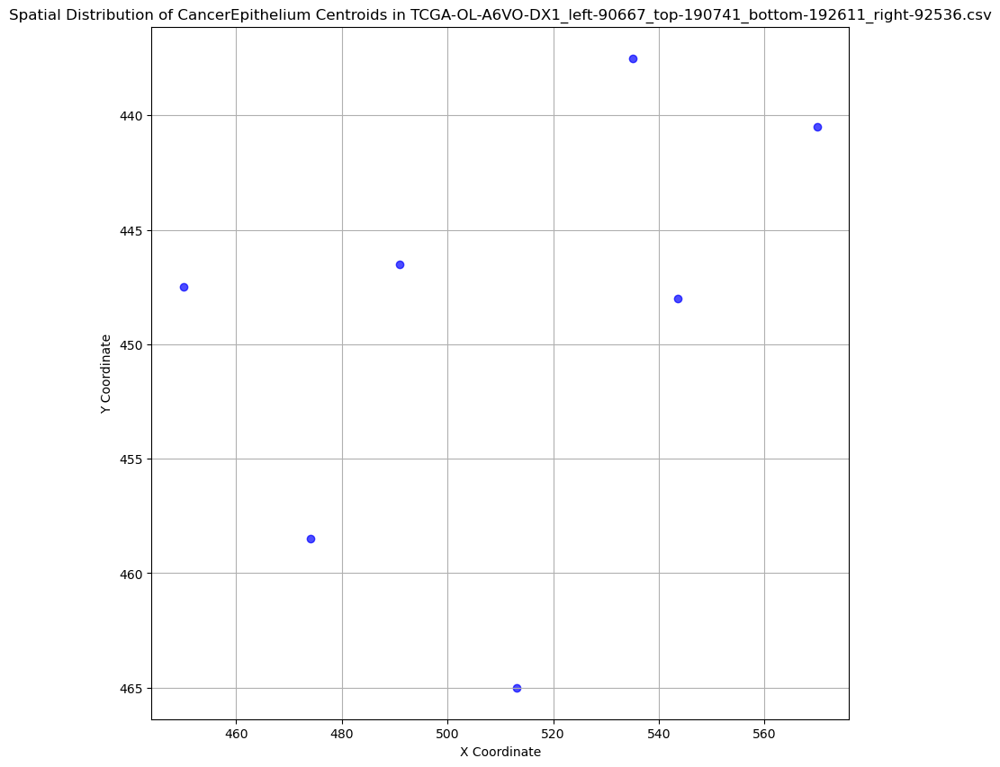

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-OL-A6VO-DX1_left-90667_top-190741_bottom-192611_right-92536.csv:
Number of CancerEpithelium regions: 7
Mean area: 754.57
Standard deviation of area: 384.88
Coefficient of variation (heterogeneity): 0.51


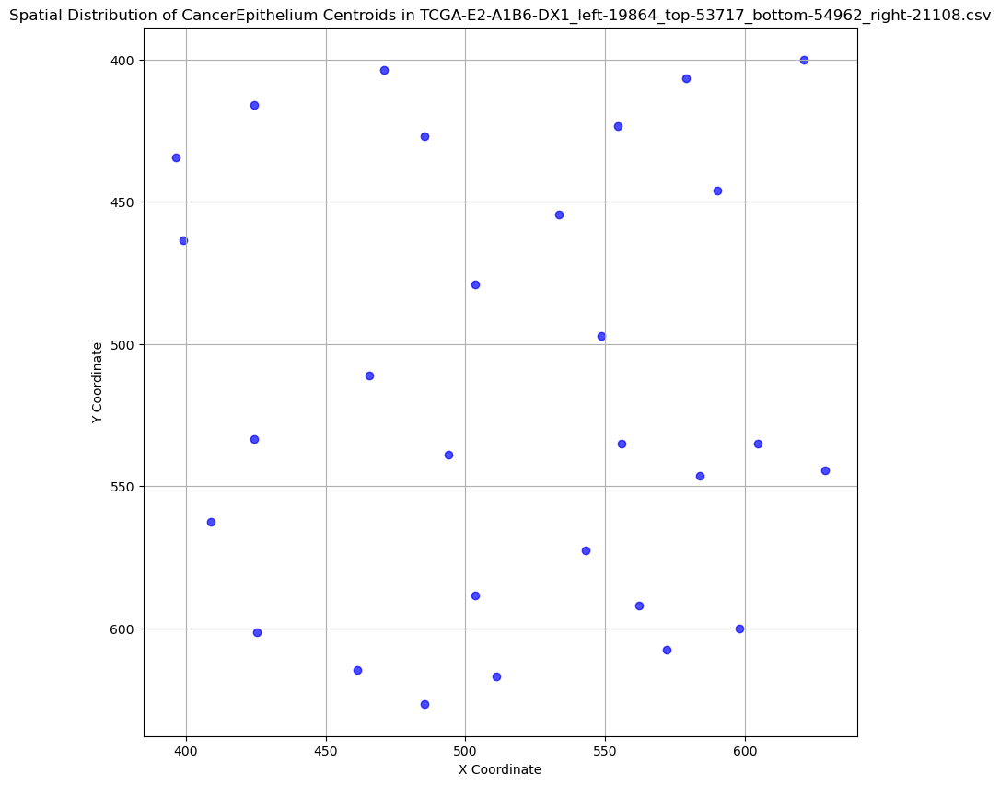

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-E2-A1B6-DX1_left-19864_top-53717_bottom-54962_right-21108.csv:
Number of CancerEpithelium regions: 29
Mean area: 623.69
Standard deviation of area: 159.66
Coefficient of variation (heterogeneity): 0.26
No CancerEpithelium regions found in TCGA-D8-A142-DX1_left-69848_top-44685_bottom-45924_right-71087.csv.
No CancerEpithelium regions found in TCGA-D8-A1JG-DX1_left-16465_top-72043_bottom-73282_right-17704.csv.


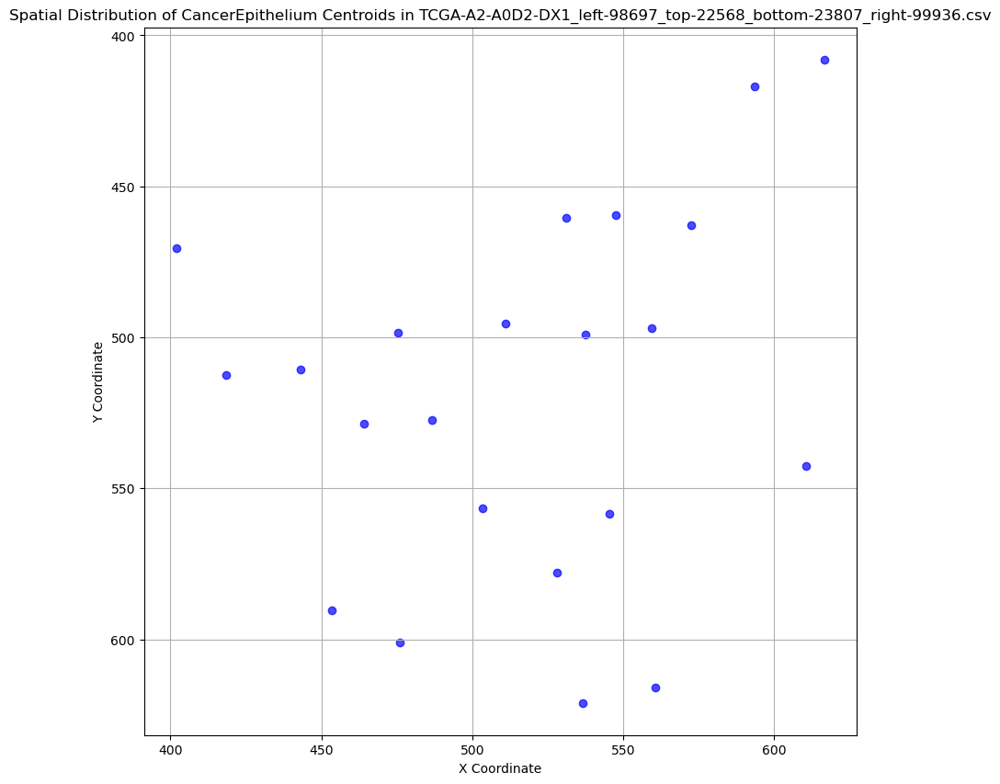

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


CancerEpithelium Spatial Analysis for TCGA-A2-A0D2-DX1_left-98697_top-22568_bottom-23807_right-99936.csv:
Number of CancerEpithelium regions: 22
Mean area: 912.18
Standard deviation of area: 378.78
Coefficient of variation (heterogeneity): 0.42


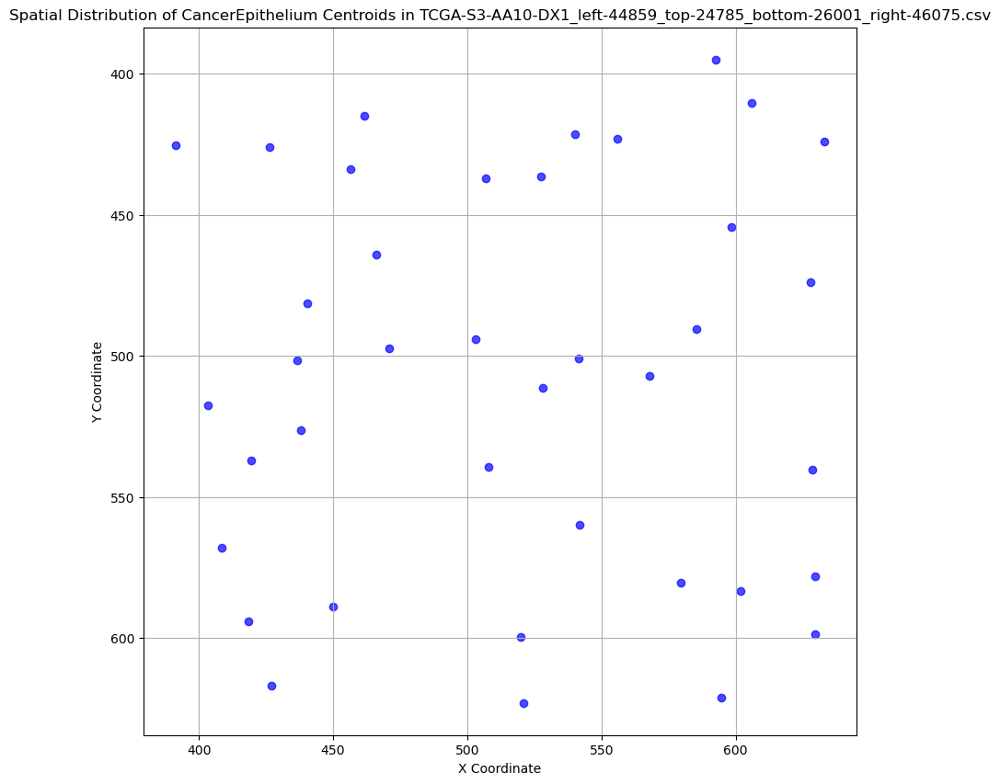

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-S3-AA10-DX1_left-44859_top-24785_bottom-26001_right-46075.csv:
Number of CancerEpithelium regions: 39
Mean area: 692.97
Standard deviation of area: 358.57
Coefficient of variation (heterogeneity): 0.52


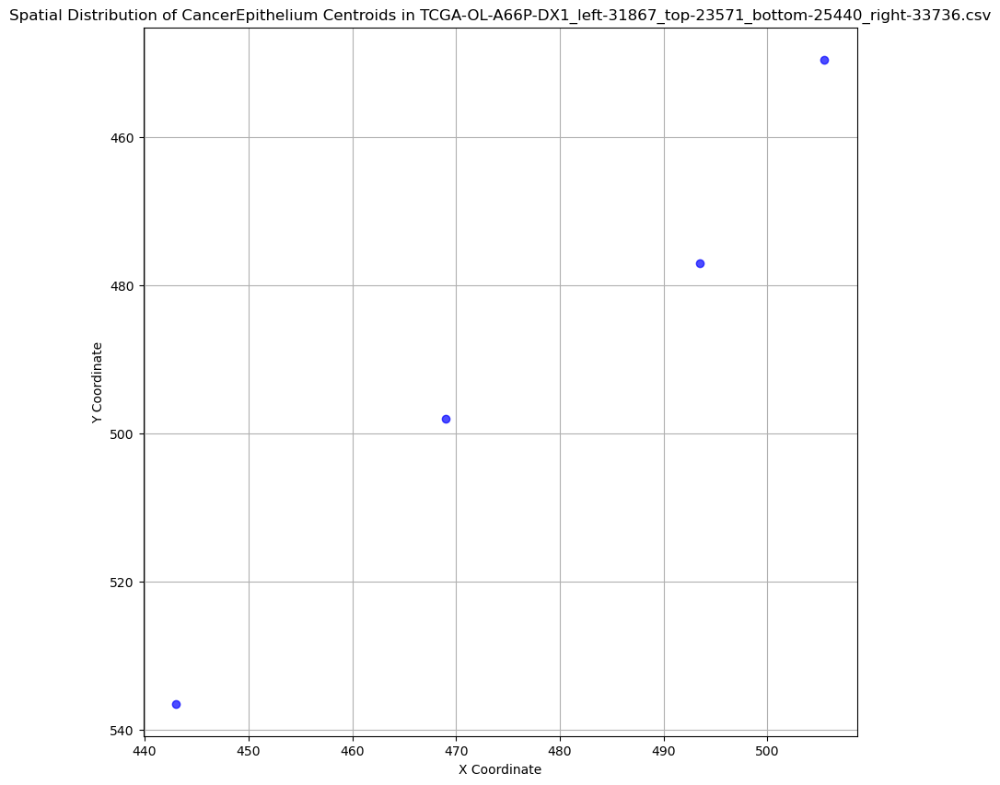

CancerEpithelium Spatial Analysis for TCGA-OL-A66P-DX1_left-31867_top-23571_bottom-25440_right-33736.csv:
Number of CancerEpithelium regions: 4
Mean area: 1047.75
Standard deviation of area: 609.27
Coefficient of variation (heterogeneity): 0.58


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

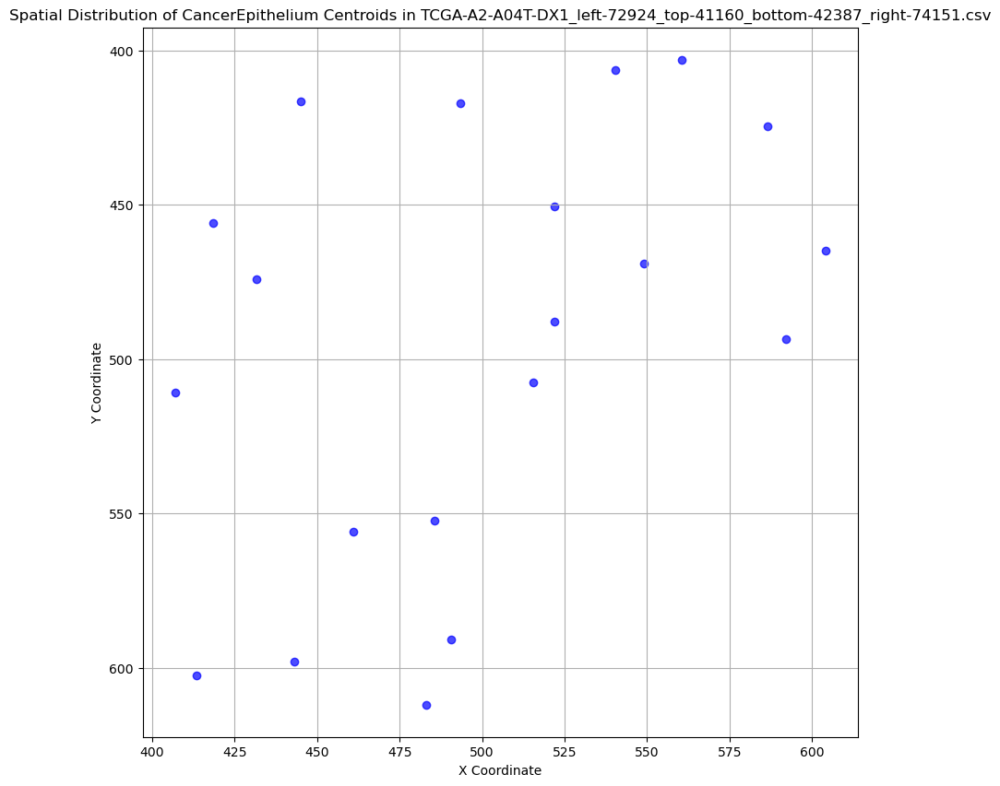

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


CancerEpithelium Spatial Analysis for TCGA-A2-A04T-DX1_left-72924_top-41160_bottom-42387_right-74151.csv:
Number of CancerEpithelium regions: 20
Mean area: 797.95
Standard deviation of area: 386.83
Coefficient of variation (heterogeneity): 0.48


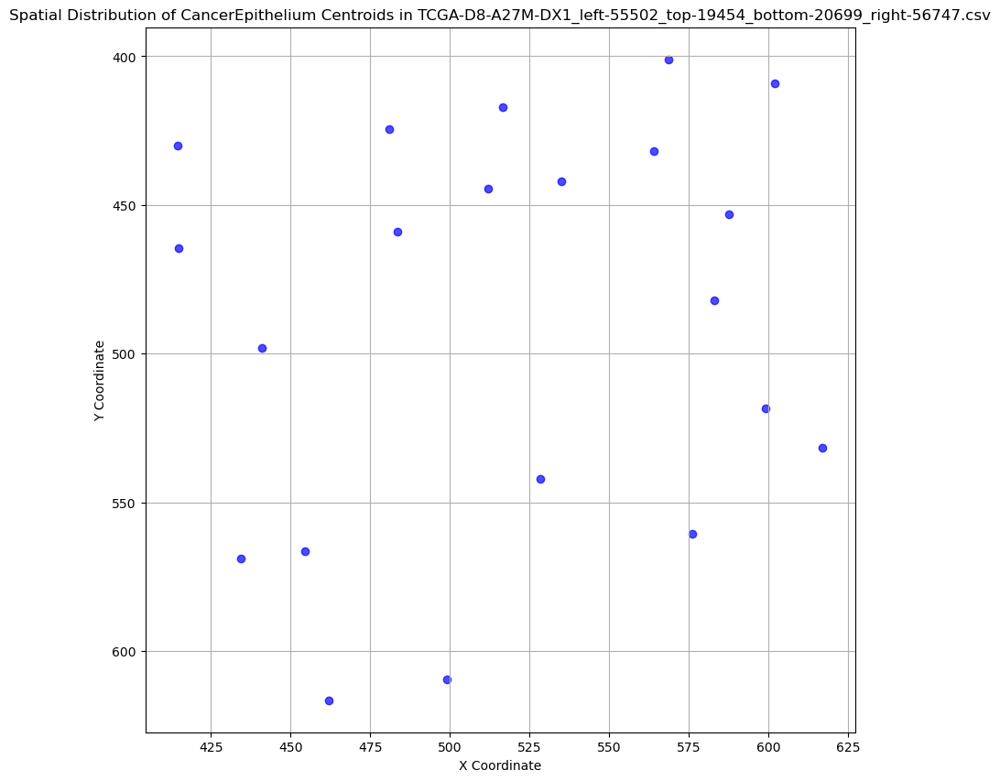

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-D8-A27M-DX1_left-55502_top-19454_bottom-20699_right-56747.csv:
Number of CancerEpithelium regions: 21
Mean area: 670.05
Standard deviation of area: 335.10
Coefficient of variation (heterogeneity): 0.50


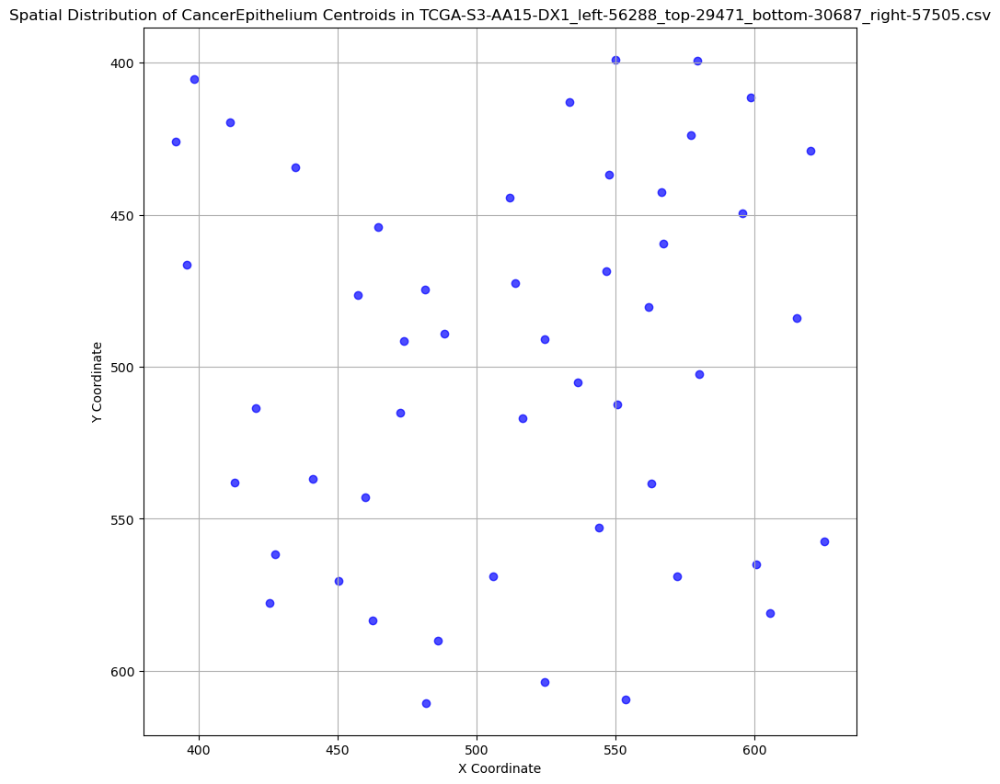

CancerEpithelium Spatial Analysis for TCGA-S3-AA15-DX1_left-56288_top-29471_bottom-30687_right-57505.csv:
Number of CancerEpithelium regions: 50
Mean area: 389.50
Standard deviation of area: 158.20
Coefficient of variation (heterogeneity): 0.41
No CancerEpithelium regions found in TCGA-E2-A573-DX1_left-60197_top-56418_bottom-57657_right-61436.csv.
No CancerEpithelium regions found in TCGA-OL-A66P-DX1_left-36250_top-23089_bottom-24958_right-38119.csv.
No CancerEpithelium regions found in TCGA-D8-A1JF-DX1_left-25660_top-55436_bottom-56675_right-26899.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


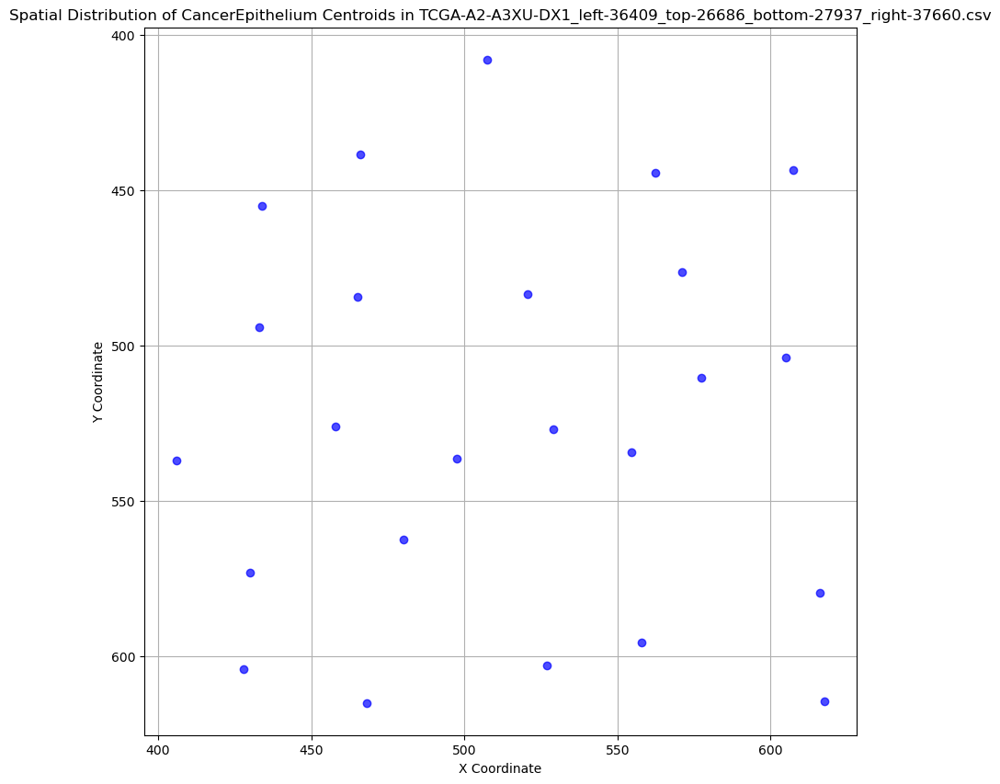

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-A2-A3XU-DX1_left-36409_top-26686_bottom-27937_right-37660.csv:
Number of CancerEpithelium regions: 24
Mean area: 841.12
Standard deviation of area: 217.25
Coefficient of variation (heterogeneity): 0.26


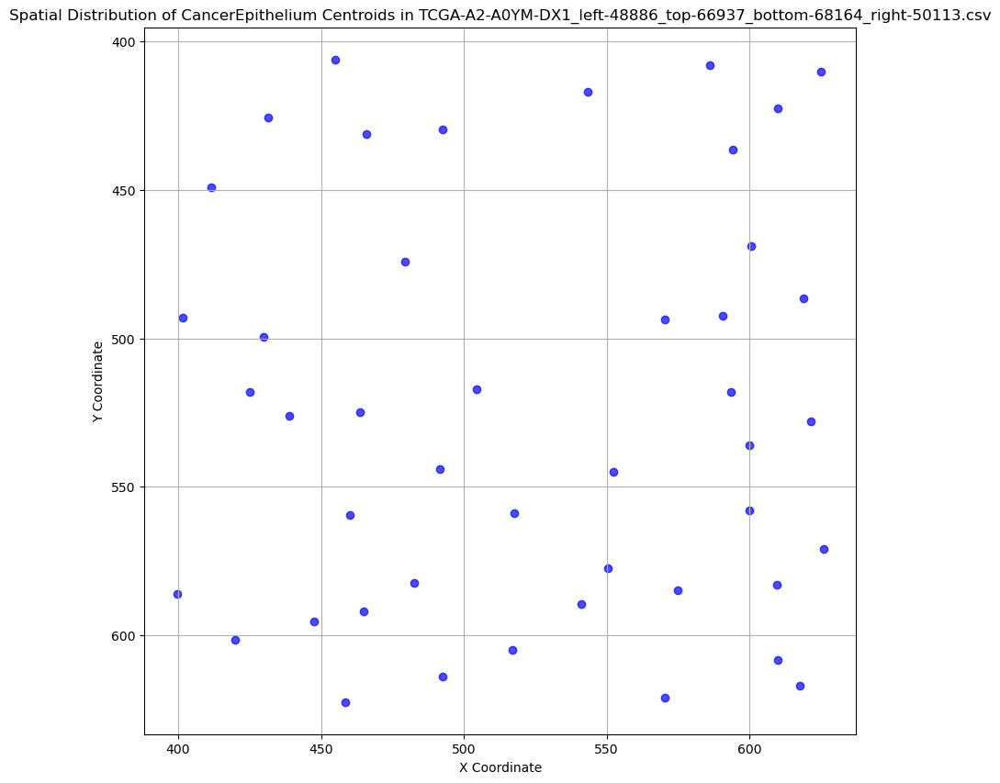

CancerEpithelium Spatial Analysis for TCGA-A2-A0YM-DX1_left-48886_top-66937_bottom-68164_right-50113.csv:
Number of CancerEpithelium regions: 45
Mean area: 717.51
Standard deviation of area: 382.12
Coefficient of variation (heterogeneity): 0.53
No CancerEpithelium regions found in TCGA-GM-A2DH-DX1_left-52771_top-58878_bottom-60123_right-54016.csv.


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

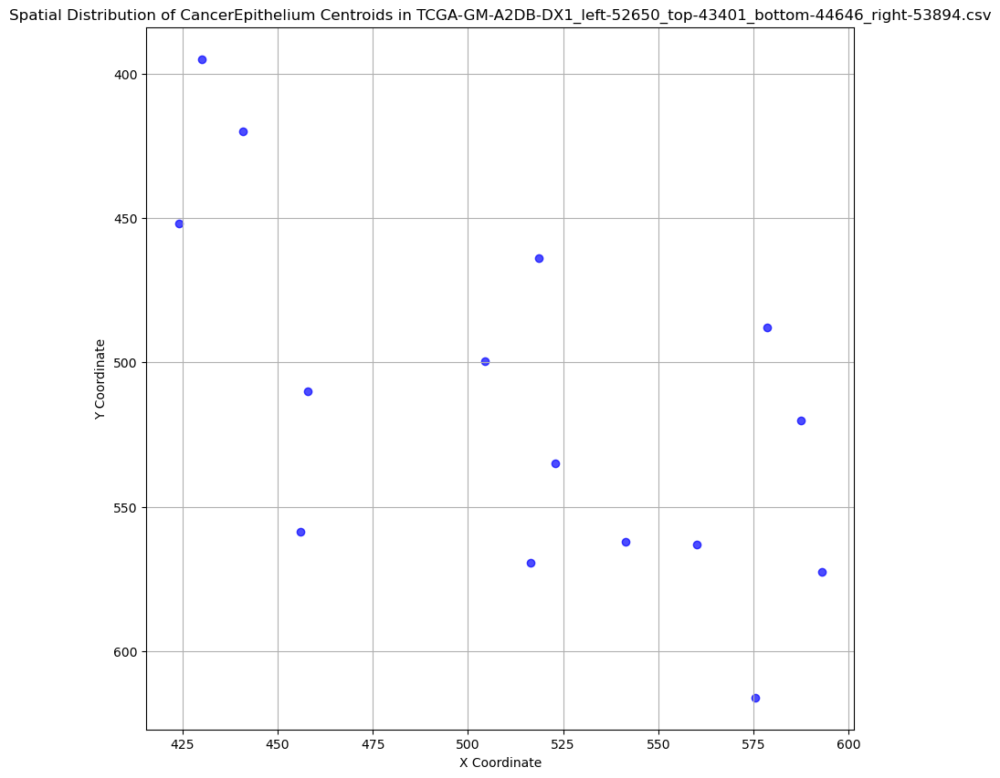

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-GM-A2DB-DX1_left-52650_top-43401_bottom-44646_right-53894.csv:
Number of CancerEpithelium regions: 15
Mean area: 1262.80
Standard deviation of area: 530.22
Coefficient of variation (heterogeneity): 0.42
No CancerEpithelium regions found in TCGA-EW-A1P1-DX1_left-52381_top-39009_bottom-40245_right-53617.csv.


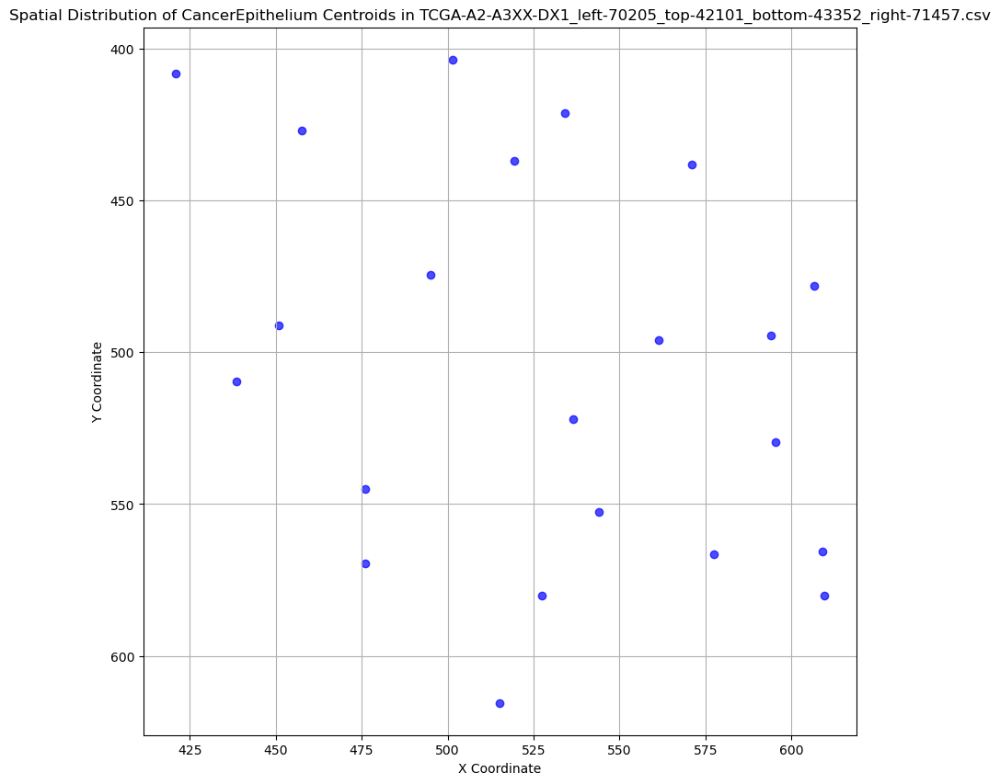

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A3XX-DX1_left-70205_top-42101_bottom-43352_right-71457.csv:
Number of CancerEpithelium regions: 22
Mean area: 1042.00
Standard deviation of area: 677.81
Coefficient of variation (heterogeneity): 0.65


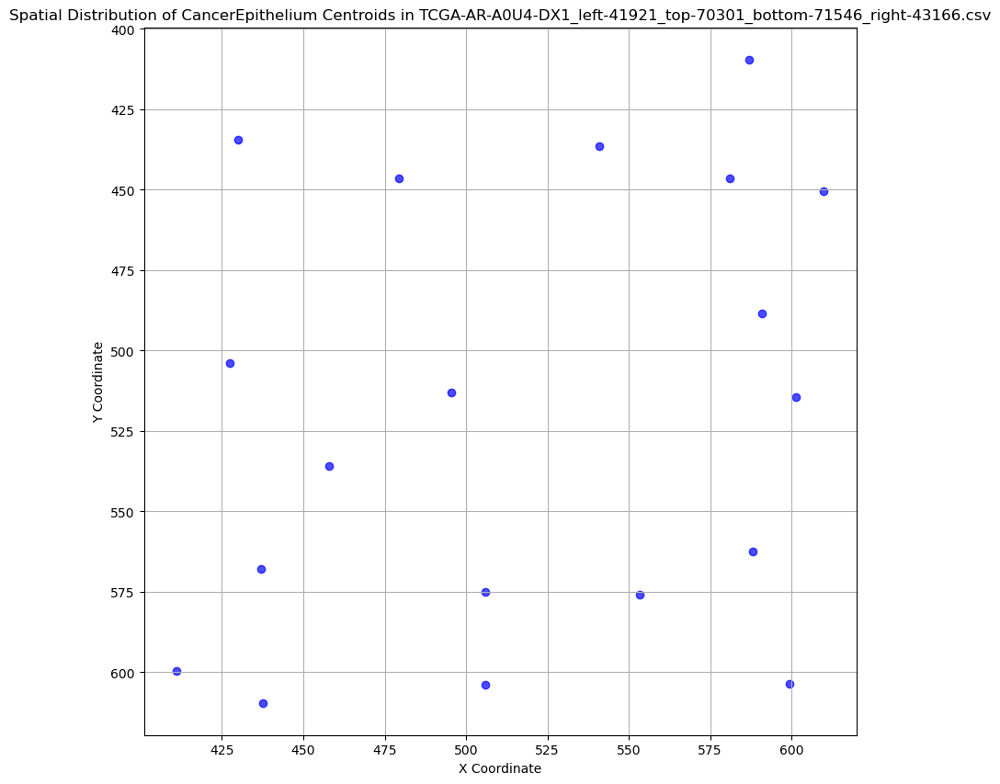

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-AR-A0U4-DX1_left-41921_top-70301_bottom-71546_right-43166.csv:
Number of CancerEpithelium regions: 19
Mean area: 1134.74
Standard deviation of area: 540.03
Coefficient of variation (heterogeneity): 0.48


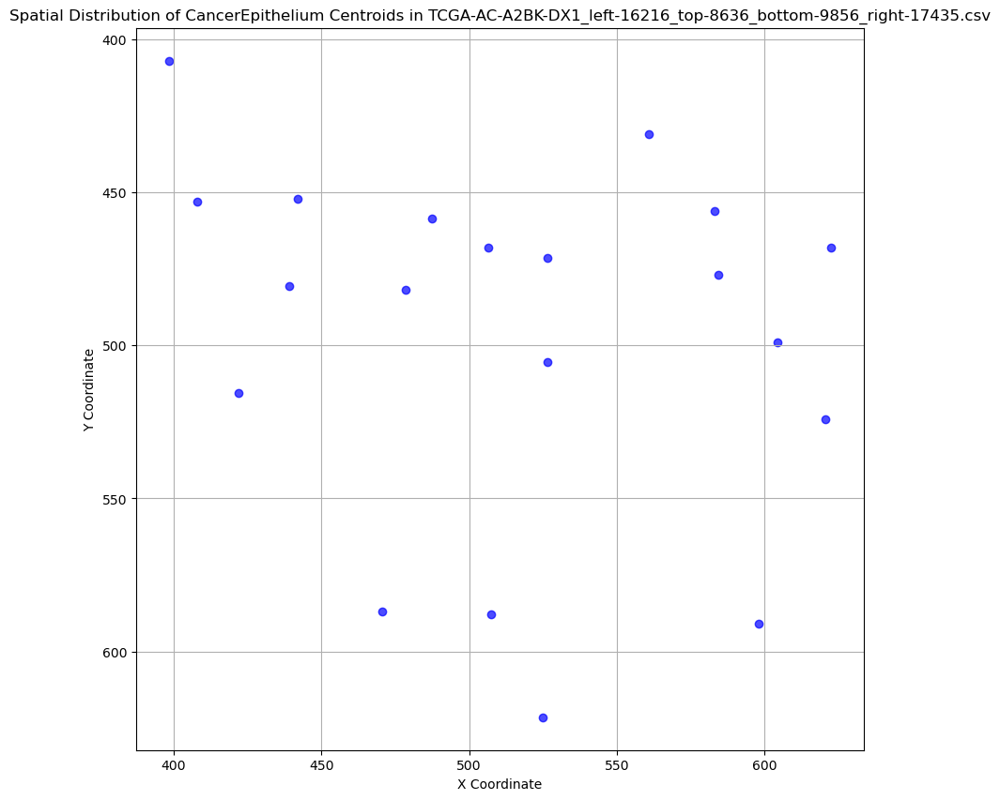

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-AC-A2BK-DX1_left-16216_top-8636_bottom-9856_right-17435.csv:
Number of CancerEpithelium regions: 20
Mean area: 846.75
Standard deviation of area: 373.24
Coefficient of variation (heterogeneity): 0.44


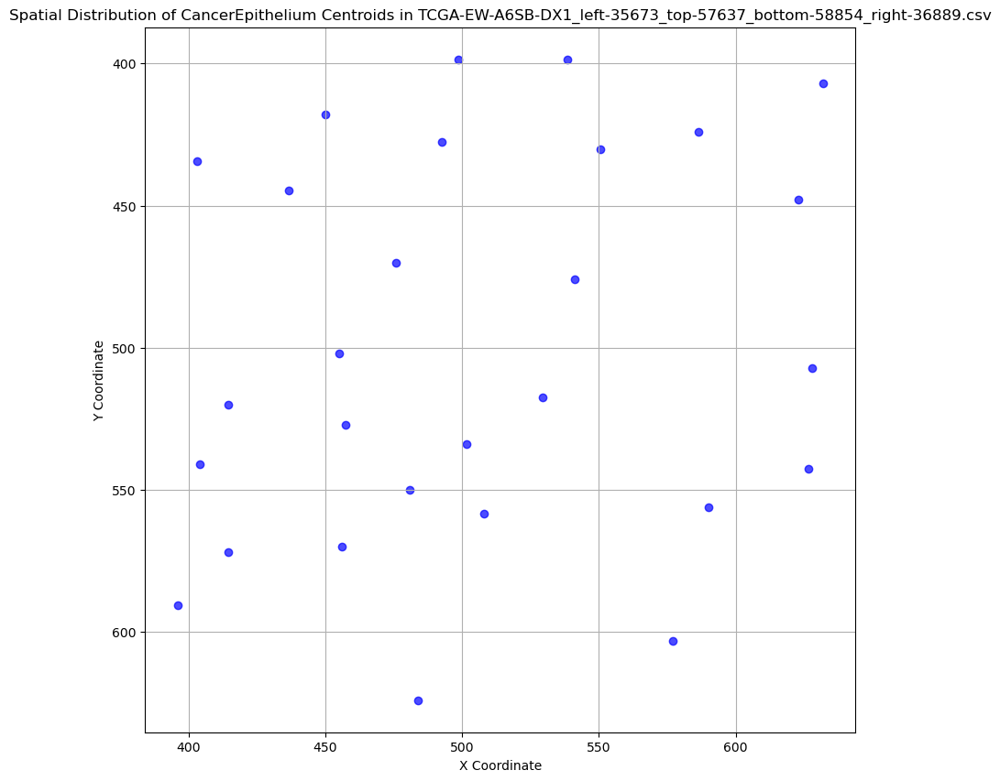

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


CancerEpithelium Spatial Analysis for TCGA-EW-A6SB-DX1_left-35673_top-57637_bottom-58854_right-36889.csv:
Number of CancerEpithelium regions: 28
Mean area: 987.64
Standard deviation of area: 638.99
Coefficient of variation (heterogeneity): 0.65


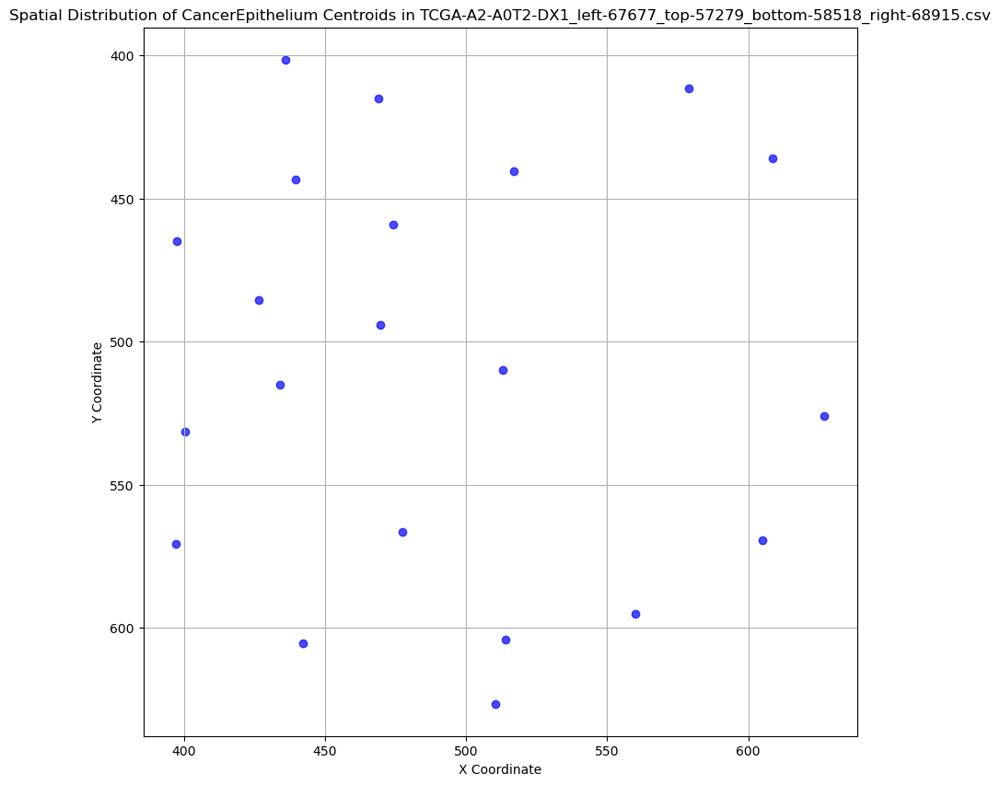

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-A2-A0T2-DX1_left-67677_top-57279_bottom-58518_right-68915.csv:
Number of CancerEpithelium regions: 21
Mean area: 1182.33
Standard deviation of area: 531.06
Coefficient of variation (heterogeneity): 0.45
No CancerEpithelium regions found in TCGA-A2-A3XS-DX1_left-23731_top-38255_bottom-39506_right-24981.csv.


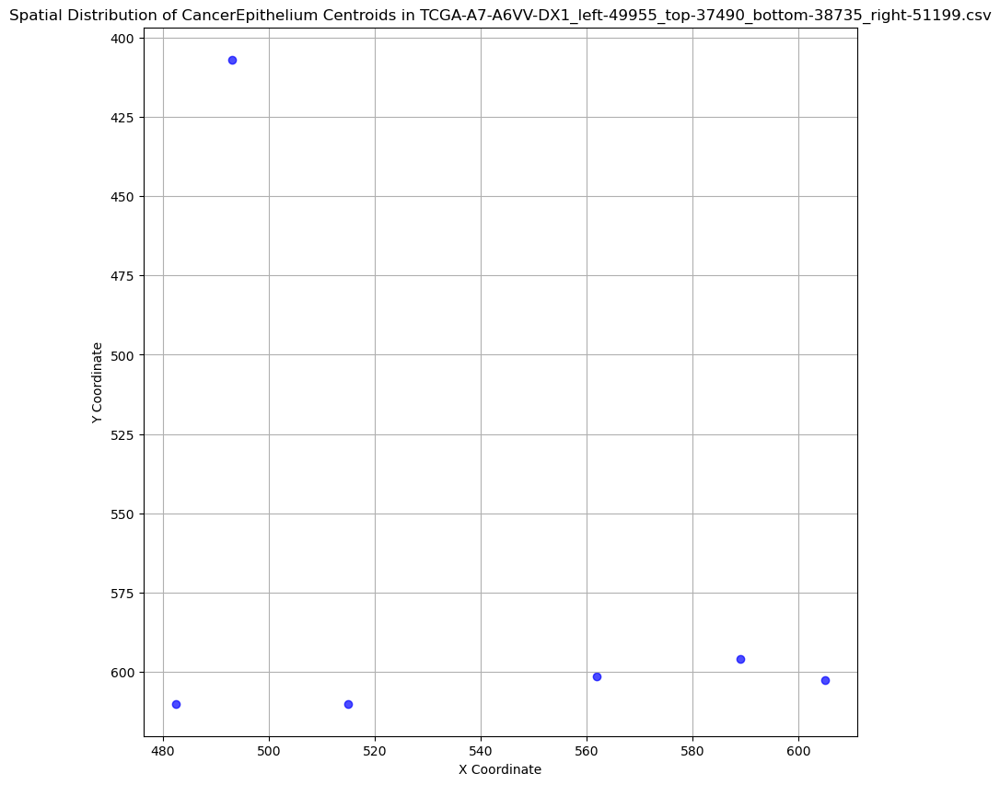

CancerEpithelium Spatial Analysis for TCGA-A7-A6VV-DX1_left-49955_top-37490_bottom-38735_right-51199.csv:
Number of CancerEpithelium regions: 6
Mean area: 1145.67
Standard deviation of area: 637.71
Coefficient of variation (heterogeneity): 0.56


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

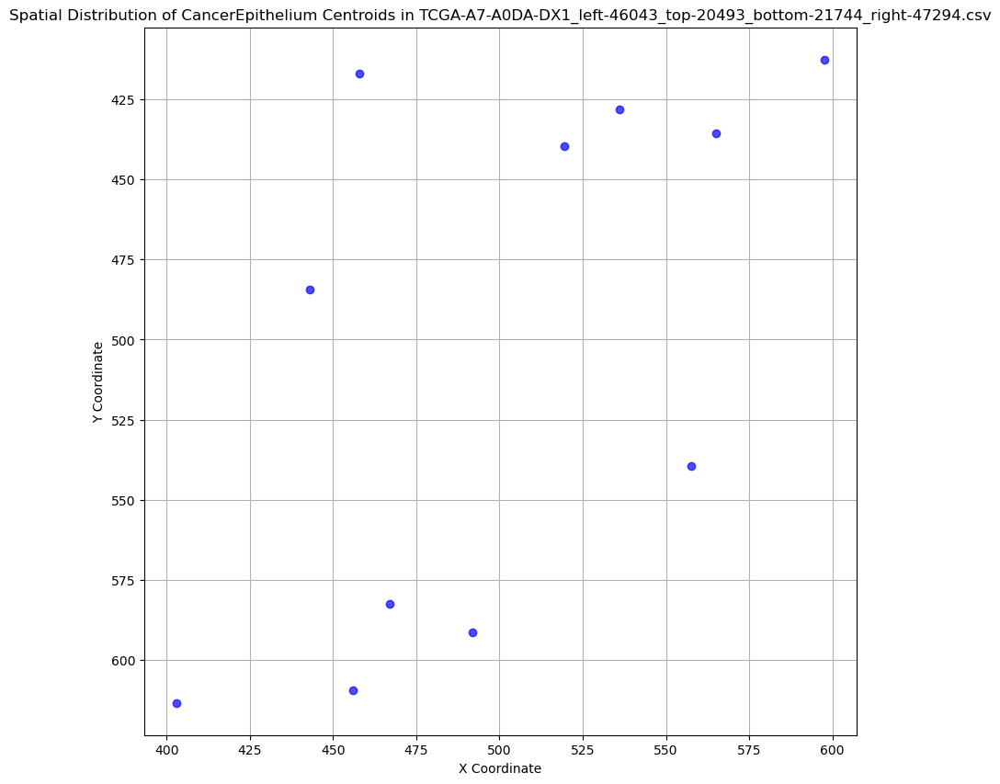

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A7-A0DA-DX1_left-46043_top-20493_bottom-21744_right-47294.csv:
Number of CancerEpithelium regions: 11
Mean area: 909.36
Standard deviation of area: 511.14
Coefficient of variation (heterogeneity): 0.56


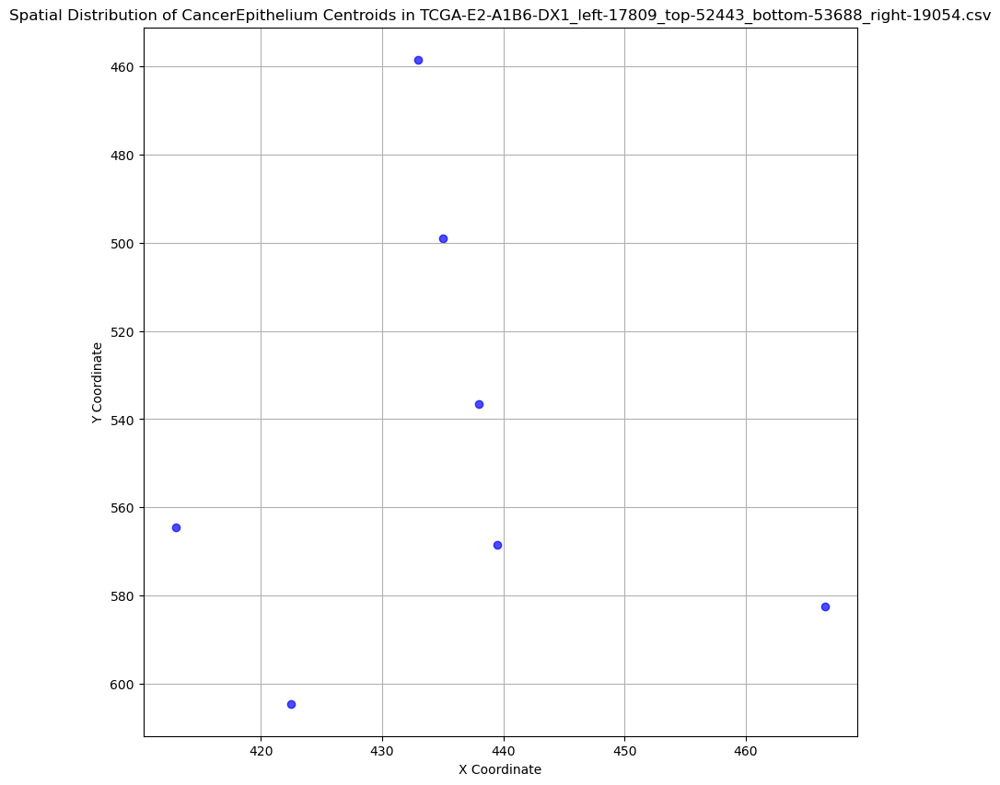

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-E2-A1B6-DX1_left-17809_top-52443_bottom-53688_right-19054.csv:
Number of CancerEpithelium regions: 7
Mean area: 957.29
Standard deviation of area: 306.48
Coefficient of variation (heterogeneity): 0.32


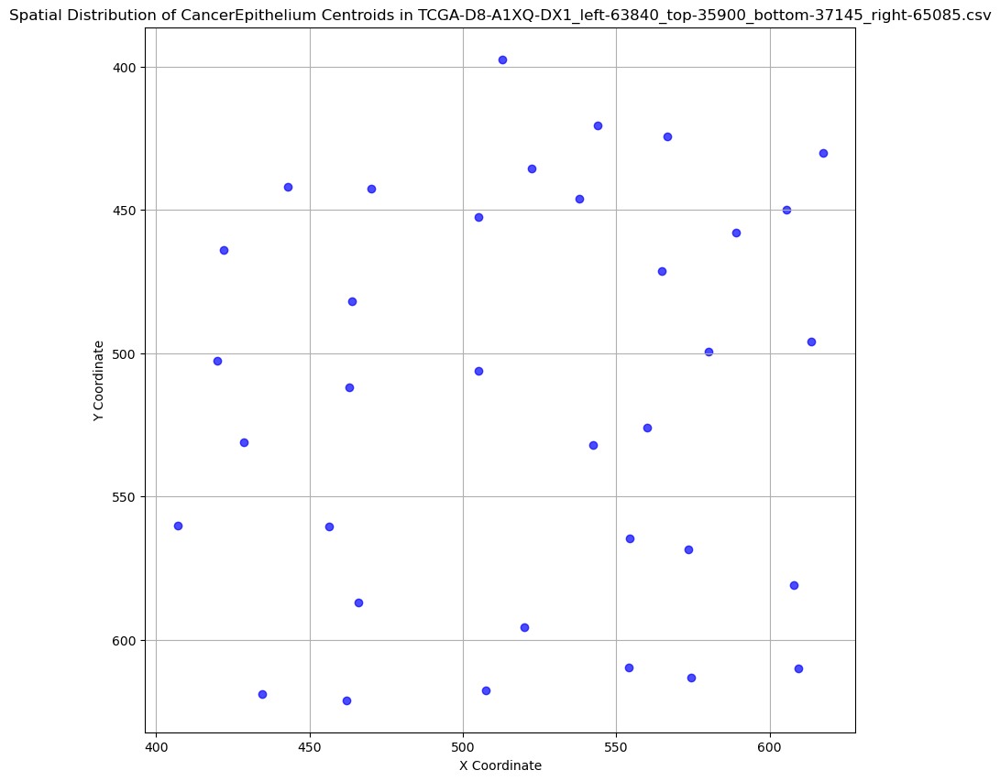

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])


CancerEpithelium Spatial Analysis for TCGA-D8-A1XQ-DX1_left-63840_top-35900_bottom-37145_right-65085.csv:
Number of CancerEpithelium regions: 35
Mean area: 774.23
Standard deviation of area: 349.10
Coefficient of variation (heterogeneity): 0.45


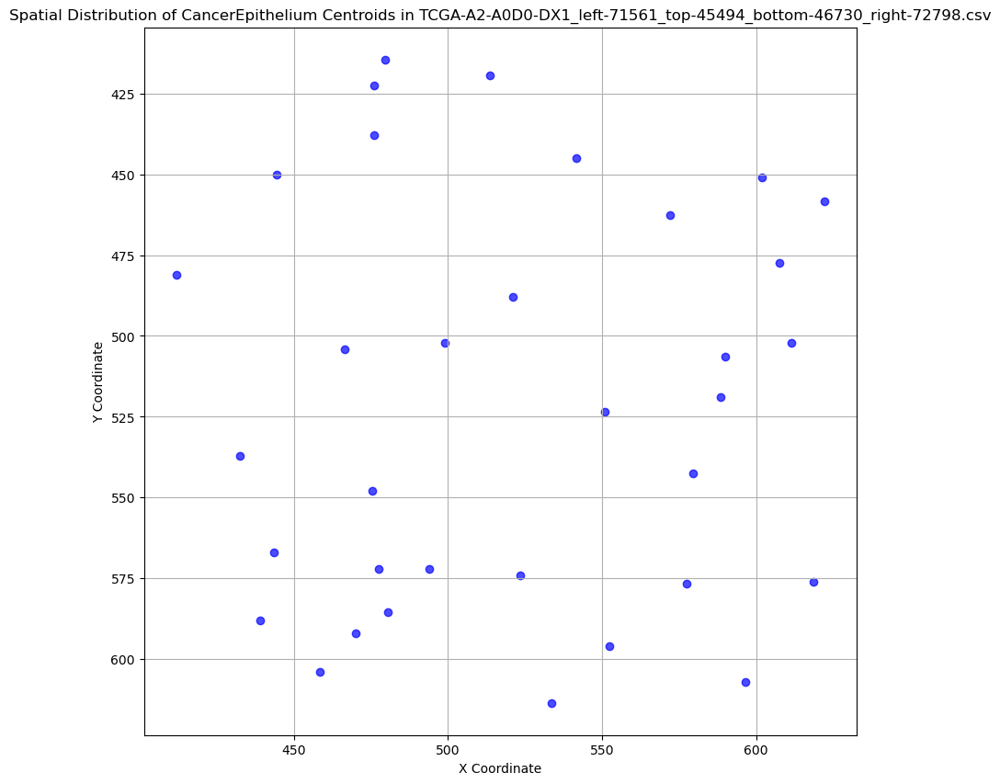

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2


CancerEpithelium Spatial Analysis for TCGA-A2-A0D0-DX1_left-71561_top-45494_bottom-46730_right-72798.csv:
Number of CancerEpithelium regions: 34
Mean area: 763.97
Standard deviation of area: 574.22
Coefficient of variation (heterogeneity): 0.75


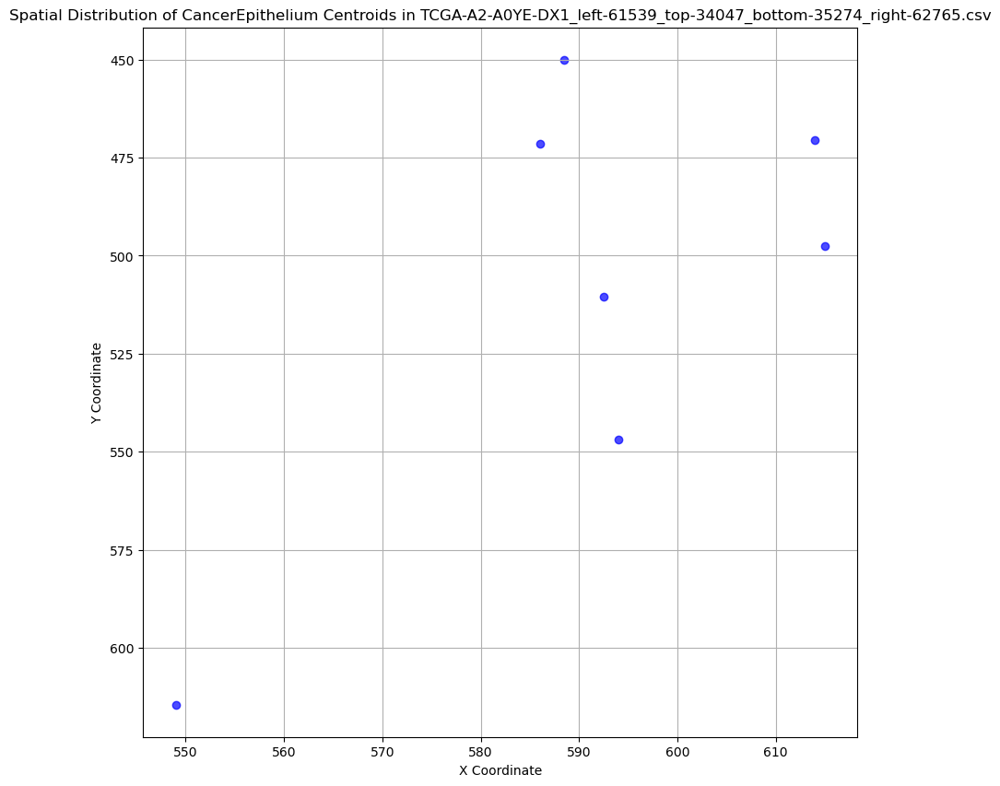

CancerEpithelium Spatial Analysis for TCGA-A2-A0YE-DX1_left-61539_top-34047_bottom-35274_right-62765.csv:
Number of CancerEpithelium regions: 7
Mean area: 799.86
Standard deviation of area: 228.79
Coefficient of variation (heterogeneity): 0.29


/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

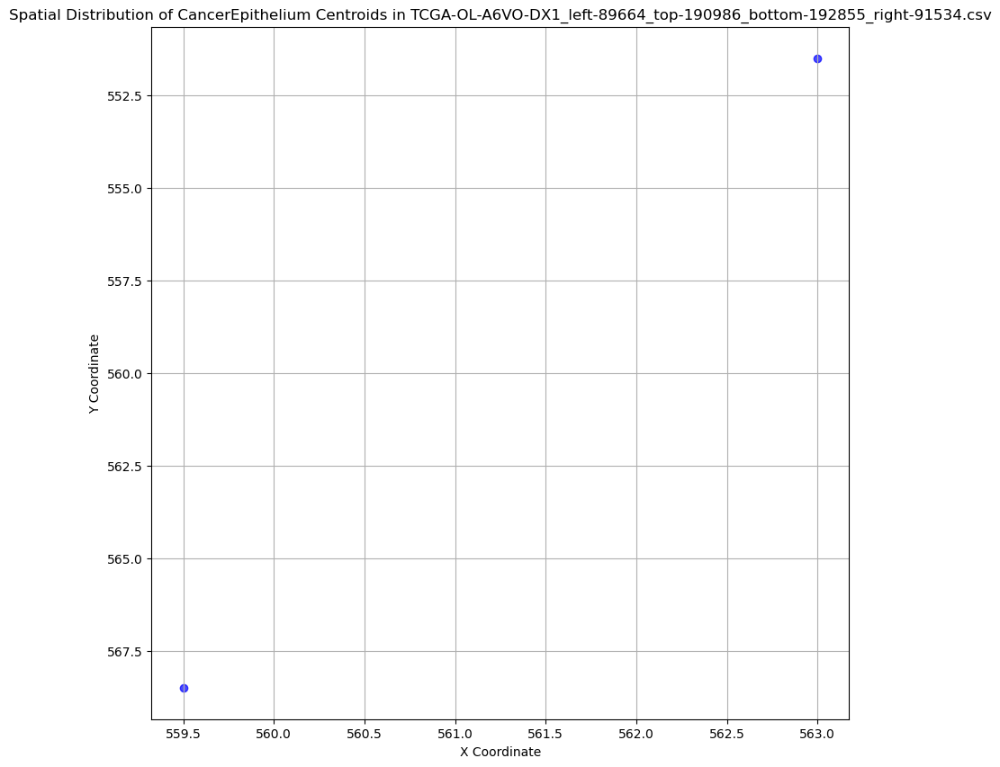

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-OL-A6VO-DX1_left-89664_top-190986_bottom-192855_right-91534.csv:
Number of CancerEpithelium regions: 2
Mean area: 679.50
Standard deviation of area: 99.70
Coefficient of variation (heterogeneity): 0.15


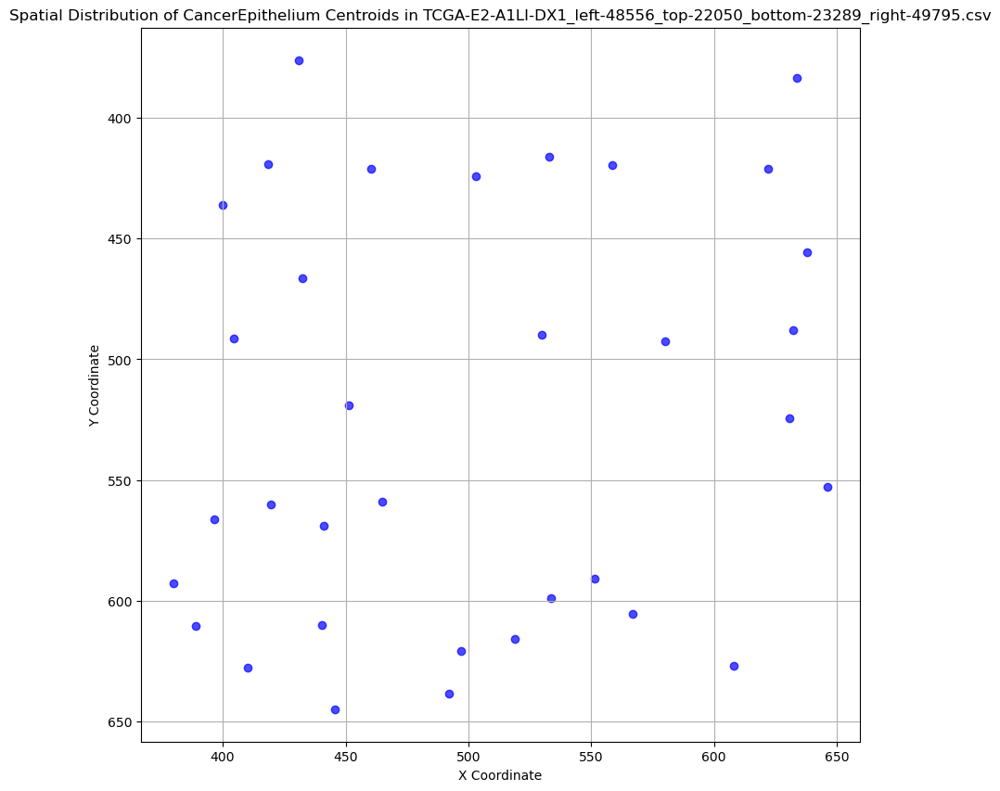

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-E2-A1LI-DX1_left-48556_top-22050_bottom-23289_right-49795.csv:
Number of CancerEpithelium regions: 34
Mean area: 662.18
Standard deviation of area: 219.84
Coefficient of variation (heterogeneity): 0.33


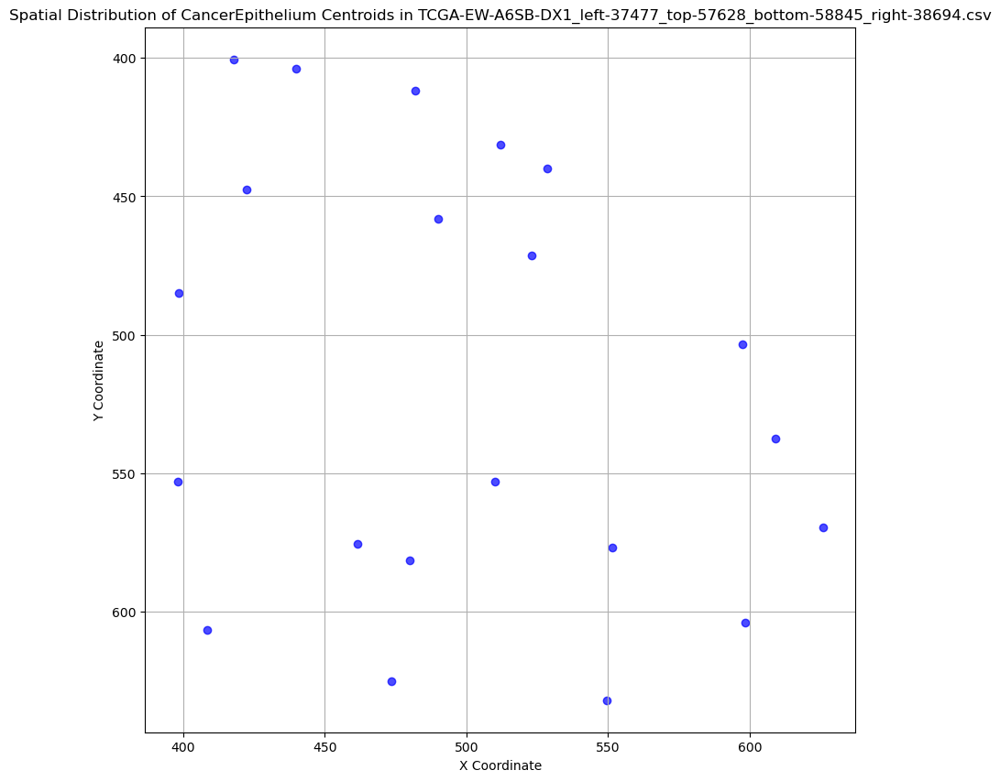

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-EW-A6SB-DX1_left-37477_top-57628_bottom-58845_right-38694.csv:
Number of CancerEpithelium regions: 21
Mean area: 909.14
Standard deviation of area: 383.04
Coefficient of variation (heterogeneity): 0.42


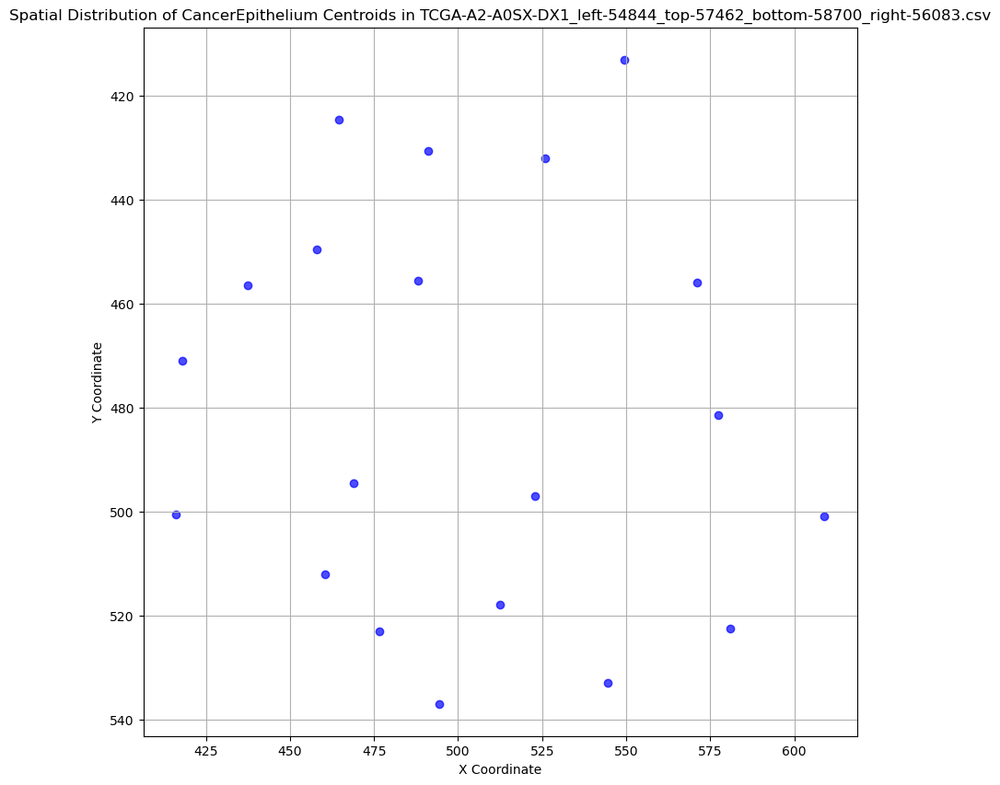

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-A2-A0SX-DX1_left-54844_top-57462_bottom-58700_right-56083.csv:
Number of CancerEpithelium regions: 20
Mean area: 881.65
Standard deviation of area: 454.61
Coefficient of variation (heterogeneity): 0.52


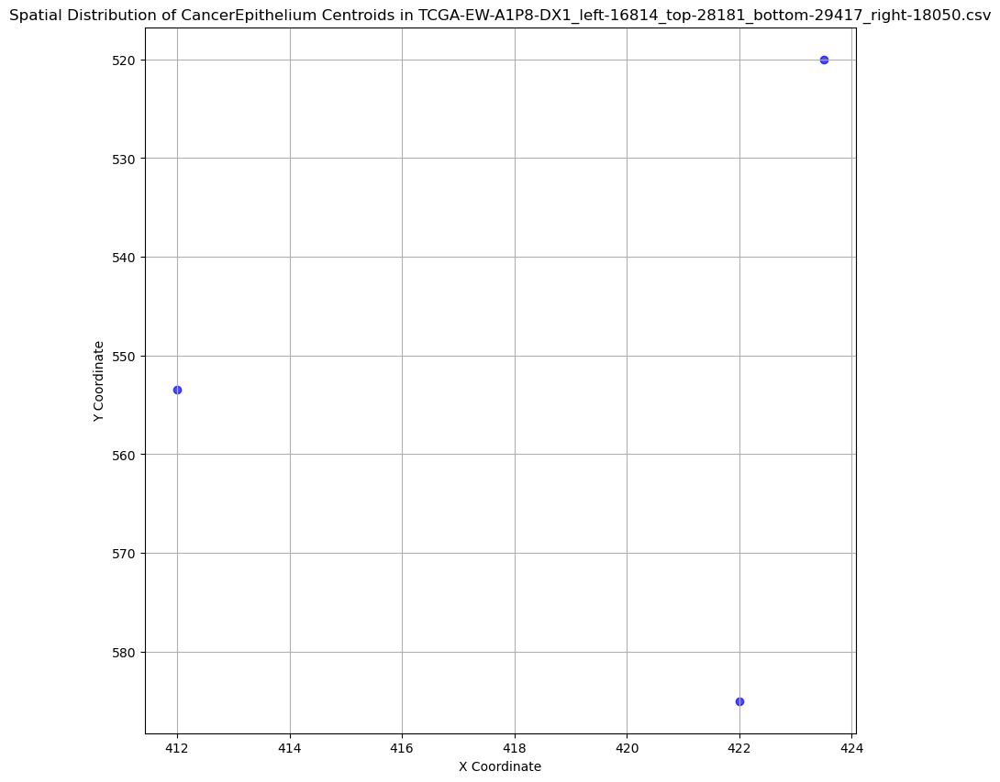

/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/819418838.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
/var/folders/3q/yk49t1dn1ndgm1trny2jx28m0000gn/T/ipykernel_68051/

CancerEpithelium Spatial Analysis for TCGA-EW-A1P8-DX1_left-16814_top-28181_bottom-29417_right-18050.csv:
Number of CancerEpithelium regions: 3
Mean area: 572.00
Standard deviation of area: 158.15
Coefficient of variation (heterogeneity): 0.28
No CancerEpithelium regions found in TCGA-AO-A12F-DX1_left-16825_top-29699_bottom-30314_right-17440.csv.
No CancerEpithelium regions found in TCGA-BH-A0AV-DX1_left-77956_top-59249_bottom-60475_right-79182.csv.


KeyboardInterrupt: 

In [10]:
# Assessing spread of cancer epithelium (spatial heterogeneity) using a simple coefficient of variation 

# Loop through all CSV files in the filtered_csv folder
for csv_file in os.listdir(filtered_csv_dir):
    if csv_file.endswith(".csv"):
        csv_path = os.path.join(filtered_csv_dir, csv_file)
        
        # Load the CSV file
        csv_data = pd.read_csv(csv_path)
        
        # Filter for CancerEpithelium
        cancer_data = csv_data[csv_data['group'] == 'CancerEpithelium']

        if cancer_data.empty:
            print(f"No CancerEpithelium regions found in {csv_file}.")
            continue
        else:
            # Calculate centroids of each CancerEpithelium region
            cancer_data['centroid_x'] = (cancer_data['left'] + cancer_data['right']) / 2
            cancer_data['centroid_y'] = (cancer_data['top'] + cancer_data['bottom']) / 2

            # Plot spatial distribution
            plt.figure(figsize=(10, 10))
            plt.scatter(cancer_data['centroid_x'], cancer_data['centroid_y'], alpha=0.7, color='blue')
            plt.title(f"Spatial Distribution of CancerEpithelium Centroids in {csv_file}")
            plt.xlabel("X Coordinate")
            plt.ylabel("Y Coordinate")
            plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
            plt.grid(True)
            plt.show()

            # Calculate area of each CancerEpithelium region
            cancer_data['area'] = (cancer_data['right'] - cancer_data['left']) * (cancer_data['bottom'] - cancer_data['top'])

            # Calculate heterogeneity
            area_mean = cancer_data['area'].mean()
            area_std = cancer_data['area'].std()
            area_coefficient_of_variation = area_std / area_mean

            # Print analysis results
            print(f"CancerEpithelium Spatial Analysis for {csv_file}:")
            print(f"Number of CancerEpithelium regions: {len(cancer_data)}")
            print(f"Mean area: {area_mean:.2f}")
            print(f"Standard deviation of area: {area_std:.2f}")
            print(f"Coefficient of variation (heterogeneity): {area_coefficient_of_variation:.2f}")

# Summary of processing
print("\nProcessing complete. Check the visualizations and results for each file.")

In [11]:
# Manipulating BCSS (Breast Cancer Semantic Segmentation) dataset to obtain breast cancer patients

input_csv_path = "/Users/ashishsingh/Desktop/bcss.csv"

# Path to save the filtered CSV
output_csv_path = "~/Desktop/filtered_brca.csv"

try:
    # Load the CSV file
    data = pd.read_csv(input_csv_path)

    # Check if the "type" column exists
    if "type" not in data.columns:
        raise ValueError("The 'type' column is not found in the CSV file.")

    # Filter rows where "type" is "BRCA"
    filtered_data = data[data["type"] == "BRCA"]

    # Save the filtered data to a new CSV file
    filtered_data.to_csv(output_csv_path, index=False)

    print(f"Filtered data has been saved to: {output_csv_path}")
    print(f"Number of rows in the filtered data: {len(filtered_data)}")
except FileNotFoundError:
    print(f"File not found: {input_csv_path}")
except Exception as e:
    print(f"An error occurred: {e}")

Filtered data has been saved to: ~/Desktop/filtered_brca.csv
Number of rows in the filtered data: 1097


In [12]:
# Manipulating available PanopTILs data aiming to identify and verify BCSS data

csv_folder_path = "/Users/ashishsingh/Desktop/filtered_csvs"

# Path to save the new CSV file
output_csv_path = "~/Desktop/panoptils_to_bcss.csv"

try:
    # Initialise a list to store the trimmed file names
    trimmed_names = []

    # Loop through all files in the folder
    for file_name in os.listdir(csv_folder_path):
        # Process only CSV files
        if file_name.endswith(".csv"):
            # Extract the first 12 characters of the file name (excluding the extension)
            trimmed_name = file_name[:12]
            trimmed_names.append(trimmed_name)

    # Create a DataFrame from the trimmed names
    trimmed_names_df = pd.DataFrame({"trimmed_names": trimmed_names})

    # Save the DataFrame to a new CSV file on the Desktop
    trimmed_names_df.to_csv(output_csv_path, index=False)

    print(f"New CSV file with trimmed names has been saved to: {output_csv_path}")
except FileNotFoundError:
    print(f"Folder not found: {csv_folder_path}")
except Exception as e:
    print(f"An error occurred: {e}")

New CSV file with trimmed names has been saved to: ~/Desktop/panoptils_to_bcss.csv


In [13]:
# Identifying relevant data points from BCSS

filtered_brca_path = "~/Desktop/filtered_brca.csv" 
panoptils_to_bcss_path = "~/Desktop/panoptils_to_bcss.csv"

try:
    # Load the CSV files
    filtered_brca_data = pd.read_csv(filtered_brca_path)
    panoptils_to_bcss_data = pd.read_csv(panoptils_to_bcss_path)

    # Check if the required columns exist
    if "bcr_patient_barcode" not in filtered_brca_data.columns:
        raise ValueError("The 'bcr_patient_barcode' column is not found in the filtered_brca CSV file.")
    if "trimmed_names" not in panoptils_to_bcss_data.columns:
        raise ValueError("The 'trimmed_names' column is not found in the panoptils_to_bcss CSV file.")

    # Read and strip spaces from the columns
    bcr_patient_barcodes = filtered_brca_data["bcr_patient_barcode"].str.replace(" ", "").unique()
    trimmed_names = panoptils_to_bcss_data["trimmed_names"].str.replace(" ", "").unique()

    # Find similar values
    similar_values = set(bcr_patient_barcodes) & set(trimmed_names)

    # Display the result
    print(f"Number of similar values: {len(similar_values)}")
    if similar_values:
        print("Similar values:")
        print(similar_values)
    else:
        print("No similar values found.")

except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

Number of similar values: 118
Similar values:
{'TCGA-D8-A1XK', 'TCGA-GM-A2DF', 'TCGA-D8-A27M', 'TCGA-A2-A3XT', 'TCGA-AQ-A04J', 'TCGA-E2-A1LH', 'TCGA-OL-A5D6', 'TCGA-A2-A04P', 'TCGA-E2-A150', 'TCGA-AC-A2BK', 'TCGA-A2-A3XS', 'TCGA-A2-A04Q', 'TCGA-AR-A1AQ', 'TCGA-E2-A159', 'TCGA-E2-A1B6', 'TCGA-LL-A73Y', 'TCGA-A2-A0T2', 'TCGA-C8-A26Y', 'TCGA-GM-A2DB', 'TCGA-D8-A1JF', 'TCGA-D8-A1JG', 'TCGA-GM-A2DH', 'TCGA-A2-A0T0', 'TCGA-A7-A4SD', 'TCGA-A2-A1G6', 'TCGA-AO-A12F', 'TCGA-E2-A573', 'TCGA-A2-A0D0', 'TCGA-A7-A0DA', 'TCGA-OL-A6VO', 'TCGA-BH-A18V', 'TCGA-E2-A574', 'TCGA-BH-A0E0', 'TCGA-LL-A740', 'TCGA-AR-A256', 'TCGA-A2-A3XX', 'TCGA-E2-A14R', 'TCGA-E2-A14N', 'TCGA-AN-A0AR', 'TCGA-D8-A1XQ', 'TCGA-BH-A0AV', 'TCGA-BH-A0BG', 'TCGA-OL-A66P', 'TCGA-E2-A1LK', 'TCGA-D8-A1JL', 'TCGA-EW-A1OV', 'TCGA-C8-A1HJ', 'TCGA-LL-A5YO', 'TCGA-BH-A1F6', 'TCGA-LL-A441', 'TCGA-AO-A124', 'TCGA-BH-A0B9', 'TCGA-EW-A6SB', 'TCGA-BH-A18G', 'TCGA-D8-A143', 'TCGA-AO-A129', 'TCGA-EW-A1P8', 'TCGA-AC-A6IW', 'TCGA-OL-A5D7', 'TCGA-EW-

In [14]:
# Verifying relevant data from BCSS

filtered_csvs_path = "/Users/ashishsingh/Desktop/filtered_csvs" 
inter_csvs_path = os.path.expanduser("~/Desktop/inter_csvs") 


# Iterate through the CSV files in the filtered_csvs folder
for csv_file in os.listdir(filtered_csvs_path):
    if csv_file.endswith(".csv"):
        # Extract the first 12 characters of the file name (excluding the extension)
        new_file_name = f"{csv_file[:12]}.csv"
        
        # Paths for the source and destination
        source_file = os.path.join(filtered_csvs_path, csv_file)
        destination_file = os.path.join(inter_csvs_path, new_file_name)
        
        # Copy and rename the file
        shutil.copy(source_file, destination_file)
        print(f"Processed: {csv_file} -> {new_file_name}")

print("Renaming and processing complete. Files saved to the inter_csvs folder.")

# Paths
inter_csvs_path = os.path.expanduser("~/Desktop/inter_csvs")  # Path to the inter_csvs folder
similar_values_path = os.path.expanduser("~/Desktop/similar_values_output.csv")  # Path to the similar_values_output.csv file

try:
    # Check if the folder exists
    if not os.path.exists(inter_csvs_path):
        raise FileNotFoundError(f"The folder '{inter_csvs_path}' does not exist.")

    # Get all file names in the folder and remove the '.csv' extension
    file_names = [
        os.path.splitext(file)[0] for file in os.listdir(inter_csvs_path)
        if os.path.isfile(os.path.join(inter_csvs_path, file)) and file.endswith(".csv")
    ]

    # Load similar_values_output.csv
    similar_values_df = pd.read_csv(similar_values_path)

    if "Similar Values" not in similar_values_df.columns:
        raise ValueError("The 'Similar Values' column is not found in the similar_values_output file.")

    # Extract the values from the column and strip spaces
    similar_values = similar_values_df["Similar Values"].str.strip().tolist()

    # Compare the two lists
    file_names_set = set(file_names)
    similar_values_set = set(similar_values)

    if file_names_set == similar_values_set:
        print("The file names in 'inter_csvs' are equal to the rows in 'similar_values_output.csv'.")
    else:
        print("The file names in 'inter_csvs' do not match the rows in 'similar_values_output.csv'.")
        print("Files in 'inter_csvs' but not in 'similar_values_output.csv':")
        print(file_names_set - similar_values_set)
        print("Values in 'similar_values_output.csv' but not in 'inter_csvs':")
        print(similar_values_set - file_names_set)

except FileNotFoundError as e:
    print(e)
except Exception as e:
    print(f"An error occurred: {e}")

Processed: TCGA-A2-A0D2-DX1_left-99722_top-22842_bottom-24080_right-100961.csv -> TCGA-A2-A0D2.csv
Processed: TCGA-AO-A1KR-DX1_left-19675_top-37718_bottom-38335_right-20292.csv -> TCGA-AO-A1KR.csv
Processed: TCGA-EW-A6SB-DX1_left-37469_top-61209_bottom-62426_right-38686.csv -> TCGA-EW-A6SB.csv
Processed: TCGA-BH-A1EW-DX1_left-70862_top-43247_bottom-44473_right-72089.csv -> TCGA-BH-A1EW.csv
Processed: TCGA-E2-A14R-DX1_left-9042_top-60351_bottom-61596_right-10287.csv -> TCGA-E2-A14R.csv
Processed: TCGA-GM-A2DF-DX1_left-50649_top-44553_bottom-45798_right-51894.csv -> TCGA-GM-A2DF.csv
Processed: TCGA-D8-A147-DX1_left-67951_top-19327_bottom-20565_right-69189.csv -> TCGA-D8-A147.csv
Processed: TCGA-A2-A0D0-DX1_left-68517_top-42674_bottom-43911_right-69753.csv -> TCGA-A2-A0D0.csv
Processed: TCGA-BH-A18V-DX1_left-54643_top-51546_bottom-52782_right-55879.csv -> TCGA-BH-A18V.csv
Processed: TCGA-E2-A573-DX1_left-60454_top-56663_bottom-57902_right-61693.csv -> TCGA-E2-A573.csv
Processed: TCGA-AN-A

In [15]:
# Manipulating BCSS csv file to extract ID and Disease-Free Interval (DFI) data

filtered_brca_path = os.path.expanduser("~/Desktop/filtered_brca.csv")  # Path to the filtered_brca file
output_path = os.path.expanduser("~/Desktop/bcss-outcomes.csv")  # Path to save the new file

try:
    # Load the filtered_brca CSV file
    filtered_brca_df = pd.read_csv(filtered_brca_path)

    # Check if the required columns exist
    required_columns = ["bcr_patient_barcode", "PFI.time.1"]
    for column in required_columns:
        if column not in filtered_brca_df.columns:
            raise ValueError(f"The column '{column}' is not found in the filtered_brca file.")

    # Extract the required columns
    extracted_df = filtered_brca_df[required_columns]

    # Save the extracted columns as a new CSV file
    extracted_df.to_csv(output_path, index=False)
    print(f"New file 'bcss-outcomes.csv' saved to the Desktop.")

except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

New file 'bcss-outcomes.csv' saved to the Desktop.


In [16]:
# For 1318 WSI
# Calculating cofficients of variability for cancer epithelium in each regions of interest

# Dictionary to store results
results = []

# Iterate through all .png files in the filtered_rgbs folder
for image_file in os.listdir(filtered_rgb_dir):
    if image_file.endswith(".png"):
        image_path = os.path.join(filtered_rgb_dir, image_file)

        # Open the image
        with Image.open(image_path) as img:
            image_array = np.array(img)

        # Mask for cancer epithelium (assuming it's the first channel)
        epithelium_mask = image_array[:, :, 0] > 0  # Non-zero values represent cancer epithelium

        # Calculate coefficient of variation for cancer epithelium
        epithelium_values = image_array[:, :, 0][epithelium_mask]
        if len(epithelium_values) > 0:
            mean_value = np.mean(epithelium_values)
            std_value = np.std(epithelium_values)
            coefficient_of_variation = std_value / mean_value
        else:
            coefficient_of_variation = np.nan  # Assign NaN if no epithelium is detected

        # Store results
        results.append({"File Name": image_file, "Coefficient of Variation": coefficient_of_variation})

# Save results to a CSV file
output_csv_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_all.csv")
results_df = pd.DataFrame(results)
results_df.to_csv(output_csv_path, index=False)

print(f"Results saved to {output_csv_path}.")

Results saved to /Users/ashishsingh/Desktop/cancer_epithelium_heterogeneity_all.csv.


In [17]:
# Manipulating names to match with BCSS

# Path to the input CSV file
input_csv_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_all.csv")

# Path to the output CSV file
output_csv_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_modified.csv")

try:
    # Load the CSV file
    heterogeneity_df = pd.read_csv(input_csv_path)

    if "File Name" not in heterogeneity_df.columns:
        raise ValueError("The 'File Name' column is not found in the input CSV file.")

    # Modify the "File Name" column to keep only the first 12 characters
    heterogeneity_df["File Name"] = heterogeneity_df["File Name"].str[:12]

    # Save the updated DataFrame to a new CSV file
    heterogeneity_df.to_csv(output_csv_path, index=False)

    print(f"File names modified and saved to {output_csv_path}.")

except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

File names modified and saved to /Users/ashishsingh/Desktop/cancer_epithelium_heterogeneity_modified.csv.


In [18]:
# For 118 patients
# Calculating mean cofficients of variability for cancer epithelium, grouping by BCSS patient ID

# Path to the input CSV file
input_csv_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_modified.csv")

# Path to the output CSV file
output_csv_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_combined.csv")

try:
    # Load the CSV file
    heterogeneity_df = pd.read_csv(input_csv_path)

    if "File Name" not in heterogeneity_df.columns or "Coefficient of Variation" not in heterogeneity_df.columns:
        raise ValueError("The required columns ('File Name' and 'Coefficient of Variation') are not found in the input CSV file.")

    # Combine rows with the same "File Name" and calculate the mean of "Coefficient of Variation"
    combined_df = heterogeneity_df.groupby("File Name", as_index=False)["Coefficient of Variation"].mean()

    # Save the combined DataFrame to a new CSV file
    combined_df.to_csv(output_csv_path, index=False)

    print(f"Combined results saved to {output_csv_path}.")

except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

Combined results saved to /Users/ashishsingh/Desktop/cancer_epithelium_heterogeneity_combined.csv.


In [19]:
# Combining coefficients of variability from PanopTILs with PFI from BCSS

# Paths to the input files
heterogeneity_combined_path = os.path.expanduser("~/Desktop/cancer_epithelium_heterogeneity_combined.csv")
bcss_outcomes_path = os.path.expanduser("~/Desktop/bcss-outcomes.csv")

# Path to the output file
output_csv_path = os.path.expanduser("~/Desktop/ml-data.csv")

try:
    # Load the CSV files
    heterogeneity_df = pd.read_csv(heterogeneity_combined_path)
    bcss_outcomes_df = pd.read_csv(bcss_outcomes_path)

    # Ensure required columns are present
    required_columns_heterogeneity = ["File Name", "Coefficient of Variation"]
    required_columns_outcomes = ["bcr_patient_barcode", "PFI.time.1"]

    for column in required_columns_heterogeneity:
        if column not in heterogeneity_df.columns:
            raise ValueError(f"The column '{column}' is not found in the heterogeneity file.")

    for column in required_columns_outcomes:
        if column not in bcss_outcomes_df.columns:
            raise ValueError(f"The column '{column}' is not found in the outcomes file.")

    # Merge the dataframes
    combined_df = pd.merge(
        bcss_outcomes_df,
        heterogeneity_df,
        left_on="bcr_patient_barcode",
        right_on="File Name",
        how="inner"
    )

    # Retain only necessary columns
    combined_df = combined_df[["bcr_patient_barcode", "PFI.time.1", "Coefficient of Variation"]]

    # Save the combined DataFrame to a new CSV file
    combined_df.to_csv(output_csv_path, index=False)

    print(f"Combined data saved to {output_csv_path}.")

except FileNotFoundError as e:
    print(f"File not found: {e}")
except Exception as e:
    print(f"An error occurred: {e}")

Combined data saved to /Users/ashishsingh/Desktop/ml-data.csv.


In [20]:
#Applying machine learning

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, confusion_matrix, classification_report
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

# Load the dataset
data_path = "~/Desktop/ml-data.csv"
data = pd.read_csv(data_path)

# Feature (independent variable) and target (dependent variable)
X = data[["Coefficient of Variation"]].values
y = data["PFI.time.1"].apply(lambda x: 1 if x > np.median(data["PFI.time.1"]) else 0).values  # Binary classification

# Split the data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Define models
models = {
    "Support Vector Machine": SVC(probability=True, random_state=42),
    "Logistic Regression": LogisticRegression(random_state=42)
}

# Hyperparameter grids for each model
param_grids = {
    "Support Vector Machine": {
        "C": [0.1, 1, 10, 100],
        "kernel": ["linear", "rbf"],
        "gamma": ["scale", "auto"]
    },
    "Logistic Regression": {
        "C": [0.1, 1, 10, 100],
        "solver": ["liblinear", "lbfgs"]
    }
}

# Perform Bayesian-like grid search to find the best hyperparameters
best_models = {}
best_f1_scores = {}
confusion_matrices = {}

for model_name, model in models.items():
    print(f"Tuning hyperparameters for {model_name}...")
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grids[model_name],
        scoring="f1",
        cv=5,
        verbose=1,
        n_jobs=-1
    )
    grid_search.fit(X_train, y_train)
    best_models[model_name] = grid_search.best_estimator_
    y_pred = grid_search.best_estimator_.predict(X_test)
    f1 = f1_score(y_test, y_pred)
    best_f1_scores[model_name] = f1
    confusion_matrices[model_name] = confusion_matrix(y_test, y_pred)
    print(f"Best F1 Score for {model_name}: {f1:.4f}")

# Select the best model based on F1 score
best_model_name = max(best_f1_scores, key=best_f1_scores.get)
print(f"\nBest Model: {best_model_name} with F1 Score: {best_f1_scores[best_model_name]:.4f}")

# Print confusion matrices for all models
for model_name, matrix in confusion_matrices.items():
    print(f"\nConfusion Matrix for {model_name}:")
    print(matrix)

# Final results
print("\nClassification Report for Best Model:")
print(classification_report(y_test, best_models[best_model_name].predict(X_test)))

Tuning hyperparameters for Support Vector Machine...
Fitting 5 folds for each of 16 candidates, totalling 80 fits
Best F1 Score for Support Vector Machine: 0.6667
Tuning hyperparameters for Logistic Regression...
Fitting 5 folds for each of 8 candidates, totalling 40 fits
Best F1 Score for Logistic Regression: 0.7143

Best Model: Logistic Regression with F1 Score: 0.7143

Confusion Matrix for Support Vector Machine:
[[ 0 12]
 [ 0 12]]

Confusion Matrix for Logistic Regression:
[[ 6  6]
 [ 2 10]]

Classification Report for Best Model:
              precision    recall  f1-score   support

           0       0.75      0.50      0.60        12
           1       0.62      0.83      0.71        12

    accuracy                           0.67        24
   macro avg       0.69      0.67      0.66        24
weighted avg       0.69      0.67      0.66        24



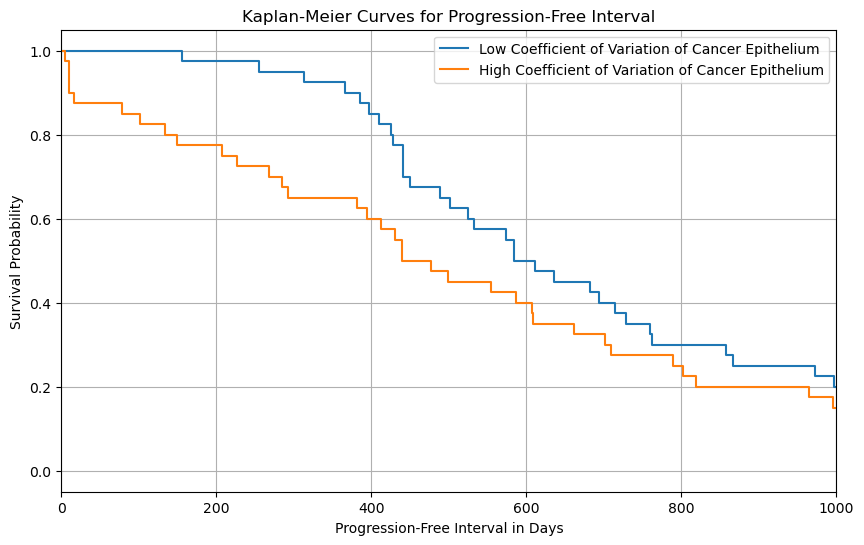

In [21]:
# Plotting survival curves

from lifelines import KaplanMeierFitter

# Load the dataset
data_path = "~/Desktop/ml-data.csv"
data = pd.read_csv(data_path)

# Check for required columns
if "Coefficient of Variation" not in data.columns or "PFI.time.1" not in data.columns:
    raise ValueError("Required columns are not present in the dataset.")

# Truncate data at time 1000 to exclude outliers
data = data[data["PFI.time.1"] <= 1500]

# Define a threshold for "low" and "high" Coefficient of Variation
threshold = data["Coefficient of Variation"].median()  # Median as the threshold
data["Risk Group"] = np.where(data["Coefficient of Variation"] <= threshold, "Low", "High")

# Prepare data for Kaplan-Meier fitting
time = data["PFI.time.1"]
event_observed = np.ones(len(time))  # Assuming all patients are observed (no censored data)

# Create Kaplan-Meier fitter objects
kmf_low = KaplanMeierFitter()
kmf_high = KaplanMeierFitter()

# Fit survival curves for each group
low_group = data[data["Risk Group"] == "Low"]
high_group = data[data["Risk Group"] == "High"]

kmf_low.fit(durations=low_group["PFI.time.1"], event_observed=np.ones(len(low_group)), label="Low Coefficient of Variation of Cancer Epithelium")
kmf_high.fit(durations=high_group["PFI.time.1"], event_observed=np.ones(len(high_group)), label="High Coefficient of Variation of Cancer Epithelium")

# Plot Kaplan-Meier survival curves
plt.figure(figsize=(10, 6))
kmf_low.plot_survival_function(ci_show=False)
kmf_high.plot_survival_function(ci_show=False)

# Add plot details
plt.title("Kaplan-Meier Curves for Progression-Free Interval")
plt.xlabel("Progression-Free Interval in Days")
plt.ylabel("Survival Probability")
plt.xlim(0, 1000)
plt.grid(True)
plt.legend()
plt.show()